In [264]:
import os
import importlib
import re 
import collections
import pickle

import squidpy as sq
import scipy
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import scanpy as sc
import pandas as pd
import anndata as ad
import numpy as np
import matplotlib as mpl
import cv2
import xgboost as xgb
from mpl_toolkits.axes_grid1.anchored_artists import AnchoredSizeBar



import spatial_rgc.utils.rconstants as rc
import spatial_rgc.utils.run_container as container   
import spatial_rgc.utils.visualizer as visualizer
import spatial_rgc.utils.model_constants as constants 
import spatial_rgc.utils.classifier as cl
import spatial_rgc.utils.plot_utils as pu
import spatial_rgc.utils.assorted_utils as utils
import spatial_rgc.utils.preprocess_utils as ppu

mpl.rcParams['pdf.fonttype'] = 42
mpl.rcParams['ps.fonttype'] = 42
CONTEXT = {"figure.dpi":300,"font.size":12,"font.sans-serif":"Arial"}
sc._settings.settings._vector_friendly=True
BASE_DIR=constants.BASE_DIR
DATA_DIR = os.path.join(constants.BASE_DIR,'data')
#DATA_DIR = os.path.join("..","..","MERFISH_RGC")
JOINT_ADATA  = "merged_control_cluster_final.h5ad"
JOINT_RGC = "RGC_control_final.h5ad"


In [93]:
ABBREV_MAP = {'Amacrine':'AC','Non-neuronal':'NN','Low quality neuronal':'Low QC','RGC':'RGC','Horizontal cell':'HC','Bipolar cell':'BC','Photoreceptor':'PR','Unassigned':'Unassigned'}

CLASS_CMAP= plt.get_cmap('tab20')
CLASS_PALETTE={'Amacrine':CLASS_CMAP(0),'Non-neuronal':CLASS_CMAP(6), 'Low quality neuronal':CLASS_CMAP(14),'RGC':CLASS_CMAP(2)}
CLASS_PALETTE.update({ABBREV_MAP[k]:v for k,v in CLASS_PALETTE.items()})

AUG_CLASS_PALETTE = CLASS_PALETTE.copy()
NOT_PRESENT = {'Horizontal cell':CLASS_CMAP(1),'Photoreceptor':CLASS_CMAP(7),'Bipolar cell':CLASS_CMAP(10)}
AUG_CLASS_PALETTE.update(NOT_PRESENT)
AUG_CLASS_PALETTE.update({ABBREV_MAP[k]:v for k,v in NOT_PRESENT.items()})

CLASS_CMAP_PASTEL= plt.get_cmap('Pastel1')
CLASS_PALETTE_PASTEL={'Amacrine':CLASS_CMAP(1),'Non-neuronal':CLASS_CMAP(0), 'Low quality neuronal':CLASS_CMAP(8),'RGC':CLASS_CMAP(4)}

CLUST_MAP = {i:f'C{i+1}' for i in range(45)}
CLUST_MAP[45] = 'Unassigned'
RGC_ORDER = [f"C{i+1}" for i in range(45)] + ['Unassigned']

NON_N_PALETTE = CLASS_PALETTE.copy()
NON_PALETTE = {'Endothelial':CLASS_CMAP(7),'Astrocyte':CLASS_CMAP(8),'Microglia':CLASS_CMAP(10),'Muller glia':CLASS_CMAP(9),'Pericyte':CLASS_CMAP(12), 'Unassigned Non-neuronal':CLASS_CMAP(15),'Unassigned':CLASS_CMAP(15)}
NON_N_PALETTE.update(NON_PALETTE)

cmap_reds = sns.light_palette('#eb0505',as_cmap=True)
cmap = plt.get_cmap('tab20')
rgc_types = [f'C{i}' for i in range(1,16)] + ['C16_V','C16_D'] + [f'C{i}' for i in range(17,46)] + ['Unassigned']
type_palette = {ctype:cmap(i%20) for i,ctype in enumerate(rgc_types)}


# Figure 1

In [91]:
figure_dir=os.path.join(BASE_DIR,"figures","Figure_1")
data_dir=os.path.join(DATA_DIR,"control_130_6")


adata=sc.read_h5ad(os.path.join(data_dir,JOINT_ADATA))
adata_ref = sc.read_h5ad(os.path.join(DATA_DIR,"atlases","RGCatlas.h5ad"))

## Figure 1D


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_3966/3405455741.py:5: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "rasterized" which is no longer supported as of 3.3 and will become an error in 3.6
  plt.savefig(os.path.join(figure_dir,"RGC_atlas.pdf"),rasterized=True)


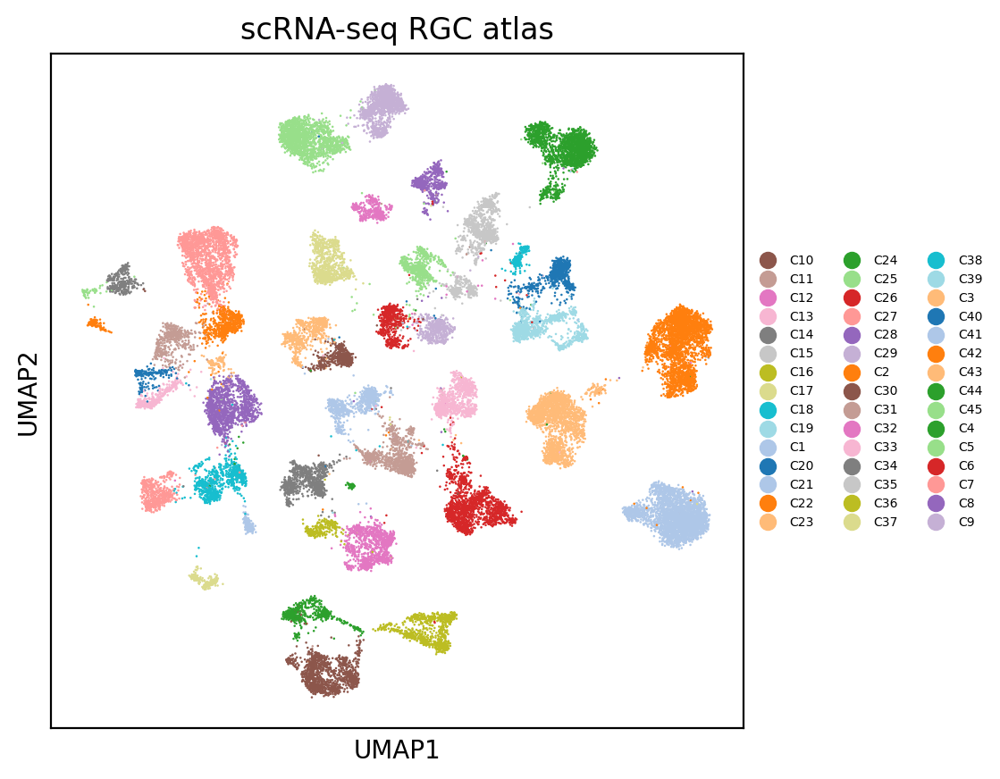

In [23]:
cmap = plt.get_cmap('tab20')
cust_palette = {f'C{i}':cmap(i%20) for i in range(1,46)}
with plt.rc_context({"figure.dpi":200,"font.sans-serif":'Arial',"figure.figsize":(5,5)}):
    sc.pl.umap(adata_ref,color='Type_num',palette=cust_palette,title="scRNA-seq RGC atlas",show=False,legend_fontsize=5)
    plt.savefig(os.path.join(figure_dir,"RGC_atlas.pdf"),rasterized=True)


## Figure 1E

In [ ]:
import pickle
import spatial_rgc.utils.classifier as cl
import xgboost as xgb
import spatial_rgc.utils.preprocess_utils as ppu
import xgboost as xgb

# info ={
#     'gene_list':os.path.join("models","removed_genes","feature_names_130.pickle"),
#     'renamed_genes_map':constants.RENAMED_GENE_MAP,
#     'model_dir':os.path.join("models",'rgc_atlas'),
#     'model_name':'xgb_rgc130',
#     'train_dict_name':'train_dict_rgc130.pickle',
# }
info ={
    'gene_list':os.path.join(BASE_DIR,"models","removed_genes","feature_names_140.pickle"),
    'renamed_genes_map':constants.RENAMED_GENE_MAP,
    'model_dir':os.path.join(BASE_DIR,"models",'rgc_atlas'),
    'model_name':'xgb_rgc140',
    'train_dict_name':'train_dict_rgc140.pickle',
}

adata_ref = sc.read_h5ad(os.path.join(BASE_DIR,"data","atlases","RGCatlas.h5ad"))
adata_ref.obs['Type_num'] = pd.Categorical(adata_ref.obs['Type_num'], categories=[f"C{i+1}" for  i in range(45)] + ['Unassigned'],ordered=True)

#from pandas.api.types import CategoricalDtype
adata_ref.var.rename(index=info['renamed_genes_map'],inplace=True)
adata_ref = ppu.rearrange_and_preprocess(adata_ref,feature_names_f=info['gene_list'],target_sum=None, batch_key=None,save_log=False)#use none for classifier

{'C1': 0, 'C2': 1, 'C3': 2, 'C4': 3, 'C5': 4, 'C6': 5, 'C7': 6, 'C8': 7, 'C9': 8, 'C10': 9, 'C11': 10, 'C12': 11, 'C13': 12, 'C14': 13, 'C15': 14, 'C16': 15, 'C17': 16, 'C18': 17, 'C19': 18, 'C20': 19, 'C21': 20, 'C22': 21, 'C23': 22, 'C24': 23, 'C25': 24, 'C26': 25, 'C27': 26, 'C28': 27, 'C29': 28, 'C30': 29, 'C31': 30, 'C32': 31, 'C33': 32, 'C34': 33, 'C35': 34, 'C36': 35, 'C37': 36, 'C38': 37, 'C39': 38, 'C40': 39, 'C41': 40, 'C42': 41, 'C43': 42, 'C44': 43, 'C45': 44, 'Unassigned': 45}
Running train/validation split
trainclassifier() complete after 149.0 seconds
           C1        C2        C3        C4        C5        C6        C7  \
C1   0.968500  0.019000  0.001000  0.000500  0.000000  0.000000  0.000000   
C2   0.021517  0.961269  0.007531  0.001614  0.000000  0.000000  0.000000   
C3   0.003030  0.004040  0.973737  0.003030  0.001010  0.001010  0.001010   
C4   0.004608  0.001152  0.005760  0.961982  0.001152  0.002304  0.000000   
C5   0.000000  0.000000  0.001399  0.00000

/Users/kushalnimkar/Documents/PhD/MERFISH_RGC/utils.py:148: UserWarning: FixedFormatter should only be used together with FixedLocator
  dot_ax.set_xticklabels(xticksactual,rotation=90)


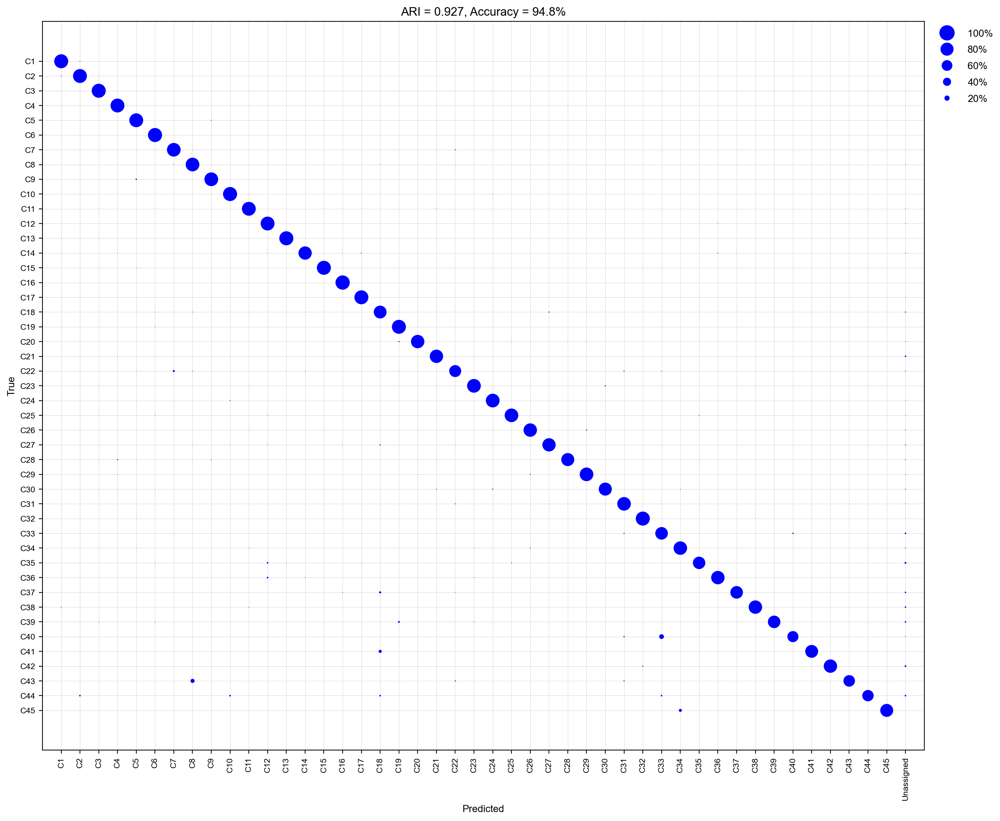

In [116]:
importlib.reload(cl),
valid_model,model,train_dict,test_dict = cl.run_training_and_validation(adata=adata_ref,obs_id='Type_num',model_dir=info['model_dir'], model_name=info['model_name']+"FORFIG",output_dir=figure_dir, cutoff=0.5,output_f =f"XGB_0.5_validation_140g.pdf",train_dict_name=info['train_dict_name']+"FORFIG",colsample_bytree=1,nround=200,max_cells_per_ident=1000,min_cells_per_ident=200,max_depth=4)

In [81]:
import pickle
import classifier as cl
import xgboost as xgb
import preprocess_utils as ppu

np.random.default_rng(seed=0)
rng = np.random.default_rng()
def gen_randomized_genes(n_genes=140,n_repeats=2,use_hvg=True,post=''):
    adata_ref = sc.read_h5ad(os.path.join("data","atlases","RGCatlas.h5ad"))
    adata_ref.obs['Type_num'] = pd.Categorical(adata_ref.obs['Type_num'], categories=[f"C{i+1}" for  i in range(45)] + ['Unassigned'],ordered=True)
    if use_hvg:
        sc.pp.highly_variable_genes(adata_ref,layer='raw',n_top_genes=2000,batch_key='Batch',subset=True,flavor='seurat_v3')

    genes = np.array(adata_ref.var.index.values)
    for rep in range(1,n_repeats+1):
        rand_genes = rng.choice(genes,size=n_genes,replace=False)
        
        pickle_name = "feature_names_{}_{}{}.pickle".format(n_genes,rep,post)
        output_f = os.path.join("models","randomized_genes",pickle_name)
        with open(output_f,"wb") as f:
            pickle.dump(rand_genes,f)

def randomized_trial(n_genes,n_repeats,model_dir='randomized_140',post=''):
    for rep in range(1,n_repeats+1):
        info ={
            'gene_list':os.path.join("models","randomized_genes","feature_names_{}_{}{}.pickle".format(n_genes,rep,post)),
            'renamed_genes_map':constants.RENAMED_GENE_MAP,
            'model_dir':os.path.join("models",f'{model_dir}_model'),
            'model_name':'n_genes{}_nrep{}{}'.format(n_genes,rep,post),
            'train_dict_name':'train_dict_n_genes{}_nrep{}{}.pickle'.format(n_genes,rep,post),
        }
        
        adata_ref = sc.read_h5ad(os.path.join("data","atlases","RGCatlas.h5ad"))
        adata_ref.obs['Type_num'] = pd.Categorical(adata_ref.obs['Type_num'], categories=[f"C{i+1}" for  i in range(45)] + ['Unassigned'],ordered=True)
        #from pandas.api.types import CategoricalDtype
        adata_ref = ppu.rearrange_and_preprocess(adata_ref,feature_names_f=info['gene_list'],target_sum=None, batch_key=None,save_log=False)#use none for classifier
        importlib.reload(cl)
        valid_model,model,train_dict,test_dict = cl.run_training_and_validation(adata=adata_ref,obs_id='Type_num',model_dir=info['model_dir'], model_name=info['model_name'],output_dir=figure_dir, output_f ="XGB_0.5_validation_random{}_{}.pdf".format(n_genes,post),train_dict_name=info['train_dict_name'],colsample_bytree=1,nround=200,max_cells_per_ident=1000,min_cells_per_ident=200,max_depth=4)

In [ ]:
gen_randomized_genes(n_genes=140,n_repeats=10,use_hvg=False,post='')
randomized_trial(n_genes=140,n_repeats=10,model_dir='randomized_140',post='')

In [ ]:
gen_randomized_genes(n_genes=140,n_repeats=10,use_hvg=True,post='_hvg')
randomized_trial(n_genes=140,n_repeats=10,post='_hvg')

In [ ]:
sc.tl.rank_genes_groups(adata_ref,groupby='Type_num')
de_df = sc.get.rank_genes_groups_df(log2fc_min=0.2,log2fc_max=1.7)
de_df.write_csv(os.path.join(DATA_DIR,"atlases","RGCatlas_de.csv"))

In [ ]:


de_df = pd.read_csv(os.path.join(DATA_DIR, "atlases", "RGCatlas_de.csv"))

importlib.reload(utils)
min_fc = 0.2
max_fc =1.7
clust_thresh=0.8
other_thresh=0.4
n_genes=500
gamma=0.02

in_key = 'pct_nz_group'
out_key = 'pct_nz_reference'
gene_key = 'names'
diff_key = 'diff'
c_key = 'group'
order='diff'

de_df['group'] = de_df['group'].apply(lambda x: re.search(r'^(C[0-9]+)',x).group(1))
MAP_NAMES = {'Fam19a4':'Tafa4','Tusc5':'Trarg1'}
de_df.rename(index=MAP_NAMES,inplace=True)
de_df['group'] = de_df['group'].apply(lambda x: MAP_NAMES[x] if x in MAP_NAMES else x)
de_df[diff_key] = np.log2(de_df[in_key]+gamma) - np.log2(de_df[out_key]+gamma)
de_df = de_df[de_df[in_key]>= 0.4]

genes,cg_df, max_diffs = utils.recommend_genes_v3(de_df,
                n_genes=n_genes,
                c_key=c_key,
                diff_key = diff_key,
                in_key = in_key,
                out_key = out_key,
                gene_key = gene_key,
                min_fc =min_fc,
                max_fc = max_fc,
                clust_thresh = clust_thresh,
                other_thresh = other_thresh,
                order=order,
                preselected_genes = None,
                ascending = False,
               )

file = "0.05New_Panel{}_KN_RGC_only.csv".format(n_genes)
glp = "gene_lists"
pd.DataFrame(genes).to_csv(os.path.join(glp,file),header=None,index=None)


import pickle

fout = os.path.join("models","removed_genes","feature_names.pickle")
with open(fout,'wb') as f:
    pickle.dump(genes,f)

### Create sets of 45

In [ ]:
import utils
import pickle 
from sklearn.metrics.cluster import adjusted_rand_score
import preprocess_utils as pu
import matplotlib as mpl

def calc_metrics(y,y_pred,unassigned_indicator):
    accuracy  = np.sum(y==y_pred)/len(y)
    ari = adjusted_rand_score(labels_true = y, labels_pred = y_pred)
    frac_unassigned = np.sum(y_pred==unassigned_indicator)/len(y)
    return accuracy,ari,frac_unassigned

fout = os.path.join("models","removed_genes","feature_names.pickle")
with open(fout,'rb') as f:
    features = pickle.load(f)
num_classes=45
train_dict={f"C{i+1}":i for i in range(num_classes)}
train_dict['Unassigned'] = num_classes

intervals=45
total_models = 9
ari_arr=[]
accuracy_arr=[]
frac_unassigned_arr=[]
n_genes_lst = []
cutoff=0.8
figure_dir=os.path.join(BASE_DIR,"figures","Figure_1")
fname=f"v3_{intervals}.png"

In [ ]:
importlib.reload(pu)
for i in range(total_models):
    end = (i+1)*intervals
    n_genes_lst.append(end)
    feature_subset = features[0:end]

    # Need to dump feature names into file so that preprocess can access it
    model_name = f"xgb_{end}"
    model_dir = os.path.join("models",f"{end}_genes_test")
    f_subset_out = os.path.join(model_dir,"feature_names.pickle")
    with open(f_subset_out,'wb') as f:
        pickle.dump(feature_subset,f)

    DATA_F = os.path.join(BASE_DIR,"data","atlases","RGCatlas.h5ad")
    adata = sc.read_h5ad(DATA_F)
    adata = pu.rearrange_and_preprocess(adata,feature_names_f=f_subset_out,target_sum=None, batch_key=None,save_log=False)

    y, y_probs, valid_model,model=utils.trainclassifier(train_anndata=adata, 
                                                    common_top_genes=list(adata.var.index), 
                                                    obs_id='Type_num', 
                                                    train_dict=train_dict, 
                                                    eta=0.2,
                                                    max_cells_per_ident=2000, train_frac=0.7,
                                                    min_cells_per_ident=100,
                                                    run_validation=True,
                                                    run_full=False
                                                    )
                                                    
    y_pred = utils.threshold(y_probs,unassigned_indicator=train_dict['Unassigned'],cutoff=cutoff)                                            

    np.save(os.path.join(model_dir,f"y_probsv3_top_{}_genes_test.npy".format(end)),y_probs)
    np.save(os.path.join(model_dir,f"y_labelv3_top_{}_genes_test.npy".format(end)),y)

    if model is not None:
        model.save_model(os.path.join(model_dir,model_name))
    if valid_model is not None:
        valid_model.save_model(os.path.join(model_dir,f"valid_{model_name}"))

    accuracy, ari, frac_unassigned = calc_metrics(y,y_pred,unassigned_indicator=45)
    accuracy_arr.append(accuracy)
    ari_arr.append(ari)
    frac_unassigned_arr.append(frac_unassigned)



### make plots

In [117]:
n_genes,n_repeats = 140,10
model_dir = os.path.join("models","randomized_140_model")
cutoff = 0.5
accuracies = []
labels = []
n_genes_lst = []

#Get random
for rep in range(1,1+n_repeats):
    y_probs = np.load(os.path.join(model_dir,"n_genes{}_nrep{}_valid_y_probs.npy".format(n_genes,rep)))
    y_true = np.load(os.path.join(model_dir,"n_genes{}_nrep{}_valid_y.npy".format(n_genes,rep)))
    y_pred = np.where( np.max(y_probs,axis=1)>cutoff, np.argmax(y_probs,axis=1),45)
    accuracies.append(np.sum(y_pred==y_true)/len(y_true))
    labels.append(f"Random {n_genes} (from all) panel")
    n_genes_lst.append(n_genes)
#Get HVG random
post = "_hvg"
for rep in range(1,1+n_repeats):
    
    y_probs = np.load(os.path.join(model_dir,"n_genes{}_nrep{}{}_valid_y_probs.npy".format(n_genes,rep,post)))
    y_true = np.load(os.path.join(model_dir,"n_genes{}_nrep{}{}_valid_y.npy".format(n_genes,rep,post)))
    y_pred = np.where( np.max(y_probs,axis=1)>cutoff, np.argmax(y_probs,axis=1),45)
    accuracies.append(np.sum(y_pred==y_true)/len(y_true))
    labels.append(f"Random {n_genes} (from HVG) panel")
    n_genes_lst.append(n_genes)


#Get actual
for n_genes in [45,90,135,180]:
    model_dir = os.path.join("models","{}_genes_test".format(n_genes))
    y_probs = np.load(os.path.join(model_dir,"y_probsv3_top_{}_genes_test.npy".format(n_genes)))
    y_true = np.load(os.path.join(model_dir,"y_labelv3_top_{}_genes_test.npy".format(n_genes)))
    y_pred = np.where( np.max(y_probs,axis=1)>cutoff, np.argmax(y_probs,axis=1),45)
    accuracies.append(np.sum(y_pred==y_true)/len(y_true))
    labels.append("Diff. expression gene selection")
    n_genes_lst.append(n_genes)

#
accuracies.append(0.948)
labels.append("Selected panel")
n_genes_lst.append(140)


panel_df = pd.DataFrame({'accuracy':accuracies,"Group":labels,"n_genes":n_genes_lst})


    




/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_9739/2332029714.py:23: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "rasterized" which is no longer supported as of 3.3 and will become an error in 3.6
  plt.savefig(os.path.join(figure_dir,"Gene_Selection_Supp.pdf"),rasterized=True)


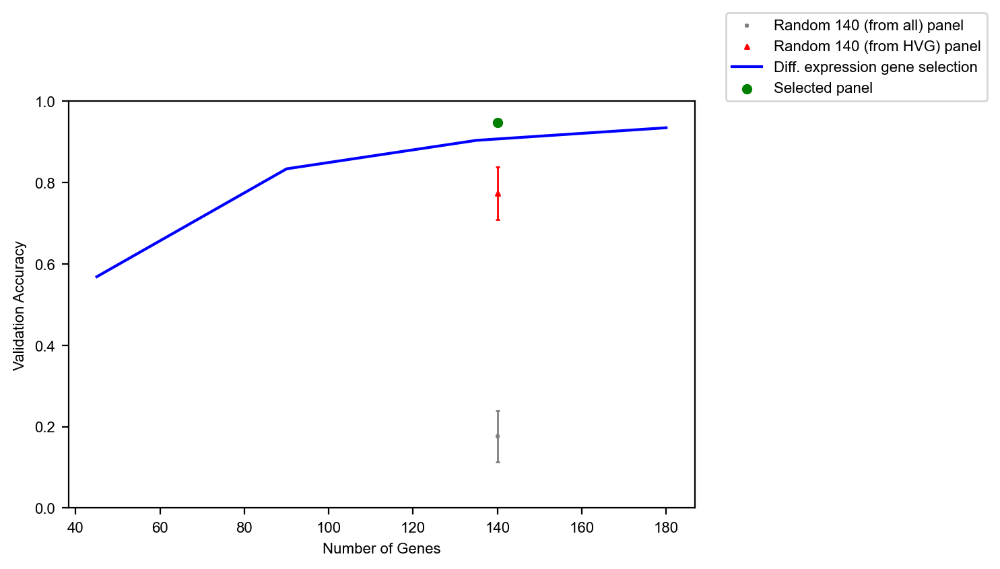

In [118]:
n_genes=140
with sns.plotting_context({'figure.dpi':200,'font.size':8,'font.sans-serif':'Arial'}):
    fig,ax=plt.subplots()
    label = f'Random {n_genes} (from all) panel'
    sns.lineplot(panel_df[panel_df['Group']==label],y='accuracy',x='n_genes',color='grey',errorbar='sd',err_style='bars',err_kws={'elinewidth':1,'capsize':1},ax=ax)
    ax.scatter(n_genes,panel_df[panel_df['Group']==label]['accuracy'].mean(),s=5,color='grey',label=label,marker='+')

    label = f'Random {n_genes} (from HVG) panel'
    sns.lineplot(panel_df[panel_df['Group']==label],y='accuracy',x='n_genes',color='red',errorbar='sd',err_style='bars',err_kws={'elinewidth':1,'capsize':1},ax=ax)
    plt.scatter(n_genes,panel_df[panel_df['Group']==label]['accuracy'].mean(),s=5,color='red',label=label,marker='^')

    label = 'Diff. expression gene selection'
    sns.lineplot(panel_df[panel_df['Group']==label],y='accuracy',x='n_genes',label=label,color='blue')

    label = 'Selected panel'
    sns.scatterplot(panel_df[panel_df['Group']==label],y='accuracy',x='n_genes',label=label,color='green')
    plt.legend(loc=(1.05,1))


    plt.ylim(0,1)
    plt.ylabel('Validation Accuracy')
    plt.xlabel('Number of Genes')
    plt.savefig(os.path.join(figure_dir,"Gene_Selection_Supp.pdf"),rasterized=True)

In [32]:
model_dir = os.path.join("models","rgc_atlas")
postfix=  "FORFIG"
n_genes = 140

import pickle
with open(os.path.join(model_dir,"train_dict_rgc{}.pickle{}".format(n_genes,postfix)),'rb') as f:
    train_dict = pickle.load(f)

labels = np.load(os.path.join(model_dir,"xgb_rgc{}{}_valid_y.npy".format(n_genes,postfix)))
probs = np.load(os.path.join(model_dir,"xgb_rgc{}{}_valid_y_probs.npy".format(n_genes,postfix)))

    
cutoffs= [0.2,0.3,0.4,0.5,0.6,0.7,0.8]
df,accuracies = calc_stats(probs,labels,train_dict,cutoffs=cutoffs)
df['F-score'] = 2*df['Precision']*df['Recall']/(df['Precision'] + df['Recall'])
dfp = df.melt(id_vars=['Cutoff','RGC Type'],var_name='Value',value_name='Metric',value_vars=['Recall','Precision','F-score'])



['C1', 'C2', 'C3', 'C4', 'C5', 'C6', 'C7', 'C8', 'C9', 'C10', 'C11', 'C12', 'C13', 'C14', 'C15', 'C16', 'C17', 'C18', 'C19', 'C20', 'C21', 'C22', 'C23', 'C24', 'C25', 'C26', 'C27', 'C28', 'C29', 'C30', 'C31', 'C32', 'C33', 'C34', 'C35', 'C36', 'C37', 'C38', 'C39', 'C40', 'C41', 'C42', 'C43', 'C44', 'C45', 'Unassigned']
Overall accuracy 0.9521246052253804
Overall accuracy 0.9515503875968992
Overall accuracy 0.950473729543497
Overall accuracy 0.9478897502153316
Overall accuracy 0.9394918173987942
Overall accuracy 0.9302325581395349
Overall accuracy 0.9198248636233133


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_11164/2355042584.py:17: RuntimeWarning: invalid value encountered in true_divide
  recall = tp/tpfn
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_11164/2355042584.py:17: RuntimeWarning: invalid value encountered in true_divide
  recall = tp/tpfn
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_11164/2355042584.py:17: RuntimeWarning: invalid value encountered in true_divide
  recall = tp/tpfn
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_11164/2355042584.py:17: RuntimeWarning: invalid value encountered in true_divide
  recall = tp/tpfn
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_11164/2355042584.py:17: RuntimeWarning: invalid value encountered in true_divide
  recall = tp/tpfn
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_11164/2355042584.py:17: RuntimeWarning: invalid value encountered in true_divide
  recall = tp/tpfn
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn

In [34]:
from sklearn.metrics import confusion_matrix
def calc_stats(probs,labels,train_dict, cutoffs):
    unassigned_indicator = probs.shape[1]
    id_to_name = {v:k for k,v in train_dict.items()}
    ctypes = [id_to_name[i] for i in range(46)]
    print(ctypes)
    df_j = []
    accuracies = []
    for cutoff in cutoffs:
        preds = np.where(np.max(probs,axis=1) > cutoff,np.argmax(probs,axis=1),unassigned_indicator)
        accuracy =  np.sum(preds==labels)/probs.shape[0]
        print("Overall accuracy",  accuracy)
        conf = confusion_matrix(labels,preds)
        tp = np.diag(conf)#i=true,j=predicted
        tpfp = np.sum(conf,axis=0)
        tpfn = np.sum(conf,axis=1)
        recall = tp/tpfn
        precision = tp/tpfp
        #[:-1] to remove unassigned
        df = pd.DataFrame({'Recall':recall[:-1],'Precision':precision[:-1],'Cutoff':cutoff,'RGC Type':ctypes[:-1]})

        df_j.append(df)
        accuracies.append(accuracy)
    
    return pd.concat(df_j),accuracies
    

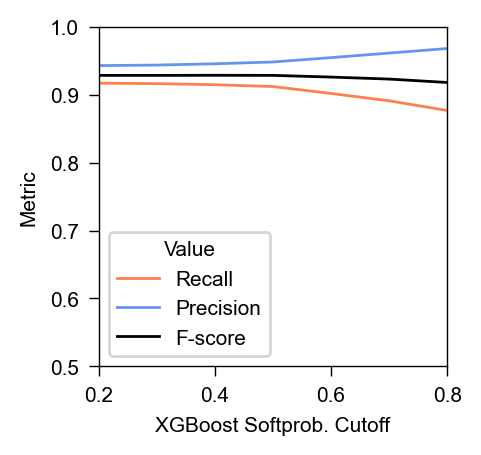

In [37]:
with sns.plotting_context({'figure.dpi':200,'font.sans-serif':'Arial','font.size':7.5}):
    fig,ax= plt.subplots(figsize=(2.25,2.25))
    for spine in ax.spines.values():
            spine.set_linewidth(0.5)
    ax.xaxis.set_tick_params(width=0.5)
    ax.yaxis.set_tick_params(width=0.5)
    sns.lineplot(dfp,x='Cutoff',y='Metric',hue='Value',palette={'Recall':'coral','Precision':'cornflowerblue','F-score':'black'},errorbar=None,ax=ax,linewidth=1)
    plt.ylim(0.5,1)
    plt.xlim(0.2,0.8)
    plt.xlabel('XGBoost Softprob. Cutoff')
    #sns.lineplot(x=cutoffs,y=accuracies,linewidth=1,color='black',label='Accuracy',ax=ax)
    plt.savefig(os.path.join(figure_dir,"Recall_Precision_F1.pdf"))
df.groupby('Cutoff')[['Precision','Recall']].mean()
dfp_c = dfp[dfp['Cutoff']==0.5]

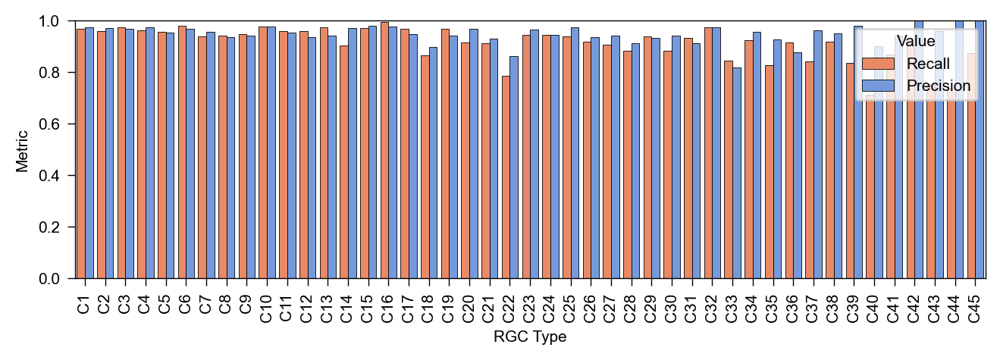

In [124]:

with sns.plotting_context({'figure.dpi':200,'font.sans-serif':'Arial','font.size':7.5}):
    fig,ax= plt.subplots(figsize=(7.75,2.25))
    sns.barplot(dfp_c,x='RGC Type',y='Metric',hue='Value',palette={'Recall':'coral','Precision':'cornflowerblue'},edgecolor='black',linewidth=0.3)
    for spine in ax.spines.values():
            spine.set_linewidth(0.5)
    ax.xaxis.set_tick_params(width=0.5)
    ax.yaxis.set_tick_params(width=0.5)
    plt.ylim(0,1)
    plt.xticks(rotation=90);
    plt.savefig(os.path.join(figure_dir,"Recall_precision_by_class.pdf"))

## Figure 1F

Pixel coords: x=(2749,3328), y=(721,1300)
Minimum intensity: {self.min_intensity}, Maximum intensity:{self.max_intensity}
Saved image to: Paper/matplotlib_outputs/Figure_1/


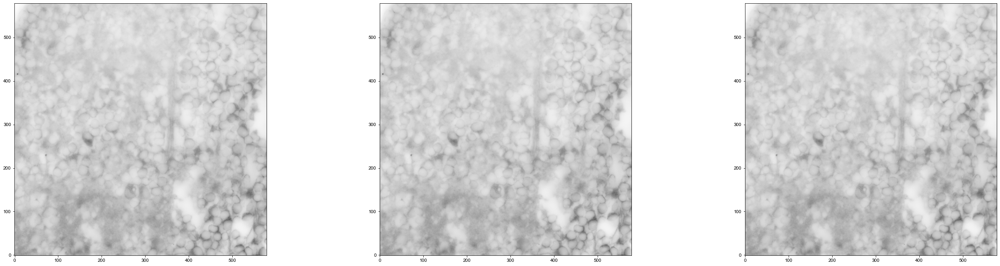

Saved image to: Paper/matplotlib_outputs/Figure_1/TEST: markers_showcase_z3_r1.png


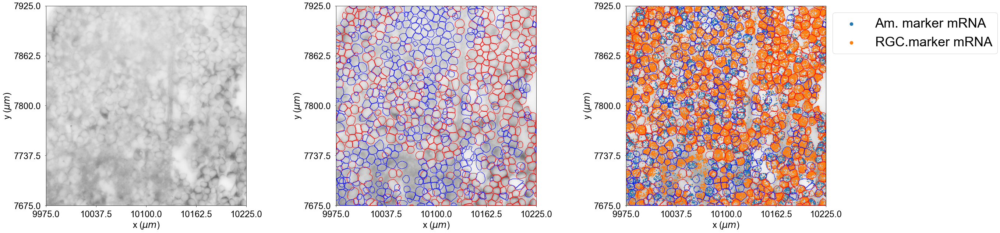

In [72]:
adata=sc.read_h5ad(os.path.join(data_dir,JOINT_ADATA))

importlib.reload(visualizer)
importlib.reload(rc)

run="140g_rn3"
region=1

run_id=int(re.search(r"140g_rn(.+)",run).group(1))
adata_e = extract_run_region(adata,run=run_id,region=region)
RGC_types = [f'C{i}' for i in range(1,46)]
adata_e.obs['types']=adata_e.obs['retina_class'].copy().cat.add_categories(RGC_types)
adata_e.obs['types'] = adata_e.obs.apply(lambda x: x['final_assignment'] if x['final_assignment'] in RGC_types else x['types'], axis=1)

for r_n in [1]:
    z=3
    id_postfix=f"rg{region}"
    v = get_region_visualizer(run=run,region=region,downsample_ratio=4)
    v.figure_dir=figure_dir


    cmap = plt.get_cmap('tab20')

    # [cmap(0),cmap(14),cmap(6), cmap(2)]
    types= adata_e[~adata_e.obs['types'].isin(RGC_types)].obs['types'].unique()
    colors = [i for i in range(len(types))]
    non_neuronal_coloring = {'Endothelial':1,'Astrocyte':6,'Muller glia':7, 'Pericyte':8,'Microglia':9}
    class_coloring = {'Non-neuronal':6}

    %matplotlib inline
    all_type_coloring = {ctype:i%20 for i,ctype in enumerate(adata.obs['final_assignment'])}
    all_type_coloring.pop('Amacrine')
    remaining_z = [0,1,2,4,6,7]
    v.visualize_transcripts(z=z,r_n=r_n, remaining_z=remaining_z, plot_masks=True, group_name="markers",stitch_color='blue',gene_groups={"Am. marker mRNA":["Tfap2a","Tfap2b","Chat"],"RGC.marker mRNA":["Pou4f1","Pou4f2","Slc17a6","Rbpms"],},s=3)


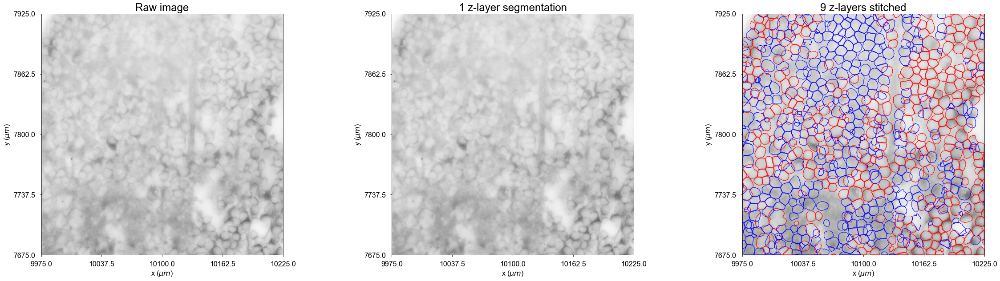

In [173]:
adata=sc.read_h5ad(os.path.join(data_dir,"merged_control_cluster_patched_v2.h5ad"))

importlib.reload(visualizer)
importlib.reload(rc)

run="140g_rn3"
region=1

run_id=int(re.search(r"140g_rn(.+)",run).group(1))
adata_e = extract_run_region(adata,run=run_id,region=region)
RGC_types = [f'C{i}' for i in range(1,46)]
adata_e.obs['types']=adata_e.obs['retina_class'].copy().cat.add_categories(RGC_types)
adata_e.obs['types'] = adata_e.obs.apply(lambda x: x['final_assignment'] if x['final_assignment'] in RGC_types else x['types'], axis=1)

for r_n in [1]:
    id_postfix=f"rg{region}"
    v = get_region_visualizer(run=run,region=region,downsample_ratio=4)
    v.figure_dir=figure_dir


    cmap = plt.get_cmap('tab20')
    #v.visualize_stitched_z(all_z=[3,7,6,5,4,2,1,0],select_z=3, r_n=1, cmap='Greys',stain='Cellbound2',stitch_palette={7:'red',6:'orange',5:'yellow',4:'green',3:'blue',2:'pink',1:'purple',0:'grey'},id_filter=None, plot_height=10,axis_fontsize=16,linewidth=1,axis_off=False,fname=None)
    v.visualize_stitched_z(all_z=[3,7,6,5,4,2,1,0],select_z=3, r_n=1, cmap='Greys',stain='Cellbound2',stitch_palette={7:'blue',6:'blue',5:'blue',4:'blue',3:'red',2:'blue',1:'blue',0:'blue'},id_filter=None, plot_height=10,axis_fontsize=16,linewidth=1,axis_off=False,fname="Paper_stitched.pdf")




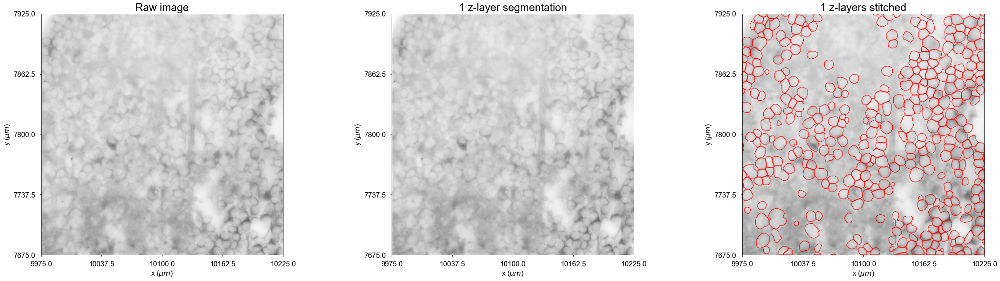

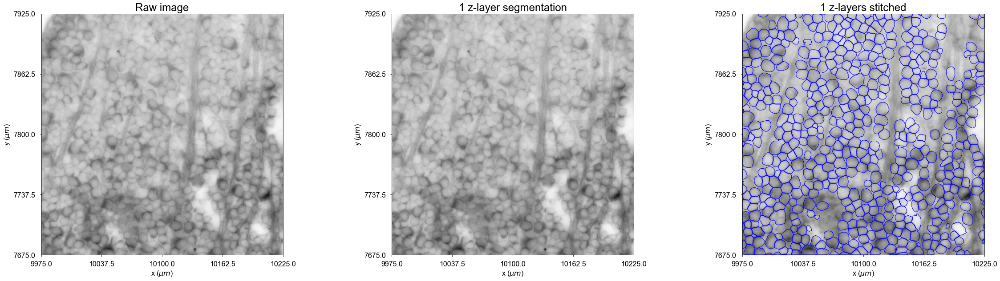

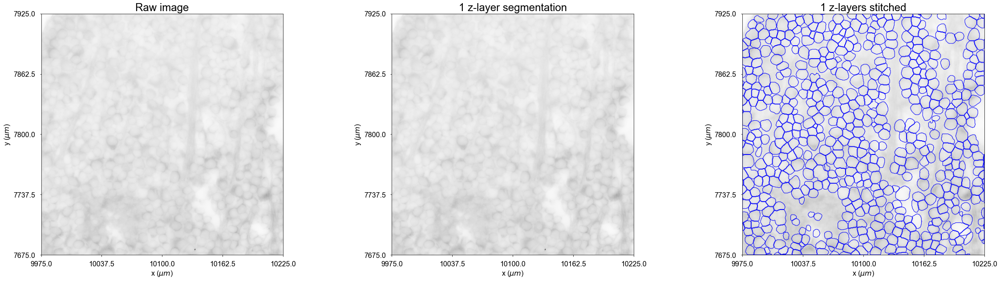

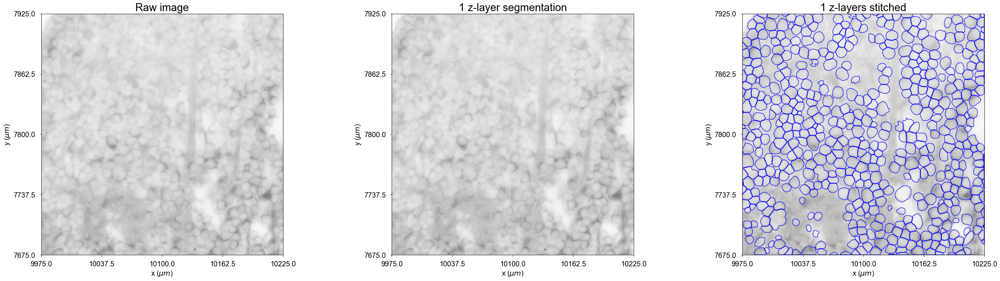

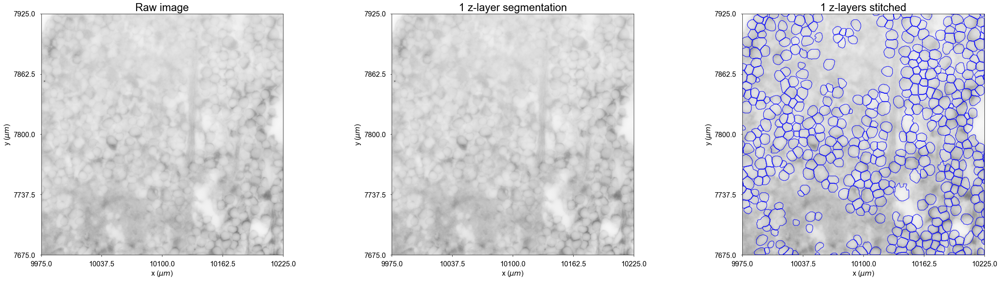

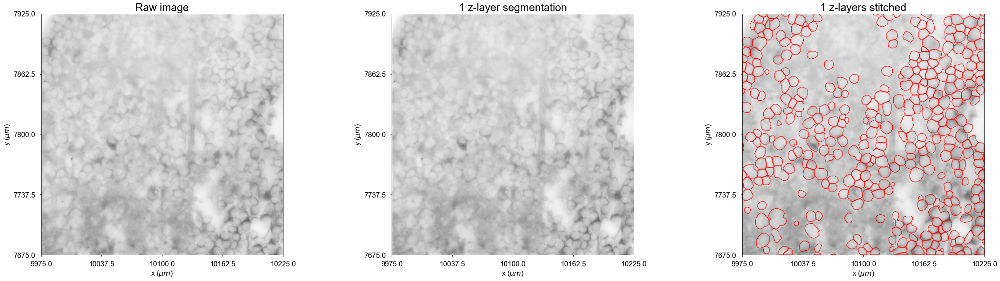

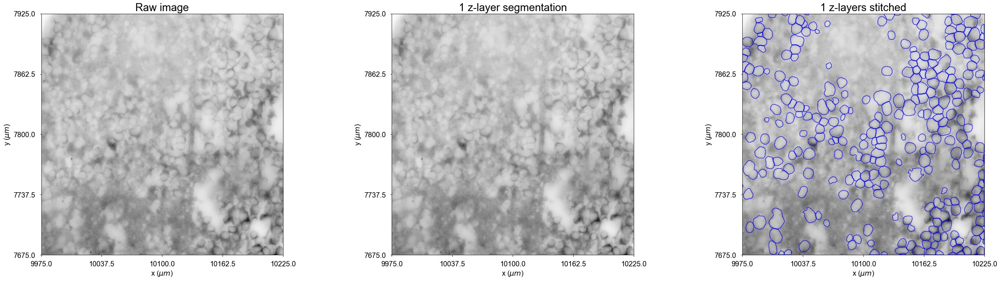

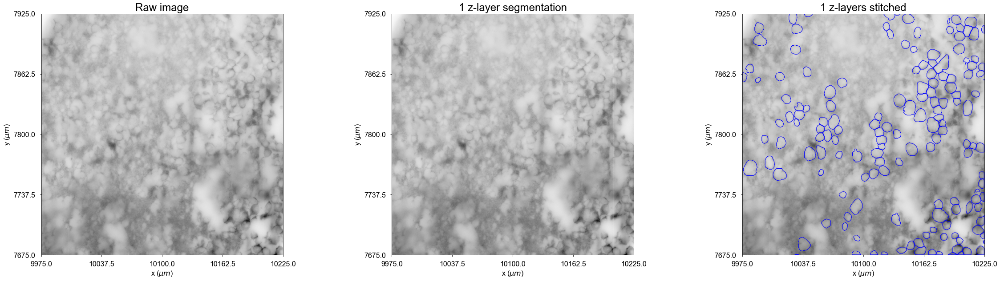

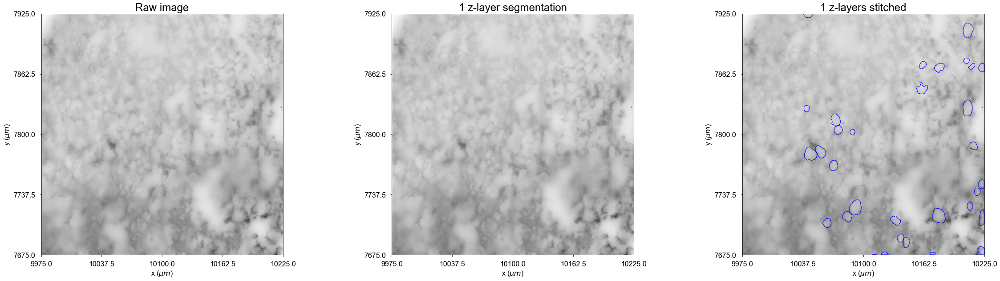

In [174]:

for r_n in [1]:
    id_postfix=f"rg{region}"
    v = get_region_visualizer(run=run,region=region,downsample_ratio=4)
    v.figure_dir=figure_dir


    cmap = plt.get_cmap('tab20')
    for z in [3,7,6,5,4,3,2,1,0]:
    #v.visualize_stitched_z(all_z=[3,7,6,5,4,2,1,0],select_z=3, r_n=1, cmap='Greys',stain='Cellbound2',stitch_palette={7:'red',6:'orange',5:'yellow',4:'green',3:'blue',2:'pink',1:'purple',0:'grey'},id_filter=None, plot_height=10,axis_fontsize=16,linewidth=1,axis_off=False,fname=None)
        v.visualize_stitched_z(all_z=[z],select_z=z, r_n=1, cmap='Greys',stain='Cellbound2',stitch_palette={7:'blue',6:'blue',5:'blue',4:'blue',3:'red',2:'blue',1:'blue',0:'blue'},id_filter=None, plot_height=10,axis_fontsize=16,linewidth=1,axis_off=False,fname=f"Paper_z{z}.pdf")



In [ ]:

v.visualize_stitched_z(all_z=[0,1,2,3,4,5,6,7],select_z=3, r_n=1, cmap='Greys',stain='Cellbound2',stitch_palette={7:'blue',6:'blue',5:'blue',4:'blue',3:'red',2:'blue',1:'blue',0:'blue'},id_filter=None, plot_height=10,axis_fontsize=16,linewidth=1,axis_off=False,fname=None)


In [ ]:
def extract_run_region(adata,run,region):#Takes meregd control and extracts run and region needed for visualizdation
    adata = adata[(adata.obs['run']==run) & (adata.obs['region']==region)]
    adata.obs.index=['_'.join(idx.split("_")[0:2]) for idx in adata.obs.index.values]
    return adata.copy()


def get_region_visualizer(run,region=0,downsample_ratio=4):
        subdirectory = f"{run}_rg{region}"
        stitched_m = np.load(os.path.join("data",subdirectory, "stitched_masks_c2knl_full_retina_comb.npy"))
        micron_regions = rc.RN_REGIONS[subdirectory]
        v= visualizer.Visualizer(micron_regions,stitched_m, downsample_ratio,"imaging_scripts",subdirectory)
        return v

## Figure 1G,1H, S1D

Saved image to: Paper/matplotlib_outputs/Figure_1/Paper_subtypes_-.pdf


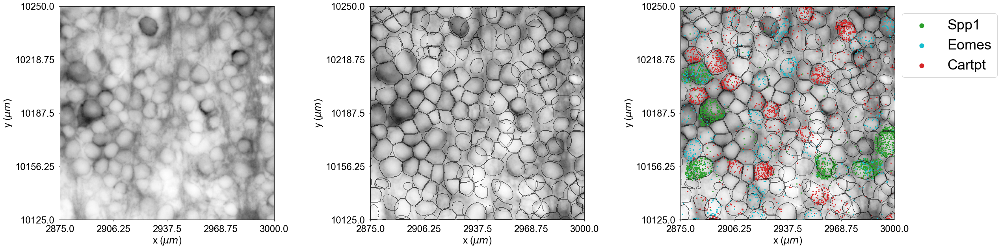

In [37]:
adata=sc.read_h5ad(os.path.join(data_dir,JOINT_ADATA))

importlib.reload(visualizer)
importlib.reload(rc)

run="140g_rn3"
region=0

run_id=int(re.search(r"140g_rn(.+)",run).group(1))
adata_e = extract_run_region(adata,run=run_id,region=region)
RGC_types = [f'C{i}' for i in range(1,46)]
adata_e.obs['types']=adata_e.obs['retina_class'].copy().cat.add_categories(RGC_types)
adata_e.obs['types'] = adata_e.obs.apply(lambda x: x['final_assignment'] if x['final_assignment'] in RGC_types else x['types'], axis=1)

for r_n in [10]:
    z=7
    id_postfix=f"rg{region}"
    v = get_region_visualizer(run=run,region=region,downsample_ratio=4)
    v.figure_dir=figure_dir


    cmap = plt.get_cmap('tab20')

    # [cmap(0),cmap(14),cmap(6), cmap(2)]
    types= adata_e[~adata_e.obs['types'].isin(RGC_types)].obs['types'].unique()
    colors = [i for i in range(len(types))]
    non_neuronal_coloring = {'Endothelial':1,'Astrocyte':6,'Muller glia':7, 'Pericyte':8,'Microglia':9}
    class_coloring = {'Non-neuronal':6}
    #adata_r=adata[(adata.obs['class']=='N/A') & (adata.obs['region']==region)]
    #id_filter= set([int(i.split('_')[0]) for i in adata_r.obs.index])
    %matplotlib inline
    #v.visualize_area(z=z,r_n=r_n,plot_masks=False,stain="Cellbound2",train_sample=None,vmin=None,vmax=None,fname=f"")
    all_type_coloring = {ctype:i%20 for i,ctype in enumerate(adata.obs['final_assignment'])}
    all_type_coloring.pop('Amacrine')
    #'Endo':['Tagln2','Klf2','Anxa3'],'Astro':['S100b','Igfbp5','Sox2']
    #v.visualize_area(z,r_n,plot_masks=False,stain="Cellbound2",axis_fontsize=24, origin='lower',train_sample=None,vmin=None,cmap='Greys',micron_input=True,vmax=None,adjust_axes=False,invert_yaxis=False,fname="")
    #v.visualize_transcripts(z=z,r_n=r_n, remaining_z=[0,1,2,3,4,6,7], plot_masks=True, group_name="markers",stitch_color='blue',gene_groups={"Am. marker mRNA":["Tfap2a","Tfap2b","Chat"],"RGC.marker mRNA":["Pou4f1","Pou4f2","Slc17a6","Rbpms"],},s=3)
    remaining_z = [0,1,2,3,4,5,6]
    
    v.visualize_transcripts(z=z,r_n=r_n, remaining_z=remaining_z, plot_masks=True, group_name="markers",orig_seg_color='black',stitch_color='black',linewidth=0.75,gene_groups={"RGC_mar":['Rbpms','Slc17a6'], 'dAC':['Chat','Tfap2a','Tfap2b']},color_groups={"RGC_mar":cmap(2),'dAC':cmap(0)},s=5,fname="Paper_subclasses.pdf")
    v.visualize_transcripts(z=z,r_n=r_n, remaining_z=remaining_z, plot_masks=True, group_name="markers",orig_seg_color='black',stitch_color='black', linewidth=0.75,gene_groups={"Spp1":['Spp1'],'Eomes':['Opn4','Eomes'],'Cartpt':['Cartpt']},color_groups={'Spp1':cmap(4),'Cartpt':cmap(6),'Eomes':cmap(18)},s=5,fname="Paper_subtypes_-.pdf")


## S1A-C

In [7]:
model_dir = os.path.join(BASE_DIR,"models","rgc_atlas")
postfix=  "FORFIG"


import pickle
with open(os.path.join(model_dir,"train_dict_rgc130.pickle{}".format(postfix)),'rb') as f:
    train_dict = pickle.load(f)

labels = np.load(os.path.join(model_dir,"xgb_rgc130{}_valid_y.npy".format(postfix)))
probs = np.load(os.path.join(model_dir,"xgb_rgc130{}_valid_y_probs.npy".format(postfix)))

In [81]:
from sklearn.metrics import confusion_matrix
def calc_stats(probs,labels,train_dict, cutoffs):
    unassigned_indicator = probs.shape[1]
    id_to_name = {v:k for k,v in train_dict.items()}
    ctypes = [id_to_name[i] for i in range(46)]
    print(ctypes)
    df_j = []
    accuracies = []
    for cutoff in cutoffs:
        preds = np.where(np.max(probs,axis=1) > cutoff,np.argmax(probs,axis=1),unassigned_indicator)
        accuracy =  np.sum(preds==labels)/probs.shape[0]
        print("Overall accuracy",  accuracy)
        conf = confusion_matrix(labels,preds)
        tp = np.diag(conf)#i=true,j=predicted
        tpfp = np.sum(conf,axis=0)
        tpfn = np.sum(conf,axis=1)
        recall = tp/tpfn
        precision = tp/tpfp
        #[:-1] to remove unassigned
        df = pd.DataFrame({'Recall':recall[:-1],'Precision':precision[:-1],'Cutoff':cutoff,'RGC Type':ctypes[:-1]})

        df_j.append(df)
        accuracies.append(accuracy)
    
    return pd.concat(df_j),accuracies
    
    
cutoffs= [0.2,0.3,0.4,0.5,0.6,0.7,0.8]
df,accuracies = calc_stats(probs,labels,train_dict,cutoffs=cutoffs)
dfp = df.melt(id_vars=['Cutoff','RGC Type'],var_name='Value',value_name='Metric',value_vars=['Recall','Precision'])

['C1', 'C2', 'C3', 'C4', 'C5', 'C6', 'C7', 'C8', 'C9', 'C10', 'C11', 'C12', 'C13', 'C14', 'C15', 'C16', 'C17', 'C18', 'C19', 'C20', 'C21', 'C22', 'C23', 'C24', 'C25', 'C26', 'C27', 'C28', 'C29', 'C30', 'C31', 'C32', 'C33', 'C34', 'C35', 'C36', 'C37', 'C38', 'C39', 'C40', 'C41', 'C42', 'C43', 'C44', 'C45', 'Unassigned']
Overall accuracy 0.9455211024978467
Overall accuracy 0.9449468848693655
Overall accuracy 0.9436548952052828
Overall accuracy 0.9417169107091587
Overall accuracy 0.9343956359460236
Overall accuracy 0.9260694803330463
Overall accuracy 0.9136520241171404


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_13430/2046363599.py:17: RuntimeWarning: invalid value encountered in true_divide
  recall = tp/tpfn
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_13430/2046363599.py:17: RuntimeWarning: invalid value encountered in true_divide
  recall = tp/tpfn
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_13430/2046363599.py:17: RuntimeWarning: invalid value encountered in true_divide
  recall = tp/tpfn
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_13430/2046363599.py:17: RuntimeWarning: invalid value encountered in true_divide
  recall = tp/tpfn
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_13430/2046363599.py:17: RuntimeWarning: invalid value encountered in true_divide
  recall = tp/tpfn
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_13430/2046363599.py:17: RuntimeWarning: invalid value encountered in true_divide
  recall = tp/tpfn
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn

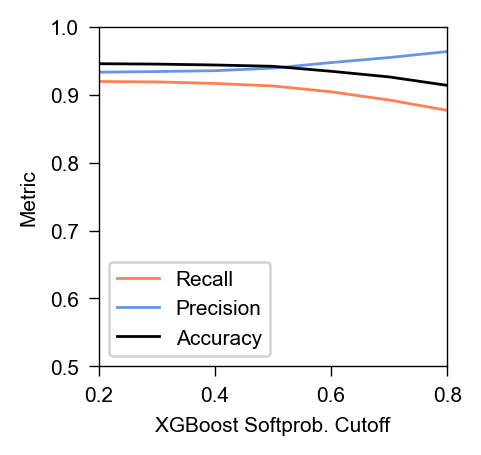

In [96]:
with sns.plotting_context({'figure.dpi':200,'font.sans-serif':'Arial','font.size':7.5}):
    fig,ax= plt.subplots(figsize=(2.25,2.25))
    for spine in ax.spines.values():
            spine.set_linewidth(0.5)
    ax.xaxis.set_tick_params(width=0.5)
    ax.yaxis.set_tick_params(width=0.5)
    sns.lineplot(dfp,x='Cutoff',y='Metric',hue='Value',palette={'Recall':'coral','Precision':'cornflowerblue'},errorbar=None,ax=ax,linewidth=1)
    plt.ylim(0.5,1)
    plt.xlim(0.2,0.8)
    plt.xlabel('XGBoost Softprob. Cutoff')
    sns.lineplot(x=cutoffs,y=accuracies,linewidth=1,color='black',label='Accuracy',ax=ax)
    plt.savefig(os.path.join(figure_dir,"Recall_Precision_Accuracy.pdf"))

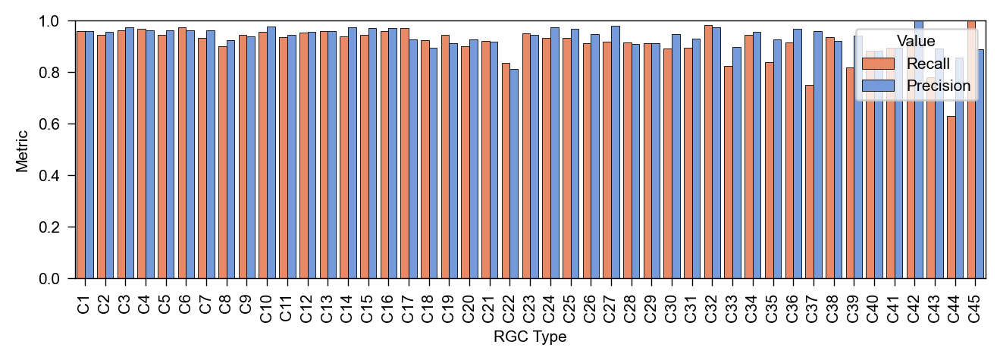

In [73]:
dfp_c = dfp[dfp['Cutoff']==0.5]

with sns.plotting_context({'figure.dpi':200,'font.sans-serif':'Arial','font.size':7.5}):
    fig,ax= plt.subplots(figsize=(7.75,2.25))
    sns.barplot(dfp_c,x='RGC Type',y='Metric',hue='Value',palette={'Recall':'coral','Precision':'cornflowerblue'},edgecolor='black',linewidth=0.3)
    for spine in ax.spines.values():
            spine.set_linewidth(0.5)
    ax.xaxis.set_tick_params(width=0.5)
    ax.yaxis.set_tick_params(width=0.5)
    plt.ylim(0,1)
    plt.xticks(rotation=90);
    plt.savefig(os.path.join(figure_dir,"Recall_precision_by_class.pdf"))

## Figure S1E

In [47]:
from matplotlib.lines import Line2D
def _create_aligner(alignment,stain,im_dir):
    f_paths = []
    centers= {} 
    rotations=[]
    for i,subdirectory in enumerate(alignment):
        if "center" in alignment[subdirectory]:
            center = alignment[subdirectory]["center"]
            centers[i] = center
        dr =  alignment[subdirectory]["downsample_ratio"]
        z = alignment[subdirectory]["z"]
        f = os.path.join(im_dir, subdirectory, f"mosaic_{stain}_z{z}_dr{dr}.tif")
        f_paths.append(f)
        rotations.append(alignment[subdirectory]["rotation"]) # Rotations is in terms of micron pic
    rotations = np.array(rotations)
    

    a=aligner.Aligner(f_paths,centers=centers,rotations=360-rotations) # Convert to img_rotation
    return a

def _extract_dir_region(subdirectory,base_dir): #base_dir is abs path to dir containing subdirectory as child
    num_genes,run,region = subdirectory.split("_")
    run_dir= num_genes + "_" + run
    figure_dir = os.path.join(base_dir,run_dir)
    if not os.path.isdir(figure_dir):
        os.mkdir(figure_dir)

    return figure_dir

def visualize_image(alignment, stain, indices,im_dir,visualize=True,overlay=False,figure_dir="spatial_figures",run="140g_rn3",invert_xaxis=False,invert_yaxis=False):
    a = _create_aligner(alignment,stain,im_dir)
    save_f = os.path.join(figure_dir,f"{run}_aligned_{stain}.png")

    if visualize:
        a.visualize(indices,run=run,figure_dir=figure_dir)
    if overlay:
        #output_dir = _extract_dir_region(a.subdirectories[0],figure_dir)
        #print(output_dir)
        print(save_f)
        a.overlay_images(0,indices,save_f=save_f,run=run,invert_xaxis=invert_xaxis,invert_yaxis=invert_yaxis)

def visualize_RGCs(alignment,stain,im_dir,anndata_dir, indices=None,figure_dir="spatial_figures",save_combined=True):
    a= _create_aligner(alignment,stain,im_dir)
    base_idx = 0
    translations = []

    for i,subdirectory in enumerate(alignment):
        print(i,subdirectory)
        if indices is not None and i not in indices:
            continue
        dr = alignment[subdirectory]["downsample_ratio"]
        mer = sc.read_h5ad(os.path.join(anndata_dir,subdirectory,"RGC_only.h5ad"))
        t = a.get_align_transform(base_idx,i,dr=dr)
        translations.append(t)
        rot_degree=(360-a.rotations[i]) # a.rotations is in pixels, convert to respect to micron orientation
        M = aligner.rotation_matrix(rot_degree)
        transf = mer.obs[['center_x','center_y']].values+[t[0], t[1]] - a.centers_micron[base_idx]
        transf = (M@ transf.T).T + a.centers_micron[base_idx]

        region = subdirectory.split("_")[2]
        plt.scatter(transf[:,0],transf[:,1],s=0.05,label=region)
        print(transf)
    plt.legend()

    output_dir = _extract_dir_region(subdirectory,figure_dir)
    plt.gca().invert_yaxis()
    plt.legend(markerscale=20)
    plt.savefig(os.path.join(output_dir,"aligned_regions.png"))
    plt.show()
    

{0: (2540, 3560), 1: (2970, 3830), 2: (3800, 4600), 3: (4200, 5000)}


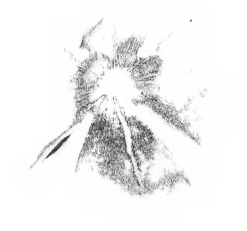

{0: (2540, 3560), 1: (2970, 3830), 2: (3800, 4600), 3: (4200, 5000)}


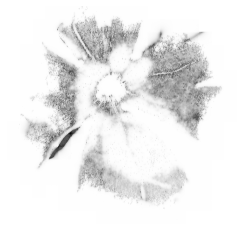

{0: (2540, 3560), 1: (2970, 3830), 2: (3800, 4600), 3: (4200, 5000)}


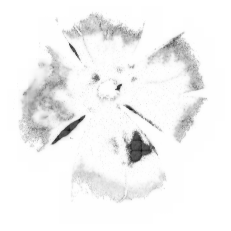

{0: (2540, 3560), 1: (2970, 3830), 2: (3800, 4600), 3: (4200, 5000)}


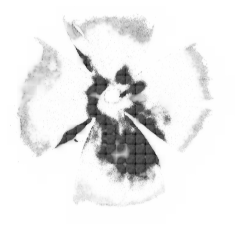

../../spatial_rgc/figures/Figure_1/140g_rn3_aligned_DAPI.png


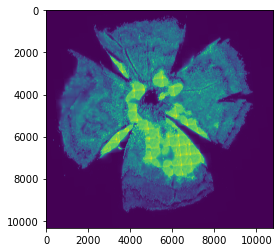

{0: (2540, 3560), 1: (2970, 3830), 2: (3800, 4600), 3: (4200, 5000)}


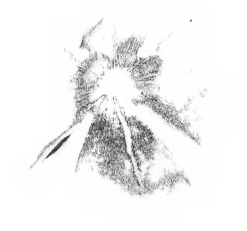

{0: (2540, 3560), 1: (2970, 3830), 2: (3800, 4600), 3: (4200, 5000)}


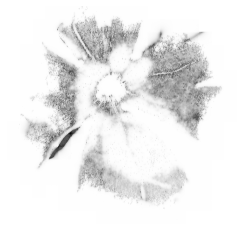

{0: (2540, 3560), 1: (2970, 3830), 2: (3800, 4600), 3: (4200, 5000)}


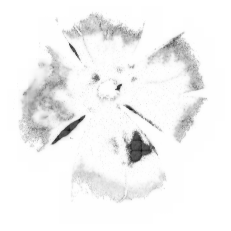

{0: (2540, 3560), 1: (2970, 3830), 2: (3800, 4600), 3: (4200, 5000)}


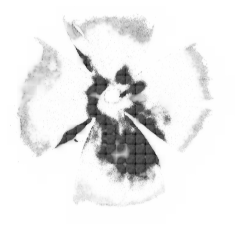

../../spatial_rgc/figures/Figure_1/140g_rn4_aligned_DAPI.png


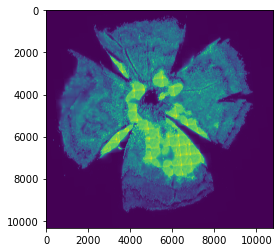

{0: (3375, 3175), 1: (3950, 4100), 2: (4300, 4700), 3: (4950, 5550)}


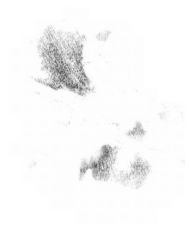

{0: (3375, 3175), 1: (3950, 4100), 2: (4300, 4700), 3: (4950, 5550)}


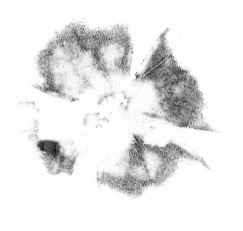

{0: (3375, 3175), 1: (3950, 4100), 2: (4300, 4700), 3: (4950, 5550)}


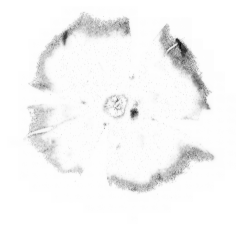

{0: (3375, 3175), 1: (3950, 4100), 2: (4300, 4700), 3: (4950, 5550)}


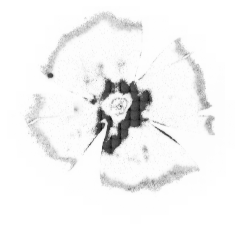

../../spatial_rgc/figures/Figure_1/140g_rn5_aligned_DAPI.png


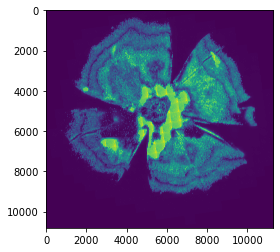

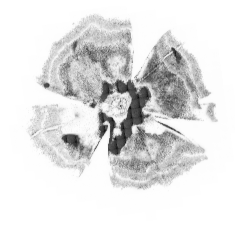

In [48]:
import spatial_rgc.utils.rconstants as rc
import importlib
import spatial_rgc.utils.aligner as aligner
importlib.reload(aligner)
importlib.reload(rc)

import numpy as np
indices = [0,1,2,3]
for run,alignment_group, dict_idx in zip([3,4,5],[rc.DAPI_ALIGNMENTS,rc.DAPI_ALIGNMENTS,rc.CELLBOUND2_ALIGNMENTS],[0,0,1]):
    alignment = rc.DAPI_ALIGNMENTS[dict_idx]
    stain = "DAPI"
    IM_DIR = os.path.join(BASE_DIR, "imaging_scripts","images") # In this case the images are "data"
    visualize_image(alignment,stain,indices,IM_DIR,visualize=True,overlay=True,run=f"140g_rn{run}",figure_dir=figure_dir,invert_yaxis=False,invert_xaxis=False)

## Figure S1F

In [199]:
import json

with open(os.path.join(BASE_DIR,"data","MER_splines",'spline_coordinates.json')) as f:
    spline = json.load(f)


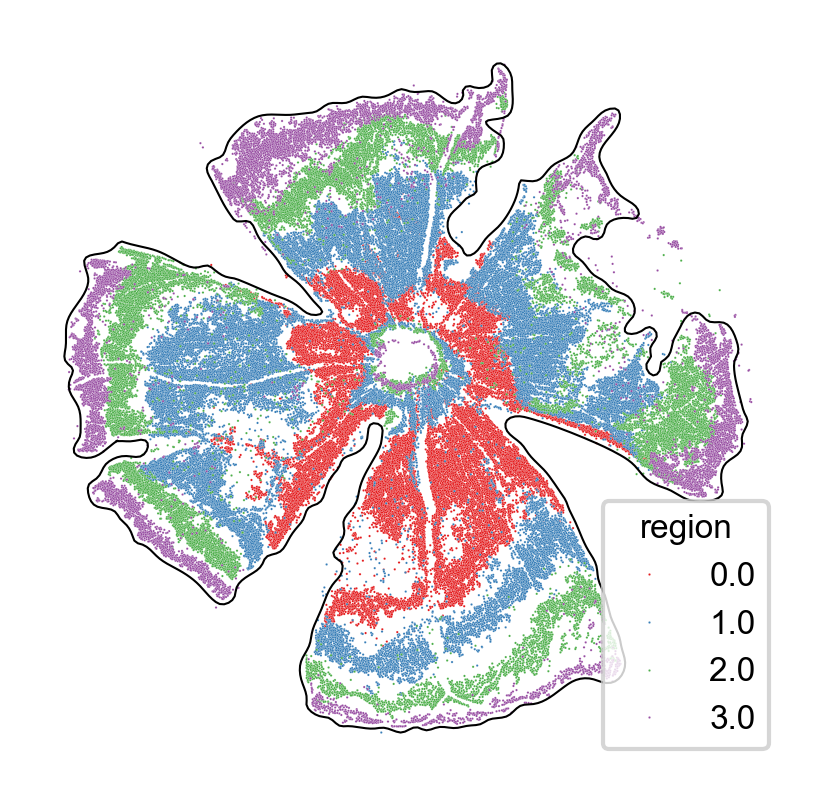

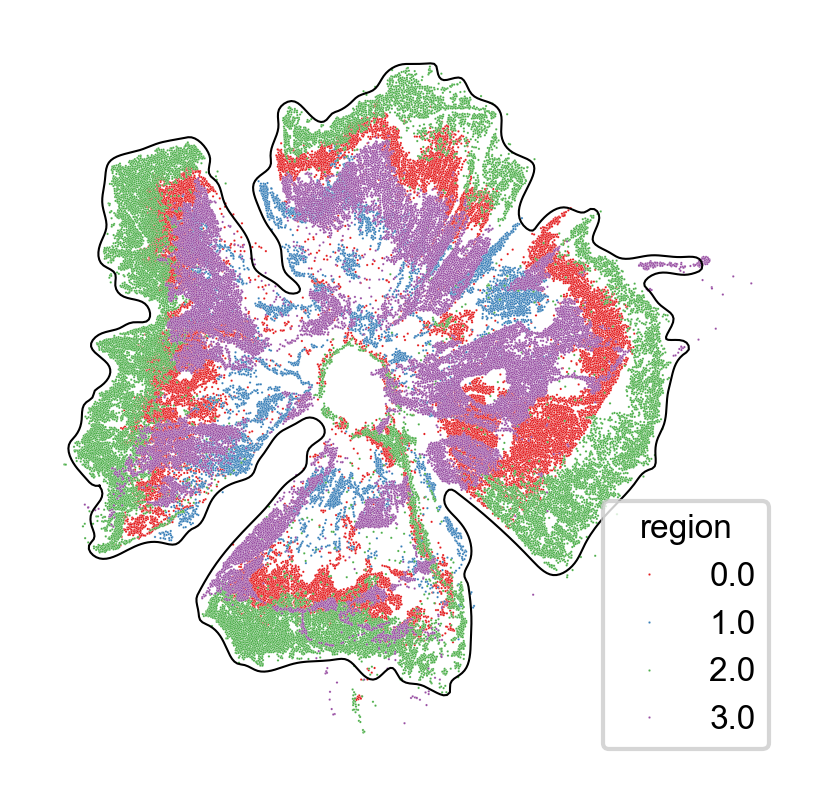

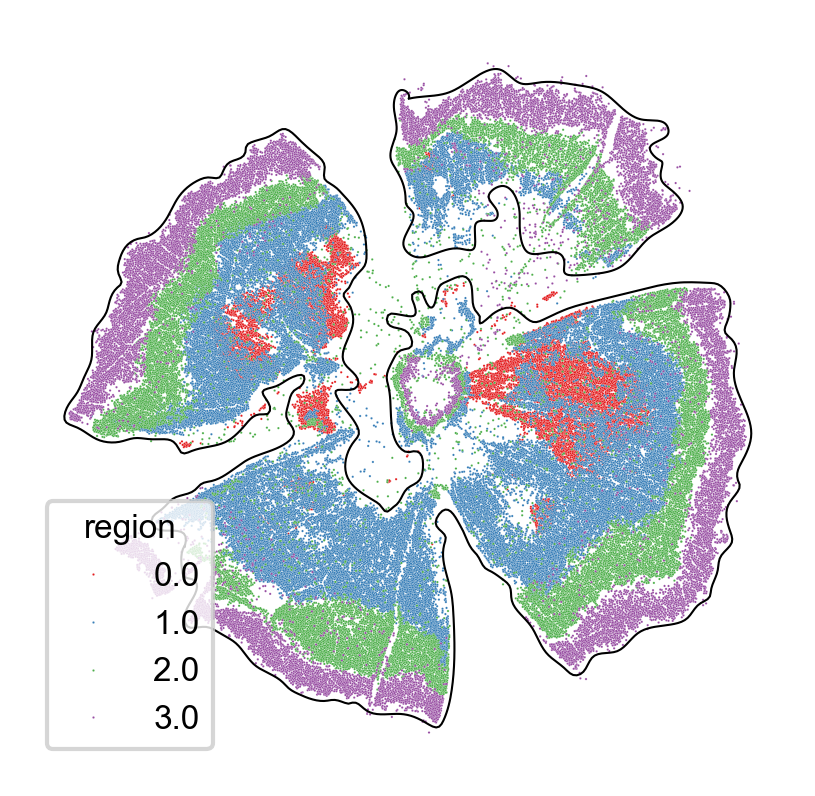

In [44]:
for run,ver in zip([3,4,5],["","","_v1"]):
    spline_r = spline[f"rn{run}{ver}"]
    with plt.rc_context({'figure.dpi':300,'figure.figsize':(3.25,3.25),'font.sans-serif':'Arial','font.size':8}):
        ax = sns.scatterplot(adata.obs[adata.obs['run']==run],x='final_x',y='final_y',hue='region',palette='Set1',s=0.3,rasterized=True)
        for boundary in spline_r:
            boundary = np.array(boundary)
            ax.plot(boundary[:,0],boundary[:,1],linewidth=0.5,color='black')
        ax.set_axis_off()
        plt.savefig(os.path.join(figure_dir,"Retina_{}_sections.pdf".format(run)))
        plt.show()

## Figure S1G

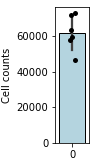

In [24]:
counts_df = pd.DataFrame(adata.obs.groupby('run').size())
fig,ax= plt.subplots(figsize=(0.6,2.5))
with plt.rc_context({'font.sans-serif':'Arial','font.size':7}):
    sns.barplot(counts_df,color='lightblue',ax=ax,edgecolor='black',errorbar=('sd',1))
    sns.stripplot(counts_df,color='black',ax=ax)
    plt.xlabel('')
    plt.ylabel('Cell counts')
    plt.savefig(os.path.join(figure_dir,"Cell_counts.pdf"))

# Figure 2 

In [96]:
figure_dir=os.path.join(BASE_DIR,"figures","Figure_2")
data_dir=os.path.join(BASE_DIR,"data","control_130_6")

adata=sc.read_h5ad(os.path.join(data_dir,JOINT_ADATA))
suffix=""
class_col = f"class{suffix}"
adata.obs['class_abbrev'] = adata.obs[class_col].map(ABBREV_MAP)


In [97]:
print(adata.obs.groupby(class_col)['counts'].mean())
print(adata.obs.groupby(class_col)['counts'].std())
print(adata.obs['joint_leiden'].value_counts()['0']/adata.obs[class_col].value_counts()['Amacrine'])#SAC

print(adata.obs[class_col].value_counts(normalize=True)[['RGC','Amacrine','Low quality neuronal']].sum())

class
Amacrine                141.298981
Low quality neuronal    198.024551
Non-neuronal             65.455025
RGC                     311.908722
Name: counts, dtype: float32
class
Amacrine                106.144617
Low quality neuronal    282.802285
Non-neuronal             66.306989
RGC                     229.373843
Name: counts, dtype: float64
0.31398068645925753
0.9320723635512081


In [98]:
adata_nn = adata.obs[adata.obs[class_col] != 'Non-neuronal']
adata_nn[class_col].value_counts(normalize=True)



RGC                     0.488776
Amacrine                0.393849
Low quality neuronal    0.117374
Non-neuronal            0.000000
Name: class, dtype: float64

## Figure 2A-C

In [99]:
def make_umap(adata, RUN_MAP, batch_palette,col='class',figure_dir= os.path.join("comparative_figures","control_130"),plot_classes=False, plot_batches=False,plot_type_markers=False):
    
    with plt.rc_context({"figure.dpi":300,"legend.fontsize":9,"font.sans-serif":"Arial"}):
        cmap = plt.get_cmap('tab20')
        if plot_classes:
            sc.pl.umap(adata,color=col,palette=CLASS_PALETTE,show=False)
            plt.title("")
            plt.legend(loc=(0,1.02),mode="expand",ncol=2)
            plt.savefig(os.path.join(figure_dir, f"class_umap{suffix}.pdf"))
            plt.show()

        adata.obs['run_name']=adata.obs['run'].apply(lambda x: RUN_MAP[x])
        sc.pp.subsample(adata,fraction=1,copy=False)

        if plot_batches:
            sc.pl.umap(adata,color='run_name', palette=batch_palette,show=False)
            plt.title("")
            plt.legend(loc=(0,1.02),mode="expand",ncol=2)

            plt.savefig(os.path.join(figure_dir,"batch_clustering.pdf"),bbox_inches='tight')
            plt.show()

        if plot_type_markers:
            cmap='Greys'
            RGC_MARKERS = ["Rbpms", "Pou4f1", "Pou4f2", "Slc17a6"]

            ENDO_MARKERS = ['Tagln2','Klf2','Anxa3']
            adata.obs['Endo_marker_sum'] = np.array(np.sum(adata[:,ENDO_MARKERS].layers['raw'],axis=1))
            sc.pl.umap(adata,color='Endo_marker_sum',show=False,cmap=cmap,vmin=0,vmax=20)
            plt.title(f"Sum of {', '.join(ENDO_MARKERS)}")
            plt.savefig(os.path.join(figure_dir,"Endothelial.pdf"))
            plt.show()
            
            adata.obs['RGC_marker_sum'] = np.array(np.sum(adata[:,RGC_MARKERS].layers['raw'],axis=1))
            sc.pl.umap(adata,color='RGC_marker_sum',show=False,vmin=0,vmax=30,cmap=cmap)
            plt.title(f"Sum of {', '.join(RGC_MARKERS)}")
            plt.savefig(os.path.join(figure_dir,"RGC_markers.pdf"),bbox_inches='tight')
            plt.show()

            AMACRINE_MARKERS = ['Chat','Tfap2a','Tfap2b']
            adata.obs['Amacrine_marker_sum'] = np.array(np.sum(adata[:,AMACRINE_MARKERS].layers['raw'],axis=1))
            sc.pl.umap(adata,color='Amacrine_marker_sum',show=False,vmin=0,vmax=20,cmap=cmap)
            plt.title(f"Sum of {', '.join(AMACRINE_MARKERS)}")
            plt.savefig(os.path.join(figure_dir,"amacrine_markers.pdf"),bbox_inches='tight')
            plt.show()


            sc.pl.umap(adata,color='Chat',show=False,cmap=cmap,vmin=0)
            plt.savefig(os.path.join(figure_dir,"ChAT.pdf"))
            plt.show()

            sc.pl.umap(adata,color='joint_leiden',show=False)
            plt.savefig(os.path.join(figure_dir,"joint_leiden.png"))
            plt.show()



def plot_QC_metrics(adata,figure_dir):
    with plt.rc_context({"figure.figsize":[12.0,8.0], "figure.dpi":300, "font.sans-serif":'Arial',"font.family":"sans-serif","font.size":16}):
        adata.obs['n_genes'] = np.sum(adata.layers['raw']>0,axis=1)
        sc.pl.violin(adata,keys='n_genes',groupby='class',palette='tab20',show=False)
        plt.savefig(os.path.join(figure_dir,"class_violin.png"))
        sc.pl.violin(adata,keys='n_genes',groupby='joint_leiden',palette='tab20', show=False)
        plt.savefig(os.path.join(figure_dir,"leiden_violins.png"))
        plt.show()
        cmap=plt.get_cmap('tab20')
        sc.pl.umap(adata,color='joint_leiden', palette='tab20',show=False,s=3,legend_fontsize=12,legend_loc="on data")
        plt.savefig(os.path.join(figure_dir,"joint_leiden_umap.png"))
        plt.show()
        #sc.pl.umap(adata,color='class', palette={'Amacrine':cmap(0),'Other':cmap(1),"RGC":cmap(2)},show=False,s=3,legend_fontsize=12,legend_loc="on data")
        #plt.savefig(os.path.join(figure_dir,"class_leiden_umap.png"))

In [109]:
adata.obs[class_col].value_counts(normalize=True)

adata[adata.obs[class_col].isin(['RGC','Amacrine','Low quality neuronal'])].obs[class_col].value_counts(normalize=True)

RGC                     0.488776
Amacrine                0.393849
Low quality neuronal    0.117374
Name: class, dtype: float64

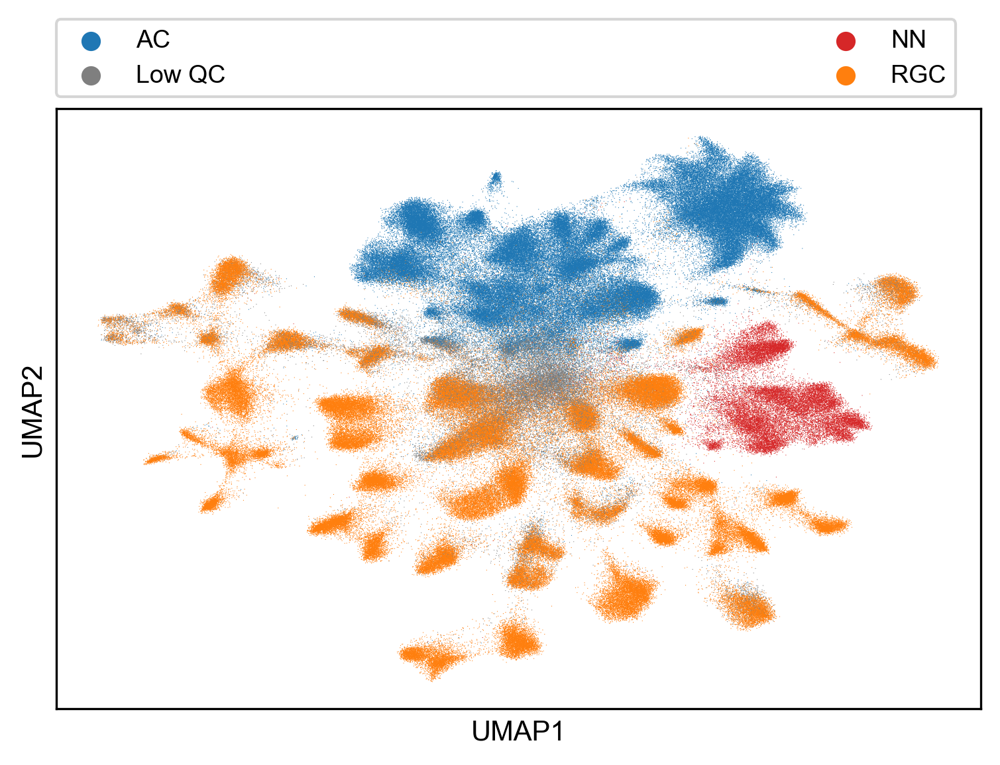

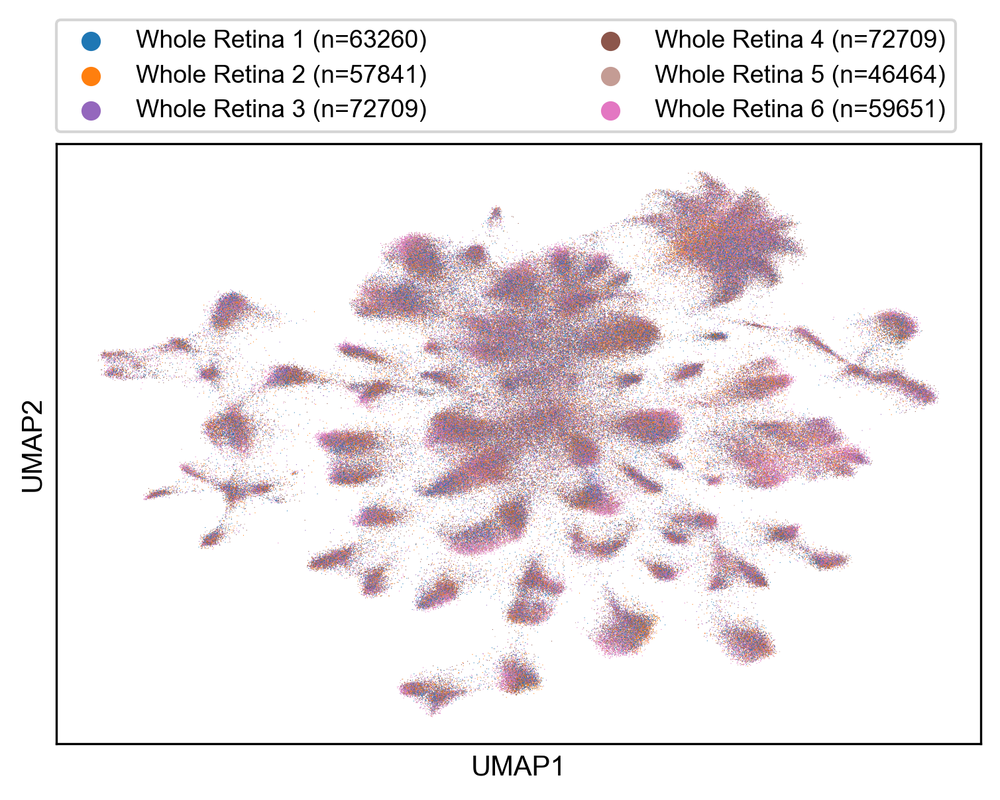

In [115]:
importlib.reload(rc)
importlib.reload(container)
sc._settings.settings._vector_friendly=True

ncounts = adata.obs['run'].value_counts()
RUN_MAP = {3:f"Whole Retina 1 (n={ncounts[3]})",4:f"Whole Retina 2 (n={ncounts[4]})",5:f"Whole Retina 3 (n={ncounts[5]})",7:f"Whole Retina 4 (n={ncounts[5]})",16:f"Whole Retina 5 (n={ncounts[16]})",17:f"Whole Retina 6 (n={ncounts[17]})"}
runs =["control_130_6"]
num_regions=[0,1,2,3]
cont = container.RunContainer(runs,base_dir=BASE_DIR,regions_lst=num_regions,RGC_cache_f="RGC_control.h5ad")
cmap= plt.get_cmap('tab20')
batch_palette = {RUN_MAP[3]:cmap(0),RUN_MAP[4]:cmap(2), RUN_MAP[5]:cmap(8),RUN_MAP[7]:cmap(10),RUN_MAP[16]:cmap(11),RUN_MAP[17]:cmap(12)}
make_umap(adata,RUN_MAP,col='class_abbrev',batch_palette=batch_palette,figure_dir=figure_dir,plot_classes=True,plot_batches=True)



In [112]:
RGC_counts = adata[adata.obs[class_col].isin(['RGC'])].obs['run'].value_counts()
mean_RGCs,std_RGCs = np.mean(RGC_counts),np.std(RGC_counts)
print(f"Number of captured RGCs (mean, 1 std): ({mean_RGCs},{std_RGCs})")

AC_counts = adata[adata.obs[class_col].isin(['Amacrine'])].obs['run'].value_counts()
mean_ACs,std_ACs = np.mean(AC_counts),np.std(AC_counts)
print(f"Number of captured ACs (mean, 1 std): ({mean_ACs},{std_ACs})")

Number of captured RGCs (mean, 1 std): (28208.666666666668,3682.279939868173)
Number of captured ACs (mean, 1 std): (22730.166666666668,4394.784538391944)


In [133]:
adata_ac = adata[adata.obs[class_col].isin(['Amacrine'])]
stats=adata_ac.obs.groupby('run')['joint_leiden'].value_counts(normalize=True)[:,'0']

print(np.mean(stats),np.std(stats))

0.31517808111737783 0.027328076711719936


In [137]:
stats = adata.obs.groupby('run')[class_col].value_counts()[:,'Non-neuronal']
print(np.mean(stats),np.std(stats))

4206.0 941.7729733504425


In [138]:
def make_umap_v2(adata,figure_dir= os.path.join("comparative_figures","control_130")):
    with plt.rc_context({"figure.dpi":300,"legend.fontsize":8,"axes.titlesize":8,"font.sans-serif":"Arial"}):
        RGC_markers = ["Rbpms", "Pou4f1", "Slc17a6"]
        AM_markers = ["Tfap2a","Tfap2b","Chat"]
        ax = sc.pl.umap(adata,color=RGC_markers,show=False,layer='raw',cmap='Greys',vmin=0,vmax=20)
        for a in ax:
            a.set_axis_off()
        plt.savefig(os.path.join(figure_dir,"RGC_markers.svg"),bbox_inches='tight')
        plt.show()

        ax = sc.pl.umap(adata,color=AM_markers,show=False,layer='raw',cmap='Greys',vmin=0,vmax=10)
        for a in ax:
            a.set_axis_off()
        plt.savefig(os.path.join(figure_dir,"AM_markers.svg"),bbox_inches='tight')
        plt.show()


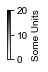

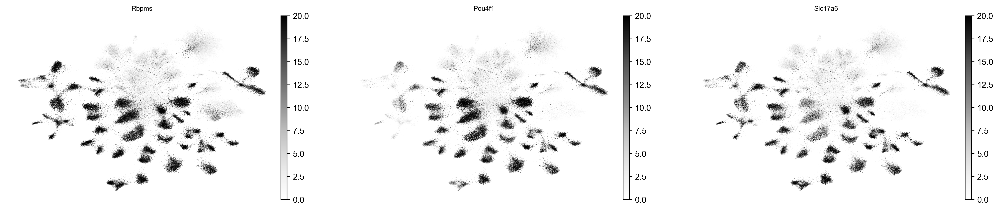

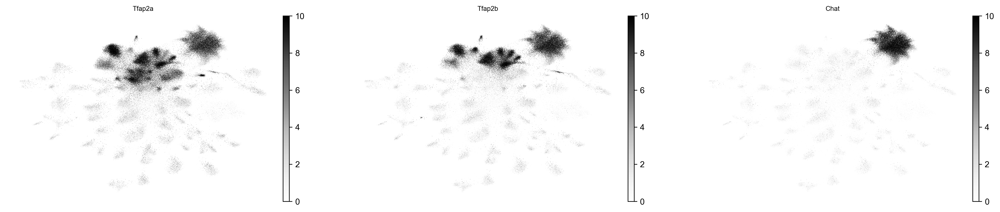

In [24]:
# cmap = 'Greys'
# norm = mpl.colors.Normalize(vmin=0, vmax=20)
# fig,ax=plt.subplots(figsize=(0.05,0.9))
# fig.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=cmap),cax=ax, orientation='vertical', label='Some Units')
# fig.savefig(os.path.join(figure_dir,"Rbpms_colorbar.pdf"))

make_umap_v2(adata,figure_dir=figure_dir)

## Figure 2E

{'RGC': 'RGC', 'GabaAC': 'Amacrine', 'Neither Gaba nor Gly AC': 'Amacrine', 'Both Gaba+Gly AC': 'Amacrine', 'GlyAC': 'Amacrine', 'Bipolar cell': 'Bipolar cell', 'Photoreceptor': 'Photoreceptor', 'Horizontal cell': 'Horizontal cell', 'Pericyte': 'Non-neuronal', 'Astrocyte': 'Non-neuronal', 'Muller glia': 'Non-neuronal', 'Microglia': 'Non-neuronal', 'Endothelial': 'Non-neuronal', 'Unassigned': 'Unassigned'}
Reorder cols: ['AC', 'RGC', 'NN', 'BC', 'Unassigned', 'HC', 'PR']


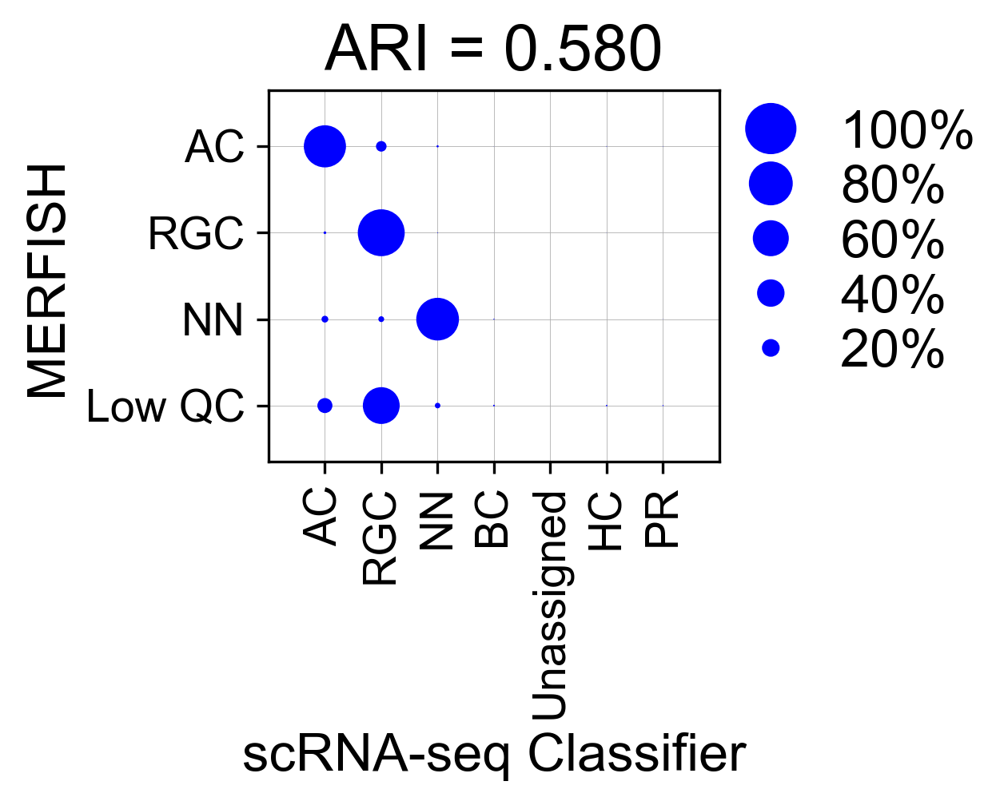

In [139]:
rgc_groups = ['RGC']
amacrine_groups = ['GabaAC','Neither Gaba nor Gly AC', 'Both Gaba+Gly AC', 'GlyAC']
other_neurons = ['Bipolar cell','Photoreceptor','Horizontal cell']
unassigned = ['Unassigned']
non_neuronal = list (set(adata.obs['retina_class'].unique()) - set(rgc_groups + amacrine_groups + other_neurons + unassigned))

groups = [rgc_groups,amacrine_groups,other_neurons,non_neuronal,unassigned]
mapping={}
for group,label in zip(groups,['RGC','Amacrine','Other Neurons','Non-neuronal','Unassigned']):
    for ctype in group:
        if ctype in other_neurons:
            mapping[ctype]=ctype
        else:
            mapping[ctype] = label


print(mapping)
adata.obs['classifier_groups']=adata.obs['retina_class'].map(mapping)
adata.obs['classifier_groups_abbrev'] = adata.obs['classifier_groups'].map(ABBREV_MAP)

#Hacky workaround for the fact the train and test cols aren't numbers but plot_mapping_new is 
def gen_mapping(adata,test_col,train_col):
    info ={}
    for key,col in zip(['test_key','train_key'], [test_col,train_col]):
        unique_vals = adata.obs[col].unique()
        t_dict = dict(zip(unique_vals,range(len(unique_vals))))
        info[key] = t_dict
    return info

ABBREV_MAP = {'Amacrine':'AC','Non-neuronal':'NN','Low quality neuronal':'Low QC','RGC':'RGC','Horizontal cell':'HC','Bipolar cell':'BC','Photoreceptor':'PR','Unassigned':'Unassigned'}

adata.obs['class_abbrev'] = adata.obs[class_col].map(ABBREV_MAP)
test_key='class_abbrev'
train_key='classifier_groups_abbrev'


info = gen_mapping(adata,train_col=train_key,test_col=test_key)
#import regions.plot_utils as pu
importlib.reload(pu)
with plt.rc_context({"font.size":16, "figure.figsize":[20,20],"figure.dpi":300,"font.sans-serif":"Arial"}):
    pu.plot_mapping_new(test_labels=adata.obs[test_key].map(info['test_key']), #y-axis
                    test_predlabels=adata.obs[train_key].map(info['train_key']),#x-AXIS
                    test_dict=info['test_key'],  # y-axis
                    train_dict=info['train_key'], # x-axis
                    re_order=True,
                    re_order_cols=None,
                    re_index=True,
                    xaxislabel='scRNA-seq Classifier', yaxislabel='MERFISH',
                    c='blue',
                    save_as=os.path.join(figure_dir,f"Classifier_vs_clustering_abbrev{suffix}.pdf")
)

## Figure 2D

In [140]:
def strip_counts_v3(adata,rep_col,split_col,yticks,palette,normalize,dot_size,output_f,order=None,ylabel=None):
    df = adata.obs
    
    c= pd.DataFrame(df[[rep_col,split_col]].value_counts().reset_index())
    c.rename(columns={0:'Number of cells'},inplace=True)

    total_counts_df = pd.DataFrame(df[rep_col].value_counts().reset_index())
    total_counts_df.rename(columns={'index':rep_col,rep_col:'total_counts'},inplace=True)
    joint_df = c.merge(total_counts_df,on='run')

    if normalize:
        y='Proportion of cells'
        joint_df[y] = joint_df['Number of cells']/joint_df['total_counts']
    else:
        y='Number of cells'
    with sns.plotting_context({"figure.dpi":200,"font.sans-serif":'Arial','font.size':7.5}):
        fig,ax=plt.subplots(figsize=(2.5,2.25))
        for spine in ax.spines.values():
            spine.set_linewidth(0.5)
        ax=sns.barplot(data=joint_df,x=split_col,y=y,palette=palette,errcolor='black',order=order,edgecolor='black',linewidth=0.5)
        sns.stripplot(data=joint_df,x=split_col,y=y,color='black',jitter=0.1,edgecolor='black',size=3,order=order)
        ax.set_xlabel("")
        if ylabel is not None:
            ax.set_ylabel(ylabel)
        plt.xticks(rotation=90)
        plt.yticks(yticks)
        fig.savefig(output_f,bbox_inches='tight')

/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/3478182511.py:20: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax=sns.barplot(data=joint_df,x=split_col,y=y,palette=palette,errcolor='black',order=order,edgecolor='black',linewidth=0.5)
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/3478182511.py:20: FutureWarning: 

The `errcolor` parameter is deprecated. And will be removed in v0.15.0. Pass `err_kws={'color': 'black'}` instead.

  ax=sns.barplot(data=joint_df,x=split_col,y=y,palette=palette,errcolor='black',order=order,edgecolor='black',linewidth=0.5)


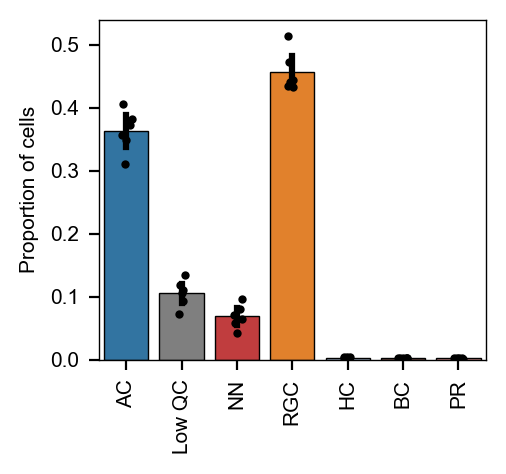

In [141]:
cmap=plt.get_cmap('tab20')
palette={'Amacrine':cmap(0),'Non-neuronal':cmap(6), 'Low quality neuronal':cmap(14),'RGC':cmap(2)}
new_cats = ['Horizontal cell', 'Bipolar cell', 'Photoreceptor']

adata.obs['class_aug'] = adata.obs[class_col].cat.add_categories(new_cats)
adata.obs.loc[adata.obs['retina_class'].isin(new_cats),'class_aug'] = adata.obs['retina_class'].astype(str)
adata.obs['class_aug_abbrev']= adata.obs['class_aug'].map(ABBREV_MAP)
strip_counts_v3(adata,rep_col='run',split_col='class_aug_abbrev',yticks=[0,0.1,0.2,0.3,0.4,0.5],normalize=True,palette=AUG_CLASS_PALETTE,dot_size=5,output_f=os.path.join(figure_dir,f"aug_class_proportions{suffix}.pdf"))

## Figure 2F

/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/3135422618.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_am_s.obs ['retina_class'] = pd.Categorical(adata_am_s.obs['retina_class'],categories=['GabaAC','Both Gaba+Gly AC','GlyAC','Neither Gaba nor Gly AC'])
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/3478182511.py:20: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax=sns.barplot(data=joint_df,x=split_col,y=y,palette=palette,errcolor='black',order=order,edgecolor='black',linewidth=0.5)
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/3478182511.py:20: FutureWarning: 

The `errcolor` parameter is deprecated. And will be removed in v0.15.0. Pass `err_kws={'color': 'black'}` instead.

  ax=sns.barplot(data=joint_df,x=split_col,y=y,palette=

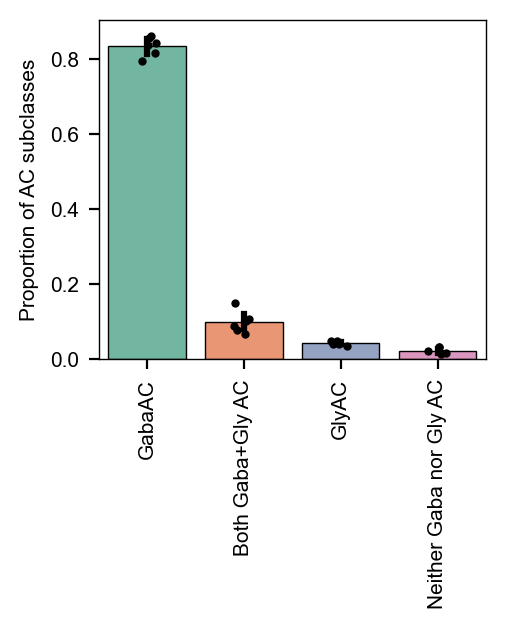

In [151]:
adata_am_s = adata[(adata.obs[class_col]=='Amacrine') & adata.obs['retina_class'].isin(['GabaAC','GlyAC','Both Gaba+Gly AC','Neither Gaba nor Gly AC']) ]
adata_am_s.obs ['retina_class'] = pd.Categorical(adata_am_s.obs['retina_class'],categories=['GabaAC','Both Gaba+Gly AC','GlyAC','Neither Gaba nor Gly AC'])
with plt.rc_context(CONTEXT):
    strip_counts_v3(adata_am_s,rep_col='run',split_col='retina_class',yticks=[0,0.2,0.4,0.6,0.8],ylabel='Proportion of AC subclasses',normalize=True,palette='Set2',dot_size=5,output_f=os.path.join(figure_dir,f"AC_class_proportions{suffix}.pdf"))

In [152]:
adata_am_s.obs['retina_class'].value_counts(normalize=True)

GabaAC                     0.834740
Both Gaba+Gly AC           0.098846
GlyAC                      0.043281
Neither Gaba nor Gly AC    0.023133
Name: retina_class, dtype: float64

## Figure S2A

/opt/anaconda3/envs/RGC/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/opt/anaconda3/envs/RGC/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


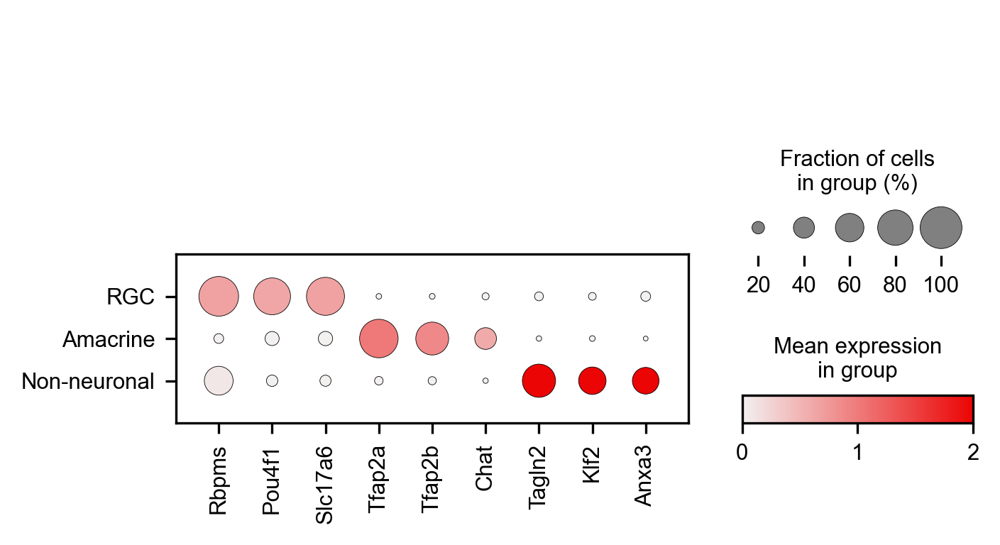

In [170]:
#cmap = mpl.colors.ListedColormap(sns.diverging_palette(275, 10, s=80, l=55, n=100).as_hex())
cmap = mpl.colors.ListedColormap(sns.light_palette('#eb0505').as_hex())
cmap = sns.light_palette('#eb0505',as_cmap=True)
with plt.rc_context({'figure.dpi': 300, 'font.size': 9, 'font.sans-serif': 'Arial'}):
    sc.pl.dotplot(adata[adata.obs[class_col].isin(['Amacrine','Non-neuronal','RGC'])],groupby=class_col,var_names=['Rbpms','Pou4f1','Slc17a6','Tfap2a','Tfap2b','Chat','Tagln2','Klf2','Anxa3'],categories_order=['RGC','Amacrine','Non-neuronal'],cmap=cmap,vmin=0,vmax=2,show=False)
    plt.savefig(os.path.join(figure_dir,f"NN_agg_dotplot{suffix}.pdf"),bbox_inches='tight')
    plt.show()
    

## Figure S2B

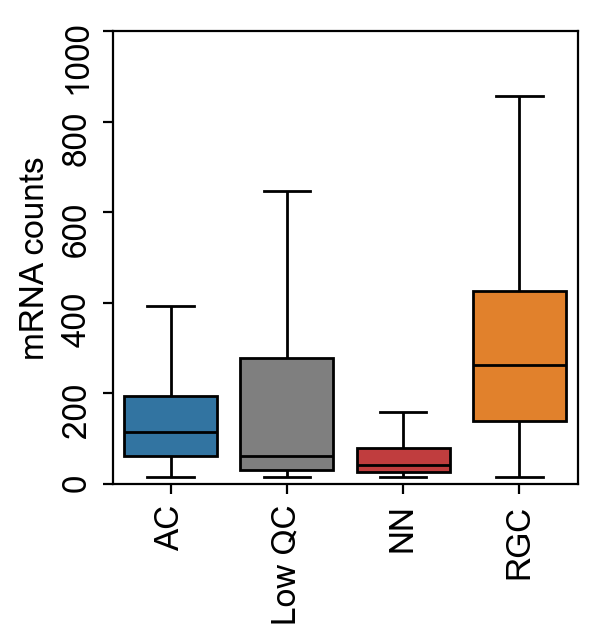

In [158]:
with plt.rc_context({"figure.dpi":200,"font.size":12,"font.sans-serif":"Arial"}):
    fig,ax=plt.subplots(figsize=(3,3))
    cmap=plt.get_cmap('tab20')
    if 'counts' in adata.obs.columns:
        adata.obs.rename(columns={'counts':'mRNA counts'},inplace=True)
    sns.boxplot(adata.obs,x='class_abbrev',y='mRNA counts', fliersize=0,linecolor='black', hue='class_abbrev',palette=CLASS_PALETTE,ax=ax)
    ax.set_ylim(0,1000)
    ax.set_xlabel("")
    ax.tick_params(rotation=90)
    plt.savefig(os.path.join(figure_dir,f"transcript_counts_box{suffix}.pdf"),bbox_inches='tight')

## Figure S2C

In [159]:


from matplotlib import gridspec
from sklearn.metrics.cluster import adjusted_rand_score
def crosstab_confusion(adata,x_col,y_col,xlabel='',ylabel='',output_f=""):
    x_cats = adata.obs[x_col].cat.categories
    x_mapping = dict(zip(x_cats, range(len(x_cats))))

    y_cats= adata.obs[y_col].cat.categories
    y_mapping = dict(zip(y_cats, range(len(y_cats))))
    return plot_mapping_new(
        test_labels=adata.obs[y_col].map(y_mapping).values.astype(int), #y-axis
        test_predlabels=adata.obs[x_col].map(x_mapping).values.astype(int),#x-AXIS
        test_dict=y_mapping,  # y-axis
        train_dict=x_mapping, # x-axis
        re_order=True,
        re_order_cols=None,
        re_index=False,
        xaxislabel=xlabel, yaxislabel=ylabel,
        save_as=output_f
    )

def plot_mapping_new(test_labels, test_predlabels, test_dict, train_dict, xaxislabel, yaxislabel,re_order=None,re_order_cols = None,re_index = None, re_order_rows = None, save_as=None,c='blue'):
    
    ARI = adjusted_rand_score(labels_true = test_labels, 
                              labels_pred = test_predlabels)
    accuracy = np.sum(test_labels==test_predlabels)/len(test_labels)*100
    
           
    columns,indices = plotConfusionMatrixNew(
    ytrue = test_labels,
    ypred = test_predlabels,
    test_dict=test_dict,
    train_dict=train_dict,
    type = 'mapping',
    save_as = save_as,
    title = 'ARI = {:.3f}, Accuracy = {:.1f}%'.format(ARI,accuracy),
    xaxislabel =xaxislabel,
    yaxislabel = yaxislabel,
        re_order=re_order,
    re_order_cols = re_order_cols,
        re_index = re_index,
    re_order_rows = re_order_rows,
    c=c,
    )
    return columns,indices

def plotConfusionMatrixNew(
    ytrue,
    ypred,
    type,
    xaxislabel,
    yaxislabel,
    title,
    train_dict,
    test_dict=None,
    re_order=None,
    re_order_cols = None,
    re_index = None,
    re_order_rows = None,
    save_as=None,
    c='blue',
    ):
    # Note: Train classes = actual classes + unassigned
    # ytrue = independent clustering (test), ypred = classifier prediction (train)
    # Class labels must be nonnegative consecutive integers ranging from 0,1,...,n_classes-1


    numbertrainclasses = len(train_dict)
    numbertestclasses = len(test_dict)
    confusion_matrix = np.zeros((numbertestclasses,numbertrainclasses))
    for i,_ in enumerate(ytrue):
        confusion_matrix[ytrue[i],ypred[i]] +=1

    # Normalize confusion matrix
    for row,arr in enumerate(confusion_matrix):
        row_sum = np.sum(arr)
        if row_sum !=0:
            confusion_matrix[row] = confusion_matrix[row]/row_sum

    conf_df = pd.DataFrame(confusion_matrix)

    conf_df.index = list(test_dict.keys()) 
    conf_df.columns = list(train_dict.keys())

    # Reorder rows to try and make diagonal
    if re_index:
        inv_dict = {v:k for k,v in test_dict.items()}
        most_likely = np.argmax(confusion_matrix, axis=0)
        row_order = [inv_dict[i] for i in list(set(most_likely))]
        print(row_order)
        #row_order = list(dict.fromkeys(most_likely)) # Note: If one type is most likely for multiple rows, this will get rid of the duplicates
        unclear_assignment = set(test_dict.keys()) - set(row_order)
        row_order.extend(unclear_assignment)
        #row_order = [inv_dict[i] for i in row_order]
        print(row_order)
        conf_df = conf_df.reindex(row_order)
        print("Reindexing", row_order)

    if re_order and re_order_cols is None:
        most_likely_col_indices = np.argmax(conf_df.values, axis=1)
        most_likely_col_indices = list(dict.fromkeys(most_likely_col_indices))
        inv_dict = {v:k for k,v in train_dict.items()}
        col_order = [inv_dict[i] for i in most_likely_col_indices]
        #row_order = list(dict.fromkeys(most_likely)) # Note: If one type is most likely for multiple rows, this will get rid of the duplicates
        unclear_assignment = set(train_dict.keys()) - set(col_order)
        col_order.extend(unclear_assignment)
        try:
            col_order.remove('Unassigned')
            col_order.append('Unassigned')
        except:
            pass
        conf_df = conf_df[col_order]
        print("Reiordering columns to try and make diagonal")
    elif re_order:        
        conf_df=conf_df[re_order_cols]
    
    diagcm = conf_df.to_numpy()
    xticksactual = conf_df.columns

    dot_max = np.max(diagcm.flatten())
    dot_min = 0
    if dot_min != 0 or dot_max != 1:
        frac = np.clip(diagcm, dot_min, dot_max)
        old_range = dot_max - dot_min
        frac = (frac - dot_min) / old_range
    else:
        frac = diagcm
    xvalues = []
    yvalues = []
    sizes = []
    for i in range(diagcm.shape[0]):
        for j in range(diagcm.shape[1]):
            xvalues.append(j)
            yvalues.append(i)
            sizes.append((frac[i,j]*35)**1.5)
    size_legend_width = 0.5
    height = diagcm.shape[0] * 0.3 + 1
    height = max([1.5, height])
    heatmap_width = diagcm.shape[1] * 0.35
    width = (
        heatmap_width
        + size_legend_width
        )
    fig = plt.figure(figsize=(width, height))
    axs = gridspec.GridSpec(
        nrows=2,
        ncols=2,
        wspace=0.02,
        hspace=0.04,
        width_ratios=[
                    heatmap_width,
                    size_legend_width
                    ],
        height_ratios = [0.5, 10]
        )
    dot_ax = fig.add_subplot(axs[1, 0])
    dot_ax.scatter(xvalues,yvalues, s = sizes, c = c, norm=None, edgecolor='none')
    y_ticks = range(diagcm.shape[0])
    dot_ax.set_yticks(y_ticks)
    if type == 'validation':
        dot_ax.set_yticklabels(list(train_dict.keys()))
    elif type == 'mapping':
        # dot_ax.set_yticklabels(list(test_dict.keys()))
        dot_ax.set_yticklabels(list(conf_df.index))
    
    #xticksactual = conf_df.columns.map({v:k for k,v in train_dict.items()})
    dot_ax.set_xticklabels(xticksactual,rotation=90)
    x_ticks = range(diagcm.shape[1])
    dot_ax.set_xticks(x_ticks)
    #dot_ax.set_xticklabels(xticksactual, rotation=90)
    dot_ax.tick_params(axis='both', labelsize='small')
    dot_ax.grid(True, linewidth = 0.2)
    dot_ax.set_axisbelow(True)
    dot_ax.set_xlim(-0.5, diagcm.shape[1] + 0.5)
    ymin, ymax = dot_ax.get_ylim()
    dot_ax.set_ylim(ymax + 0.5, ymin - 0.5)
    dot_ax.set_xlim(-1, diagcm.shape[1])
    dot_ax.set_xlabel(xaxislabel)
    dot_ax.set_ylabel(yaxislabel)
    dot_ax.set_title(title)
    size_legend_height = min(1.75, height)
    wspace = 10.5 / width
    axs3 = gridspec.GridSpecFromSubplotSpec(
        2,
        1,
        subplot_spec=axs[1, 1],
        wspace=wspace,
        height_ratios=[
                    size_legend_height / height,
                    (height - size_legend_height) / height
                    ]
        )
    diff = dot_max - dot_min
    if 0.3 < diff <= 0.6:
        step = 0.1
    elif diff <= 0.3:
        step = 0.05
    else:
        step = 0.2
    fracs_legends = np.arange(dot_max, dot_min, step * -1)[::-1]
    if dot_min != 0 or dot_max != 1:
        fracs_values = (fracs_legends - dot_min) / old_range
    else:
        fracs_values = fracs_legends
    size = (fracs_values * 35) ** 1.5
    size_legend = fig.add_subplot(axs3[0])
    size_legend.scatter(np.repeat(0, len(size)), range(len(size)), s=size, c = c)
    size_legend.set_yticks(range(len(size)))
    labels = ["{:.0%}".format(x) for x in fracs_legends]
    if dot_max < 1:
        labels[-1] = ">" + labels[-1]
    size_legend.set_yticklabels(labels)
    size_legend.set_yticklabels(["{:.0%}".format(x) for x in fracs_legends])
    size_legend.tick_params(axis='y', left=False, labelleft=False, labelright=True)
    size_legend.tick_params(axis='x', bottom=False, labelbottom=False)
    size_legend.spines['right'].set_visible(False)
    size_legend.spines['top'].set_visible(False)
    size_legend.spines['left'].set_visible(False)
    size_legend.spines['bottom'].set_visible(False)
    size_legend.grid(False)
    ymin, ymax = size_legend.get_ylim()
    size_legend.set_ylim(ymin, ymax + 0.5)
    if save_as is not None:
        fig.savefig(save_as, bbox_inches = 'tight')
    plt.show()
    #return diagcm, None,axs
    return conf_df.columns,conf_df.index


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/2180443615.py:166: UserWarning: FixedFormatter should only be used together with FixedLocator
  dot_ax.set_xticklabels(xticksactual,rotation=90)


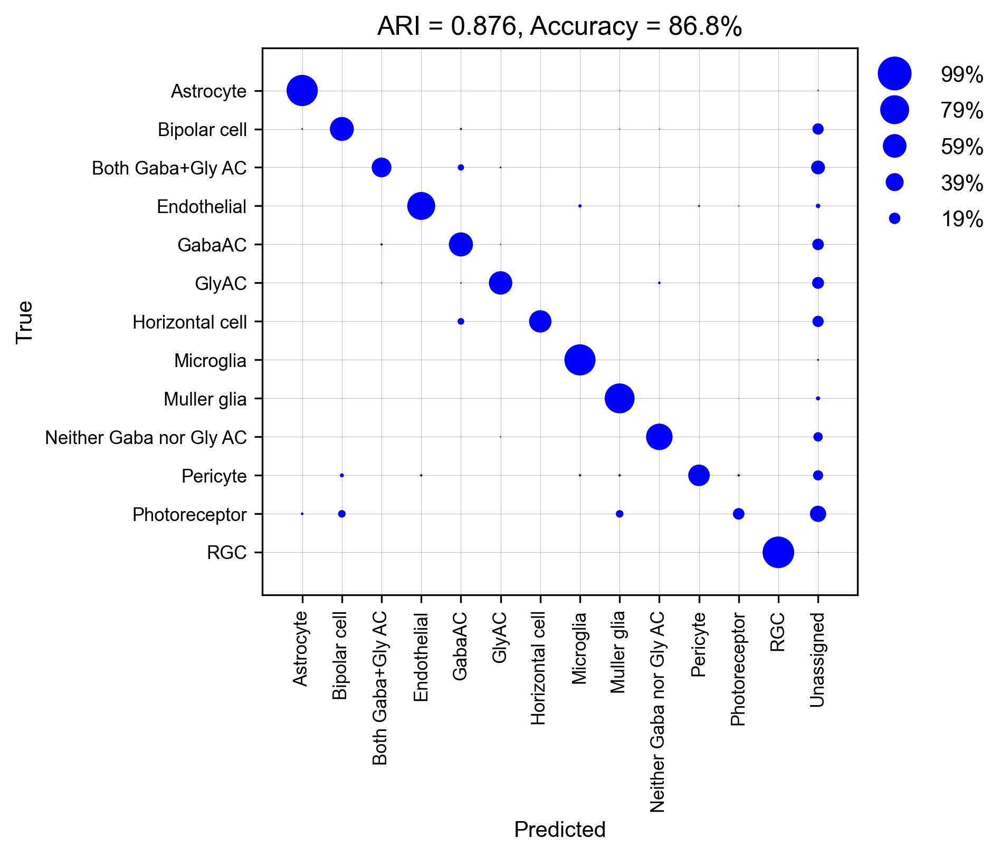

In [160]:
model_dir = os.path.join(BASE_DIR,"models","retina_class_level")
with open(os.path.join(model_dir,"train_dict_merged.pickle"), 'rb') as f:
    train_dict = pickle.load(f)


x_mapping = train_dict
y_mapping = train_dict.copy()
y_mapping.pop('Unassigned')
#test_dict['Unassigned'] = max( list(test_dict.values()) ) + 1

y_pred = np.load(os.path.join(model_dir,"xgb_retina_merged_valid_y_pred.npy"))
y = np.load(os.path.join(model_dir,"xgb_retina_merged_valid_y.npy"))

with plt.rc_context({'figure.dpi':300,'font.sans-serif':'Arial'}):
    columns, indices = plot_mapping_new(
            test_labels=y.astype(int), #y-axis
            test_predlabels=y_pred.astype(int),#x-AXIS
            test_dict=y_mapping,  # y-axis
            train_dict=x_mapping, # x-axis
            re_order=True,
            re_order_cols=['Astrocyte', 'Bipolar cell', 'Both Gaba+Gly AC', 'Endothelial',
        'GabaAC', 'GlyAC', 'Horizontal cell', 'Microglia', 'Muller glia',
        'Neither Gaba nor Gly AC', 'Pericyte', 'Photoreceptor','RGC',
        'Unassigned'],
            re_index=False,
            xaxislabel="Predicted", yaxislabel="True",
            save_as=os.path.join(figure_dir,"Class_level_validation.pdf"),
        )



## Figure 2H

In [161]:
def extract_run_region(adata,run,region):#Takes meregd control and extracts run and region needed for visualizdation
    adata = adata[(adata.obs['run']==run) & (adata.obs['region']==region)]
    adata.obs.index=['_'.join(idx.split("_")[0:2]) for idx in adata.obs.index.values]
    return adata.copy()


def get_region_visualizer(run,region=0,downsample_ratio=4,stitched_mask_f="stitched_masks_c2knl_full_retina_comb.npy"):
        subdirectory = f"{run}_rg{region}"
        stitched_m = np.load(os.path.join("data",subdirectory, stitched_mask_f))
        micron_regions = rc.RN_REGIONS[subdirectory]
        v= visualizer.Visualizer(micron_regions,stitched_m, downsample_ratio,"imaging_scripts",subdirectory)
        return v

colors = [(0, 0, 0), (1, 0, 0)] 
from matplotlib.colors import LinearSegmentedColormap
cmap_red = LinearSegmentedColormap.from_list(
        "Custom", colors, N=1000)

Pixel coords: x=(3609,3956), y=(997,1345)
528 21965
Saved image to: Paper/matplotlib_outputs/Figure_2/CD31_run140g_rn4_region0_z7.pdf


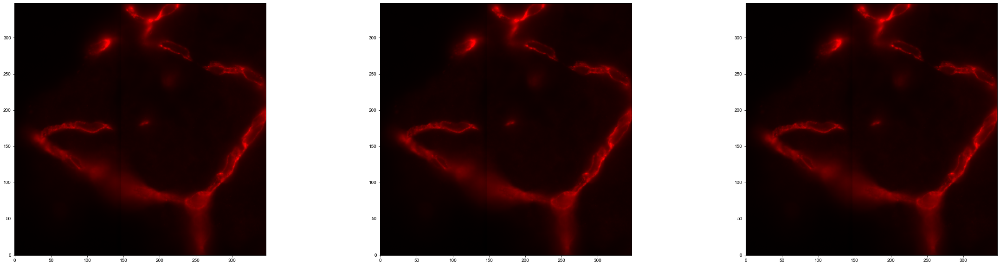

Pixel coords: x=(3388,3735), y=(2057,2404)
767 23187
Saved image to: Paper/matplotlib_outputs/Figure_2/CD31_run140g_rn4_region2_z7.pdf


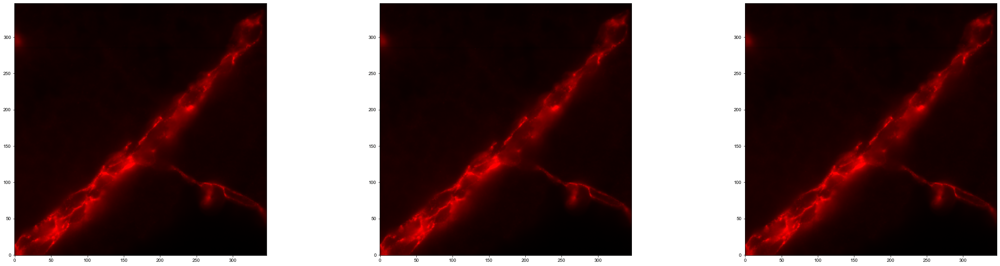

Pixel coords: x=(2081,2752), y=(1630,2324)
567 32188
Saved image to: Paper/matplotlib_outputs/Figure_2/CD31_run140g_rn4_region3_z7.pdf


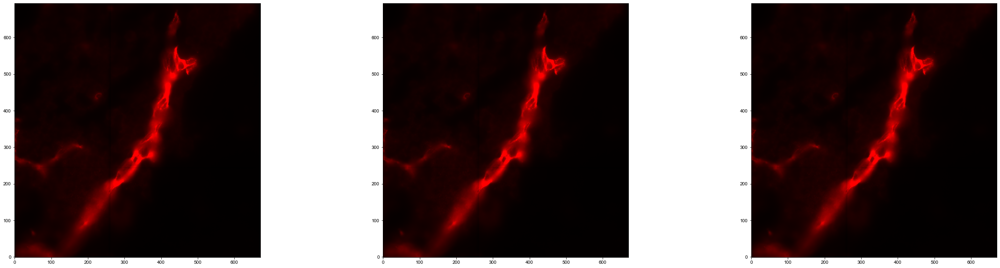

In [30]:
adata=sc.read_h5ad(os.path.join(data_dir,"merged_control_final.h5ad"))
adata_a=sc.read_h5ad(os.path.join(data_dir,"merged_control.h5ad"))

importlib.reload(visualizer)
importlib.reload(rc)

run="140g_rn4"
region=0
for region,r_n in zip([0,2,3],[2,0,2]):
    z=7

    run_id=int(re.search(r"140g_rn(.+)",run).group(1))
    adata_e = extract_run_region(adata,run=run_id,region=region)
    RGC_types = [f'C{i}' for i in range(1,46)]

    adata_r=adata_a[(adata_a.obs['run']==run_id) & (adata_a.obs['region']==region) & (~adata_a.obs['pass_cutoff'] | ~adata_a.obs['to_keep'])]
    id_filter= set([int(i.split('_')[0]) for i in adata_r.obs.index])
    
    id_postfix=f"rg{region}"
    v = get_region_visualizer(run=run,region=region,downsample_ratio=4,stitched_mask_f="stitched_masks_c2knl_full_retina_comb.npy")
    v.figure_dir=figure_dir


    cmap = plt.get_cmap('tab20')

    class_coloring = {'Non-neuronal':6}
   
    %matplotlib inline
    visualize_area(z=z,r_n=r_n,plot_masks=False,stain="Anti-Rat",train_sample=None,vmin=None,vmax=13000,cmap=cmap_red,fname=f"CD31_run{run}_region{region}_z{z}.pdf")
    v.visualize_classes(adata_e,group_col='class',z=z,r_n=r_n,remaining_z=[0,1,2,3,4,5,6],id_postfix=id_postfix,id_filter=id_filter,show_legend=True,cmap=cmap,keep_by_col=True, group_colors=class_coloring, group_name=f"Non-neuronal", plot_height=5,axis_fontsize=8,linewidth=0.35,markersize=13,fname=f"classes_run{run}_region{region}_z{z}_ex{r_n}.pdf")



## Figure 2G

In [163]:
import json
with open(os.path.join(BASE_DIR,"data","MER_splines",'spline_coordinates.json')) as f:
    spline = json.load(f)


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/4168309020.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['in_boundary'] = df['in_boundary'].astype(bool)


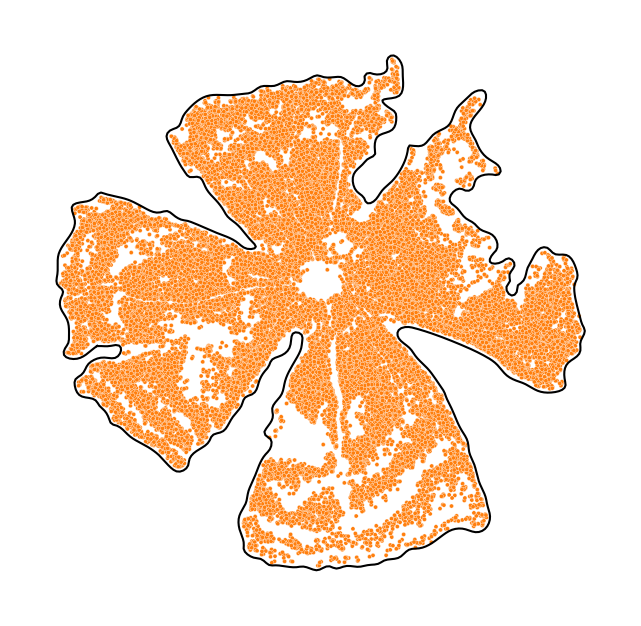

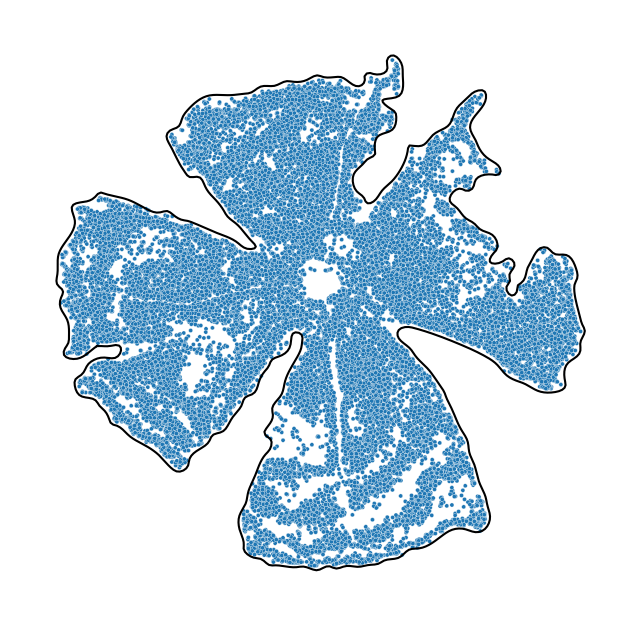

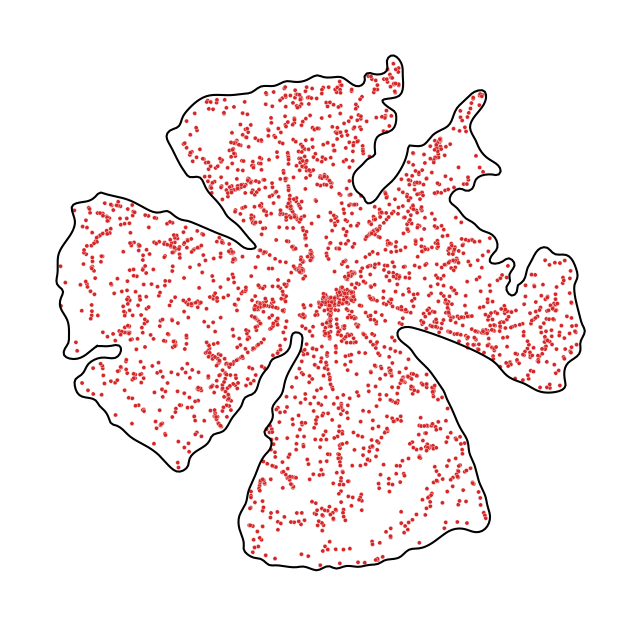

In [164]:
run = 3
spline_key = ""
if run in [5,16] and spline_key == "":
    raise AssertionError(f'run {run} requires explicit selection of version')
df = adata.obs[adata.obs['run']==run]

df['in_boundary'] = df['in_boundary'].astype(bool)
with plt.rc_context({'figure.dpi':300,'figure.figsize':(2.5,2.5)}):
    for ctype in ['RGC','Amacrine','Non-neuronal']:
        sns.scatterplot(df[(df[class_col]==ctype) & df['in_boundary']],x='final_x',y='final_y',palette=CLASS_PALETTE,hue=class_col,s=1,legend=False)
        spline_r =spline['rn{}{}'.format(run,spline_key)]
        for boundary in spline_r:
            spline_r = np.array(boundary)
            plt.plot(spline_r[:,0],spline_r[:,1],color='black',linewidth=0.5)
            plt.gca().set_axis_off()
            plt.gca().set_rasterized(True)
            plt.savefig(os.path.join(figure_dir,f"{ctype}_retina_{run}{suffix}.pdf"))
            plt.show()


## Figure 2I

In [167]:
def props_labeled(df,rep_col,split_col,label_col,new_counts_col,palette,output_f,order=None,figsize=(10,5)):
    fig,ax=plt.subplots(figsize=figsize)
    stats_df = pd.DataFrame(df.groupby([rep_col,split_col])[label_col].agg('mean').rename().reset_index(name=new_counts_col))
    ax=sns.barplot(stats_df,x=split_col,y=new_counts_col,palette=palette,edgecolor='black',errcolor='black',errwidth=2,order=order)
    sns.stripplot(stats_df,x=split_col,y=new_counts_col,ax=ax,color='black',order=order,size=6)

    ax.tick_params(axis='x',rotation=90)
    ax.set_xlabel("")
    plt.ylim(0,1)
    fig.savefig(output_f,bbox_inches='tight')
    fig.show()


def label_dist(adata,run_cutoffs,split_col,rep_col,values_to_include,palette,output_f,stain_col='Anti-Rat',label_col='CD31 labeled', new_counts_col='Proportion CD31+', order=None,figsize=(10,5)):

    if values_to_include is None:
        values_to_include = list(adata.obs[split_col].unique())

    
    df = adata.obs[(adata.obs[rep_col].isin(list(run_cutoffs.keys())))& (adata.obs[split_col].isin(values_to_include))]
    for col in [rep_col, split_col]:
        df[col] = df[col].cat.remove_unused_categories()

    splits=[]
    for run in run_cutoffs:
        cutoff=run_cutoffs[run][stain_col]
        df_run = df[df['run']==run]
        plt.hist(df_run[stain_col],bins=500)
        plt.axvline(cutoff,color='red')
        plt.show()
        df_run[label_col] = df[stain_col]>cutoff
        splits.append(df_run)
    
    df=pd.concat(splits)
    

        

    props_labeled(df,rep_col=rep_col,split_col=split_col,label_col=label_col,new_counts_col=new_counts_col,palette=palette,output_f=output_f,figsize=figsize,order=order)

/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/3325801516.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[col] = df[col].cat.remove_unused_categories()


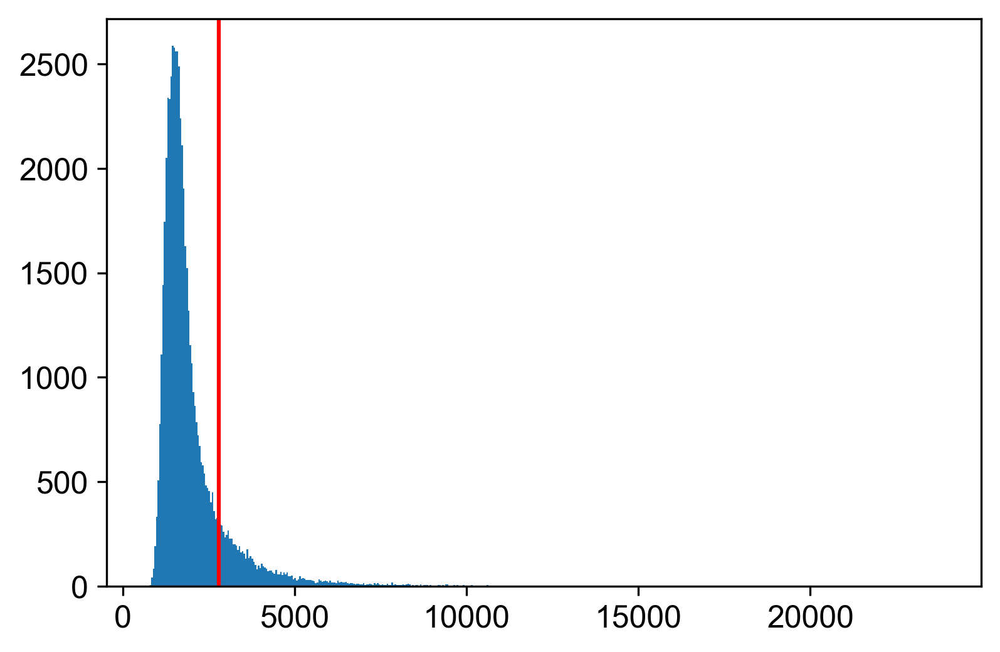

/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/3325801516.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_run[label_col] = df[stain_col]>cutoff


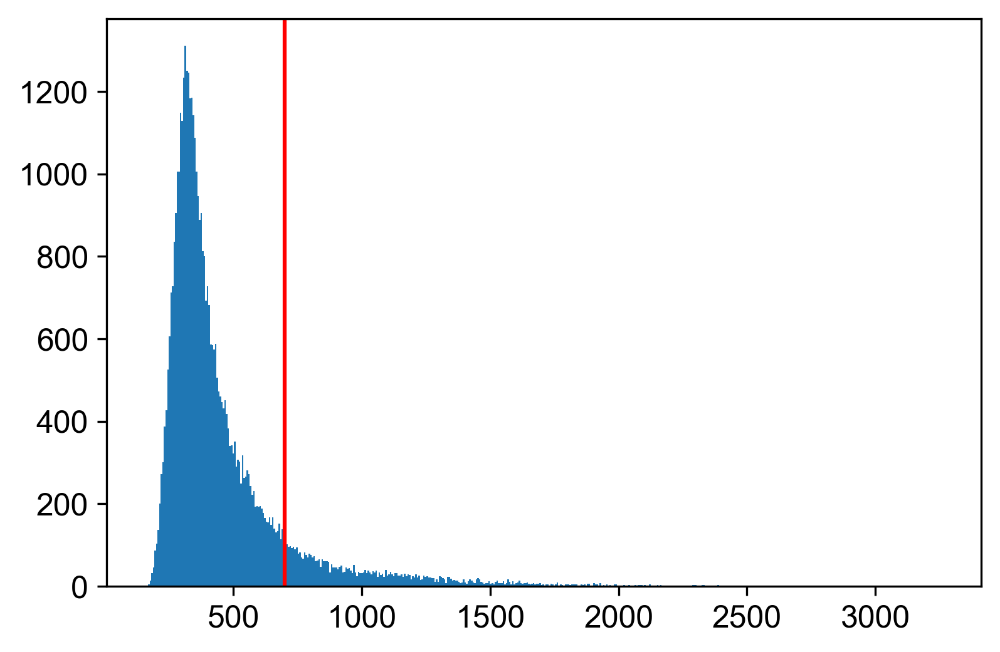

/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/3325801516.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_run[label_col] = df[stain_col]>cutoff


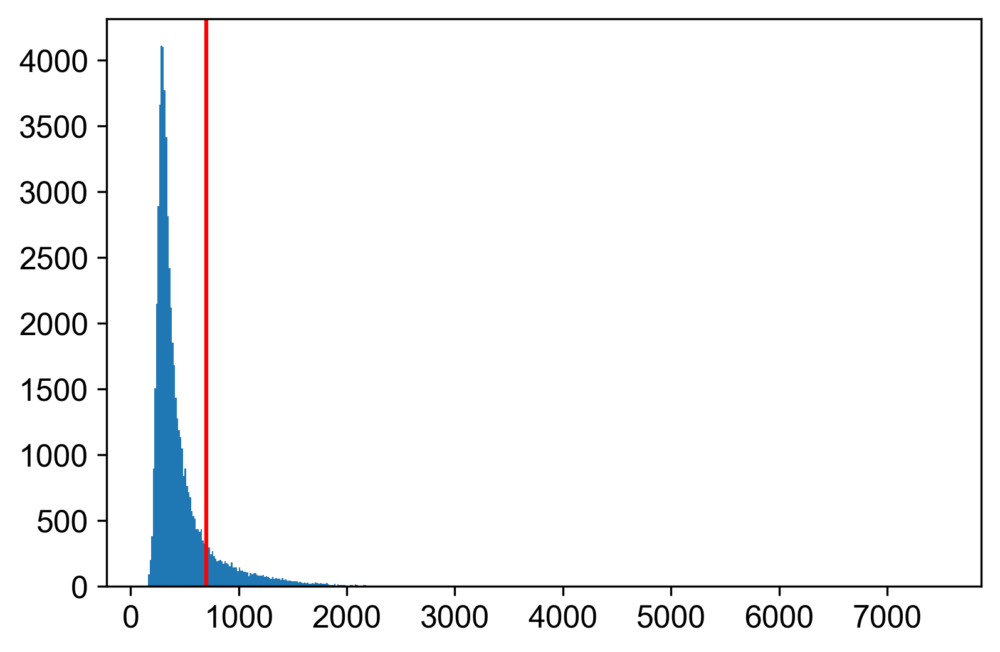

/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/3325801516.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_run[label_col] = df[stain_col]>cutoff
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/3325801516.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax=sns.barplot(stats_df,x=split_col,y=new_counts_col,palette=palette,edgecolor='black',errcolor='black',errwidth=2,order=order)
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/3325801516.py:4: FutureWarning: 

The `errcolor` parameter is deprecated. And will be removed in v0.15.0. Pass `err_kws={'color':

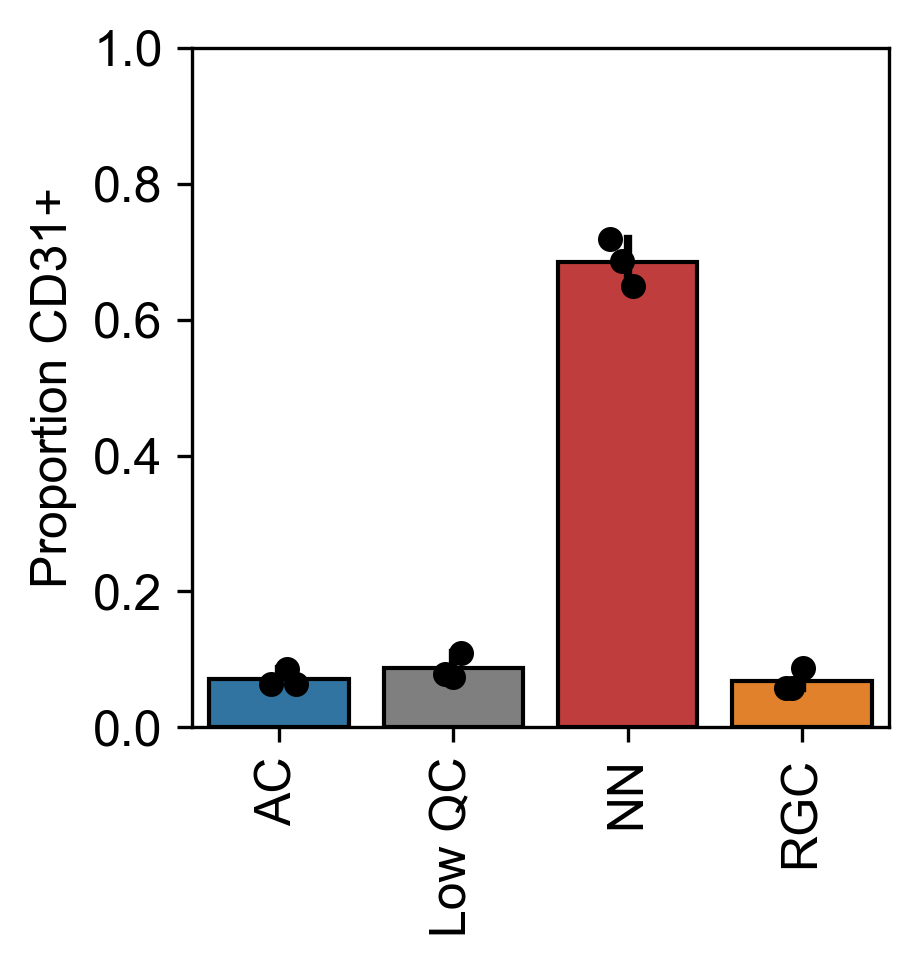

In [168]:
run_cutoffs = {
    4:{'Anti-Rat':2800},
    16:{'Anti-Rat':700},
    17:{'Anti-Rat':700},
}

adata.obs['class_abbrev'] = pd.Categorical(adata.obs['class_abbrev'])
adata.obs['run'] = pd.Categorical(adata.obs['run'])

with plt.rc_context(CONTEXT):
    label_dist(
        adata=adata,run_cutoffs=run_cutoffs,split_col='class_abbrev',rep_col='run',values_to_include=['AC','Low QC','NN','RGC'],
        order=['AC','Low QC','NN','RGC'],palette=CLASS_PALETTE,output_f=os.path.join(figure_dir,f"CD31+non_neuronal_clumped{suffix}.pdf"),figsize=(3,3))



In [169]:
adata.obs[adata.obs['CD31+']][class_col].value_counts()/adata.obs[adata.obs['run'].isin([4,16,17])][class_col].value_counts()

Amacrine                0.086178
Low quality neuronal    0.109615
Non-neuronal            0.709044
RGC                     0.081705
Name: class, dtype: float64

# Figure 3

In [185]:
import collections
suffix=""
data_dir=os.path.join(BASE_DIR,"data","control_130_6")
figure_dir = os.path.join(BASE_DIR,"figures","Figure_3")
adata = sc.read_h5ad(os.path.join(data_dir,JOINT_RGC))


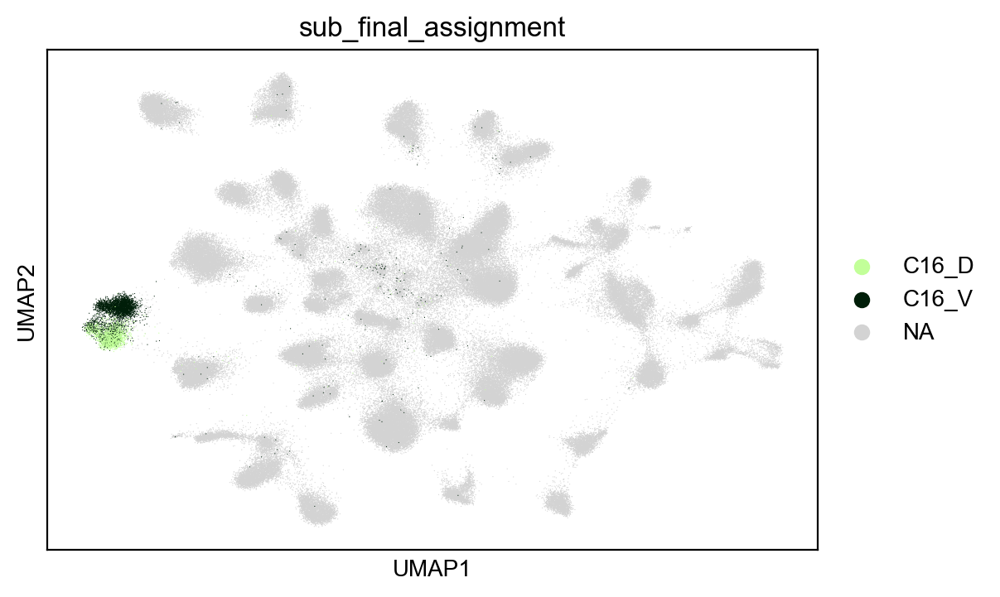

In [186]:
def create_C16_subclass(adata,old_col='final_assignment',new_col='subtyped_assignments',orig=True):
    adata.obs['Calb1'] = pd.Series(adata[:,'Calb1'].X.toarray()[:,0],index=adata.obs.index)
    try:
        adata.obs[new_col]= adata.obs[old_col].cat.add_categories(['C16_D','C16_V'])
    except Exception as e:
        raise AssertionError(e)
    if orig:
        adata.obs.loc[(adata.obs['Calb1'] > 1.75) & (adata.obs[new_col]=='C16') ,new_col] = 'C16_D'
        adata.obs.loc[(adata.obs['Calb1'] <= 1.75) & (adata.obs[new_col]=='C16'),new_col] = 'C16_V'
    else:
        adata.obs.loc[(adata.obs['Calb1'] > 1.4) & (adata.obs[new_col]=='C16') ,new_col] = 'C16_D'
        adata.obs.loc[(adata.obs['Calb1'] <= 1.4) & (adata.obs[new_col]=='C16'),new_col] = 'C16_V'
    adata.obs[new_col] = adata.obs[new_col].cat.remove_categories(['C16'])
    del adata.obs['Calb1']

create_C16_subclass(adata,old_col=f'final_assignment{suffix}',new_col='sub_final_assignment',orig= True)
sc.pl.umap(adata,color='sub_final_assignment',groups=['C16_D','C16_V'])

## Figure S3A

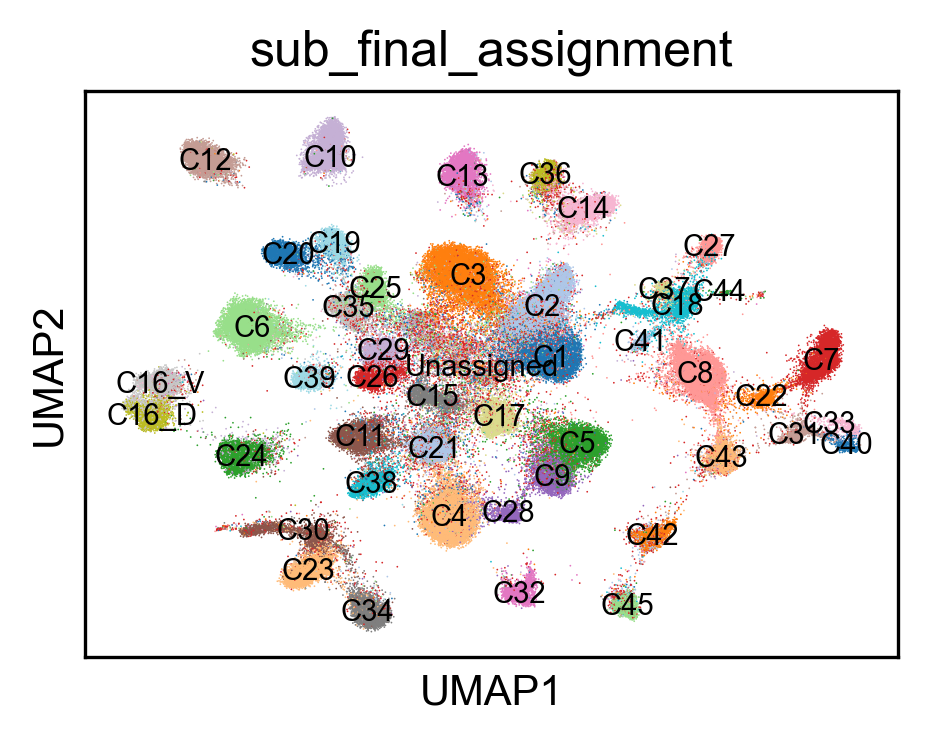

In [187]:
import collections
def make_umap(adata, gene_names=None, figure_dir= os.path.join("comparative_figures", "control")):
    with plt.rc_context({"figure.dpi":200,"font.sans-serif":"Arial","legend.fontsize":7}):#300,16
        adata.obs['label'] = adata.obs['leiden'].apply(lambda x: 'M'+str(x))
        sc.pl.umap(adata,color='label',palette='tab20',show=False,legend_fontsize=7,legend_loc="on data")
        adata.obs.drop(columns=['label'],inplace=True)
        plt.title("")
        plt.savefig(os.path.join(figure_dir, f"leiden_clustering{suffix}.pdf"))
        plt.show()

        # for group in np.unique(adata.obs['run'])
        #:
    return adata


test_key='leiden'
train_key='joint_type'
test_dict=collections.OrderedDict()
for i in sorted(adata.obs['leiden'].unique().astype(int)):
    test_dict[f'M{i}'] = int(i)
train_dict=collections.OrderedDict()
for i in range(45):
    train_dict[f'C{i+1}'] = i
train_dict['Unassigned']=45

#orig_size 4.5,4
with plt.rc_context({"figure.dpi":300,"font.sans-serif":"Arial",'figure.figsize':(3.5,2.5)}):
    sc.pl.umap(adata,color='sub_final_assignment',palette=type_palette,show=False,legend_fontsize=7,legend_loc="on data",legend_fontweight='normal')
    plt.savefig(os.path.join(figure_dir,f"RGC_type_assignment{suffix}.pdf"))




## Figure 3A

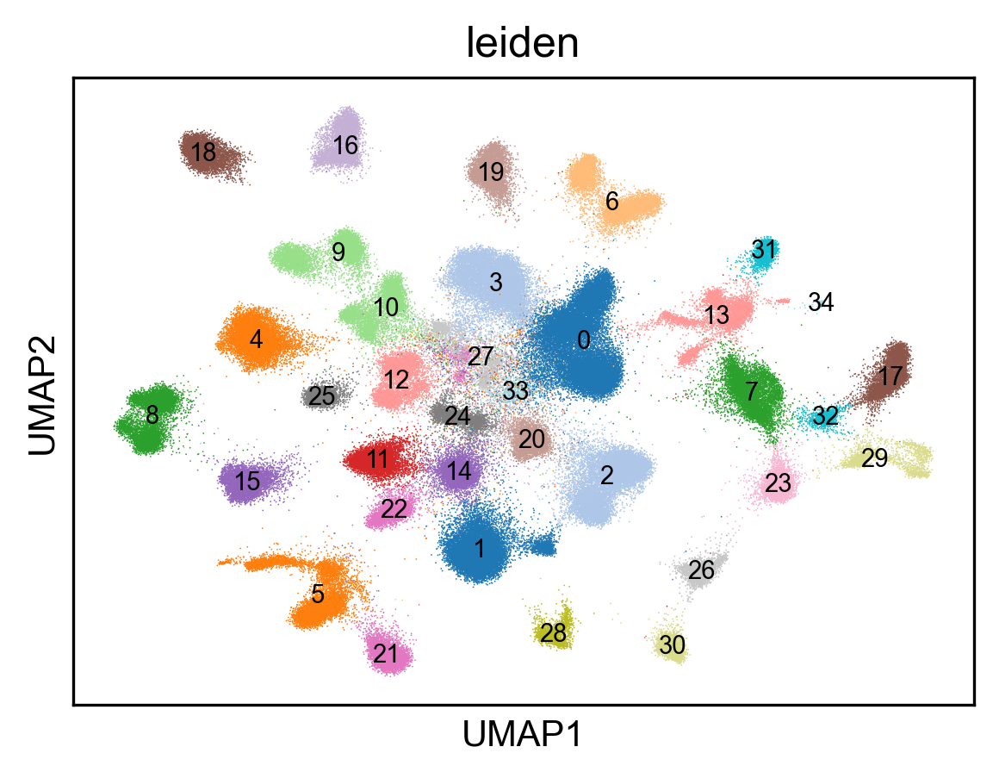

In [188]:
with plt.rc_context({"figure.dpi":300,"font.sans-serif":"Arial",'figure.figsize':(4.5,4.5*2.5/3.5)}):
    sc.pl.umap(adata,color='leiden',palette='tab20',show=False,legend_fontsize=7,legend_loc="on data",legend_fontweight='normal')
    plt.savefig(os.path.join(figure_dir,f"MERFISH_clusters_umap{suffix}.pdf"))


## Figure S3B

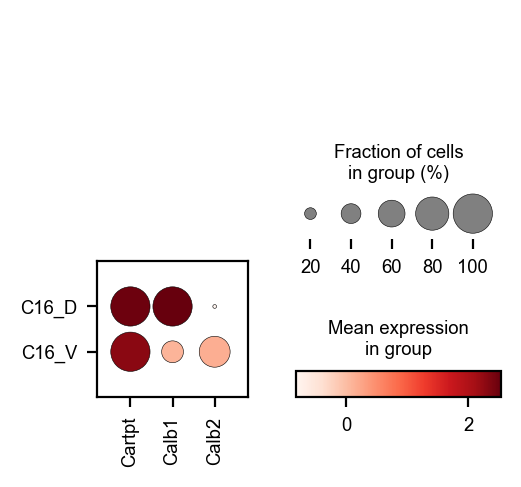

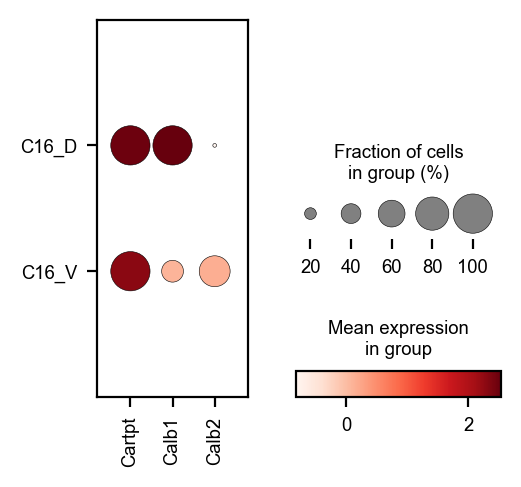

In [189]:

with plt.rc_context({'figure.dpi':200,'font.sans-serif':'Arial','font.size':8}):
    t = sc.pl.DotPlot(adata[adata.obs['sub_final_assignment'].isin(['C16_D','C16_V'])],groupby='sub_final_assignment',var_names=['Cartpt','Calb1','Calb2'],use_raw=False,cmap='Reds')
    t.DEFAULT_CATEGORY_HEIGHT = 0.45
    t.savefig(os.path.join(figure_dir,f"C16_expression{suffix}.pdf"))
    t.show()


## Figure 3B

defaultdict(<class 'list'>, {'0': ['C1', 'C2'], '3': ['C3'], '1': ['C4', 'C28'], '2': ['C5', 'C9'], '4': ['C6'], '17': ['C7'], '7': ['C8'], '16': ['C10'], '11': ['C11'], '18': ['C12'], '19': ['C13'], '6': ['C14', 'C36'], '24': ['C15'], '8': ['C16'], '20': ['C17'], '13': ['C18', 'C37', 'C41', 'C44'], '9': ['C19', 'C20'], '14': ['C21'], '32': ['C22'], '5': ['C23', 'C30'], '15': ['C24'], '10': ['C25', 'C35'], '12': ['C26', 'C29'], '31': ['C27'], '29': ['C31', 'C33', 'C40'], '28': ['C32'], '21': ['C34'], '22': ['C38'], '25': ['C39'], '26': ['C42'], '23': ['C43'], '30': ['C45'], '27': ['Unassigned']})


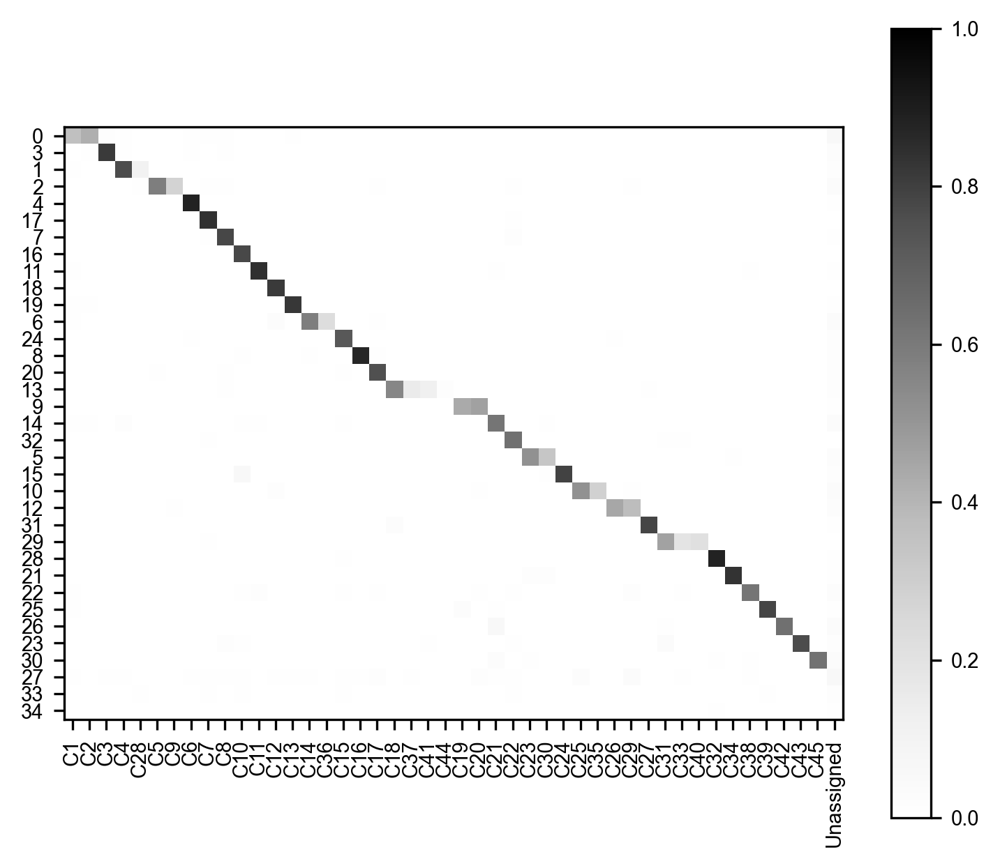

In [190]:
def create_alignment(adata,row_key,col_key,output_f,normalize=False):
    df = pd.crosstab(adata.obs[row_key],adata.obs[col_key])
    osum,zsum = np.sum(df.values, axis=1),np.sum(df.values,axis=0)
    
    J = df.values/(osum[:,np.newaxis] + zsum[np.newaxis,:] - df.values)
    J = np.nan_to_num(J,posinf=0.0)
    if normalize:
        for i,row in enumerate(J):
            for j,_ in enumerate(row):
                J[i][j] = J[i][j]/ min(max(J[i]),max(J[:,j]))
            
    df = pd.DataFrame(J,index=df.index,columns=df.columns)


    row_idxs = [df.index[i] for i in np.argmax(J,axis=0)]
    new_row_map = collections.defaultdict(list)

    
    for row_idx,col in zip(row_idxs,df.columns):
        new_row_map[row_idx].append(col)
    
    print(new_row_map)
    
    new_row_order = []
    new_col_order = []
    for row_idx in row_idxs:
        if row_idx not in new_row_order:
            new_row_order.append(row_idx)
            cols = new_row_map[row_idx]
            new_col_order.extend(cols)
    
    unused_rows = list(set(df.index.values) - set(new_row_order))
    new_row_order.extend(unused_rows)
    
    df = df.reindex(new_row_order)
    df = df[new_col_order]

    with plt.rc_context({'figure.dpi': 300, 'font.size': 7, 'font.sans-serif':'Arial','figure.figsize':(6,5)}):

        plt.yticks(np.arange(len(df.index)),labels=df.index,fontsize=7) 
        plt.xticks(np.arange(len(df.columns)),labels=df.columns,fontsize=7,rotation=90) 
        plt.imshow(df.values,cmap='Greys',vmin=0,vmax=1)
        plt.colorbar()

        plt.savefig(os.path.join(output_f))
    return df

df = create_alignment(adata,row_key='leiden',col_key=f'final_assignment{suffix}',output_f=os.path.join(figure_dir,f"monochrome_heatmap{suffix}.pdf"))

## Figures 3C-E, S3C

In [191]:
import numpy as np
import pandas as pd
import scanpy as sc
from anndata import AnnData
import matplotlib.pyplot as plt
import anndata as ad
import matplotlib
import matplotlib as mpl

def plot_multidotplot(adatas, cmaps, groupbys, group_order, gene_order, stack='v', vmin=0, vmax=2, dot_min=0, dot_max=1, adata_names=None, save='multidotplot.png', size_exp=1.5):
    #adatas = list(reversed(adatas))
    #cmaps = list(reversed(cmaps))
    num_adatas = len(adatas)

    if isinstance(adata_names, type(None)):
        adata_names = [str(i+1) for i in range(num_adatas)]
    else:
        if len(adata_names) != num_adatas:
            raise Exception('adata_names does not match the length of adatas')
        adata_names = list(reversed([str(i) for i in adata_names]))

    mean_dfs = []
    dot_size_dfs = []
    for i in range(num_adatas):
        adata = adatas[i]
        groupby = groupbys[i]
        print(adata)
        genedf = sc.get.obs_df(
            adata,
            keys=[groupby, *gene_order],
            use_raw=False
        )
        grouped = genedf.groupby(groupby, observed=True)
        mean_df = grouped.mean()
        
        genedf_bool = genedf.copy()
        genedf_bool[gene_order] = genedf[gene_order] > 0
        dot_size_df = genedf.copy()
        dot_size_df = genedf_bool.groupby(groupby, observed=True).sum()/genedf_bool.groupby(groupby, observed=True).count()

        mean_dfs.append(mean_df)
        dot_size_dfs.append(dot_size_df)

    xs = []
    ys = []
    if stack == 'v':
        for i in range(num_adatas):
            xs_single = []
            ys_single = []
            for j in range(len(gene_order)):
                ys_single.append((num_adatas*(j+1)-(num_adatas-i-1))*np.ones(len(group_order)))
                xs_single.append(np.ones(len(group_order))+np.arange(len(group_order)))
            xs.append(xs_single)
            ys.append(ys_single)
    elif stack == 'h':
        for i in range(num_adatas):
            xs_single = []
            ys_single = []
            for j in range(len(gene_order)):
                ys_single.append((j+1)*np.ones(len(group_order)))
                xs_single.append((i+1)*np.ones(len(group_order))+num_adatas*np.arange(len(group_order)))
            xs.append(xs_single)
            ys.append(ys_single)
    else:
        raise Exception('stack must be \'v\' or \'h\'')

    if stack == 'v':
        fig_width = len(group_order)/3
        fig_height = num_adatas*len(gene_order)/3
    elif stack == 'h':
        fig_width = num_adatas*len(group_order)/3
        fig_height = len(gene_order)/3

    fig, ax = plt.subplots(figsize=(fig_width,fig_height))

    for i in range(num_adatas):
        colors = np.flip(mean_dfs[i].T[group_order].to_numpy(), axis=0).flatten()
        sizes = 200*np.flip(dot_size_dfs[i].T[group_order].to_numpy(), axis=0).flatten()**size_exp
        plt.scatter(xs[i], ys[i], c=colors, cmap=cmaps[i], s=sizes, vmin=vmin, vmax=vmax, edgecolor='black', linewidth=0.2)
    if stack == 'v':
        plt.xticks(np.arange(len(group_order))+1, group_order, rotation=90)
        label_locs = list(np.arange(0, num_adatas*len(gene_order), num_adatas)+(num_adatas+1)/2)
        labels = list(reversed(gene_order))
        for i in np.arange(num_adatas*len(gene_order))+1:
            if i not in label_locs:
                label_locs.append(i)
                labels.append('')
        plt.yticks(label_locs, labels)
        plt.xlim([0,len(group_order)+1])
        plt.ylim([0,num_adatas*len(gene_order)+1])
        for i in np.arange(len(gene_order)):
            y0 = num_adatas*i+1
            y1 = num_adatas*(i+1)
            line = plt.plot([-0.2, -0.2], [y0, y1], linewidth = 1, color='black')
            line[0].set_clip_on(False)
    elif stack == 'h':
        label_locs = list(np.arange(0, num_adatas*len(group_order), num_adatas)+(num_adatas+1)/2)
        labels = group_order.copy()
        for i in np.arange(num_adatas*len(group_order))+1:
            if i not in label_locs:
                label_locs.append(i)
                labels.append('')
        plt.xticks(label_locs, labels, rotation=90)
        plt.yticks(np.arange(len(gene_order))+1, list(reversed(gene_order)))
        plt.xlim([0,num_adatas*len(group_order)+1])
        plt.ylim([0,len(gene_order)+1])
        for i in np.arange(len(group_order)):
            x0 = num_adatas*i+1
            x1 = num_adatas*(i+1)
            line = plt.plot([x0, x1], [-0.2, -0.2], linewidth = 1, color='black')
            line[0].set_clip_on(False)
    plt.grid(False)

    num_legend_dots = 5
    size_pos = np.arange(num_legend_dots)
    size_sizes = np.arange(0.2, 1.01, 0.2)
    pos = ax.get_position()
    size_ax = fig.add_axes([pos.x1+0.225/fig_width, pos.y0+0.3/fig_height, 1.65/fig_width, 0.3/fig_height])
    size_ax.grid(False)
    size_ax.spines["right"].set_visible(False)
    size_ax.spines["top"].set_visible(False)
    size_ax.spines["left"].set_visible(False)
    size_ax.spines["bottom"].set_visible(False)
    size_ax.tick_params(axis="y", left=False, labelleft=False, labelright=False)
    size_ax.scatter(size_pos, len(size_pos)*[0], s=200*size_sizes**size_exp, color='gray', edgecolor='black', linewidth=0.2)
    size_ax.set_xlim([-1, num_legend_dots])
    size_ax.set_xticks(size_pos, [round(100*i) for i in size_sizes])
    size_ax.set_title("Fraction of cells\nin group (%)")

    size_pos = size_ax.get_position()
    current_y_pos = size_pos.y1
    for i in range(num_adatas):
        color_ax = fig.add_axes([size_pos.x0, current_y_pos+0.9/fig_height, 1.65/fig_width, 0.15/fig_height])
        cbar = mpl.colorbar.ColorbarBase(color_ax, cmap=cmaps[i], norm=mpl.colors.Normalize(vmin=vmin, vmax=vmax), orientation='horizontal')
        color_ax.set_title("Mean expression\nin " + adata_names[i])
        current_y_pos = color_ax.get_position().y1

    plt.savefig(save, bbox_inches='tight')

View of AnnData object with n_obs × n_vars = 24594 × 130
    obs: 'Size', 'center_x', 'center_y', 'max_areas', 'aligned_center_x', 'aligned_center_y', 'to_keep', 'region', 'is_amacrine', 'is_RGC', 'pass_cutoff', 'counts', 'group', 'group_num', 'class', 'final_assignment', 'run', 'leiden', 'joint_type', 'sub_final_assignment'
    var: 'mean', 'std'
    uns: 'leiden', 'log1p', 'neighbors', 'umap', 'sub_final_assignment_colors', 'leiden_colors'
    obsm: 'X_umap', 'y_probs'
    layers: 'log1p', 'raw'
    obsp: 'connectivities', 'distances'
View of AnnData object with n_obs × n_vars = 4989 × 18222
    obs: 'Type', 'Batch', 'Type_num', 'cluster'
    var: 'highly_variable', 'mean', 'std'
    uns: 'Type_num_colors', 'neighbors', 'pca', 'umap'
    obsm: 'R_tsne', 'X_harmony', 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'raw'
    obsp: 'connectivities', 'distances'
View of AnnData object with n_obs × n_vars = 6534 × 130
    obs: 'Size', 'center_x', 'center_y', 'max_areas', 'aligned_center_x',

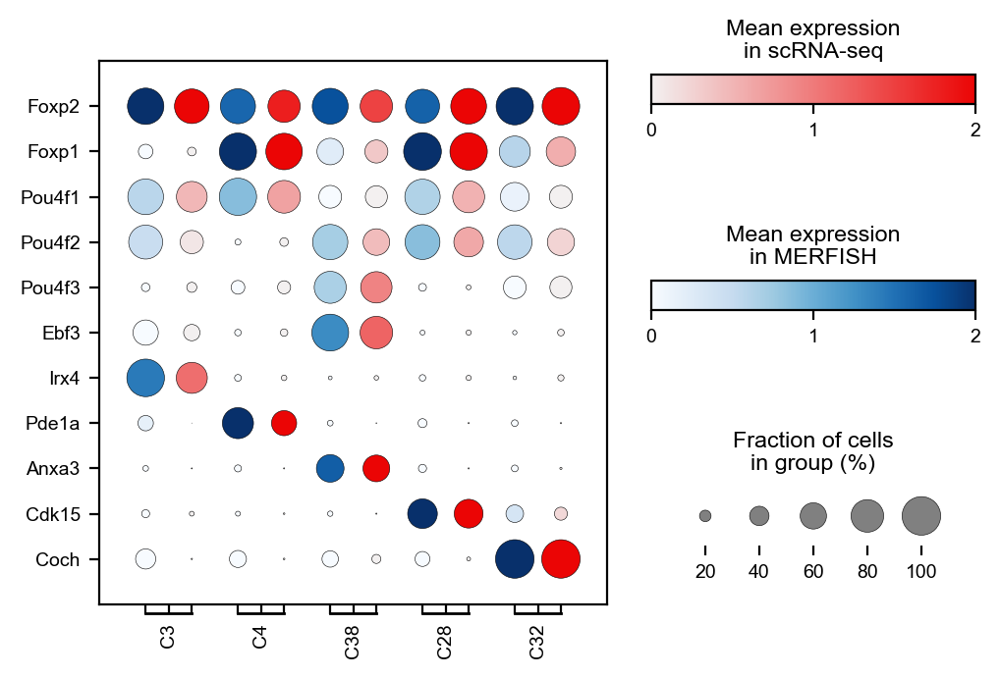

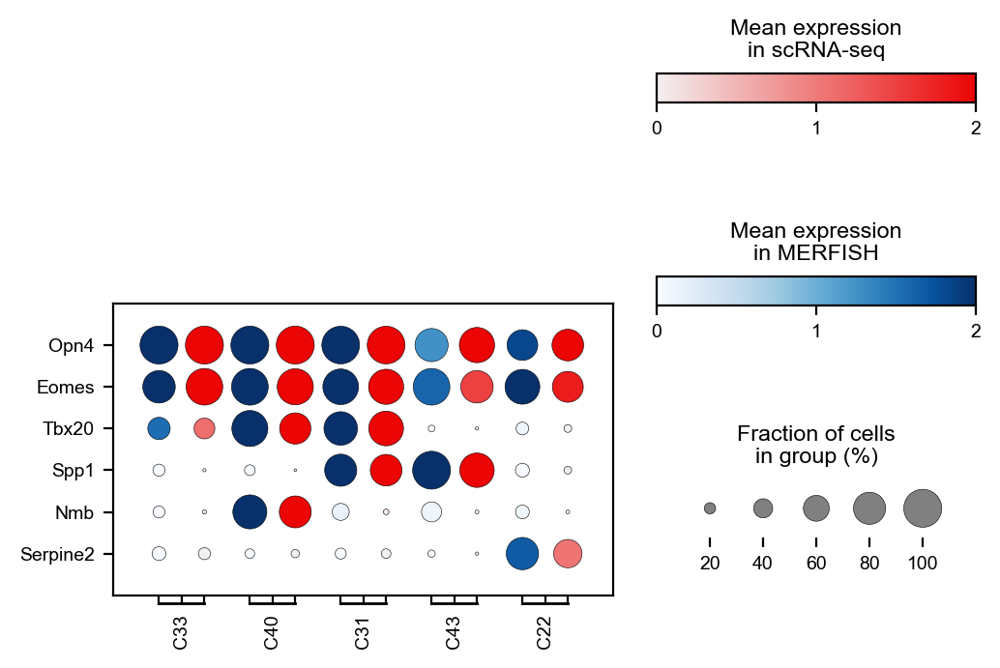

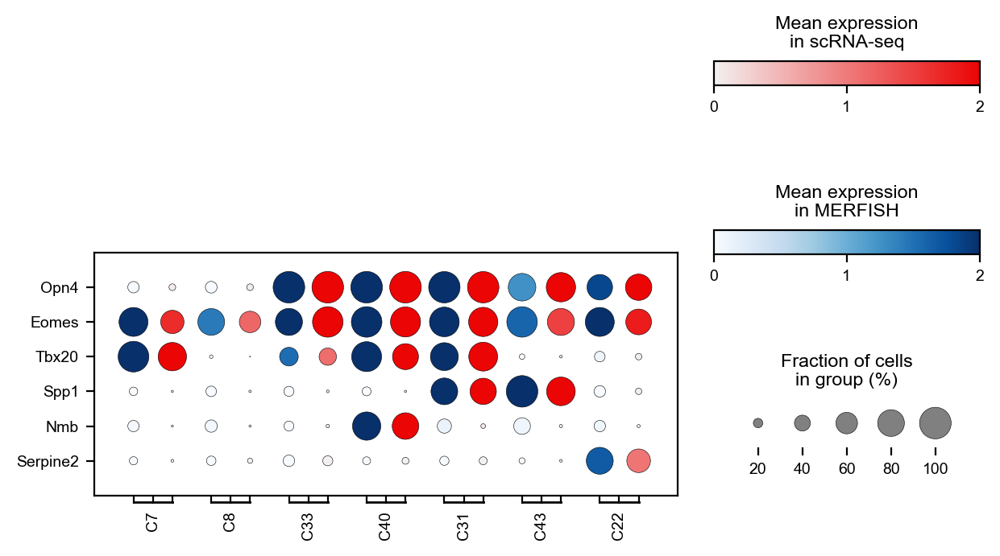

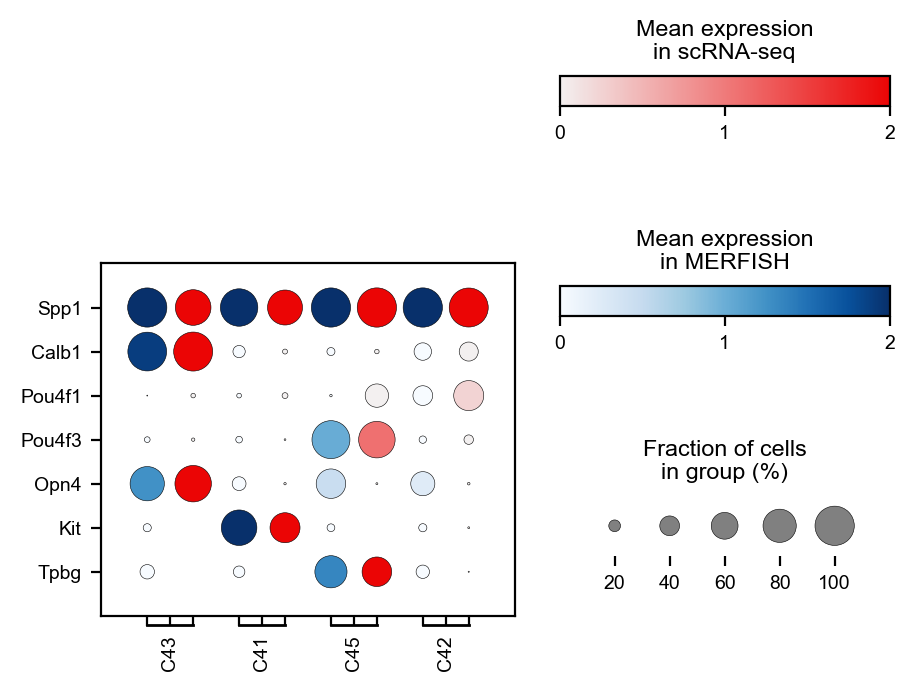

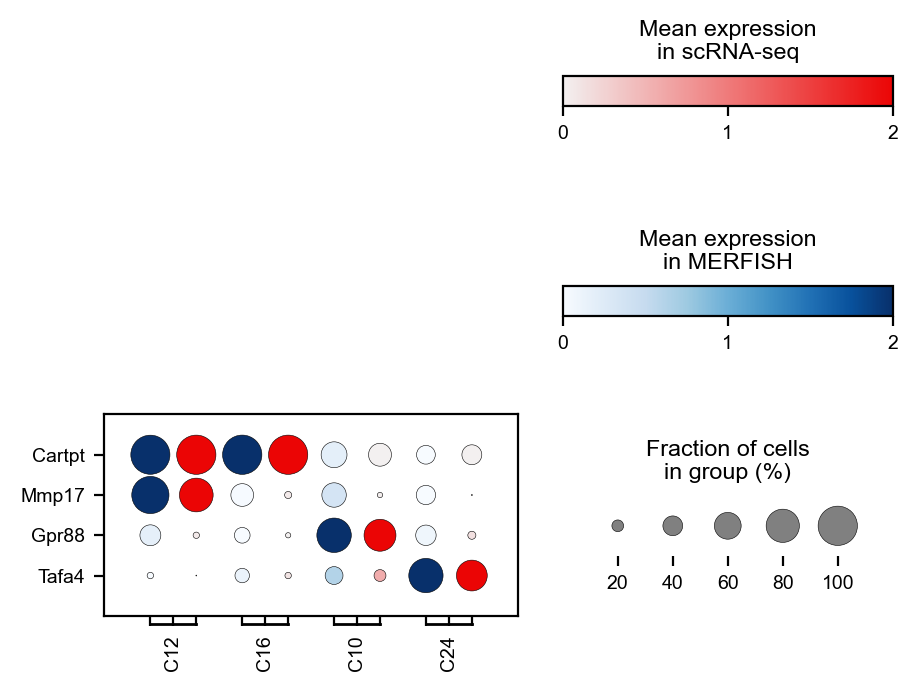

In [192]:
subclasses={
    r'$\alpha$-RGC':{
        'types': ['C43','C41','C45','C42'], 
        'markers':['Spp1','Calb1','Pou4f1','Pou4f3','Opn4','Kit','Tpbg']
    },
    'F-RGC':{
        'types': ['C3','C4','C38','C28','C32'],
        'markers':['Foxp2','Foxp1','Pou4f1','Pou4f2','Pou4f3','Ebf3','Irx4','Pde1a','Anxa3','Cdk15','Coch']
    },
    'ipRGC':{
        'types':['C33','C40','C31','C43','C22'],
        'markers':['Opn4','Eomes','Tbx20','Spp1','Nmb','Serpine2']
    },
    'ipRGC_add':{
        'types':['C7','C8','C33','C40','C31','C43','C22'],
        'markers':['Opn4','Eomes','Tbx20','Spp1','Nmb','Serpine2']
    },
    'S2S4':{
        'types':['C12','C16','C10','C24'],
        'markers':['Cartpt','Mmp17','Gpr88','Tafa4']
    },
    'T-RGC':{
        'types':['C5','C17','C21','C42','C9','C43','C41','C45'],
        'markers':['Tbr1','Jam2','Pou4f3','Pou4f2','Calb2','Spp1']
    }
}
removed_genes = ['Il1rapl2','Col25a1']
try:
    del adata.obs['Calb1']
except:
    pass
adata_ref=sc.read_h5ad(os.path.join(BASE_DIR,"data", "atlases", "RGCatlas.h5ad"))
adata_ref.var.index = ['Tafa4' if x=='Fam19a4' else x for x in adata_ref.var.index.values]
subclass_groups = ['F-RGC','ipRGC', 'ipRGC_add', r'$\alpha$-RGC','S2S4']
for subclass in subclass_groups:
    types = subclasses[subclass]['types']
    var_names = subclasses[subclass]['markers']
    
    with plt.rc_context({'font.sans-serif':'Arial','font.size':7}):
    
        plot_multidotplot(adatas=[adata[adata.obs[f'final_assignment{suffix}'].isin(types)], adata_ref[adata_ref.obs['Type_num'].isin(types)]],cmaps=['Blues',sns.light_palette('#eb0505',as_cmap=True)],groupbys=['final_assignment','Type_num'],gene_order=var_names,group_order=types, adata_names=['scRNA-seq','MERFISH'],stack='h',save=os.path.join(figure_dir,"{}_Type_heatmaps_v{}.pdf".format(subclass,suffix)))



## Figure S3D

In [194]:
import anndata as ad
#You need to rerun the pipeline with 140 genes instead of 130 genes to create this  figure
adata_mer = ad.concat([sc.read_h5ad(os.path.join(BASE_DIR,"data",f"140g_rn{i}","RGC_only.h5ad")) for i in [3,4,5] ])
adata_ref = sc.read_h5ad(os.path.join(BASE_DIR,"data","atlases","RGCatlas.h5ad"))

type_lst = [f"C{i}" for i in range(1,46)]

mapping = dict(zip([i for i in range(46)] , type_lst + ["Unassigned"]))
adata_mer.obs['final_assignment'] = adata_mer.obs['cluster'].map(mapping)
adata_mer = adata_mer[adata_mer.obs['final_assignment'] != 'Unassigned']

/opt/anaconda3/envs/RGC/lib/python3.10/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


/opt/anaconda3/envs/RGC/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/opt/anaconda3/envs/RGC/lib/python3.10/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/opt/anaconda3/envs/RGC/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/opt/anaconda3/envs/RGC/lib/python3.10/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


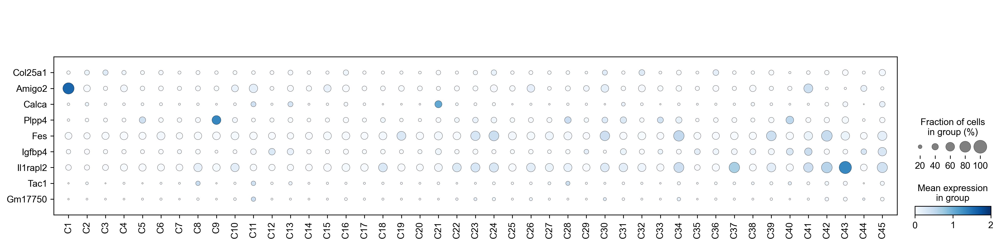

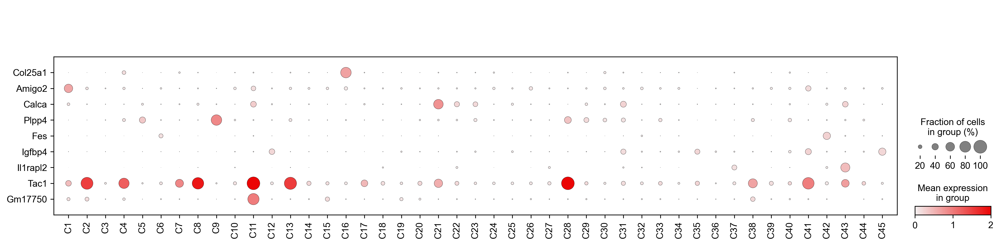

In [195]:
output_f = os.path.join(figure_dir, "{}_genes_{}.pdf")
MODIFIED_CONTEXT=CONTEXT.copy()
MODIFIED_CONTEXT['font.size']=8
type_lst = ['C{}'.format(i) for i in range(1,46)]
with plt.rc_context(CONTEXT):
    sc.pl.dotplot(adata_mer,groupby='final_assignment', categories_order=type_lst,var_names=['Col25a1','Amigo2','Calca','Plpp4','Fes','Igfbp4','Il1rapl2','Tac1','Gm17750'],vmin=0,vmax=2,show=False,cmap='Blues',swap_axes=True)
    plt.savefig(output_f.format("bad","MERFISH"),bbox_inches='tight')
    plt.show()

    sc.pl.dotplot(adata_ref,groupby='Type_num',categories_order=type_lst,var_names=['Col25a1','Amigo2','Calca','Plpp4','Fes','Igfbp4','Il1rapl2','Tac1','Gm17750'],vmin=0,vmax=2,show=False,cmap=cmap_reds,swap_axes=True)
    plt.savefig(output_f.format("bad","scRNA-seq"),bbox_inches='tight')
    plt.show()

    # sc.pl.dotplot(adata_mer,groupby='final_assignment', categories_order=type_lst,var_names=['Foxp2','Opn4','Spp1','Tbr1'],vmin=0,vmax=2,show=False,cmap='Blues',swap_axes=True)
    # plt.savefig(output_f.format("good","MERFISH"),bbox_inches='tight')
    # plt.show()

    # sc.pl.dotplot(adata_ref,groupby='Type_num',categories_order=type_lst,var_names=['Foxp2','Opn4','Spp1','Tbr1'],vmin=0,vmax=2,show=False,cmap=cmap_reds,swap_axes=True)
    # plt.savefig(output_f.format("good","scRNA-seq"),bbox_inches='tight')
    # plt.show()

## Figure S3E

In [196]:
# import scanpy as sc
# import spatial_rgc.utils.aggregate_pipeline as ap
# import spatial_rgc.utils.rconstants as rc
# import importlib
# import matplotlib.pyplot as plt
# import numpy as np
# importlib.reload(rc)
# import spatial_rgc.utils.run_container as container   
# importlib.reload(container)

# RUN_MAP = {3:"Whole Retina 1",4:"Whole Retina 2",5:"Whole Retina 3"}
# runs =["140g_rn3_130", "140g_rn4_130", "140g_rn5_130","140g_rn7_130","140g_rn16_130","140g_rn17_130","atlas"]
# num_regions=[0,1,2,3]
# cont = container.RunContainer(runs,base_dir=BASE_DIR,regions_lst=num_regions,RGC_cache_f="RGC_only.h5ad")
# #cont.plot_run_distributions_v2(runs_x=["atlas"],runs_y=["140g_rn3_130", "140g_rn4_130", "140g_rn5_130","140g_rn7_130","140g_rn16_130","140g_rn17_130"], ylabel='RGC Type % in MERFISH',xlabel='RGC Type % in scRNA-seq',type_col_x='cluster',type_col_y='cluster',dot_color='orange',err_color='orange', line_color='black',fontsize=24, figure_dir=figure_dir,fname="RGC_frequency_scatter.png",s=40)
# cont.plot_run_distributions_v3(runs_x=["atlas"],runs_y=["140g_rn3_130", "140g_rn4_130","140g_rn5_130","140g_rn7_130","140g_rn16_130","140g_rn17_130"], ylabel='RGC Type % in MERFISH',xlabel='RGC Type % in scRNA-seq',type_col_x='cluster',type_col_y='cluster',dot_color='orange',err_color='orange', line_color='black',fontsize=24, figure_dir=figure_dir,fname="RGC_frequency_scatter_loglog.pdf",s=40)



In [198]:
df_ref = pd.DataFrame(adata_ref.obs['Type_num'].value_counts(normalize=True))
df_ref.rename(columns={'Type_num':'prop_x'},inplace=True)
RGC_types = [f"C{i}" for i in range(1,46)]
mean_x = df_ref.loc[RGC_types]['prop_x']*100


df = pd.DataFrame( adata.obs[(adata.obs[class_col]=='RGC') & (adata.obs[f'final_assignment{suffix}']!='Unassigned')].groupby('run')[f'final_assignment{suffix}'].value_counts(normalize=True).reset_index(name='prop'))
mean_y = df.groupby(f'final_assignment{suffix}')['prop'].mean()[RGC_types]*100
yerr = df.groupby(f'final_assignment{suffix}')['prop'].std()[RGC_types]*100





/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/467234654.py:20: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


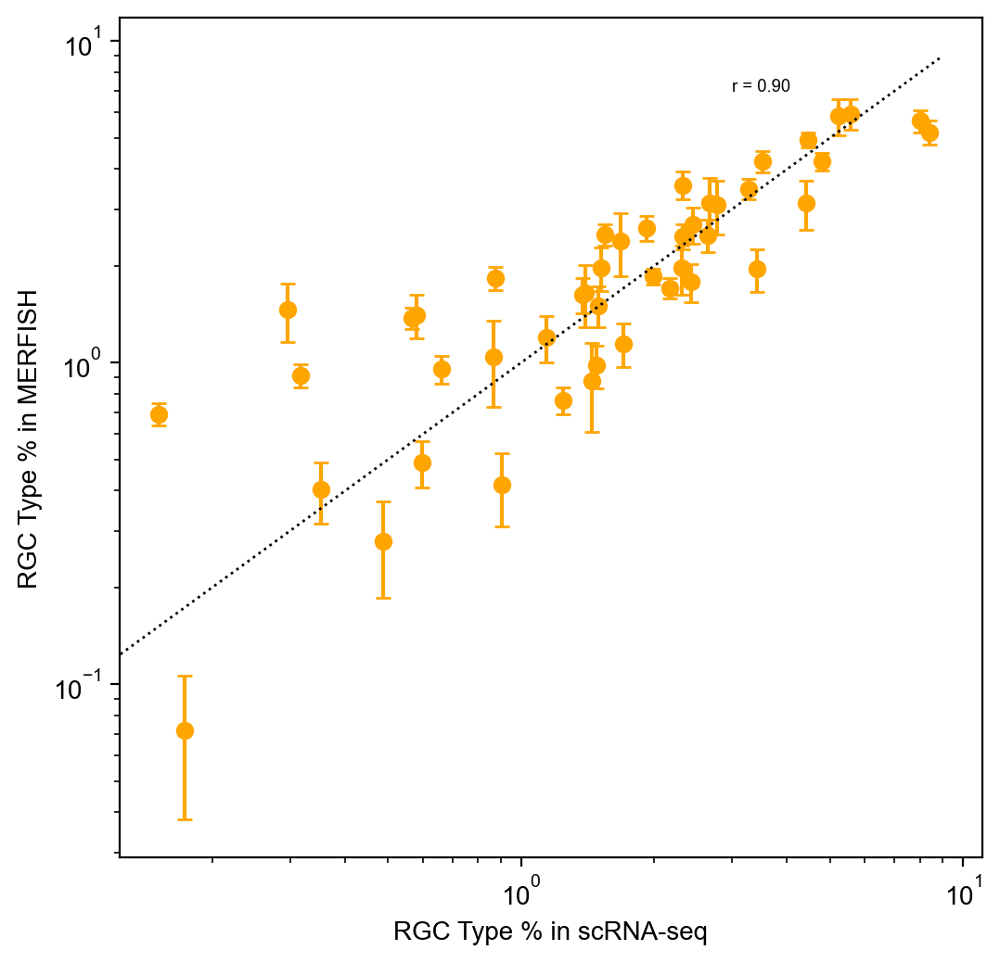

In [199]:
context = {'font.sans-serif':"Arial",'font.family':"sans-serif","figure.dpi":200}
fontsize=10
line_color='black'
with plt.rc_context(context):
    fig,ax = plt.subplots(ncols=1,nrows=1,figsize=(6,6),dpi=200)
    ax.set_ylabel('RGC Type % in MERFISH',fontsize=fontsize)
    ax.set_xlabel('RGC Type % in scRNA-seq',fontsize=fontsize)

    corr_matrix = np.corrcoef(mean_x.values,mean_y.values)
    r = corr_matrix[0,1]
    plt.text(3, 7, 'r = %0.2f' % r,fontsize=fontsize*2/3)

    x_y_l = np.linspace(0,9,num=50)
    ax.set_yscale('log')
    ax.set_xscale('log')
    ax.errorbar(x=mean_x,y=mean_y,yerr=yerr,linestyle='none',color='orange',capsize=3.0,zorder=0)
    ax.plot(x_y_l,x_y_l,linewidth=1,linestyle='dotted',color=line_color)
    ax.scatter(mean_x,mean_y,color='orange',zorder=1)
    fig.savefig(fname=os.path.join(figure_dir,f"TMP_RGC_frequency_scatter_loglog{suffix}.pdf"),bbox_inches="tight")
    fig.show()

## Figure S3F

In [91]:
def extract_run_region(adata,run,region):#Takes meregd control and extracts run and region needed for visualizdation
    adata = adata[(adata.obs['run']==run) & (adata.obs['region']==region)]
    adata.obs.index=['_'.join(idx.split("_")[0:2]) for idx in adata.obs.index.values]
    return adata.copy()


def get_region_visualizer(run,region=0,downsample_ratio=4):
        subdirectory = f"{run}_rg{region}"
        stitched_m = np.load(os.path.join("data",subdirectory, "stitched_masks_c2knl_full_retina_comb.npy"))
        micron_regions = rc.RN_REGIONS[subdirectory]
        v= visualizer.Visualizer(micron_regions,stitched_m, downsample_ratio,"imaging_scripts",subdirectory)
        return v


Saved image to: Paper/matplotlib_outputs/Figure_3/F-RGC_transcripts_0_11.pdf
Saved image to: Paper/matplotlib_outputs/Figure_3/alpha_transcripts_0_11.pdf


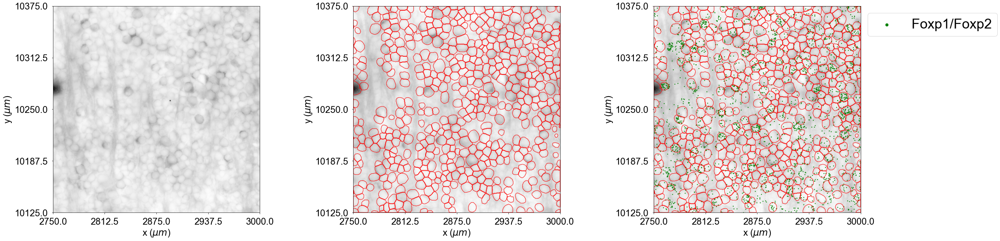

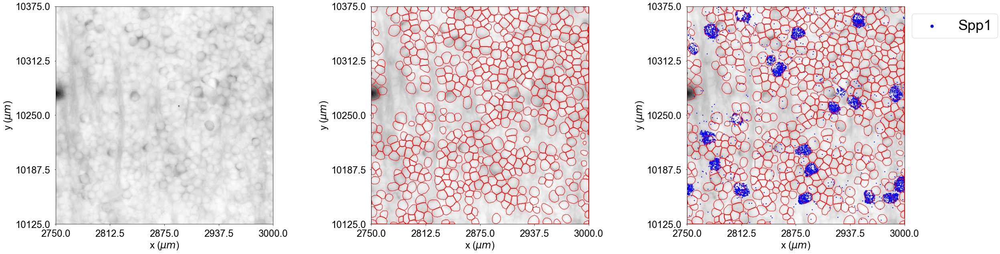

In [34]:

importlib.reload(visualizer)
importlib.reload(rc)


for region,r_n in zip([0],[11]):
    run="140g_rn3"

    run_id=int(re.search(r"140g_rn(.+)",run).group(1))
    adata_e = extract_run_region(adata,run=run_id,region=region)
    #RGC_types = [f'C{i}' for i in range(1,46)]
    #adata_e.obs['types']=adata_e.obs['retina_class'].copy().cat.add_categories(RGC_types)
    #adata_e.obs['types'] = adata_e.obs.apply(lambda x: x['final_assignment'] if x['final_assignment'] in RGC_types else x['types'], axis=1)
    #adata_e = adata_e[adata_e.obs['final_assignment'].isin(['C3','C4','C28','C32','C38'])]
    id_postfix=f"rg{region}"
    v = get_region_visualizer(run=run,region=region,downsample_ratio=4)
    v.figure_dir=figure_dir
    id_filter = None


    cmap = plt.get_cmap('tab20')
    F_RGC_coloring = {'C3':1,'C4':1,'C28':1,'C32':1,'C38':1}
    alpha_coloring = {'C41':2,'C41':2,'C42':2,'C43':2,'C45':2}
    v.visualize_transcripts(z=7,r_n=r_n, remaining_z=[0,1,2,3,4,5,6], plot_masks=True, group_name="markers",stitch_color='blue',gene_groups={"Foxp1/Foxp2":["Foxp1",'Foxp2']},color_groups={'Foxp1/Foxp2':'green'},s=2,fname=f'F-RGC_transcripts_{region}_{r_n}.pdf')
    v.visualize_transcripts(z=7,r_n=r_n, remaining_z=[], plot_masks=True, group_name="markers",stitch_color='blue',gene_groups={"Spp1":['Spp1']},color_groups={'Spp1':'Blue'},s=2,fname=f'alpha_transcripts_{region}_{r_n}.pdf')
    #v.visualize_classes(adata_e,group_col='final_assignment',z=7,r_n=r_n,remaining_z=[],id_postfix=id_postfix,id_filter=id_filter,show_legend=True,cmap=cmap,keep_by_col=True, group_colors=F_RGC_coloring, group_name=f"Non-neuronal", plot_height=5,axis_fontsize=8,linewidth=0.35,markersize=13,fname=f"F-RGC_segmentation.pdf")
    #v.visualize_stitched_z(all_z=[3,7,6,5,4,2,1,0],select_z=3, r_n=1, cmap='Greys',stain='Cellbound2',stitch_palette={7:'red',6:'orange',5:'yellow',4:'green',3:'blue',2:'pink',1:'purple',0:'grey'},id_filter=None, plot_height=10,axis_fontsize=16,linewidth=1,axis_off=False,fname=None)
    #v.visualize_stitched_z(all_z=[3,7,6,5,4,2,1,0],select_z=3, r_n=1, cmap='Greys',stain='Cellbound2',stitch_palette={7:'blue',6:'blue',5:'blue',4:'blue',3:'red',2:'blue',1:'blue',0:'blue'},id_filter=None, plot_height=10,axis_fontsize=16,linewidth=1,axis_off=False,fname="Paper_stitched.pdf")




## Figure S3G

In [ ]:
import scanpy as sc
import spatial_rgc.utils.aggregate_pipeline as ap
import spatial_rgc.utils.rconstants as rc
import importlib
import matplotlib.pyplot as plt
import numpy as np
importlib.reload(rc)
import spatial_rgc.utils.run_container as container   
importlib.reload(container)

RUN_MAP = {3:"Whole Retina 1",4:"Whole Retina 2",5:"Whole Retina 3"}
runs =["140g_rn3_130", "140g_rn4_130","140g_rn5_130","140g_rn7_130","140g_rn16_130","140g_rn17_130"]
num_regions=[0,1,2,3]
cont = container.RunContainer(runs,base_dir=BASE_DIR,regions_lst=num_regions,RGC_cache_f="RGC_only.h5ad")
#First time you run this, you must set remake=True
df_joint = cont.plot_bae_size_comparison(runs,max_area_col='max_areas',type_col=f'final_assignment', ylim=(0,3400),xlabel=r'Soma Volume ($\mu m^3$)',ylabel='RGC Type', remake=False, figsize=(9,2),data_dir=os.path.join(BASE_DIR,"data","bae"),output_f='gc_info',figure_dir=figure_dir,fname="compare_size_dist_bae.pdf")



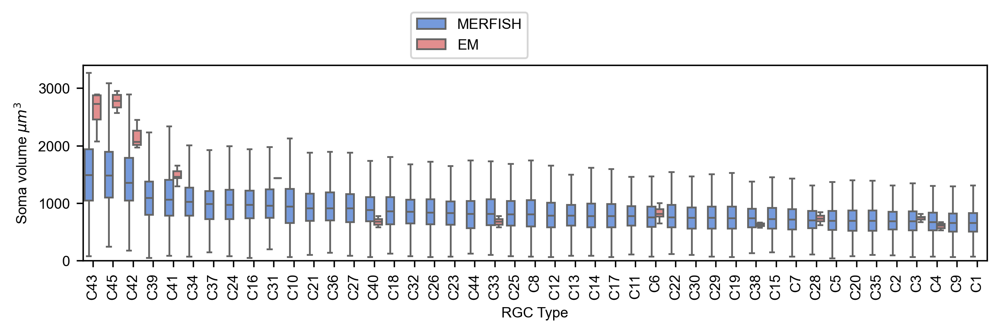

In [200]:
figsize= (9,2)


gc_info = pd.read_csv(os.path.join(BASE_DIR,"data","bae","gc_info"))
gc_info.rename(columns={'final_assignment':f'final_assignment{suffix}'},inplace=True)
gc_info['Method'] = 'EM'
df = adata.obs.copy()
df['Method'] = 'MERFISH'
df['soma_size']=4/3*np.pi*(np.sqrt(df['max_areas']/(np.pi)))**3

df_joint = pd.concat([df,gc_info],ignore_index=True)
RGC_types = [f'C{i}' for i in range(1,46)]
with plt.rc_context({"figure.figsize":figsize, "figure.dpi":300, "font.sans-serif":'Arial',"font.family":"sans-serif","font.size":8}):
    df_joint = df_joint[df_joint[f'final_assignment{suffix}'].isin(RGC_types)]
    order = df_joint.groupby(by=f'final_assignment{suffix}')['soma_size'].median().sort_values(ascending=False).index
    with plt.rc_context({"figure.figsize":figsize, "figure.dpi":300, "font.sans-serif":'Arial',"font.family":"sans-serif","font.size":8}):
        sns.boxplot(data=df_joint,y='soma_size', x=f'final_assignment{suffix}',hue='Method', palette={'MERFISH':'cornflowerblue','EM':'lightcoral'}, order=order,fliersize=0)
        plt.ylim(0,3400)
        plt.yticks(np.arange(0, 3500, 1000))
        plt.ylabel(r'Soma volume $\mu m^3$')
        plt.xlabel('RGC Type')
        plt.xticks(rotation=90)
        plt.legend(bbox_to_anchor=(0.5,1.0))
        plt.savefig(os.path.join(figure_dir,f"compare_size_dist_bae{suffix}.pdf"),bbox_inches='tight')
    plt.show()
    

## Figures S4A, S4B

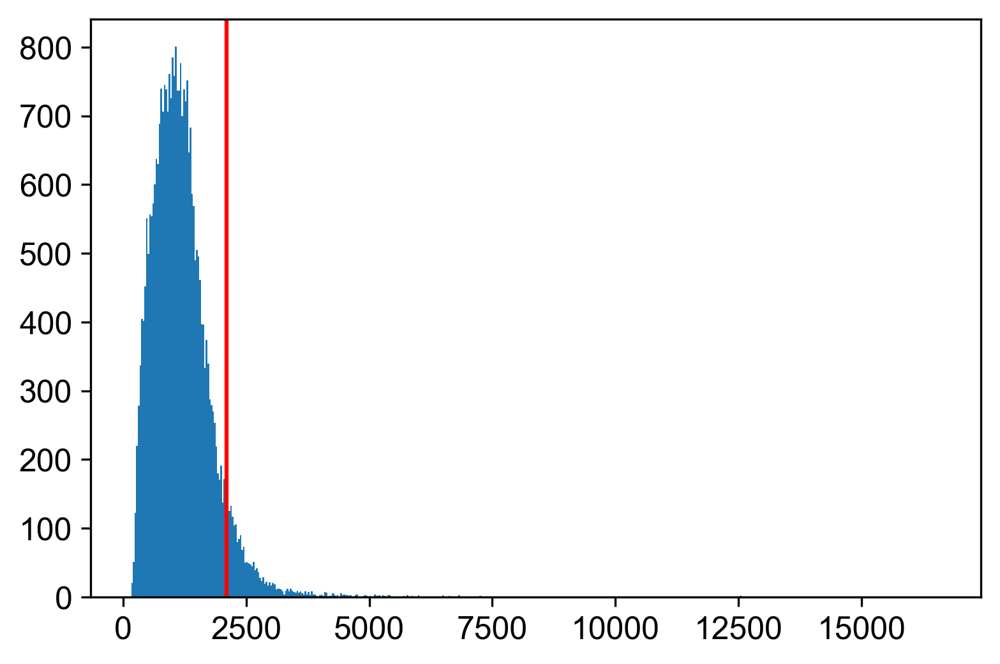

/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/1785797769.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_run[label_col] = df[stain_col]>cutoff


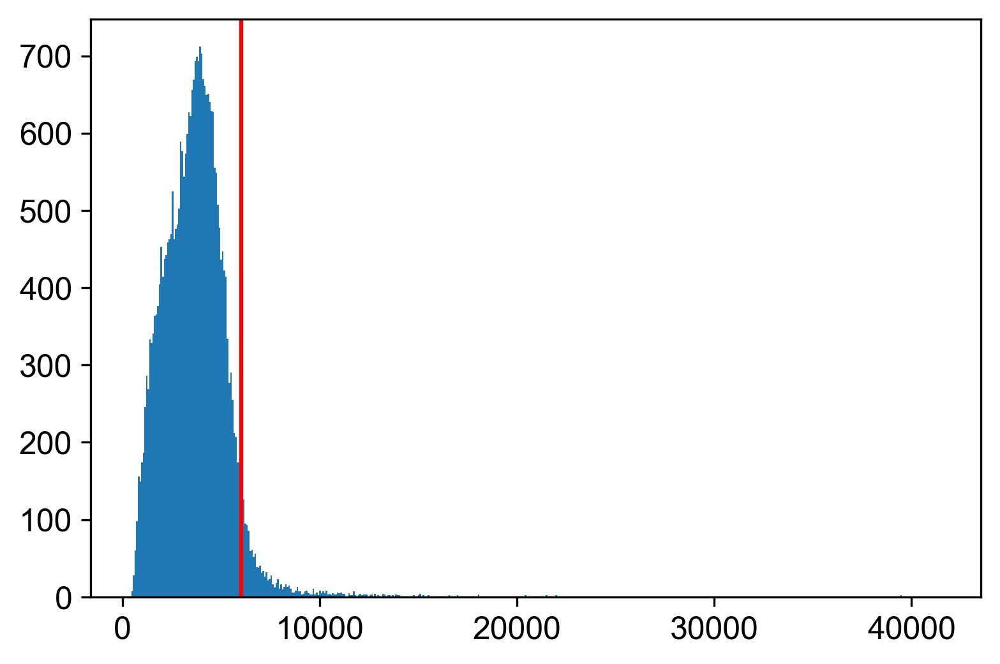

/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/1785797769.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_run[label_col] = df[stain_col]>cutoff
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/1785797769.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax=sns.barplot(stats_df,x=split_col,y=new_counts_col,palette=palette,edgecolor='black',errcolor='black',errwidth=2,order=order)
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/1785797769.py:5: FutureWarning: 

The `errcolor` parameter is deprecated. And will be removed in v0.15.0. Pass `err_kws={'color':

   run    RGC Type  Proportion Melanopsin+
0   26          C1                0.032480
1   26         C10                0.049571
2   26         C11                0.032175
3   26         C12                0.063882
4   26         C13                0.037831
..  ..         ...                     ...
87  23          C6                0.023358
88  23          C7                0.087417
89  23          C8                0.074246
90  23          C9                0.018817
91  23  Unassigned                0.058914

[92 rows x 3 columns]


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/1785797769.py:11: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


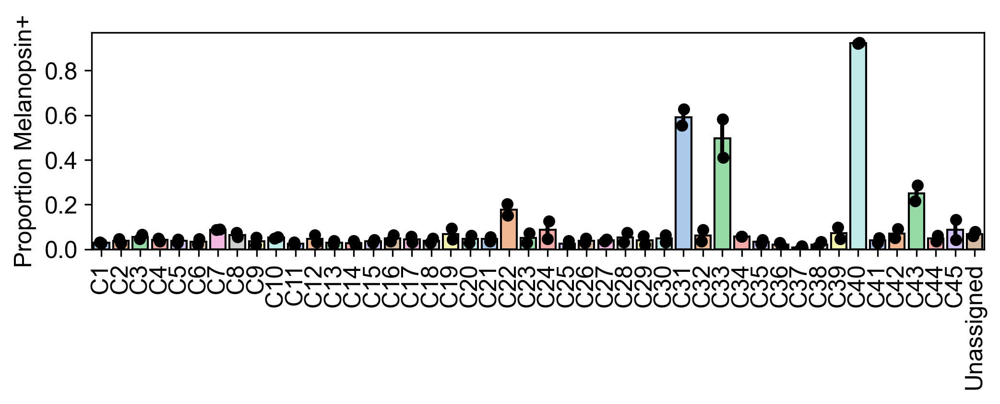

In [201]:
def props_labeled(df,rep_col,split_col,label_col,new_counts_col,palette,output_f,order=None,figsize=(10,5)):
    fig,ax=plt.subplots(figsize=figsize)
    stats_df = pd.DataFrame(df.groupby([rep_col,split_col])[label_col].agg('mean').rename().reset_index(name=new_counts_col))
    print(stats_df)
    ax=sns.barplot(stats_df,x=split_col,y=new_counts_col,palette=palette,edgecolor='black',errcolor='black',errwidth=2,order=order)
    sns.stripplot(stats_df,x=split_col,y=new_counts_col,ax=ax,color='black',order=order,size=6)

    ax.tick_params(axis='x',rotation=90)
    ax.set_xlabel("")
    fig.savefig(output_f,bbox_inches='tight')
    fig.show()


def label_dist(adata,run_cutoffs,split_col,rep_col,values_to_include,palette,output_f,stain_col='Anti-Rat',label_col='CD31 labeled', new_counts_col='Proportion CD31+', order=None,figsize=(10,5)):

    if values_to_include is None:
        values_to_include = list(adata.obs[split_col].unique())

    
    df = adata.obs[(adata.obs[rep_col].isin(list(run_cutoffs.keys())))& (adata.obs[split_col].isin(values_to_include))]
    for col in [rep_col, split_col]:
        df[col] = df[col].cat.remove_unused_categories()

    splits=[]
    for run in run_cutoffs:
        cutoff=run_cutoffs[run][stain_col]
        df_run = df[df['run']==run]
        plt.hist(df_run[stain_col],bins=500)
        plt.axvline(cutoff,color='red')
        plt.show()
        df_run[label_col] = df[stain_col]>cutoff
        splits.append(df_run)
    
    df=pd.concat(splits)
        

    props_labeled(df,rep_col=rep_col,split_col=split_col,label_col=label_col,new_counts_col=new_counts_col,palette=palette,output_f=output_f,figsize=figsize,order=order)
#runs with Melanopsin

#More stringent cutoffs cutoffs
run_cutoffs = {
    26:{'Cellbound3':2100},
    #15:{'Anti-Goat':1300},
    23:{'Cellbound3':6000},
}


runs = [int(run) for run in list(run_cutoffs.keys())]
arr  = [sc.read_h5ad(os.path.join(BASE_DIR,"data",f"140g_rn{run}_130","RGC_only.h5ad")) for run in runs]

adata = ad.concat(arr,label='run',keys=runs,index_unique='_rn')
adata.obs['RGC Type'] = pd.Categorical(adata.obs['cluster'].map(CLUST_MAP))
adata[adata.obs['RGC Type']!='Unassigned']

with plt.rc_context(CONTEXT):
    label_dist(
        adata=adata,run_cutoffs=run_cutoffs,split_col='RGC Type',rep_col='run',palette='pastel',values_to_include=None,
        stain_col='Cellbound3',label_col='Melanopsin labeled', new_counts_col='Proportion Melanopsin+',
        output_f=os.path.join(figure_dir,f"Melanopsin+{suffix}.pdf"),figsize=(8,2),order=RGC_ORDER
    )


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/378577686.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(df,x='RGC Type',linecolor='black',y='Cellbound3',fliersize=0,order =[f'C{i}' for i in range(1,46)] + ['Unassigned'],palette='pastel')


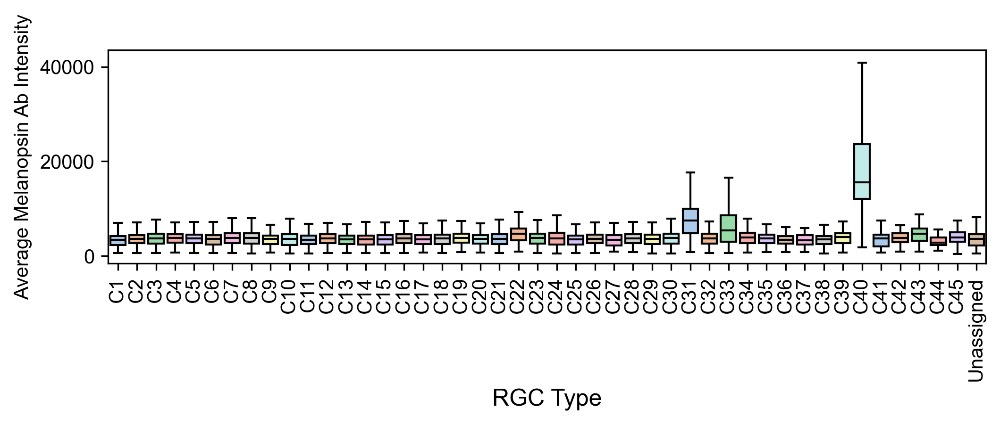

/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/378577686.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(df,x='RGC Type',linecolor='black',y='Cellbound3',fliersize=0,order =[f'C{i}' for i in range(1,46)] + ['Unassigned'],palette='pastel')


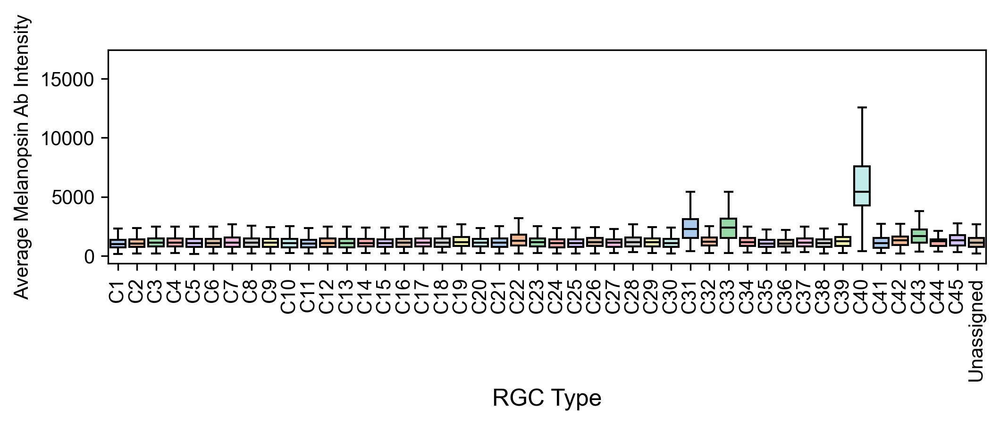

In [202]:


CONTEXT2 = CONTEXT.copy()
CONTEXT2['figure.figsize'] = (8,2)
with plt.rc_context(CONTEXT2):
    for run in [23,26]:
        df = adata.obs[adata.obs['run']==run]
        avg_intens = df.groupby('RGC Type')['Cellbound3'].mean()
        order = df.groupby('RGC Type')['Cellbound3'].mean().sort_values(ascending=False).index
        sns.boxplot(df,x='RGC Type',linecolor='black',y='Cellbound3',fliersize=0,order =[f'C{i}' for i in range(1,46)] + ['Unassigned'],palette='pastel')
        plt.xticks(rotation=90,fontsize=10)
        plt.yticks(fontsize=10)
        plt.ylabel('Average Melanopsin Ab Intensity',fontsize=10)
        plt.savefig(os.path.join(figure_dir,f"{run}_Melanopsin_intensity{suffix}.pdf"))
        plt.show()

## Figure S4D

In [203]:
def micron_to_mosaic_fxn(A, xy_micron,XL=0,YL=0,dr=None):
    aug_m = np.vstack( (xy_micron, np.ones((1,xy_micron.shape[1])) ) )
    xy_mosaic  = (A@aug_m)[:-1]
    shift_arr = np.array([[XL]*xy_micron.shape[1], [YL]*xy_micron.shape[1]])
    xy_mosaic  = xy_mosaic - shift_arr
    if (dr is not None) and (dr != 1):
        xy_mosaic = xy_mosaic//dr
    xy_mosaic=xy_mosaic.astype(int)
    return xy_mosaic





In [ ]:
run,region = 26,1
c1,c2= 'C33','C22'
t_col = f'final_assignment{suffix}'
r=5




img = cv2.imread(os.path.join(BASE_DIR,"imaging_scripts","images",f"140g_rn{run}_rg{region}","mosaic_Cellbound3_z7_dr4.tif"),cv2.IMREAD_GRAYSCALE)
A= pd.read_csv(os.path.join(BASE_DIR,"imaging_scripts","mappings",f"140g_rn{run}_rg{region}","micron_to_mosaic_pixel_transform.csv"), header=None, sep=' ').values

intens = 190

img = cv2.normalize(img,None,0,255,norm_type=cv2.NORM_MINMAX)
df_rg= adata[adata.obs['region']==region].obs
j_img = np.zeros((img.shape[0],img.shape[1],3),dtype=np.uint8)
j_img[:,:,2] = img.copy()

for chan,ctype in zip([0,1],[c1,c2]):
    df_c = df_rg[df_rg[t_col]==ctype]
    xy_coords = micron_to_mosaic_fxn(A,df_c[['center_x','center_y']].values.T,dr=4).T
    print(len(xy_coords),ctype)
    for x,y in xy_coords:
        j_img[y-r:y+r,x-r:x+r,chan] = intens
    




#cv2.imwrite(os.path.join(BASE_DIR,"imaging_scripts","images",f"140g_rn{run}_rg{region}",f"R-{c1}-G-{c2}-B-Opn4.tif"),cv2.cvtColor(j_img, cv2.COLOR_RGB2BGR))

In [205]:
sample_cells = {#x,y,w,h
    'C40':[(8044,3374,20,20),(6560,3404,20,20),(6070,2786,20,20)],
    'C33':[(9442,7699,15,15),(10357,8430,15,15),(7082,3501,15,15)],
    'C31':[(9372,7476,15,15),(9303,7959,15,15),(4901,10879,15,15)],
    'C43':[(7957,3540,15,15),(2734,3114,15,15),(8145,3773,15,15)],
    'C22':[(8265,3532,15,15),(1156,6916,15,15),(6573,3239,15,15),(7500,3503,15,15)],
}

/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/1462480445.py:22: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


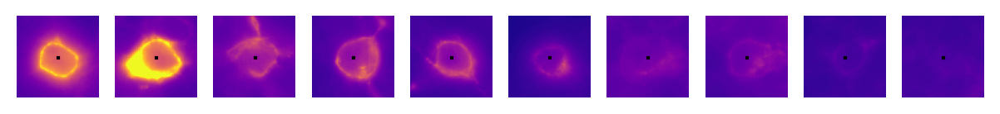

In [206]:
ctypes = ['C40','C31','C33','C43','C22']
c_to_ex = {'C40':[0,1],'C31':[0,1],'C33':[0,1],'C43':[0,1],'C22':[2,3]}
n_cols = sum([len(c_to_ex[x]) for x in c_to_ex])
n_rows=1
plot_h= 0.75
w,h,=30,30
fig,ax = plt.subplots(nrows=n_rows,ncols=n_cols,figsize=(n_cols*plot_h,plot_h*n_rows))
vmin,vmax=0,144
s=60

i=0
with plt.rc_context({'figure.dpi':300}):
    for ctype in ctypes:
        for r_n in c_to_ex[ctype]:
            x,y,_,_ = sample_cells[ctype][r_n]
            sub_img = img[y-h:y+h,x-w:x+w]
            ax[i].imshow(sub_img,vmin=vmin,vmax=vmax,cmap='plasma')
            ax[i].scatter([30],[30],color='black',s=3,marker='+')
            ax[i].set_axis_off()
            i+=1
fig.savefig(os.path.join(figure_dir,"Melanopsin_staining_images_supplement.pdf"))
fig.show()

        


## Figure S4C

/opt/anaconda3/envs/RGC/lib/python3.10/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value
/opt/anaconda3/envs/RGC/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:843: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/opt/anaconda3/envs/RGC/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:843: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


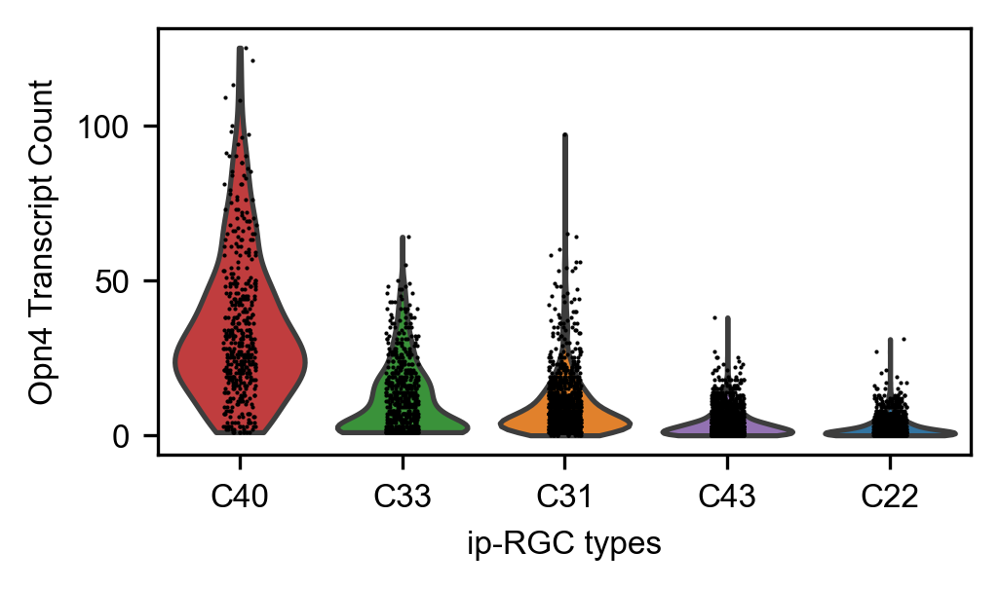

In [208]:
adata = sc.read_h5ad(os.path.join(BASE_DIR,"data","control_130_6",JOINT_ADATA))
suffix=""
with plt.rc_context({'figure.dpi':300,'font.size':8,'figure.figsize':(4,2)}):
    sc.pl.violin(adata[adata.obs[f'final_assignment{suffix}'].isin(['C40','C33','C31','C22','C43'])],keys=['Opn4'],show=False,groupby=f'final_assignment{suffix}',layer='raw',order=['C40','C33','C31','C43','C22'])
    plt.xlabel('ip-RGC types')
    plt.ylabel('Opn4 Transcript Count')
    plt.savefig(os.path.join(figure_dir,f"Opn4_transcript_count{suffix}.pdf"))

In [209]:
adata = sc.read_h5ad(os.path.join(BASE_DIR,"data","control_130_6",JOINT_ADATA))
adata_rgc= sc.read_h5ad(os.path.join(BASE_DIR,"data","control_130_6",JOINT_RGC))

# Figure 4

In [213]:
def create_C16_subclass(adata,old_col='final_assignment',new_col='subtyped_assignments',orig=True):
    adata.obs['Calb1'] = pd.Series(adata[:,'Calb1'].X.toarray()[:,0],index=adata.obs.index)
    try:
        adata.obs[new_col]= adata.obs[old_col].cat.add_categories(['C16_D','C16_V'])
    except Exception as e:
        raise AssertionError(e)
    if orig:
        adata.obs.loc[(adata.obs['Calb1'] > 1.75) & (adata.obs[new_col]=='C16') ,new_col] = 'C16_D'
        adata.obs.loc[(adata.obs['Calb1'] <= 1.75) & (adata.obs[new_col]=='C16'),new_col] = 'C16_V'
    else:
        adata.obs.loc[(adata.obs['Calb1'] > 1.4) & (adata.obs[new_col]=='C16') ,new_col] = 'C16_D'
        adata.obs.loc[(adata.obs['Calb1'] <= 1.4) & (adata.obs[new_col]=='C16'),new_col] = 'C16_V'
    adata.obs[new_col] = adata.obs[new_col].cat.remove_categories(['C16'])
    del adata.obs['Calb1']


import matplotlib.colors as colors
def truncate_colormap(cmap,min_val=0.0,max_val=1.0,n=100):
    new_cmap = colors.LinearSegmentedColormap.from_list(
        'trunc({n},{a:.2f},{b:.2f})'.format(n=cmap.name, a=min_val, b=max_val),
        cmap(np.linspace(min_val, max_val, n)))
    return new_cmap
    


In [220]:
# Create rotated alignments from Fig1 code first
figure_dir=os.path.join(BASE_DIR,"figures","Figure_4")
RGC_TYPE_PALETTE='Pastel1'


orig_types = [f'C{i}' for i in range(1,46)]

rna_func_map = dict(zip())

data_dir=os.path.join(BASE_DIR,"data","control_130_6")
adata = sc.read_h5ad(os.path.join(data_dir,JOINT_ADATA))
suffix=""
class_col = f"class{suffix}"
cmap = plt.get_cmap('plasma')
new_cmap = truncate_colormap(cmap,0,0.9,n=1000)
create_C16_subclass(adata,old_col=f'final_assignment{suffix}',new_col=f'final_assignment{suffix}',orig=True)


## Figure S5A, S5B

In [221]:
def plot_specific_types(adata,types,col='final_assignment',x_col='aligned_center_x',y_col='aligned_center_y'):
    runs= adata.obs['run'].unique()
    fig,ax=plt.subplots(nrows=len(types), ncols=len(runs),figsize=(len(runs)*5,len(types)*5))

    for i,ax_type in enumerate(ax):
        for j,ax_tr in enumerate(ax_type):
            ct = types[i]
            run = runs[j]

            df = adata.obs[(adata.obs['run']==run) & (adata.obs[col] == ct)]
            df_o = adata.obs[(adata.obs['run']==run) & (adata.obs[col] != ct)]
            ax_tr.scatter(df_o[x_col],df_o[y_col],color='blue',s=0.0001)
            ax_tr.scatter(df[x_col],df[y_col],color='orange',s=5)

from mpl_toolkits.axes_grid1 import make_axes_locatable
import cv2
import matplotlib.patches as patches


def plot_type_groups(adata,grouped_types,type_col='final_assignment',x_col='aligned_center_x',y_col='aligned_center_y',show_img=True,show_scatter=False,dpi=300,bins=150,kernel=(45,45),ratio=False,eps=300,sigmaX=15,cmap='coolwarm',masked=None,ellipsoid=None,invert_x=False,output_f=os.path.join(figure_dir,"Smoothed_heatmap.pdf")):
    NEW_CONTEXT = CONTEXT.copy()
    NEW_CONTEXT['figure.dpi'] = dpi
    assert show_img^show_scatter
    max_len = max([len(grouped_types[t]) for t in grouped_types])
    nrows = len(grouped_types)
    fig,ax_b=plt.subplots(nrows=nrows,ncols=max_len,figsize=(max_len*1.5,1.8*nrows))
    if nrows == 1:
        ax_b = [ax_b]
    if max_len == 1:
        for j,ax in enumerate(ax_b):
            ax_b[j] = [ax]

    with plt.rc_context(CONTEXT):

        for j,type_name in enumerate(grouped_types):
            types = grouped_types[type_name]
            ax= ax_b[j]
            for i,t in enumerate(types):

                adata_f = adata[adata.obs[type_col] == t]
                adata_g = adata
                if show_img:
                    type_hist = np.histogram2d(adata_f.obs[y_col],adata_f.obs[x_col],bins=bins)[0]
                    out_hist = np.histogram2d(adata_g.obs[y_col],adata_g.obs[x_col],bins=bins)[0]
                    binned = (type_hist)/(out_hist+eps)
                    smoothed = cv2.GaussianBlur(binned,kernel,sigmaX=sigmaX)
                    vmin = np.percentile(smoothed,1)
                    vmax = np.percentile(smoothed,95)
                    if masked is not None:
                        smoothed = np.where(masked==0,0,smoothed)
                    if not ratio:
                        img = ax[i].imshow(smoothed,interpolation='bilinear',cmap=cmap,vmin=vmin,vmax=vmax)
                    else:
                        smoothed1 = cv2.GaussianBlur(type_hist,kernel,sigmaX=sigmaX)
                        smoothed2 = cv2.GaussianBlur(out_hist+eps,kernel,sigmaX=sigmaX)
                        img = ax[i].imshow(smoothed1/smoothed2,interpolation='bilinear',cmap=cmap,vmin=np.percentile(smoothed,1),vmax=np.percentile(smoothed,95))
                    
                    if ellipsoid is not None:
                        patch = patches.Ellipse(*ellipsoid,fill=False,edgecolor='black')
                        patch_poly = ax[i].add_patch(patch)
                        img.set_clip_path(patch)


                        
                    #smoothed = cv2.GaussianBlur(type_hist,(45,45),sigmaX=15)
                    #img = ax[i].imshow(smoothed,interpolation='nearest',cmap='coolwarm',vmax=np.percentile(smoothed,99))
                    ax[i].invert_yaxis()
                    if invert_x:
                        ax[i].invert_xaxis()
                elif show_scatter:
                    ax[i].scatter(adata_g.obs[x_col],adata_g.obs[y_col],s=0.0001,color='grey',rasterized=True)
                    ax[i].scatter(adata_f.obs[x_col],adata_f.obs[y_col],s=0.2,color='purple',rasterized=True)
                ax[i].set_axis_off()
                ax[i].set_title(t)
            i+=1
            
            while i < max_len:
                ax[i].set_axis_off()
                ax[i].set_title("")
                ax[i].invert_yaxis()
                i+=1



            #divider = make_axes_locatable(ax[max_len-1])
            #cax = divider.append_axes('right', size='5%', pad=0.05)
            #fig.colorbar(img, cax=cax, orientation='vertical')

        fig.savefig(os.path.join(output_f))
        fig.show()
        return type_hist,out_hist,smoothed
                #ax = sns.scatterplot(adata_f.obs,x='aligned_center_x',y='aligned_center_y',s=1.5,color='blue',legend=None)
            #sns.scatterplot(adata_g.obs,x='aligned_center_x',y='aligned_center_y',s=0.05,color='grey',legend=None,ax=ax)
            #plt.show()



In [222]:
def calc_scores(adata,class_col='class',col='final_assignment',randomized=False):
    df = adata[(adata.obs[class_col]=='RGC') & (adata.obs[col]!='Unassigned')].obs.copy()
    if randomized:
        df['randomized_assignment'] = pd.Series(df[col].sample(frac=1).values,index=df.index)
        col='randomized_assignment'
    score_lst = []
    for axis in ['dorsal','nasal']:
        #df[col] = pd.Categorical(df[col])
        props=(df.groupby(['run',axis])[col].value_counts() ) / ( df.groupby(['run',axis]).size() )
        key=f'props_{axis}'
        props=props.reset_index(name=key)
        scores = pd.DataFrame(props[props[axis]].set_index(['run',col])[key]/ props[~props[axis]].set_index(['run',col])[key])
        score_lst.append(scores)

    fscores = pd.concat(score_lst,axis=1).reset_index()
    fscores['props_temporal']= 1/fscores['props_nasal']
    fscores['D/V Score'] = np.emath.log2(fscores['props_dorsal'])
    fscores['T/N Score'] = np.emath.log2(fscores['props_temporal'])
    fscores.replace([np.inf, -np.inf], np.nan, inplace=True)
    fscores.dropna(subset=["D/V Score", "T/N Score"],how='any', inplace=True)
    gscores = fscores.groupby(col).agg({'D/V Score':{'mean','std'},'T/N Score':{'mean','std'}})
    
    return fscores,gscores
    

In [ ]:

MOD_CONTEXT = CONTEXT.copy()
MOD_CONTEXT['figure.figsize'] = (8.5,2.25)
MOD_CONTEXT['font.size'] = 8
linewidth=0.5
s=3

fscores_joint = []
n_reps = 1000
for run in adata.obs['run'].unique():
    for i in range(n_reps): 
        fscores, _ = calc_scores(adata[adata.obs['run']==run],class_col=class_col,col=f'final_assignment{suffix}',randomized=True)
        fscores['run'] = run
        fscores['rep'] = i
        fscores_joint.append(fscores)
fscores_joint = pd.concat(fscores_joint)
fscores_joint.index = list(range(len(fscores_joint)))
fscores_joint.to_csv(os.path.join(BASE_DIR, "data","simulations",f"fscores_n{n_reps}.csv"))

In [223]:

def quant_dist(fscores,type_col='final_assignment',score_col='D/V Score',color='lightblue',p_height=-1,p_fontsize=10,s=3,linewidth=0.5,ylim=(-2.5,2.5),fscores_random=None,errorbar=None,output_f=os.path.join(figure_dir,"Dorsal_Ventral.pdf")):
    with plt.rc_context(MOD_CONTEXT):
        gscores = fscores.groupby(type_col).agg({score_col:{'mean','std'}})
        order = gscores[score_col]['mean'].sort_values().index
        statistics = []
        mean_scores = []
        denote_markings=True
        
        ax=sns.barplot(data=fscores,x=type_col,y=score_col,color=color,edgecolor='black',order = order ,err_kws={'linewidth':linewidth})

        
        if fscores_random is not None:
            pass
            sns.barplot(data=fscores_random,x=type_col,y=score_col,color=None,edgecolor=None,order = order ,errorbar=errorbar,err_kws={'linewidth':1,'color':'grey'},capsize=0.5,ax=ax)
            
        for rt in order:
            vals = fscores[fscores[type_col]==rt][score_col].values
            alternative='less'
            mean_score = np.mean(vals)
            if mean_score > 0:
                alternative='greater'
            mean_scores.append(mean_score)
            
            result= scipy.stats.ttest_1samp(vals,popmean=0,alternative='two-sided')
            statistics.append(result.pvalue)
        
        print(statistics)
        statistics = scipy.stats.false_discovery_control(statistics)
        if not isinstance(p_height, list):
            if isinstance(p_height,int):
                p_height=[p_height]*len(order)
            elif isinstance(p_height,str) and p_height=='auto':
                p_height = [1.02 if mean_score < 0 else 0.5 for mean_score in mean_scores]
        markers= []
        for p,stat,h in zip(ax.patches,statistics,p_height):
            if not denote_markings:
                mark='p = {:.1e}'.format(stat)
            else:
                if stat <0.005:
                    mark = '**'
                elif stat <0.05:
                    mark='*'
                else:
                    mark=''
            markers.append(mark)
                
            ax.annotate(mark,xy=(p.get_x()+p.get_width()/2,h-1),ha='center',va='bottom',fontsize=p_fontsize,color='black')
        sns.stripplot(data=fscores,x=type_col,y=score_col,color='black',ax=ax,edgecolor='black',order=gscores[score_col]['mean'].sort_values().index,s=s)
        plt.xticks(rotation=90)
        plt.ylim(ylim)
        plt.xlabel('')
        plt.savefig(output_f,bbox_inches='tight')
        plt.show()
        
    return dict(zip(order,statistics))
    


In [225]:
fscores_joint = pd.read_csv(os.path.join(BASE_DIR,"data","simulations","fscores_n{}.csv".format(1000)),index_col=0)
fscores_joint.rename(columns={'final_assignment':f'final_assignment{suffix}'},inplace=True)

[0.05389897581800455, 8.515129315655563e-05, 0.028380932312824174, 5.807635896363544e-05, 0.004236511026323593, 9.280521691808468e-05, 2.6203984574480376e-05, 0.00044011413655271686, 0.0032280030567211192, 0.0005525868080439729, 0.07133405093593274, 0.010667584096057706, 0.02205272221897914, 0.013717933348161654, 0.5507172476803832, 0.44574481596901555, 0.30085831665893537, 0.707574145837035, 0.5565236481683347, 0.7530756029110897, 0.7719767706390737, 0.9429527225878471, 0.8390072841425505, 0.3332366667274433, 0.0048931272742869835, 0.07656038233355475, 0.11408851388230738, 0.2644611604233913, 0.18293179482279937, 0.19245672787655846, 0.10886322514774129, 0.03233641198945251, 0.017831024208796915, 0.01634791498350336, 0.0040798080506067305, 0.0024761137630296506, 0.0004790001660498011, 0.0033656505052627817, 0.0008699406103866388, 0.000906012219515772, 8.629978023094675e-07, 6.365062243410056e-05, 0.0009060901741176875, 0.0006685294241981428, 0.003116540330675556, 0.004911078010719082]

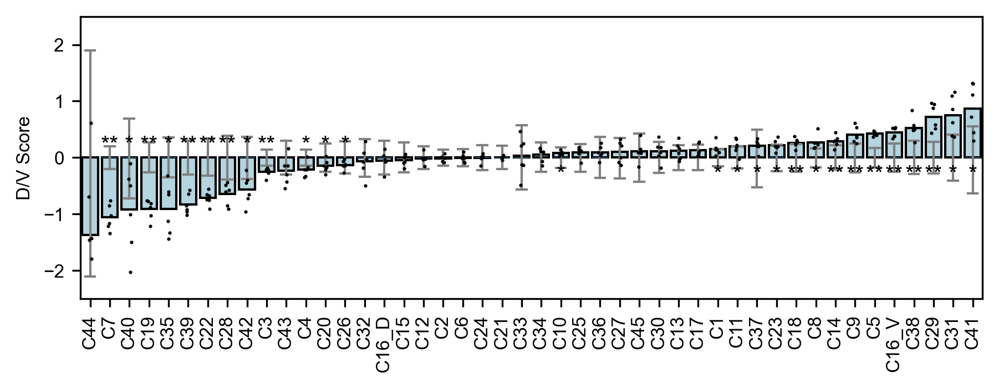

[0.00036889945606030037, 0.0005307553432849962, 3.660603703041492e-05, 0.002026523756587681, 0.0035028028447067136, 0.010855713040337837, 0.001962815043937413, 0.00041138398626055394, 0.011883244975110067, 0.0002003560867244535, 0.010670551625445958, 0.10253316350289325, 0.07066677262627653, 0.04176645349104364, 0.4764161566093501, 0.3297712335107192, 0.8820024752202712, 0.6982085530562683, 0.7131756201170067, 0.8365299187326045, 0.473481597257643, 0.732420898492651, 0.9538037442778172, 0.687869905946928, 0.005187641235441272, 0.3728857402031411, 0.00041260944696494355, 0.01698662456077243, 0.0007580904802757043, 0.017051692982333045, 0.03522721583058146, 0.007418529254686481, 0.00044115047803013985, 3.609272458542457e-05, 0.008189593733641115, 0.0009752586546334284, 0.0009177510064462508, 0.00043769953440649464, 0.00012994166369730182, 0.00012938842279632478, 0.23153577528200064, 0.015450985839475203, 0.00019281336860874418, 0.00036294554683759597, 8.619938735187726e-06, 7.28674967333

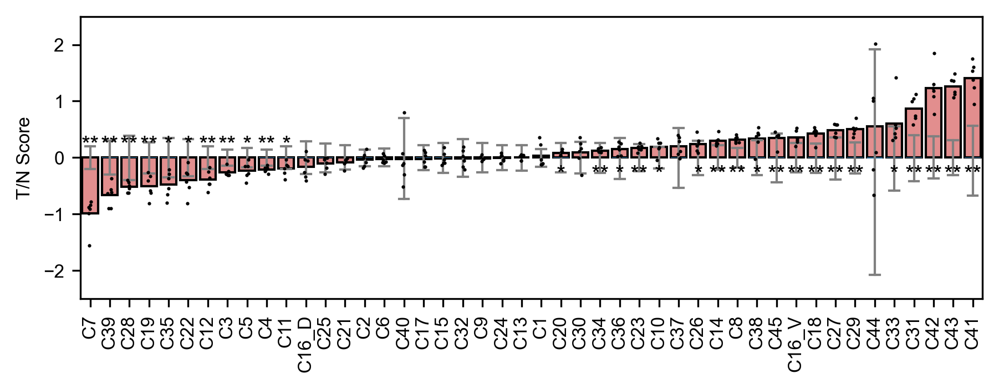

In [226]:

MOD_CONTEXT = CONTEXT.copy()
#MOD_CONTEXT['figure.figsize'] = (8.5,2.25)
MOD_CONTEXT['figure.figsize'] = (7,2.25)
MOD_CONTEXT['font.size'] = 8

linewidth=0.5
s=3
fscores_joint = fscores_joint.rename(columns={'randomized_assignment':f'final_assignment{suffix}'})
fscores,gscores=  calc_scores(adata,class_col=class_col,col=f'final_assignment{suffix}')
fscores.replace([np.inf, -np.inf], np.nan, inplace=True)

p1 = quant_dist(fscores,type_col=f'final_assignment{suffix}',score_col='D/V Score',color='lightblue',s=1.5,p_height='auto',errorbar='pi', linewidth=0,fscores_random=fscores_joint,output_f=os.path.join(figure_dir,f"Dorsal_Ventral_CI_{suffix}.pdf"))
p2 = quant_dist(fscores,type_col=f'final_assignment{suffix}',score_col='T/N Score',color='lightcoral',s=1.5,p_height='auto',errorbar='pi',linewidth=0,fscores_random=fscores_joint, output_f=os.path.join(figure_dir,f"Nasal_Temporal_CI_{suffix}.pdf"))

[0.05389897581800455, 8.515129315655563e-05, 0.028380932312824174, 5.807635896363544e-05, 0.004236511026323593, 9.280521691808468e-05, 2.6203984574480376e-05, 0.00044011413655271686, 0.0032280030567211192, 0.0005525868080439729, 0.07133405093593274, 0.010667584096057706, 0.02205272221897914, 0.013717933348161654, 0.5507172476803832, 0.44574481596901555, 0.30085831665893537, 0.707574145837035, 0.5565236481683347, 0.7530756029110897, 0.7719767706390737, 0.9429527225878471, 0.8390072841425505, 0.3332366667274433, 0.0048931272742869835, 0.07656038233355475, 0.11408851388230738, 0.2644611604233913, 0.18293179482279937, 0.19245672787655846, 0.10886322514774129, 0.03233641198945251, 0.017831024208796915, 0.01634791498350336, 0.0040798080506067305, 0.0024761137630296506, 0.0004790001660498011, 0.0033656505052627817, 0.0008699406103866388, 0.000906012219515772, 8.629978023094675e-07, 6.365062243410056e-05, 0.0009060901741176875, 0.0006685294241981428, 0.003116540330675556, 0.004911078010719082]

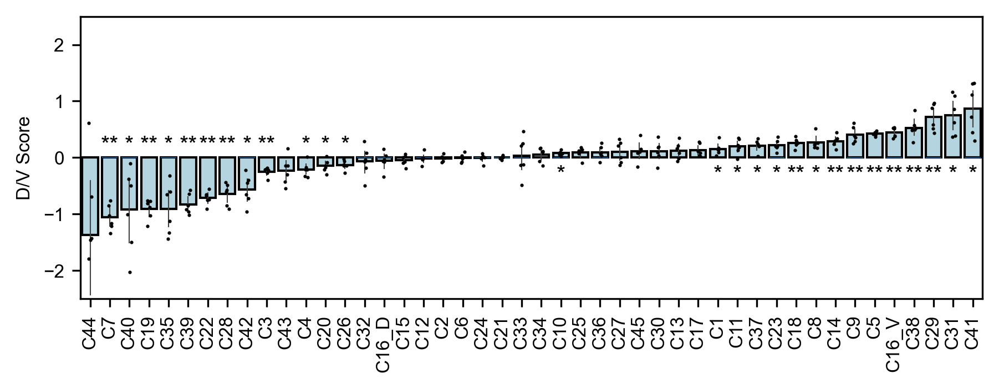

[0.00036889945606030037, 0.0005307553432849962, 3.660603703041492e-05, 0.002026523756587681, 0.0035028028447067136, 0.010855713040337837, 0.001962815043937413, 0.00041138398626055394, 0.011883244975110067, 0.0002003560867244535, 0.010670551625445958, 0.10253316350289325, 0.07066677262627653, 0.04176645349104364, 0.4764161566093501, 0.3297712335107192, 0.8820024752202712, 0.6982085530562683, 0.7131756201170067, 0.8365299187326045, 0.473481597257643, 0.732420898492651, 0.9538037442778172, 0.687869905946928, 0.005187641235441272, 0.3728857402031411, 0.00041260944696494355, 0.01698662456077243, 0.0007580904802757043, 0.017051692982333045, 0.03522721583058146, 0.007418529254686481, 0.00044115047803013985, 3.609272458542457e-05, 0.008189593733641115, 0.0009752586546334284, 0.0009177510064462508, 0.00043769953440649464, 0.00012994166369730182, 0.00012938842279632478, 0.23153577528200064, 0.015450985839475203, 0.00019281336860874418, 0.00036294554683759597, 8.619938735187726e-06, 7.28674967333

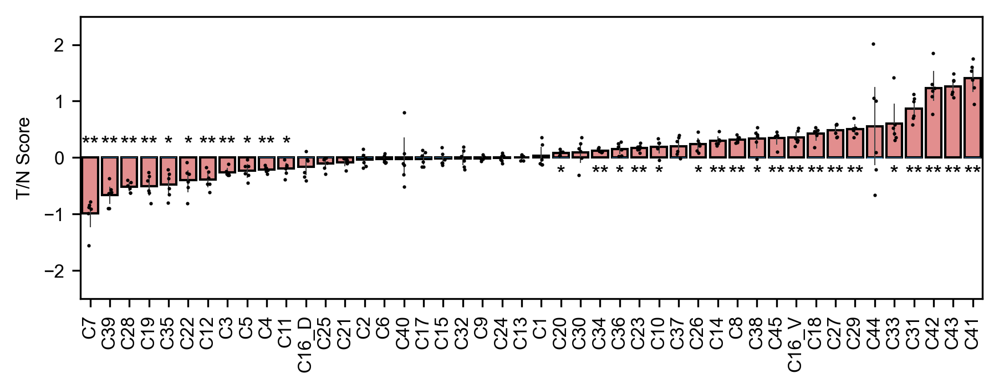

In [227]:

MOD_CONTEXT = CONTEXT.copy()
#MOD_CONTEXT['figure.figsize'] = (8.5,2.25)
MOD_CONTEXT['figure.figsize'] = (7,2.25)
MOD_CONTEXT['font.size'] = 8
linewidth=0.5
s=3
fscores_joint = fscores_joint.rename(columns={'randomized_assignment':f'final_assignment{suffix}'})
fscores,gscores=  calc_scores(adata,class_col=class_col,col=f'final_assignment{suffix}')
fscores.replace([np.inf, -np.inf], np.nan, inplace=True)

p1 = quant_dist(fscores,type_col=f'final_assignment{suffix}',score_col='D/V Score',color='lightblue',s=1.5,p_height='auto', fscores_random=fscores_joint,output_f=os.path.join(figure_dir,f"Dorsal_Ventral_v2{suffix}.pdf"))
p2 = quant_dist(fscores,type_col=f'final_assignment{suffix}',score_col='T/N Score',color='lightcoral',s=1.5,p_height='auto',fscores_random=fscores_joint, output_f=os.path.join(figure_dir,f"Nasal_Temporal_v2{suffix}.pdf"))

In [228]:
sig_types = [key for key in p1.keys() if p1[key] < 0.05 or p2[key] < 0.05]
print(len(sig_types))

34


[0.7719767706390737]


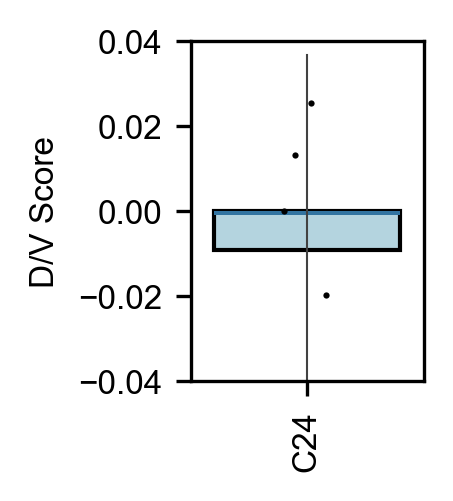

{'C24': 0.7719767706390737}

In [229]:
MOD_CONTEXT['figure.figsize'] = (1,1.5)
quant_dist(fscores[fscores[f'final_assignment{suffix}']=='C24'],type_col=f'final_assignment{suffix}',score_col='D/V Score',color='lightblue',s=1.5,p_height='auto',ylim=(-0.04,0.04), fscores_random=fscores_joint,output_f=os.path.join(figure_dir,f"C24_zoom_in{suffix}.pdf"))

[0.732420898492651]


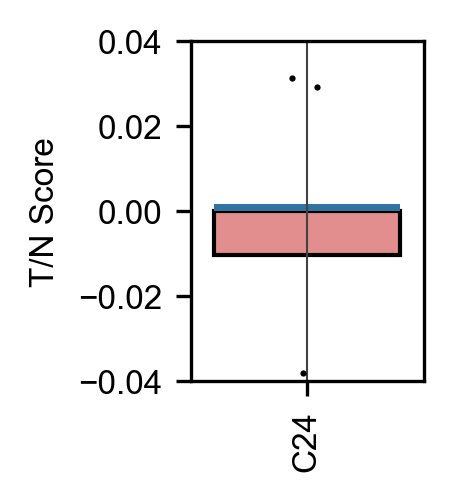

{'C24': 0.732420898492651}

In [230]:
quant_dist(fscores[fscores[f'final_assignment{suffix}']=='C24'],type_col=f'final_assignment{suffix}',score_col='T/N Score',color='lightcoral',s=1.5,p_height='auto',ylim=(-0.04,0.04), fscores_random=fscores_joint,output_f=os.path.join(figure_dir,f"C24_zoom_in_NT{suffix}.pdf"))

## Figure 4A (run S4A-S4B first )

In [231]:
def plot_biases(scores,xlim=(-2,2),ylim=[-2,2],filt=False,add_box=None, figsize=(8,8),errcolor='black',zero_width=0.5,zero_color='red',defaultcolor='grey',sig_color='black',plot_all=True,eps=0.01,s=1,elinewidth=0.2,legend_p_vals=None,legend_sizes=None,DV_ann_range=None,TN_ann_range=None,ann_fontsize=4,sig_types=None,n_ticks=5,output_f=""):
    fig,ax = plt.subplots(figsize=figsize,dpi=200)
    ax.axhline(0,color=zero_color,linewidth=zero_width,linestyle='--')
    ax.axvline(0,color=zero_color,linewidth=zero_width,linestyle='--')
    if add_box:
        ax.add_patch(add_box)

    #ax.errorbar(y=scores['D/V Score']['mean'],x=scores['T/N Score']['mean'],yerr=scores['D/V Score']['std'],xerr=scores['T/N Score']['std'],fmt='None',elinewidth=elinewidth,color=errcolor)
    if sig_types is None:
        sig_types = set(scores.index.values)
    
    counter = 0
    pt_colors = [defaultcolor] * len(scores)
    plotted_types = set()
    alphas = [0.4] * len(scores)
    for idx,i in enumerate(scores.index):
        tn_score,dv_score = scores.loc[i]['T/N Score']['mean'], scores.loc[i]['D/V Score']['mean']
        plot=False
        if DV_ann_range is not None and not (DV_ann_range[0] <= dv_score <= DV_ann_range[1]):
            assert DV_ann_range[0] <= DV_ann_range[1]
            plot=True

        elif TN_ann_range is not None and not (TN_ann_range[0] <= tn_score <= TN_ann_range[1]):
            assert TN_ann_range[0] <= TN_ann_range[1]
            plot=True
        elif plot_all:
            plot=True
        
        if i in sig_types:
            alphas[idx] = 1
            pt_colors[idx] = sig_color
            next_font_color = 'black'
            next_font_size = ann_fontsize
        else:
            next_font_color='grey'
            next_fon_size = ann_fontsize/2
            


        if plot:
            ax.annotate(text=i,xy=(tn_score+eps,dv_score+eps),fontsize=next_font_size,color=next_font_color)
            plotted_types.add(i)

        
        if i in sig_types:
            alphas[idx] = 1
            pt_colors[idx] = sig_color


        if i in sig_types and (-0.5 <= tn_score <= 0.5) and (-0.5 <= dv_score <= 0.5):
            counter+=1
    plt.scatter(y=scores['D/V Score']['mean'],x=scores['T/N Score']['mean'],edgecolors='lightgrey',linewidth=0.1,s=s,color=pt_colors,alpha=alphas)

            
        

    ax.set_ylabel('D/V Score',fontsize=ann_fontsize+1)
    ax.set_xlabel('T/N Score',fontsize=ann_fontsize+1)
  
    #plt.yticks(np.arange(ylim[0],ylim[1]+0.5,0.5),fontsize=ann_fontsize)
    #plt.xticks(np.arange(xlim[0],xlim[1]+0.5,0.5),fontsize=ann_fontsize)

    if legend_p_vals is not None:
        dummy_plots = []
        for p,ls in zip(legend_p_vals,legend_sizes):
            color = 'black' if p<=0.05 else 'grey'
            dummy_plots.append(plt.scatter([],[],s=ls,marker='o',color=color,edgecolors='lightgrey',linewidth=0.1,label="{:,.0e}".format(p)))

        plt.legend(handles=dummy_plots,scatterpoints=1,ncol=len(legend_p_vals),loc='upper center',fontsize=ann_fontsize)
        
    ax.set_aspect('equal', adjustable='box')
    ax.set_xlim(xlim)
    ax.set_ylim(ylim)
    
    plt.xticks(np.linspace(xlim[0],xlim[1],n_ticks),fontsize=ann_fontsize+1)
    plt.yticks(np.linspace(ylim[0],ylim[1],n_ticks),fontsize=ann_fontsize+1)
    fig.savefig(output_f)
    
    fig.show()
   
    return plotted_types

In [232]:
gscores['D/V Score','p-value'] = p1
gscores['T/N Score','p-value'] = p2

/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/3064656914.py:79: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


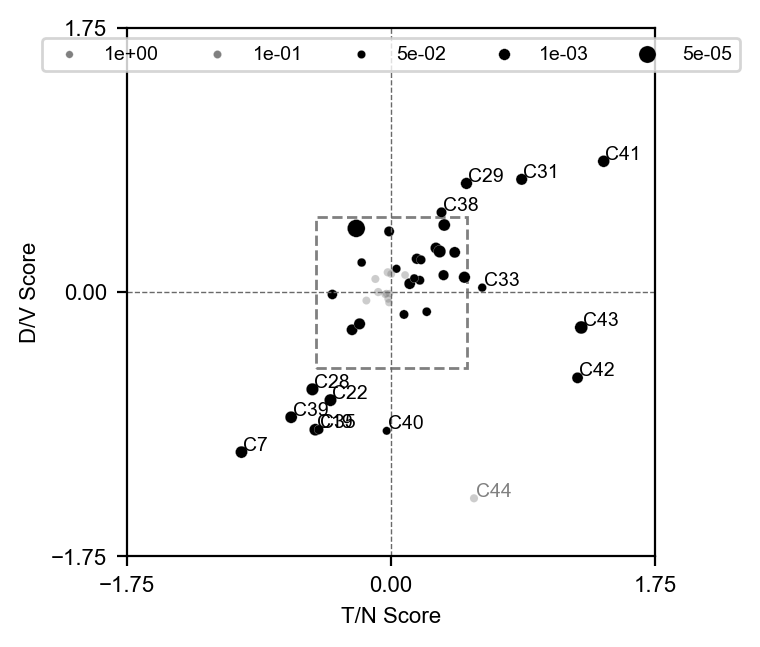

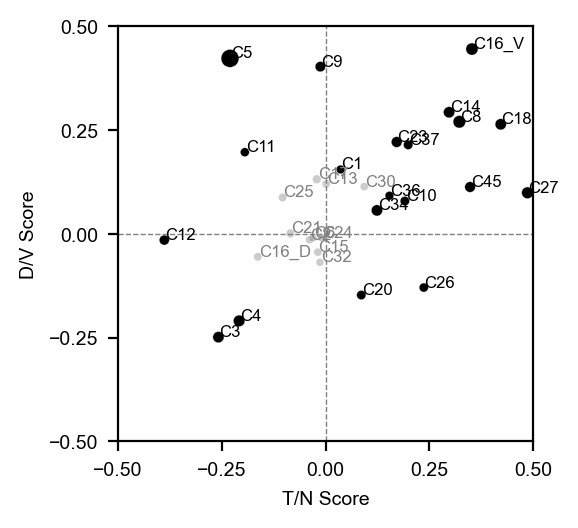

In [233]:

add_box = mpl.patches.Rectangle((-0.5,-0.5),width=1,height=1,edgecolor='grey',facecolor='white',linestyle='--')
s=np.exp(-np.log(np.minimum(gscores['T/N Score','p-value'].values,gscores['D/V Score','p-value'].values))*0.35)+6
#s=np.exp(np.minimum(gscores['T/N Score','p-value'].values,gscores['D/V Score','p-value'].values))
legend_p_vals = [1,1e-1,5e-2,1e-3,5e-5]
legend_sizes =np.exp(-np.log(np.array(legend_p_vals))*0.35)+6
with plt.rc_context(CONTEXT):
    pl1 = plot_biases(gscores,s=s,elinewidth=0.15,xlim=[-1.75,1.75],n_ticks=3,ylim=[-1.75,1.75],figsize=(3.5,3.5),add_box=add_box,output_f=os.path.join(figure_dir,f"Spatial_biases_v2{suffix}.pdf"),zero_color='dimgray',plot_all=False,DV_ann_range=[-0.5,0.5],TN_ann_range=[-0.5,0.5],ann_fontsize=7,sig_types=sig_types,legend_p_vals=legend_p_vals,legend_sizes=legend_sizes)
    pl2 = plot_biases(gscores,s=s,filt=True,elinewidth=0.2,figsize=(2.75,2.75),add_box=None, xlim=(-0.5,0.5),ylim=(-0.5,0.5),DV_ann_range=[-0,0],TN_ann_range=[-0,0],ann_fontsize=6,eps=0.002,zero_color='grey',plot_all=False,sig_types=sig_types,output_f=os.path.join(figure_dir,f"Spatial_biases_zoomed_v2{suffix}.pdf"))


In [234]:
p_cutoff =0.05
sig_types = set()
for group in [p1,p2]:
    for key in group:
        if group[key] < 0.05:
            sig_types.add(key)
print(len(sig_types))


34


## Figures 4B, S5C, S5D

In [235]:
# Create rotated alignments from Fig1 code first
figure_dir=os.path.join(BASE_DIR,"figures","Figure_4")
RGC_TYPE_PALETTE='Pastel1'
suffix=""

orig_types = [f'C{i}' for i in range(1,46)]

rna_func_map = dict(zip())

data_dir=os.path.join(BASE_DIR,"data","control_130_6")
adata = sc.read_h5ad(os.path.join(data_dir,JOINT_ADATA))


cmap = plt.get_cmap('plasma')
new_cmap = truncate_colormap(cmap,0,0.9,n=1000)
create_C16_subclass(adata,old_col=f'final_assignment{suffix}',new_col=f'final_assignment{suffix}')


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/981257966.py:90: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


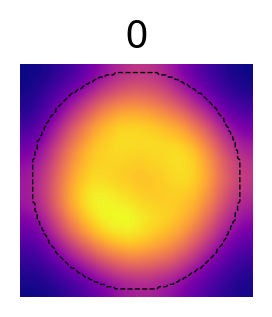

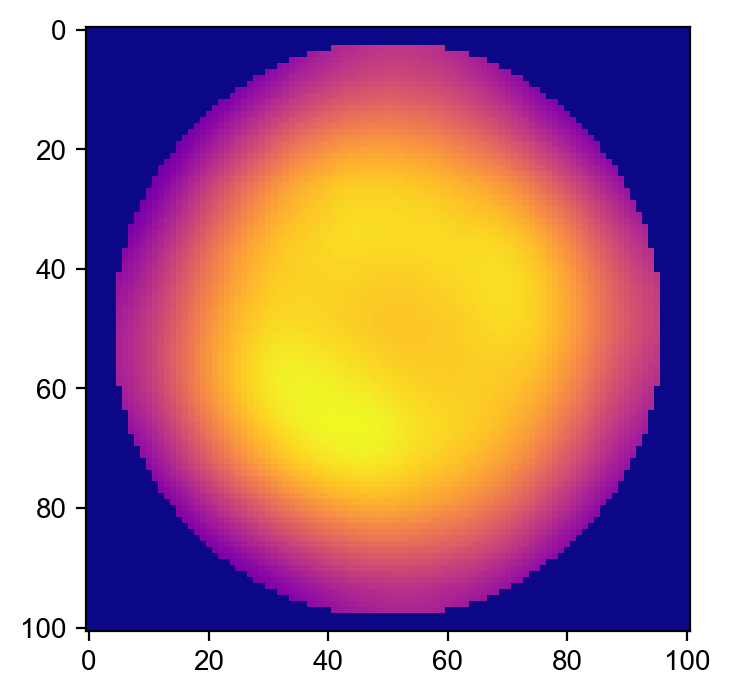

In [236]:
in_hist,out_hist,smoothed = plot_type_groups(
    adata[adata.obs['run'].isin([3,4,5,7,16,17])],
    grouped_types={'SAC':['0']},
    type_col='joint_leiden',
    x_col='final_x',
    y_col='final_y',
    bins=101,
    kernel=(41,41),
    cmap=new_cmap,
    sigmaX=15,
    output_f=os.path.join(figure_dir,"SAC.pdf")
)

m,n = smoothed.shape
cr,cc = m//2, n//2

r1,r2=48,46
masked = np.zeros(smoothed.shape)
for i in range(m):
    for j in range(n):
        if (cr-i)**2/(r1**2) + (cc-j)**2/(r2**2)  < 1:
            masked[i][j] = 255

plt.imshow(masked)

masked = np.array(masked,dtype='uint8')
im2, contours = cv2.findContours(masked, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
xy = im2[0][:,0,:]

plt.imshow(smoothed,cmap='plasma')
plt.plot(xy[:,0],xy[:,1],color='black',linestyle='--',linewidth=0.5)
plt.show()
plt.imshow(np.where(masked==0,0,smoothed),cmap='plasma')
plt.show()
ellipsoid = ((cc,cr),r2*2,r1*2)

In [237]:
grouped_types = {
    'R1':['C1','C2','C17','C25','C37','C10','C15','C34','C24','C36','C23','C6','C13','C30','C20','C21'],
    'R2':['C16_V','C38','C31','C29','C8','C14','C18','C41','C42','C43','C45','C33','C27','C26'],
    'R3':['C39','C16_D','C28','C3','C4','C35','C19','C22','C7','C32','C40','C44','C5','C12','C9','C11']
    }

In [238]:
len(grouped_types['R1'] + grouped_types['R2'] + grouped_types['R3'])

46

/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/981257966.py:90: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/981257966.py:90: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/981257966.py:90: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


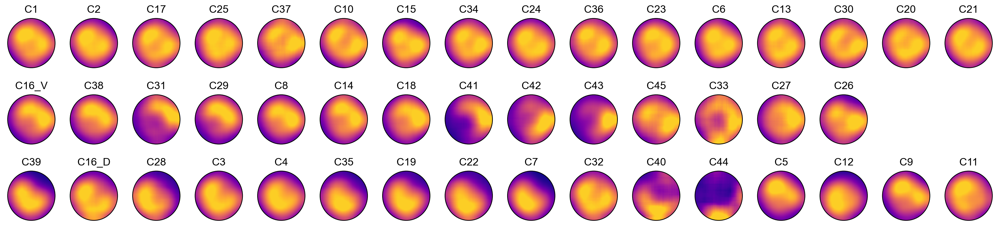

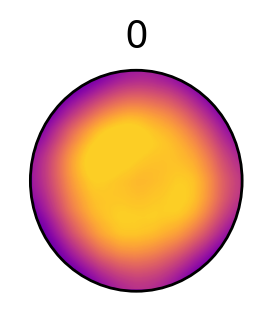

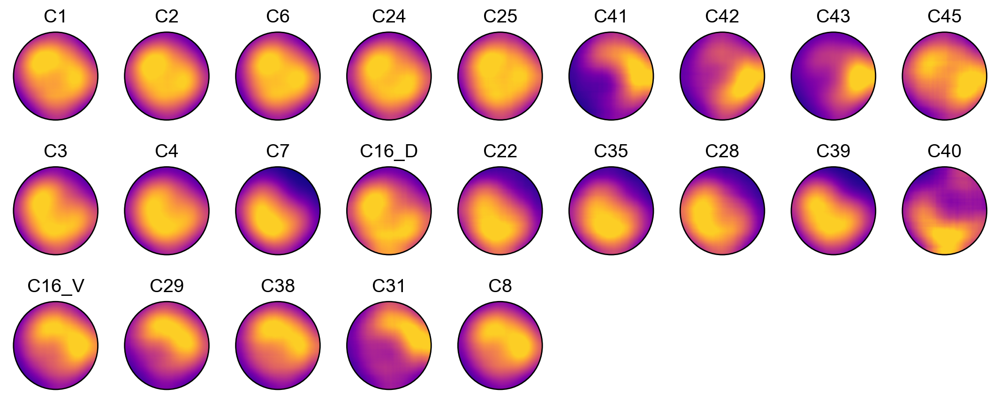

In [239]:
in_hist,out_hist,smoothed = plot_type_groups(
    adata[adata.obs['run'].isin([3,4,5,7,16,17])],
    grouped_types=grouped_types,
    type_col=f'final_assignment{suffix}',
    x_col='final_x',
    y_col='final_y',
    bins=101,
    kernel=(41,41),
    cmap=new_cmap,
    sigmaX=15,
    masked=masked,
    ellipsoid=ellipsoid,
    output_f=os.path.join(figure_dir,f"all_types_v2{suffix}.pdf")
)

in_hist,out_hist,smoothed = plot_type_groups(
    adata[adata.obs['run'].isin([3,4,5,7,16,17])],
    grouped_types={'SAC':['0']},
    type_col='joint_leiden',
    x_col='final_x',
    y_col='final_y',
    bins=101,
    kernel=(41,41),
    cmap=new_cmap,
    sigmaX=15,
    masked=masked,
    ellipsoid=ellipsoid,
    output_f=os.path.join(figure_dir,f"SAC_v2.pdf")
)

in_hist,out_hist,smoothed = plot_type_groups(
    adata[adata.obs['run'].isin([3,4,5,7,16,17])],
    grouped_types={'R1':['C1','C2','C6','C24','C25','C41','C42','C43','C45'],'R2':['C3','C4','C7','C16_D','C22','C35','C28','C39','C40'],'R3':['C16_V','C29','C38','C31','C8']},
    type_col=f'final_assignment{suffix}',
    bins=101,
    x_col='final_x',
    y_col='final_y',
    kernel=(41,41),
    cmap=new_cmap,
    sigmaX=15,
    masked=masked,
    ellipsoid=ellipsoid,
    output_f=os.path.join(figure_dir,f"select_types_v2{suffix}.pdf")
)

In [240]:
ipRGC_groups = {'M1,M2,M4,M5,M6':['C33+C40','C31','C43','C22','C7']}
adata.obs['ipRGC_assignment'] = 'Not_ipRGC'
adata.obs['ipRGC_assignment'] = adata.obs[f'final_assignment{suffix}'].map({'C33':'C33+C40','C40':'C33+C40','C31':'C31','C43':'C43','C22':'C22','C7':'C7'})

/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/981257966.py:90: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


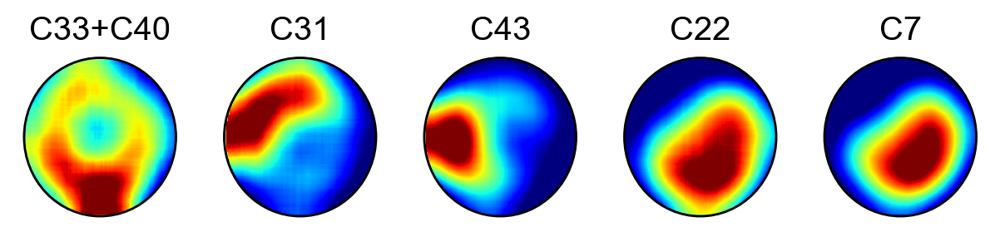

In [241]:
cmap2 = plt.get_cmap('jet')
new_cmap_2 = truncate_colormap(cmap2,-0.3,1,n=5000)
in_hist,out_hist,smoothed = plot_type_groups(
    adata[adata.obs['run'].isin([3,4,5,7,16,17])],
    grouped_types=ipRGC_groups,
    type_col='ipRGC_assignment',
    x_col='final_x',
    y_col='final_y',
    bins=101,
    kernel=(41,41),
    cmap=new_cmap_2,
    sigmaX=15,
    masked=masked,
    ellipsoid=ellipsoid,
    invert_x=True,
    output_f=os.path.join(figure_dir,f"ip_RGC{suffix}.pdf")
)


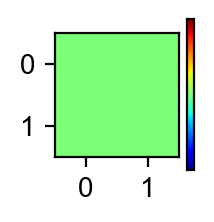

In [242]:
fig,ax=plt.subplots(figsize=(1,1))
im = ax.imshow(np.zeros((2,2)),cmap=cmap2)
cbar = fig.colorbar(im,ax=ax)
cbar.set_ticks([])
fig.savefig(os.path.join(figure_dir,"jet_cmap.pdf"))

## Figures S6A, S6B

In [243]:
def add_spline(run,spline_key,ax,color='black',linewidth=1):
    spline_r =spline['rn{}{}'.format(run,spline_key)]
    for boundary in spline_r:
        spline_r = np.array(boundary)
        ax.plot(spline_r[:,0],spline_r[:,1],color=color,linewidth=linewidth)

In [244]:
import json
#adata = sc.read_h5ad(os.path.join("data","control_130_6","merged_control_cluster_final.h5ad"))
with open(os.path.join(BASE_DIR,"data","MER_splines",'spline_coordinates.json')) as f:
    spline = json.load(f)
#create_C16_subclass(adata,old_col='final_assignment',new_col='final_assignment')


class_col=f'class{suffix}'

/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/4035448591.py:30: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


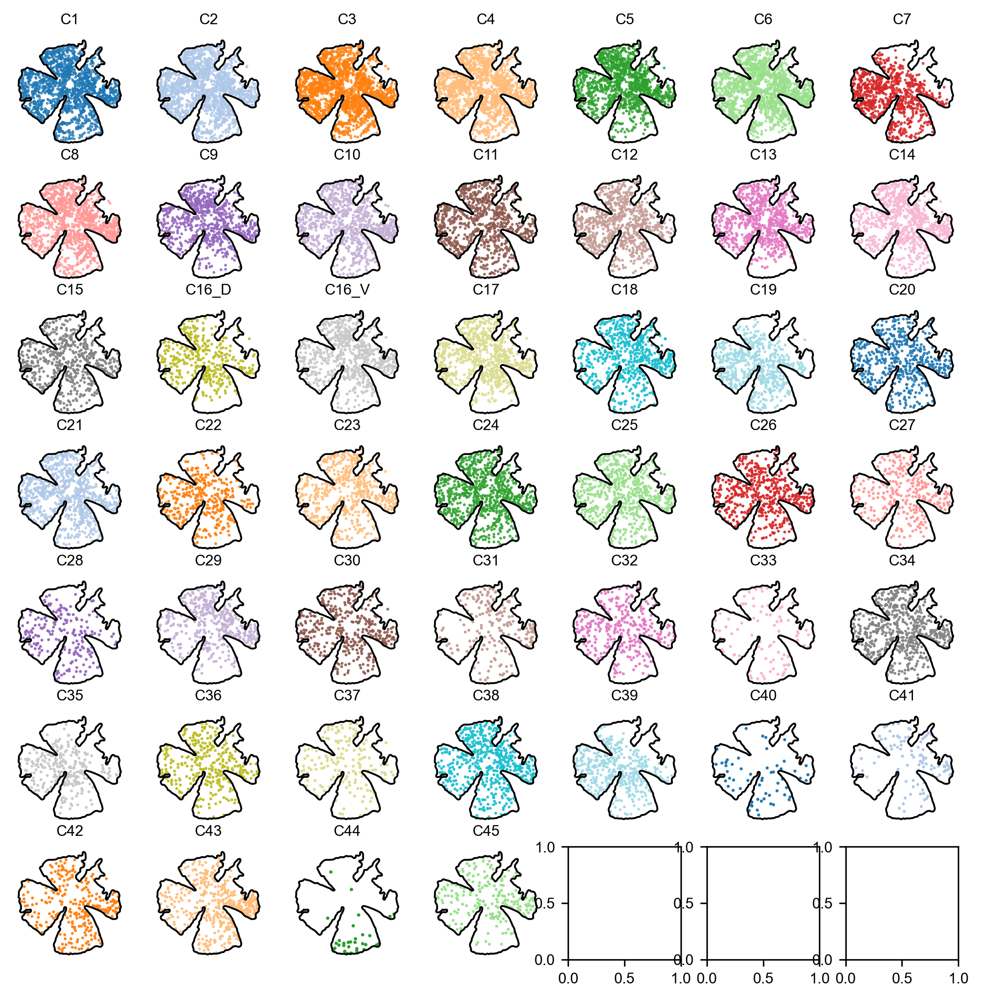

In [245]:

def plot_replicate(df,run, spline=None,spline_key=None,unique_types=None, run_col='run',type_col='final_assignment',ncols=7,output_f=''):
    if unique_types is None:
        unique_types = df[type_col].unique()
    
    n = len(unique_types)
    t_counts = df[type_col].value_counts(normalize=True)
    nrows = np.ceil(n/ncols).astype(int)
    k = 0
    fig,ax = plt.subplots(nrows,ncols,figsize=(1.3*nrows,1.3*ncols),subplot_kw=dict(box_aspect=1))
    while k < n:
        i = k//ncols
        j = k % ncols
        ctype = unique_types[k]

        df_c = df[(df[run_col]==run) & (df[type_col]==ctype)]
        s = 0.15*((np.max(t_counts) - np.min(t_counts))/(t_counts[ctype] - np.min(t_counts)))**(1/3)

        ax[i][j].scatter(df_c['final_x'],df_c['final_y'],color=type_palette[ctype],s=s,rasterized=True)

        #df_nc = df[(df[run_col]==run) & (df[type_col]!=ctype)]

        ax[i][j].set_title(ctype,fontsize=8)
        ax[i][j].set_axis_off()
        add_spline(run,spline_key,ax[i][j])
        
  

        k+=1

    fig.show()
    fig.savefig(output_f)

types_to_plot  = [f'C{i}' for i in range(1,16)] +['C16_D','C16_V'] + [f'C{i}' for i in range(17, 46)]
with plt.rc_context({'figure.dpi':300,'font.sans-serif':'Arial','font.size':8}):
    plot_replicate(adata.obs[adata.obs[class_col]=='RGC'],3,spline=spline,spline_key=spline_key,unique_types =types_to_plot, run_col='run',type_col=f'final_assignment{suffix}',output_f=os.path.join(figure_dir,f"Supp_RGC_types_scatter{suffix}.pdf"))


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/3643268504.py:28: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


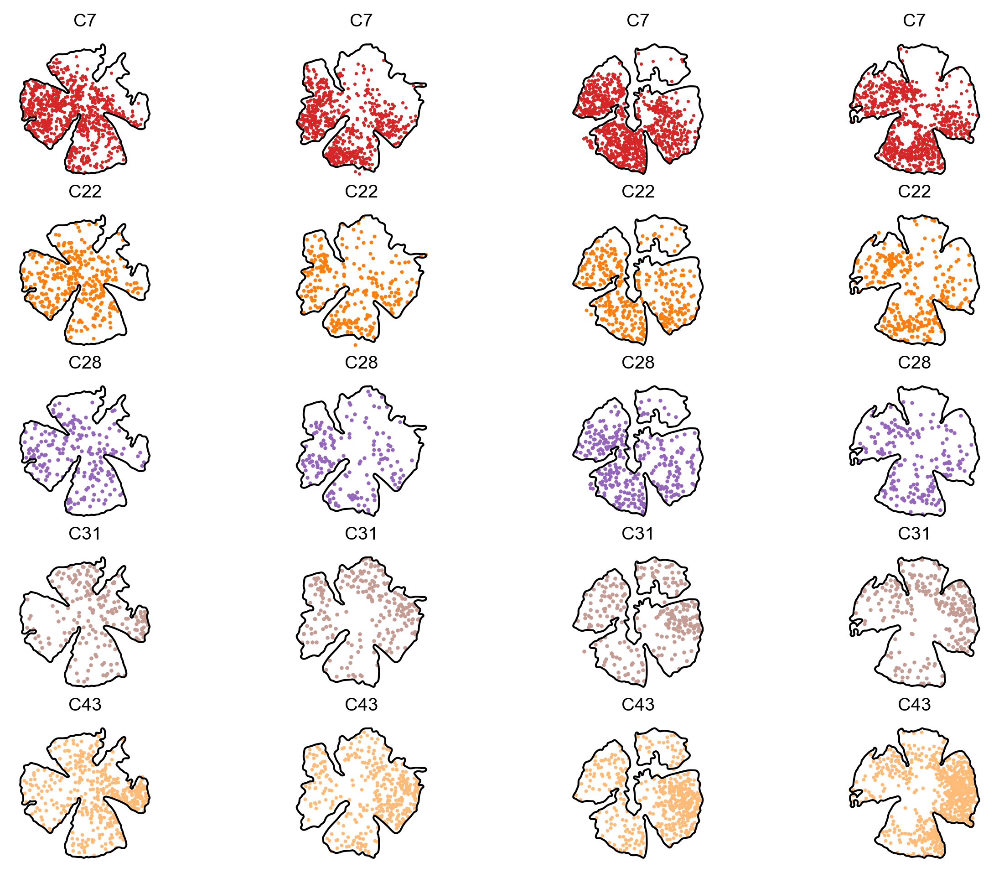

In [246]:
def plot_type_across_replicates(df,ctypes,runs,run_col='run',type_col='final_assignment',spline=None,spline_keys=None,output_f=""):
    #n = len(unique_types)
    nrows,ncols = len(ctypes),len(runs)
    
    n= nrows*ncols
    t_counts = df[type_col].value_counts(normalize=True)
    nrows = np.ceil(n/ncols).astype(int)
    fig,ax = plt.subplots(nrows,ncols,figsize=(2*nrows,2*ncols),subplot_kw=dict(box_aspect=1))
    for i in range(nrows):
        for j in range(ncols):
            ctype = ctypes[i]
            run = runs[j]

            df_c = df[(df[run_col]==run) & (df[type_col]==ctype)]
            s = 0.1*((np.max(t_counts) - np.min(t_counts))/(t_counts[ctype] - np.min(t_counts)))**(1/2)

            ax[i][j].scatter(df_c['final_x'],df_c['final_y'],color=type_palette[ctype],s=s,rasterized=True)

            #df_nc = df[(df[run_col]==run) & (df[type_col]!=ctype)]

            ax[i][j].set_title(ctype)
            ax[i][j].set_axis_off()
            add_spline(run,spline_keys[j],ax[i][j])
        
  


    fig.show()
    fig.savefig(output_f)



with plt.rc_context({'figure.dpi':300,'font.sans-serif':'Arial','font.size':8}):
    plot_type_across_replicates(adata.obs,ctypes=['C7','C22','C28','C31','C43'],runs=[3,4,5,7],spline=spline,spline_keys=["","","_v1",""],output_f=os.path.join(figure_dir,f"Example_retina_replicates{suffix}.pdf"))

## Figures S6C,S6D

Images from raw data on zenodo

## Figures S6E and S6F

This requires you to download the Opn4/Nmb data from zenodo first

In [247]:
subdata_dir = os.path.join(BASE_DIR,"data","sivyer")
spline_df = pd.read_csv(os.path.join(BASE_DIR,"data","sivyer","spline_outlines_v2.csv"))

ONH_locations = {
    's1':(4150,5300),
    's2':(4858,4540),
    's3': (5186,5204),
    's4': (4836,4664),
    's5': (4367,4396),
    's6':(4571,4680)
}
replicas = [1,2,3,4,5,6]
nmb_df = []
for i in replicas:
    df = pd.read_csv(os.path.join(subdata_dir,"replica{}.csv".format(i)))
    df['run'] = f"s{i}"
    cx,cy =  ONH_locations[f"s{i}"]
    ##df['D/T'] = df['Y'].apply(lambda y: 'D' if y < cy else 'V')
    df['dorsal'] = df['Y'] < cy
    #df['T/N'] = df['X'].apply(lambda x: 'T' if x < cx else 'N')
    df['nasal'] = df['X'] >= cx

    #df['quadrant'] = df['D/T'].astype(str) +df['T/N'].astype(str)
    nmb_df.append(df)

nmb_df = pd.concat(nmb_df,ignore_index=True)
nmb_df[f'final_assignment{suffix}'] = 'Nmb+/Opn4+'


In [248]:
nmb_df[['aligned_center_x','aligned_center_y']] = pd.NA
for r in nmb_df['run'].unique():
    pts = nmb_df[nmb_df['run']==r]
    cx,cy = ONH_locations[r]
    pts[['aligned_center_x','aligned_center_y']] = pts[['X','Y']] - np.array([cx,cy])
    nmb_df.update(pts)

/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/2157331486.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pts[['aligned_center_x','aligned_center_y']] = pts[['X','Y']] - np.array([cx,cy])
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/2157331486.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pts[['aligned_center_x','aligned_center_y']] = pts[['X','Y']] - np.array([cx,cy])
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/2157331486.py:5: SettingWithCo

In [249]:
def convert_to_score(df,ax_cols,rep_col,type_col,normalized=True):
    score_lst = []
    for axis in ax_cols:
        if normalized:
            props = df.groupby([rep_col,axis])[type_col].value_counts() / df.groupby([rep_col,axis]).size()
        else:
            props = df.groupby([rep_col,axis])[type_col].value_counts() / df.groupby([rep_col]).size()
        print( df.groupby([rep_col,axis])[type_col].value_counts() )
        print(df.groupby([rep_col,axis]).size())
        key = f'props_{axis}'

        props = props.reset_index(name=key)
        scores =  pd.DataFrame(props[props[axis]].set_index([rep_col,type_col])[key]/ props[~props[axis]].set_index([rep_col,type_col])[key])
        score_lst.append(scores)
    
    fscores = pd.concat(score_lst,axis=1).reset_index()
    fscores['props_temporal']= 1/fscores['props_nasal']
    fscores['D/V Score'] = np.emath.log2(fscores['props_dorsal'])
    fscores['T/N Score'] = np.emath.log2(fscores['props_temporal'])
    return fscores

sscores = convert_to_score(nmb_df,ax_cols=['dorsal','nasal'],rep_col='run',type_col=f'final_assignment{suffix}',normalized=False)


run  dorsal  final_assignment
s1   False   Nmb+/Opn4+          135
     True    Nmb+/Opn4+           65
s2   False   Nmb+/Opn4+          143
     True    Nmb+/Opn4+           82
s3   False   Nmb+/Opn4+           93
     True    Nmb+/Opn4+           91
s4   False   Nmb+/Opn4+          127
     True    Nmb+/Opn4+           69
s5   False   Nmb+/Opn4+          120
     True    Nmb+/Opn4+           83
s6   False   Nmb+/Opn4+          126
     True    Nmb+/Opn4+           66
Name: final_assignment, dtype: int64
run  dorsal
s1   False     135
     True       65
s2   False     143
     True       82
s3   False      93
     True       91
s4   False     127
     True       69
s5   False     120
     True       83
s6   False     126
     True       66
dtype: int64
run  nasal  final_assignment
s1   False  Nmb+/Opn4+           91
     True   Nmb+/Opn4+          109
s2   False  Nmb+/Opn4+          116
     True   Nmb+/Opn4+          109
s3   False  Nmb+/Opn4+           83
     True   Nmb+/Opn4+     

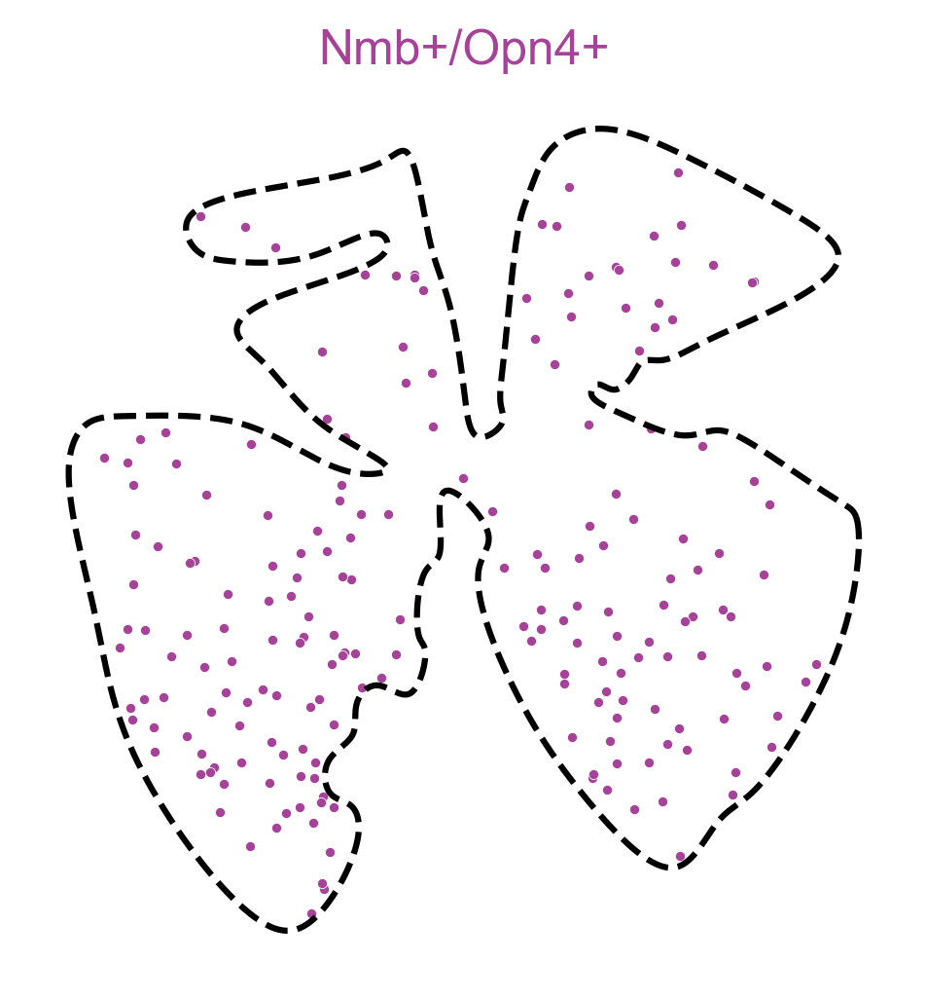

In [250]:
run = 1
with plt.rc_context({'figure.dpi':300,'font.sans-serif':'Arial'}):
    sns.scatterplot(nmb_df[nmb_df['run']==f's{run}'],x='X',y='Y',s=6,color='#A64298')
    splines1 = spline_df[spline_df['replicate']==run]
    plt.plot(splines1['x-outline'],splines1['y-outline'],color='black',linestyle='--')
    plt.gca().invert_yaxis()
    plt.gca().invert_xaxis()
    plt.title('Nmb+/Opn4+',color='#A64298')

    plt.gca().set_aspect('equal')
    plt.gca().set_axis_off()
    #plt.savefig(os.path.join(figure_dir,"Nmb_outline.pdf"))


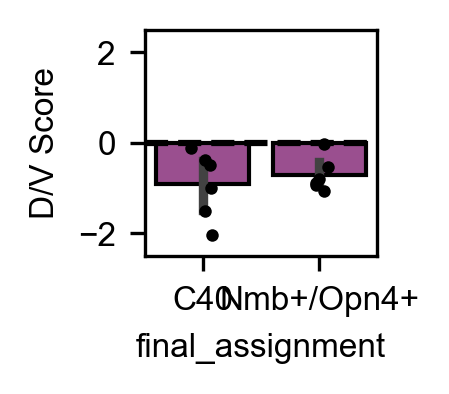

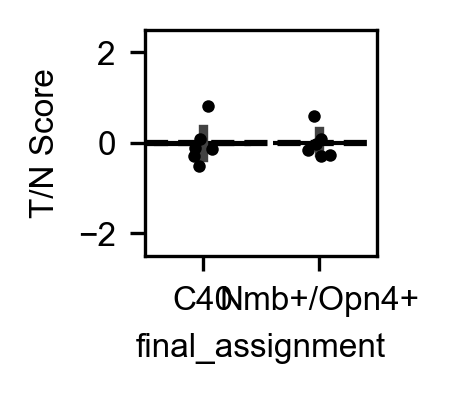

In [251]:
pd.concat([fscores,sscores],ignore_index=False)
jscores = pd.concat([fscores,sscores])
fcol= f"final_assignment{suffix}"
jscores[jscores[fcol]== 'Nmb+/Opn4+']
with plt.rc_context({'figure.dpi':300,'font.sans-serif':'Arial','figure.figsize':(1,1),'font.size':8}):
    sns.stripplot(jscores[jscores[fcol].isin(['Nmb+/Opn4+','C40'])],x=fcol,y='D/V Score',color='black',s=3)
    sns.barplot(jscores[jscores[fcol].isin(['Nmb+/Opn4+','C40'])],x=fcol,y='D/V Score',edgecolor='black',color='#A64298')
    plt.ylim(-2.5,2.5)
    plt.axhline(0,color='black',linestyle='--')
    plt.savefig(os.path.join(figure_dir,f'DV_NMB_v2{suffix}.pdf'))
    plt.show()

    sns.stripplot(jscores[jscores[fcol].isin(['Nmb+/Opn4+','C40'])],x=fcol,y='T/N Score',color='black',s=3)
    sns.barplot(jscores[jscores[fcol].isin(['Nmb+/Opn4+','C40'])],x=fcol,y='T/N Score',color='#A64298',edgecolor='black')
    plt.axhline(0,color='black',linestyle='--')
    plt.ylim(-2.5,2.5)
    plt.savefig(os.path.join(figure_dir,f'TN_NMB_v2{suffix}.pdf'))
    plt.show()


## Figures S7A-S7F

See mosaic_analysis.ipynb

# Figure 5C

In [252]:

def update_coords(adata,col_x='aligned_center_y',col_y='aligned_center_y'):
    alignment = {
        3:{'center':(2900,9476),'reflect':False,'rotate':135},
        4:{'center':(4250,11200),'reflect':True,'rotate':124},
        5:{'center':(2350,9850),'reflect':True,'rotate':-69},
        7:{'center':(7550,9250),'reflect':True,'rotate':-30},
        16:{'center':(11200,1900),'reflect':True,'rotate':-60},
        17:{'center':(12910,3750),'reflect':False,'rotate':130},
    }

    #Note: updates aligned_center_x in place! (run this more than once and you'll get a bug...)
    col_x= 'aligned_center_x'
    col_y= 'aligned_center_y'


    def rotate_clockwise(x,y,degrees):
        theta = np.deg2rad(degrees)
        rot_mat=np.array([[np.cos(theta),np.sin(theta)],[-np.sin(theta),np.cos(theta)]])
        rotated = rot_mat @ np.array([x,y])
        return np.array([rotated[0],rotated[1]]).T

    adata.obs['dorsal']=True
    adata.obs['nasal']=True
    adata.obs['D/V']='Dorsal'
    adata.obs['N/T']='Nasal'
    for run in alignment:
        ar= alignment[run]
        adata_r = adata[adata.obs['run']==run]

        #recenter
        adata_r.obs[col_x]=adata_r.obs[col_x]-ar['center'][0]
        adata_r.obs[col_y]=adata_r.obs[col_y]-ar['center'][1]
        #reflect
        if ar['reflect']:
            adata_r.obs[col_x]=-adata_r.obs[col_x]
        #rotate
        output=rotate_clockwise(adata_r.obs[col_x].values,adata_r.obs[col_y].values,ar['rotate'])
        adata_r.obs[[col_x,col_y]]=rotate_clockwise(adata_r.obs[col_x].values,adata_r.obs[col_y].values,ar['rotate'])
        adata_r.obs['dorsal'] = adata_r.obs[col_y]>0
        adata_r.obs['D/V']=adata_r.obs['dorsal'].apply(lambda x: 'Dorsal' if x else 'Ventral')
        adata_r.obs['nasal']=adata_r.obs[col_x]<0    
        adata_r.obs['N/T']=adata_r.obs['nasal'].apply(lambda x: 'Nasal' if x else 'Temporal')
        adata.obs.update(adata_r.obs)
        print(adata.obs.columns)
    




adata = sc.read_h5ad(os.path.join(BASE_DIR,"data","control_130_6",JOINT_ADATA))
update_coords(adata)
figure_dir = os.path.join(BASE_DIR,"figures","Figure_5")
suffix=""


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/1512187791.py:31: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_r.obs[col_x]=adata_r.obs[col_x]-ar['center'][0]


Index(['Size', 'center_x', 'center_y', 'max_areas', 'aligned_center_x',
       'aligned_center_y', 'counts', 'class', 'final_assignment', 'run',
       'joint_leiden', 'retina_class', 'new_x', 'new_y', 'in_boundary',
       'dorsal', 'nasal', 'D/V', 'N/T', 'final_x', 'final_y', 'Anti-Rat',
       'CD31+', 'class_v2', 'final_assignment_v2', 'class_v3',
       'final_assignment_v3'],
      dtype='object')


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/1512187791.py:31: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_r.obs[col_x]=adata_r.obs[col_x]-ar['center'][0]


Index(['Size', 'center_x', 'center_y', 'max_areas', 'aligned_center_x',
       'aligned_center_y', 'counts', 'class', 'final_assignment', 'run',
       'joint_leiden', 'retina_class', 'new_x', 'new_y', 'in_boundary',
       'dorsal', 'nasal', 'D/V', 'N/T', 'final_x', 'final_y', 'Anti-Rat',
       'CD31+', 'class_v2', 'final_assignment_v2', 'class_v3',
       'final_assignment_v3'],
      dtype='object')


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/1512187791.py:31: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_r.obs[col_x]=adata_r.obs[col_x]-ar['center'][0]


Index(['Size', 'center_x', 'center_y', 'max_areas', 'aligned_center_x',
       'aligned_center_y', 'counts', 'class', 'final_assignment', 'run',
       'joint_leiden', 'retina_class', 'new_x', 'new_y', 'in_boundary',
       'dorsal', 'nasal', 'D/V', 'N/T', 'final_x', 'final_y', 'Anti-Rat',
       'CD31+', 'class_v2', 'final_assignment_v2', 'class_v3',
       'final_assignment_v3'],
      dtype='object')


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/1512187791.py:31: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_r.obs[col_x]=adata_r.obs[col_x]-ar['center'][0]


Index(['Size', 'center_x', 'center_y', 'max_areas', 'aligned_center_x',
       'aligned_center_y', 'counts', 'class', 'final_assignment', 'run',
       'joint_leiden', 'retina_class', 'new_x', 'new_y', 'in_boundary',
       'dorsal', 'nasal', 'D/V', 'N/T', 'final_x', 'final_y', 'Anti-Rat',
       'CD31+', 'class_v2', 'final_assignment_v2', 'class_v3',
       'final_assignment_v3'],
      dtype='object')


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/1512187791.py:31: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_r.obs[col_x]=adata_r.obs[col_x]-ar['center'][0]


Index(['Size', 'center_x', 'center_y', 'max_areas', 'aligned_center_x',
       'aligned_center_y', 'counts', 'class', 'final_assignment', 'run',
       'joint_leiden', 'retina_class', 'new_x', 'new_y', 'in_boundary',
       'dorsal', 'nasal', 'D/V', 'N/T', 'final_x', 'final_y', 'Anti-Rat',
       'CD31+', 'class_v2', 'final_assignment_v2', 'class_v3',
       'final_assignment_v3'],
      dtype='object')


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/1512187791.py:31: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_r.obs[col_x]=adata_r.obs[col_x]-ar['center'][0]


Index(['Size', 'center_x', 'center_y', 'max_areas', 'aligned_center_x',
       'aligned_center_y', 'counts', 'class', 'final_assignment', 'run',
       'joint_leiden', 'retina_class', 'new_x', 'new_y', 'in_boundary',
       'dorsal', 'nasal', 'D/V', 'N/T', 'final_x', 'final_y', 'Anti-Rat',
       'CD31+', 'class_v2', 'final_assignment_v2', 'class_v3',
       'final_assignment_v3'],
      dtype='object')


In [253]:
import itertools

def run_RGC_permute(adata,cluster_key,fixed_types,observed_key,n_iters,n_neighs,prefix, radius=None,x_col='center_x',y_col='center_y',do_normal=False,output_dir=os.path.join("tmp_stats")):
    unique_types = adata.obs[cluster_key].cat.categories
    clust_map= dict(zip(unique_types,range(len(unique_types))))
    ct_indices = adata.obs[cluster_key].map(clust_map).to_numpy()
    n_types=len(unique_types)



    adata.obsm[observed_key]=adata.obs[[x_col,y_col]].values
    if n_neighs is None:
        sq.gr.spatial_neighbors(adata,spatial_key=observed_key,coord_type='generic',radius=radius)
    else:
        sq.gr.spatial_neighbors(adata,spatial_key=observed_key,n_neighs=n_neighs,coord_type='generic')


    mu_arr = calculate_neighborhood_counts(adata,n_types,ct_indices=ct_indices,spatial_key=observed_key)

    ct_indices_randomized = ct_indices.copy()
    fixed_ct_indices = [clust_map[fixed_type] for fixed_type in fixed_types]
    fixed_idx = np.nonzero(np.isin(ct_indices,fixed_ct_indices))[0]
    flexible_idx = list( set(range(len(ct_indices))) - set(fixed_idx.tolist()))
    null_mu_arr=np.zeros((n_iters,*mu_arr.shape))
    for i in range(n_iters):
        randomized_idx = np.random.permutation(flexible_idx)
        randomized_vals = ct_indices[randomized_idx]
        ct_indices_randomized[flexible_idx] = randomized_vals

        null_mu_arr[i,:,:] = calculate_neighborhood_counts(adata,n_types,ct_indices=ct_indices_randomized,spatial_key=observed_key)

    
    np.save(os.path.join(output_dir,f"{prefix}_types"),unique_types)
    np.save(os.path.join(output_dir,f"{prefix}_observed"),mu_arr)
    np.save(os.path.join(output_dir,f"{prefix}_null"),null_mu_arr)

    return mu_arr, null_mu_arr,unique_types


def calculate_neighborhood_counts(adata,n_types,ct_indices,spatial_key='spatial'):
    #unique_types = adata.obs[type_col].cat.categories
    #clust_map= dict(zip(unique_types,range(len(unique_types))))
    #ct_indices = adata.obs[type_col].map(clust_map).values
    mu_arr = np.zeros((n_types,n_types))
    x_arr,y_arr = adata.obsp[f'{spatial_key}_connectivities'].nonzero()
    x_types,y_types = ct_indices[x_arr],ct_indices[y_arr]
    np.add.at(mu_arr,(x_types,y_types),1)
    return mu_arr
    

In [254]:
from tqdm import tqdm

def _filt(adata,cluster_key,x_types,y_types,x_col='aligned_center_x',y_col='aligned_center_y',spatial_key='spatial',filter_radius=20):
    unique_types = adata.obs[cluster_key].cat.categories
    clust_map= dict(zip(unique_types,range(len(unique_types))))
    ct_indices = adata.obs[cluster_key].map(clust_map).to_numpy()
    adata.obsm[spatial_key] = adata.obs[[x_col,y_col]].values
    key_added=f'{spatial_key}_filter'

    sq.gr.spatial_neighbors(adata,spatial_key=spatial_key,coord_type='generic',key_added=key_added,radius=filter_radius)

    x_arr,y_arr = adata.obsp[f'{key_added}_connectivities'].nonzero()
    x_type_ids,y_type_ids=ct_indices[x_arr],ct_indices[y_arr]
    y_to_keep_indices = [clust_map[yt] for yt in y_types]
    x_to_keep_indices = [clust_map[xt] for xt in x_types]

    filt_adjacent = (np.isin(y_type_ids,y_to_keep_indices)) & (np.isin(x_type_ids,x_to_keep_indices))
    keep_recipients = np.isin(x_type_ids,y_to_keep_indices)
    indices_to_keep = np.unique(x_arr[filt_adjacent | keep_recipients])
    return adata[adata.obs.iloc[indices_to_keep].index]

def run_select_permute_test(adata,run,run_key,cluster_key,n_neighs,values_to_exclude,fixed_types, output_dir, n_iters=1000,radius=None,prefix=None,filter=False,filter_radius=20,y_types=None,x_types=None):
    assert all([ (v in adata.obs[cluster_key].cat.categories) for v in values_to_exclude])
    assert all( [(f in adata.obs[cluster_key].cat.categories) for f in fixed_types] )
    #adata_e=adata[(adata.obs[run_key]==run) & (~adata.obs[cluster_key].isin(values_to_exclude))]
    adata_e = adata[ (~adata.obs[cluster_key].isin(values_to_exclude))]
    categories = adata_e.obs[cluster_key].cat.categories
    adata_e = adata_e[adata_e.obs[run_key]==run]
    adata_e.obs[cluster_key] = adata_e.obs[cluster_key].cat.set_categories(categories)
    print(len(adata_e.obs[cluster_key].cat.categories))
    
    if filter:
        assert (x_types is not None) and (y_types is not None)
        assert filter_radius > radius
        adata_e = _filt(adata=adata_e,cluster_key=cluster_key,x_types=x_types,y_types=y_types, filter_radius=filter_radius)
    

    if prefix is None:
        prefix= f"n_neighs{n_neighs}_run{run}"

    mu_arr,null_mu_arr,unique_types = run_RGC_permute(adata=adata_e,cluster_key=cluster_key,fixed_types=fixed_types,prefix=prefix,x_col='aligned_center_x',y_col='aligned_center_y',observed_key='spatial',n_iters=n_iters,n_neighs=n_neighs,output_dir=output_dir)
    z_scores = (mu_arr - np.mean(null_mu_arr,axis=0))/(np.std(null_mu_arr,axis=0))
    print(z_scores.shape)
    #fig,ax=plt.subplots(figsize=(20,20))
    #ax.set_xticks(np.arange(len(unique_types)), labels=unique_types)
    #ax.set_yticks(np.arange(len(unique_types)), labels=unique_types)
    #pos= ax.imshow(z_scores,vmin=0,vmax=4)
    #ax.set_xticks(np.arange(len(unique_types)), labels=unique_types)
    #ax.set_yticks(np.arange(len(unique_types)), labels=unique_types)
    #fig.colorbar(pos,ax=ax)

    output_f = os.path.join(output_dir,f"zscores_{prefix}")
    print("Saving z_scores to: ", output_f )
    np.save(output_f, z_scores)
    np.save(os.path.join(output_dir,f"mu_arr_{prefix}"),mu_arr)
    np.save(os.path.join(output_dir,f"null_mu_arr_{prefix}"),null_mu_arr)

    return mu_arr,null_mu_arr,unique_types

import spatial_rgc.utils.rconstants as constants
importlib.reload(constants)
import spatial_rgc.utils.plot_utils as pu
importlib.reload(pu)


def vis_stats_df(df_agg,n_pairs=60,top=True,score='zscore',output_f=""):
    pairs_ordered = df_agg.groupby(by='Pair')[score].median().sort_values(ascending=False)

    if top:
        pairs_to_keep = pairs_ordered.head(n_pairs).index
        output_f = f'{output_f}_top'
    else:
        print(top)
        pairs_to_keep = pairs_ordered.tail(n_pairs).index
        output_f = f'{output_f}_bot'

    df_s = df_agg[df_agg['Pair'].isin(pairs_to_keep)]
    df_s.index = range(len(df_s))
    print(df_s)

    pu.stripplot_sorted(df_s,by='Pair',column=score,xlabel=score,ylabel='Pair',figure_dir="",fname=output_f,showfliers=True)

    if top:
        plt.axvline(x=0,linestyle='--',color='grey')
    else:
        plt.axvline(x=0,linestyle='--',color='grey')
        plt.axvline(x=-2,linestyle='--',color='red')
        plt.axvline(x=-3,linestyle='--',color='red')

    
    plt.savefig(output_f,bbox_inches='tight')
    plt.show()







In [193]:
adata.obs['split_run']=pd.Categorical(adata.obs['D/V'].astype(str) + adata.obs['N/T'].astype(str) + adata.obs['run'].astype(int).astype(str))

mu_arr_lst = []
null_mu_arr_lst = []

n_neighs=15
run_key='split_run'
radius=25
runs=adata.obs[run_key].unique()
cluster_key=f'final_assignment{suffix}'
adata.obs[cluster_key] = pd.Categorical(adata.obs[cluster_key])
trial_name=f"FINAL_sep_regions{suffix}"
prefixes=[]


for run in tqdm(runs):
    prefix=f"{trial_name}_n_neighs{n_neighs}_run{run}_radius{radius}"
    prefixes.append(prefix)
    mu_arr,null_mu_arr,unique_types = run_select_permute_test(
        adata,
        run=run,
        run_key=run_key,
        cluster_key=cluster_key,
        n_neighs=n_neighs,
        radius=radius,
        values_to_exclude=['Low quality neuronal', 'Amacrine','Unassigned'], 
        fixed_types=['Non-neuronal'],
        output_dir=os.path.join(BASE_DIR,"data","permutations"),
        prefix=prefix,
        filter=False,
    )

    #mu_arr_lst.append(mu_arr)
    #null_mu_arr_lst.append(null_mu_arr)

    
#plt.show()


  0%|          | 0/24 [00:00<?, ?it/s]/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:27: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_e.obs[cluster_key] = adata_e.obs[cluster_key].cat.set_categories(categories)


46


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:40: RuntimeWarning: invalid value encountered in true_divide
  z_scores = (mu_arr - np.mean(null_mu_arr,axis=0))/(np.std(null_mu_arr,axis=0))
  4%|▍         | 1/24 [00:09<03:47,  9.91s/it]/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:27: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_e.obs[cluster_key] = adata_e.obs[cluster_key].cat.set_categories(categories)


(46, 46)
Saving z_scores to:  ../../spatial_rgc/data/permutations/zscores_FINAL_sep_regions_v3_n_neighs15_runDorsalNasal3_radius25
46


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:40: RuntimeWarning: invalid value encountered in true_divide
  z_scores = (mu_arr - np.mean(null_mu_arr,axis=0))/(np.std(null_mu_arr,axis=0))
  8%|▊         | 2/24 [00:24<04:33, 12.42s/it]/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:27: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_e.obs[cluster_key] = adata_e.obs[cluster_key].cat.set_categories(categories)


(46, 46)
Saving z_scores to:  ../../spatial_rgc/data/permutations/zscores_FINAL_sep_regions_v3_n_neighs15_runVentralNasal3_radius25
46


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:40: RuntimeWarning: invalid value encountered in true_divide
  z_scores = (mu_arr - np.mean(null_mu_arr,axis=0))/(np.std(null_mu_arr,axis=0))
 12%|█▎        | 3/24 [00:35<04:11, 11.96s/it]/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:27: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_e.obs[cluster_key] = adata_e.obs[cluster_key].cat.set_categories(categories)


(46, 46)
Saving z_scores to:  ../../spatial_rgc/data/permutations/zscores_FINAL_sep_regions_v3_n_neighs15_runDorsalTemporal3_radius25
46


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:40: RuntimeWarning: invalid value encountered in true_divide
  z_scores = (mu_arr - np.mean(null_mu_arr,axis=0))/(np.std(null_mu_arr,axis=0))
 17%|█▋        | 4/24 [00:46<03:51, 11.58s/it]/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:27: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_e.obs[cluster_key] = adata_e.obs[cluster_key].cat.set_categories(categories)


(46, 46)
Saving z_scores to:  ../../spatial_rgc/data/permutations/zscores_FINAL_sep_regions_v3_n_neighs15_runVentralTemporal3_radius25
46


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:40: RuntimeWarning: invalid value encountered in true_divide
  z_scores = (mu_arr - np.mean(null_mu_arr,axis=0))/(np.std(null_mu_arr,axis=0))
 21%|██        | 5/24 [00:58<03:40, 11.60s/it]/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:27: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_e.obs[cluster_key] = adata_e.obs[cluster_key].cat.set_categories(categories)


(46, 46)
Saving z_scores to:  ../../spatial_rgc/data/permutations/zscores_FINAL_sep_regions_v3_n_neighs15_runDorsalNasal4_radius25
46


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:40: RuntimeWarning: invalid value encountered in true_divide
  z_scores = (mu_arr - np.mean(null_mu_arr,axis=0))/(np.std(null_mu_arr,axis=0))
 25%|██▌       | 6/24 [01:08<03:19, 11.08s/it]/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:27: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_e.obs[cluster_key] = adata_e.obs[cluster_key].cat.set_categories(categories)


(46, 46)
Saving z_scores to:  ../../spatial_rgc/data/permutations/zscores_FINAL_sep_regions_v3_n_neighs15_runVentralNasal4_radius25
46


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:40: RuntimeWarning: invalid value encountered in true_divide
  z_scores = (mu_arr - np.mean(null_mu_arr,axis=0))/(np.std(null_mu_arr,axis=0))
 29%|██▉       | 7/24 [01:19<03:11, 11.28s/it]/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:27: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_e.obs[cluster_key] = adata_e.obs[cluster_key].cat.set_categories(categories)


(46, 46)
Saving z_scores to:  ../../spatial_rgc/data/permutations/zscores_FINAL_sep_regions_v3_n_neighs15_runDorsalTemporal4_radius25
46


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:40: RuntimeWarning: invalid value encountered in true_divide
  z_scores = (mu_arr - np.mean(null_mu_arr,axis=0))/(np.std(null_mu_arr,axis=0))
 33%|███▎      | 8/24 [01:31<02:59, 11.23s/it]/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:27: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_e.obs[cluster_key] = adata_e.obs[cluster_key].cat.set_categories(categories)


(46, 46)
Saving z_scores to:  ../../spatial_rgc/data/permutations/zscores_FINAL_sep_regions_v3_n_neighs15_runVentralTemporal4_radius25
46


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:40: RuntimeWarning: invalid value encountered in true_divide
  z_scores = (mu_arr - np.mean(null_mu_arr,axis=0))/(np.std(null_mu_arr,axis=0))
 38%|███▊      | 9/24 [01:46<03:08, 12.53s/it]/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:27: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_e.obs[cluster_key] = adata_e.obs[cluster_key].cat.set_categories(categories)


(46, 46)
Saving z_scores to:  ../../spatial_rgc/data/permutations/zscores_FINAL_sep_regions_v3_n_neighs15_runDorsalTemporal5_radius25
46


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:40: RuntimeWarning: invalid value encountered in true_divide
  z_scores = (mu_arr - np.mean(null_mu_arr,axis=0))/(np.std(null_mu_arr,axis=0))
 42%|████▏     | 10/24 [01:59<02:57, 12.70s/it]/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:27: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_e.obs[cluster_key] = adata_e.obs[cluster_key].cat.set_categories(categories)


(46, 46)
Saving z_scores to:  ../../spatial_rgc/data/permutations/zscores_FINAL_sep_regions_v3_n_neighs15_runVentralTemporal5_radius25
46


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:40: RuntimeWarning: invalid value encountered in true_divide
  z_scores = (mu_arr - np.mean(null_mu_arr,axis=0))/(np.std(null_mu_arr,axis=0))
 46%|████▌     | 11/24 [02:14<02:54, 13.42s/it]/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:27: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_e.obs[cluster_key] = adata_e.obs[cluster_key].cat.set_categories(categories)


(46, 46)
Saving z_scores to:  ../../spatial_rgc/data/permutations/zscores_FINAL_sep_regions_v3_n_neighs15_runVentralNasal5_radius25
46


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:40: RuntimeWarning: invalid value encountered in true_divide
  z_scores = (mu_arr - np.mean(null_mu_arr,axis=0))/(np.std(null_mu_arr,axis=0))
 50%|█████     | 12/24 [02:23<02:23, 11.93s/it]/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:27: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_e.obs[cluster_key] = adata_e.obs[cluster_key].cat.set_categories(categories)


(46, 46)
Saving z_scores to:  ../../spatial_rgc/data/permutations/zscores_FINAL_sep_regions_v3_n_neighs15_runDorsalNasal5_radius25
46


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:40: RuntimeWarning: invalid value encountered in true_divide
  z_scores = (mu_arr - np.mean(null_mu_arr,axis=0))/(np.std(null_mu_arr,axis=0))
 54%|█████▍    | 13/24 [02:34<02:08, 11.68s/it]/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:27: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_e.obs[cluster_key] = adata_e.obs[cluster_key].cat.set_categories(categories)


(46, 46)
Saving z_scores to:  ../../spatial_rgc/data/permutations/zscores_FINAL_sep_regions_v3_n_neighs15_runVentralTemporal7_radius25
46


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:40: RuntimeWarning: invalid value encountered in true_divide
  z_scores = (mu_arr - np.mean(null_mu_arr,axis=0))/(np.std(null_mu_arr,axis=0))
 58%|█████▊    | 14/24 [02:44<01:53, 11.30s/it]/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:27: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_e.obs[cluster_key] = adata_e.obs[cluster_key].cat.set_categories(categories)


(46, 46)
Saving z_scores to:  ../../spatial_rgc/data/permutations/zscores_FINAL_sep_regions_v3_n_neighs15_runVentralNasal7_radius25
46


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:40: RuntimeWarning: invalid value encountered in true_divide
  z_scores = (mu_arr - np.mean(null_mu_arr,axis=0))/(np.std(null_mu_arr,axis=0))
 62%|██████▎   | 15/24 [02:59<01:51, 12.39s/it]/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:27: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_e.obs[cluster_key] = adata_e.obs[cluster_key].cat.set_categories(categories)


(46, 46)
Saving z_scores to:  ../../spatial_rgc/data/permutations/zscores_FINAL_sep_regions_v3_n_neighs15_runDorsalTemporal7_radius25
46


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:40: RuntimeWarning: invalid value encountered in true_divide
  z_scores = (mu_arr - np.mean(null_mu_arr,axis=0))/(np.std(null_mu_arr,axis=0))
 67%|██████▋   | 16/24 [03:13<01:42, 12.77s/it]/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:27: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_e.obs[cluster_key] = adata_e.obs[cluster_key].cat.set_categories(categories)


(46, 46)
Saving z_scores to:  ../../spatial_rgc/data/permutations/zscores_FINAL_sep_regions_v3_n_neighs15_runDorsalNasal7_radius25
46


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:40: RuntimeWarning: invalid value encountered in true_divide
  z_scores = (mu_arr - np.mean(null_mu_arr,axis=0))/(np.std(null_mu_arr,axis=0))
 71%|███████   | 17/24 [03:23<01:23, 11.99s/it]/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:27: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_e.obs[cluster_key] = adata_e.obs[cluster_key].cat.set_categories(categories)


(46, 46)
Saving z_scores to:  ../../spatial_rgc/data/permutations/zscores_FINAL_sep_regions_v3_n_neighs15_runVentralTemporal16_radius25
46


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:40: RuntimeWarning: invalid value encountered in true_divide
  z_scores = (mu_arr - np.mean(null_mu_arr,axis=0))/(np.std(null_mu_arr,axis=0))
 75%|███████▌  | 18/24 [03:28<00:58,  9.83s/it]/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:27: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_e.obs[cluster_key] = adata_e.obs[cluster_key].cat.set_categories(categories)


(46, 46)
Saving z_scores to:  ../../spatial_rgc/data/permutations/zscores_FINAL_sep_regions_v3_n_neighs15_runDorsalTemporal16_radius25
46


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:40: RuntimeWarning: invalid value encountered in true_divide
  z_scores = (mu_arr - np.mean(null_mu_arr,axis=0))/(np.std(null_mu_arr,axis=0))
 79%|███████▉  | 19/24 [03:39<00:51, 10.30s/it]/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:27: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_e.obs[cluster_key] = adata_e.obs[cluster_key].cat.set_categories(categories)


(46, 46)
Saving z_scores to:  ../../spatial_rgc/data/permutations/zscores_FINAL_sep_regions_v3_n_neighs15_runVentralNasal16_radius25
46


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:40: RuntimeWarning: invalid value encountered in true_divide
  z_scores = (mu_arr - np.mean(null_mu_arr,axis=0))/(np.std(null_mu_arr,axis=0))
 83%|████████▎ | 20/24 [03:49<00:40, 10.23s/it]/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:27: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_e.obs[cluster_key] = adata_e.obs[cluster_key].cat.set_categories(categories)


(46, 46)
Saving z_scores to:  ../../spatial_rgc/data/permutations/zscores_FINAL_sep_regions_v3_n_neighs15_runDorsalNasal16_radius25
46


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:40: RuntimeWarning: invalid value encountered in true_divide
  z_scores = (mu_arr - np.mean(null_mu_arr,axis=0))/(np.std(null_mu_arr,axis=0))
 88%|████████▊ | 21/24 [04:00<00:31, 10.40s/it]/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:27: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_e.obs[cluster_key] = adata_e.obs[cluster_key].cat.set_categories(categories)


(46, 46)
Saving z_scores to:  ../../spatial_rgc/data/permutations/zscores_FINAL_sep_regions_v3_n_neighs15_runDorsalNasal17_radius25
46


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:40: RuntimeWarning: invalid value encountered in true_divide
  z_scores = (mu_arr - np.mean(null_mu_arr,axis=0))/(np.std(null_mu_arr,axis=0))
 92%|█████████▏| 22/24 [04:09<00:20, 10.05s/it]/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:27: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_e.obs[cluster_key] = adata_e.obs[cluster_key].cat.set_categories(categories)


(46, 46)
Saving z_scores to:  ../../spatial_rgc/data/permutations/zscores_FINAL_sep_regions_v3_n_neighs15_runDorsalTemporal17_radius25
46


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:40: RuntimeWarning: invalid value encountered in true_divide
  z_scores = (mu_arr - np.mean(null_mu_arr,axis=0))/(np.std(null_mu_arr,axis=0))
 96%|█████████▌| 23/24 [04:25<00:11, 11.84s/it]/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:27: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_e.obs[cluster_key] = adata_e.obs[cluster_key].cat.set_categories(categories)


(46, 46)
Saving z_scores to:  ../../spatial_rgc/data/permutations/zscores_FINAL_sep_regions_v3_n_neighs15_runVentralNasal17_radius25
46


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_29532/870539855.py:40: RuntimeWarning: invalid value encountered in true_divide
  z_scores = (mu_arr - np.mean(null_mu_arr,axis=0))/(np.std(null_mu_arr,axis=0))
100%|██████████| 24/24 [04:39<00:00, 11.65s/it]

(46, 46)
Saving z_scores to:  ../../spatial_rgc/data/permutations/zscores_FINAL_sep_regions_v3_n_neighs15_runVentralTemporal17_radius25


In [86]:
def plot_dotplot(df,xlabels,ylabels, reorder=False, threshold=0.05,max_threshold=0.01,scorecol='zscore',ycol='Pair1',xcol='Pair2',cmap='coolwarm',max_s=25,vmin=-6,vmax=6,output_f=""):
    assert all([x in df[xcol].unique() for x in xlabels])
    assert all([y in df[ycol].unique() for y in ylabels])
    assert len(xlabels) == len(list(set(xlabels)))
    assert len(ylabels) == len(list(set(ylabels)))

    df = df[ ( df[xcol].isin(xlabels)) & (df[ycol].isin(ylabels))]

    xticks=np.linspace(start=1,stop=len(xlabels),num=len(xlabels))
    yticks=np.linspace(start=1,stop=len(ylabels),num=len(ylabels))
    if reorder:
        pass
    else:
        xmapping = dict( zip(xlabels, xticks))
        ymapping = dict( zip(ylabels, yticks))
    

    two_sided_p =  2*scipy.stats.norm.sf(np.abs(df[scorecol]))
    adjusted_pv = scipy.stats.false_discovery_control(two_sided_p,method='bh')
    df['adjusted_p']= adjusted_pv

    x=df[xcol].apply(lambda x: xmapping[x]).values
    y=df[ycol].apply(lambda y: ymapping[y]).values
    c=df[scorecol].values
    #fig,(ax,lax)=plt.subplots(ncols=2,figsize=(2*(0.1*len(xlabels)+0.1),0.1*len(ylabels)+0.1),dpi=200)
    fig,ax =plt.subplots(figsize=(0.1*len(xlabels)+0.5,0.1*len(ylabels)+0.5),dpi=200)
    ax.set_aspect('equal', adjustable='box')
    ax.set_aspect('equal', adjustable='box')
    
    edgecolors = np.where(adjusted_pv<threshold,'black','none')

    
    def f(p):
         return -np.log(p)
        
    def adjust_s(adjusted_pv):
        return max_s * f(np.where(adjusted_pv<max_threshold, max_threshold,adjusted_pv))/f(max_threshold)

        
    s=adjust_s(adjusted_pv)

    
    
    ax.set_xlim(xticks[0]-1,xticks[-1]+1)
    ax.set_ylim(yticks[0]-1,yticks[-1]+1)
    ax.set_xticks(xticks,labels=xlabels,rotation=90)
    ax.set_yticks(yticks,labels=ylabels)
    ax.tick_params(labelsize=6)
    

    norm = mpl.colors.Normalize(vmin=vmin,vmax=vmax,clip=True)
    
    pos= ax.scatter(x,y,c=c,cmap=cmap,s=s,norm=norm,edgecolors=edgecolors)

    p_pts = [0.1,0.05,0.01]
    t_pts = [ax.scatter([],[], s=adjust_s(p).item(), marker='o', color='grey',edgecolors=['black' if p <= threshold else 'white']) for p in p_pts]
    legend = ax.legend(t_pts,
       [str(p) for p in p_pts],
       scatterpoints=1,
       bbox_to_anchor=(1,1),
       #location='upper right',
       ncol=4,
       title=f'p-value adjusted for FDR < {threshold}',
       title_fontsize=6,
       frameon=False,
       fontsize=6)
    
    #sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
    #sm.set_array([])
    #divider = make_axes_locatable(ax)
    #cax = divider.append_axes('right', size='1%', pad=0.05)
    #ax2 = fig.add_axes([0,1,1,1])

    #fig.colorbar(sm,cax, label='Z-score',fraction=0.001*len(xlabels)/len(ylabels),shrink=0.1)
    

    
    fig.savefig(output_f,bbox_inches='tight')
    fig.show()

    
    return df,adjusted_pv
    
def plot_test(adata,col,runs, cluster_key,n_neighs,values_to_exclude,input_dir,trial_name,output_f,prefixes=None):
    if prefixes is None:
        input_subfs=[f"zscores_{trial_name}_n_neighs{n_neighs}_run{run}.npy" for run in runs]
        input_nullfs=[f"mu_arr_{trial_name}_n_neighs{n_neighs}_run{run}.npy" for run in runs]
        input_obsfs=[f"null_mu_arr_{trial_name}_n_neighs{n_neighs}_run{run}.npy" for run in runs]
    else:
        input_subfs=[f"zscores_{p}.npy" for p in prefixes]
        input_nullfs = [f"null_mu_arr_{p}.npy" for p in prefixes]
        input_obsfs = [f"mu_arr_{p}.npy" for p in prefixes]

    unique_types=adata[~adata.obs[cluster_key].isin(values_to_exclude)].obs[cluster_key].cat.categories
    df_agg,df_avg = get_stats_df(runs,unique_types,input_subfs,input_nullfs,input_obsfs,input_dir)
    return df_agg,df_avg

    #vis_stats_df(df_agg,n_pairs=60,top=True,output_f=os.path.join(figure_dir,f'fix_non-neuron_{radius}'))
    for df,radius in zip([df_agg],[n_neighs]):
        #df1=df[df['Pair1']=='Non-neuronal']
        df2=df[df['Pair2']==col]
        #vis_stats_df(df1,n_pairs=60,top=False,output_f=os.path.join(figure_dir,f'co_occurrence_radius{radius}SWARM_pairs_neighborhood_enrichment_non-neuronal_first'))
        vis_stats_df(df2,n_pairs=60,top=True,output_f=output_f)
    



def get_stats_df(runs,unique_types,input_subfs,input_nullfs,input_obsfs,input_dir,score='zscore',top=True):
    df_agg=[]
    total_null_arr = np.zeros((len(unique_types),len(unique_types)))
    total_obs_arr = np.zeros((len(unique_types),len(unique_types)))

    for run,input_subf,input_nullf,input_obsf in zip(runs,input_subfs,input_nullfs,input_obsfs):
        print("Loading: ", os.path.join(input_dir,input_subf))
        zscores = np.load(os.path.join(input_dir,input_subf),allow_pickle=True)
        print(zscores.shape,input_subf)
        df = pd.DataFrame(data=zscores, index=unique_types, columns= unique_types)
        df=df.melt(id_vars=None,value_name=score,var_name='Pair2',ignore_index=False)
        df['Pair'] = df.index + '|'+ df['Pair2']
        df['Run']=run
        df['Pair1'] = df.index
        df.index = df['Pair']
        df=df.sort_values(by=score,ascending=False)




        null_arr = np.load(os.path.join(input_dir,input_nullf),allow_pickle=True)
        total_null_arr += np.mean(null_arr,axis=0)
        
        obs_arr = np.load(os.path.join(input_dir,input_obsf),allow_pickle=True)
        total_obs_arr += obs_arr

        assert len(null_arr.shape) ==3 and len(obs_arr.shape) == 2
        ratio = obs_arr/np.mean(null_arr,axis=0)
        null_arr= np.mean(null_arr,axis=0)
        mu_arr = obs_arr
        df_fold= pd.DataFrame(data=ratio, index=unique_types, columns= unique_types)
        df_fold = df_fold.melt(id_vars=None,value_name='ratio',var_name='Pair2',ignore_index=False)
        df_fold.index = df_fold.index + '|' + df_fold['Pair2']

        df['ratio'] = df_fold['ratio']
        del df['Pair']
        df = df.reset_index()
        df_agg.append(df)
        
    df_agg=pd.concat(df_agg)
    df_avg= pd.DataFrame(data=total_obs_arr/(total_null_arr), index=unique_types, columns= unique_types)
    print(df_avg)
    df_avg = df_avg.melt(id_vars=None,value_name='ratio',var_name='Pair2',ignore_index=False)
    df_avg['Pair'] = df_avg.index + '|'+ df_avg['Pair2']

    print(df_agg,df_avg)
    return df_agg,df_avg


100%|██████████| 24/24 [00:00<00:00, 328965.02it/s]
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/1456620716.py:135: RuntimeWarning: invalid value encountered in true_divide
  ratio = obs_arr/np.mean(null_arr,axis=0)
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/1456620716.py:135: RuntimeWarning: invalid value encountered in true_divide
  ratio = obs_arr/np.mean(null_arr,axis=0)
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/1456620716.py:135: RuntimeWarning: invalid value encountered in true_divide
  ratio = obs_arr/np.mean(null_arr,axis=0)
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/1456620716.py:135: RuntimeWarning: invalid value encountered in true_divide
  ratio = obs_arr/np.mean(null_arr,axis=0)
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/1456620716.py:135: RuntimeWarning: invalid value encountered in true_divide
  ratio = obs_arr/np.mean(null_arr,axis=0)


Loading:  ../../spatial_rgc/data/permutations/zscores_sep_regions_n_neighs15_runDorsalTemporal3_radius25.npy
(46, 46) zscores_sep_regions_n_neighs15_runDorsalTemporal3_radius25.npy
Loading:  ../../spatial_rgc/data/permutations/zscores_sep_regions_n_neighs15_runDorsalTemporal4_radius25.npy
(46, 46) zscores_sep_regions_n_neighs15_runDorsalTemporal4_radius25.npy
Loading:  ../../spatial_rgc/data/permutations/zscores_sep_regions_n_neighs15_runDorsalTemporal5_radius25.npy
(46, 46) zscores_sep_regions_n_neighs15_runDorsalTemporal5_radius25.npy
Loading:  ../../spatial_rgc/data/permutations/zscores_sep_regions_n_neighs15_runDorsalTemporal7_radius25.npy
(46, 46) zscores_sep_regions_n_neighs15_runDorsalTemporal7_radius25.npy
Loading:  ../../spatial_rgc/data/permutations/zscores_sep_regions_n_neighs15_runDorsalTemporal16_radius25.npy
(46, 46) zscores_sep_regions_n_neighs15_runDorsalTemporal16_radius25.npy
Loading:  ../../spatial_rgc/data/permutations/zscores_sep_regions_n_neighs15_runDorsalTempora

/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/1456620716.py:135: RuntimeWarning: invalid value encountered in true_divide
  ratio = obs_arr/np.mean(null_arr,axis=0)
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/1456620716.py:135: RuntimeWarning: invalid value encountered in true_divide
  ratio = obs_arr/np.mean(null_arr,axis=0)
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/1456620716.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['adjusted_p']= adjusted_pv


Loading:  ../../spatial_rgc/data/permutations/zscores_sep_regions_n_neighs15_runVentralTemporal3_radius25.npy
(46, 46) zscores_sep_regions_n_neighs15_runVentralTemporal3_radius25.npy
Loading:  ../../spatial_rgc/data/permutations/zscores_sep_regions_n_neighs15_runVentralTemporal4_radius25.npy
(46, 46) zscores_sep_regions_n_neighs15_runVentralTemporal4_radius25.npy
Loading:  ../../spatial_rgc/data/permutations/zscores_sep_regions_n_neighs15_runVentralTemporal5_radius25.npy
(46, 46) zscores_sep_regions_n_neighs15_runVentralTemporal5_radius25.npy
Loading:  ../../spatial_rgc/data/permutations/zscores_sep_regions_n_neighs15_runVentralTemporal7_radius25.npy
(46, 46) zscores_sep_regions_n_neighs15_runVentralTemporal7_radius25.npy
Loading:  ../../spatial_rgc/data/permutations/zscores_sep_regions_n_neighs15_runVentralTemporal16_radius25.npy
(46, 46) zscores_sep_regions_n_neighs15_runVentralTemporal16_radius25.npy
Loading:  ../../spatial_rgc/data/permutations/zscores_sep_regions_n_neighs15_runVen

/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/1456620716.py:79: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/3267654132.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_rgc['p-value'] = np.where(df_rgc['zscore'] > 0,df_rgc['adjusted_p'],1)
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/3267654132.py:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user

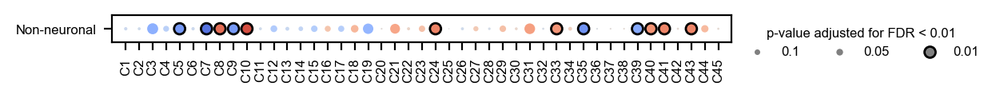

/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_8646/3267654132.py:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_rgc['meets_cutoff'] = df_rgc['-log10 p-value'] > 2


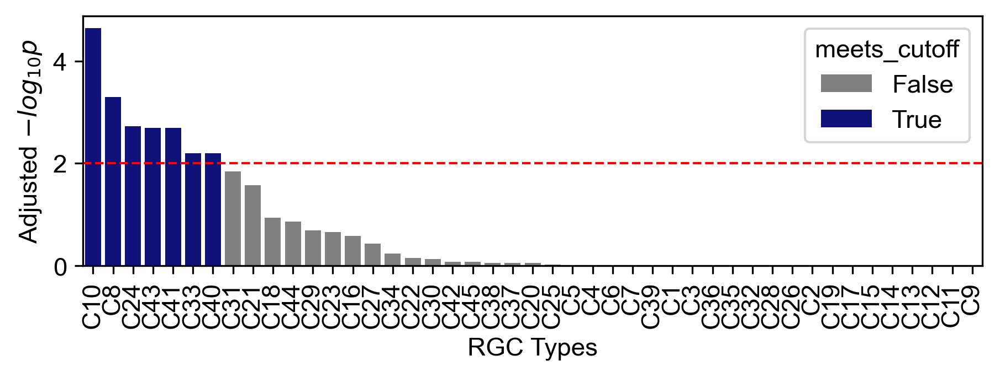

In [258]:
adata.obs['split_run']=pd.Categorical(adata.obs['D/V'].astype(str) + adata.obs['N/T'].astype(str) + adata.obs['run'].astype(int).astype(str))
run_key='split_run'
runs=adata.obs[run_key].unique()

suffix=""
cluster_key=f'final_assignment{suffix}'
adata.obs[cluster_key] = pd.Categorical(adata.obs[cluster_key])
n_neighs=15
radius=25
trial_name=f"sep_regions{suffix}"

prefixes=[]

runs = list(itertools.product(['DorsalTemporal','DorsalNasal','VentralNasal','VentralTemporal'],['3','4','5','7','16','17']))
runs = [''.join(i) for i in runs]

for run in tqdm(runs):
    prefix=f"{trial_name}_n_neighs{n_neighs}_run{run}_radius{radius}"
    prefixes.append(prefix)


df_agg,df_avg= plot_test(
    adata,
    runs=runs,
    col='Non-neuronal', 
    cluster_key=cluster_key,
    n_neighs=n_neighs,
    values_to_exclude=['Low quality neuronal','Amacrine','Unassigned'],
    input_dir=os.path.join(BASE_DIR,"data","permutations"),
    trial_name=trial_name,
    output_f=os.path.join(figure_dir,f"{trial_name}_{n_neighs}_{radius}"),
    prefixes=[p for p in prefixes]
)

df_t = df_agg.groupby(['Pair1','Pair2'])['zscore'].sum()/np.sqrt(len(df_agg['Run'].unique()))
df_t = df_t.reset_index()

df_rgc,adjusted_pv = plot_dotplot(df_t,xlabels=[f'C{i}' for i in range(1,46)],ylabels=['Non-neuronal'],threshold=0.01,output_f=os.path.join(figure_dir,f"Non-neuronnal_interaction{suffix}.png"))

df_rgc['p-value'] = np.where(df_rgc['zscore'] > 0,df_rgc['adjusted_p'],1)
df_rgc['-log10 p-value'] = -np.log10(df_rgc['p-value'])
plt.show()
with plt.rc_context({'figure.figsize':(7,2),'figure.dpi':300,'font.size':11,'font.sans-serif':'Arial'}):
    df_rgc['meets_cutoff'] = df_rgc['-log10 p-value'] > 2
    sns.barplot(df_rgc,x='Pair2',y='-log10 p-value',order=df_rgc.sort_values(by='-log10 p-value',ascending=False)['Pair2'],hue='meets_cutoff',palette={True:'darkblue',False:'grey'})
    plt.xticks(rotation=90)
    plt.axhline(-np.log10(0.01),linestyle='--',color='red',linewidth=1)
    plt.xlabel('RGC Types')
    plt.ylabel('Adjusted $-log_{10}p$')
    plt.savefig(os.path.join(figure_dir,f"P-values_{n_neighs}_{radius}_{suffix}.pdf"),bbox_inches='tight')#15,25
    
    plt.show()

In [ ]:
t_counts_lst = []
for suffix in ["","_v2","_v3"]:
    df_i = adata.obs[(adata.obs[f'class{suffix}']=='RGC') & (adata.obs[f'final_assignment{suffix}'] != 'Unassigned')]
    t_counti = pd.DataFrame(df_i[f'final_assignment{suffix}'].value_counts(normalize=True)[RGC_types])
    t_counti = t_counti.rename(columns={f'final_assignment{suffix}':'final_assignment'})
    t_counti['version'] = suffix
    t_counts_lst.append(t_counti)
    
joint_counts = pd.concat((t_counts_lst),axis=0).reset_index()
sns.barplot(joint_counts,x='index',y='final_assignment',hue='version')
plt.xticks(rotation=90)

# Old

## Mosaic

In [7]:
def update_coords(adata,col_x='aligned_center_y',col_y='aligned_center_y'):
    alignment = {
        3:{'center':(2900,9476),'reflect':False,'rotate':135},
        4:{'center':(4250,11200),'reflect':True,'rotate':124},
        5:{'center':(2350,9850),'reflect':True,'rotate':-69},
        7:{'center':(7550,9250),'reflect':True,'rotate':-30},
        16:{'center':(11200,1900),'reflect':True,'rotate':-60},#16 and 17 seem reasonable but may need adjustment
        17:{'center':(12910,3750),'reflect':False,'rotate':130},
    }

    #Note: updates aligned_center_x in place! (run this more than once and you'll get a bug...)

    def rotate_clockwise(x,y,degrees):
        theta = np.deg2rad(degrees)
        rot_mat=np.array([[np.cos(theta),np.sin(theta)],[-np.sin(theta),np.cos(theta)]])
        rotated = rot_mat @ np.array([x,y])
        return np.array([rotated[0],rotated[1]]).T

    adata.obs['dorsal']=True
    adata.obs['nasal']=True
    adata.obs['D/V']='Dorsal'
    adata.obs['N/T']='Nasal'
    for run in alignment:
        ar= alignment[run]
        adata_r = adata[adata.obs['run']==run]

        #recenter
        adata_r.obs[col_x]=adata_r.obs[col_x]-ar['center'][0]
        adata_r.obs[col_y]=adata_r.obs[col_y]-ar['center'][1]
        #reflect
        if ar['reflect']:
            adata_r.obs[col_x]=-adata_r.obs[col_x]
        #rotate
        output=rotate_clockwise(adata_r.obs[col_x].values,adata_r.obs[col_y].values,ar['rotate'])
        adata_r.obs[[col_x,col_y]]=rotate_clockwise(adata_r.obs[col_x].values,adata_r.obs[col_y].values,ar['rotate'])
        adata_r.obs['dorsal'] = adata_r.obs[col_y]>0
        adata_r.obs['D/V']=adata_r.obs['dorsal'].apply(lambda x: 'Dorsal' if x else 'Ventral')
        adata_r.obs['nasal']=adata_r.obs[col_x]<0    
        adata_r.obs['N/T']=adata_r.obs['nasal'].apply(lambda x: 'Nasal' if x else 'Temporal')
        adata.obs.update(adata_r.obs)
        print(adata.obs.columns)

def make_square(xl,yl,d):
    return [[xl,yl],[xl+d,yl],[xl+d,yl+d],[xl,yl+d]]

ex_ROI = {
    3:{
        0:[make_square(95,-1052,920)], #good, HUGE,
        1:[make_square(0,0,1000)]
    },
    7:{
        0:[make_square(-1521,-94,700)],
        1:[make_square(935,0,1000)],
        3:[]
    }
}

def create_C16_subclass_and_SAC(adata,old_col='final_assignment',new_col='subtyped_assignments'):
    adata.obs['Calb1'] = pd.Series(adata[:,'Calb1'].X.toarray()[:,0],index=adata.obs.index)
    try:
        adata.obs[new_col] = pd.Categorical(adata.obs[old_col])
        adata.obs[new_col]= adata.obs[old_col].cat.add_categories(['C16_D','C16_V','SAC'])
    except Exception as e:
        raise AssertionError(e)
    adata.obs.loc[(adata.obs['Calb1'] > 1.75) & (adata.obs[new_col]=='C16') ,new_col] = 'C16_D'
    adata.obs.loc[(adata.obs['Calb1'] <= 1.75) & (adata.obs[new_col]=='C16'),new_col] = 'C16_V'
    adata.obs.loc[(adata.obs['retina_class'] == 'GabaAC') &(adata.obs['joint_leiden'] == '0') ,new_col] = 'SAC'
    adata.obs.loc[(adata.obs['retina_class'] == 'GabaAC') &(adata.obs['joint_leiden'] == '0') ,'class'] = 'Amacrine'
    adata.obs[new_col] = adata.obs[new_col].cat.remove_categories(['C16'])

adata=sc.read_h5ad(os.path.join(data_dir,"merged_control_cluster_patched.h5ad"))
adata.obs[['realigned_center_x','realigned_center_y']] = adata.obs[['aligned_center_x','aligned_center_y']]
update_coords(adata,col_x='realigned_center_x',col_y='realigned_center_y')
create_C16_subclass_and_SAC(adata,old_col='final_assignment',new_col='final_assignment')



mosaic_data_dir = os.path.join("imaging_scripts","mosaic","processed")



/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_27210/3645646509.py:28: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_r.obs[col_x]=adata_r.obs[col_x]-ar['center'][0]


Index(['Size', 'center_x', 'center_y', 'max_areas', 'aligned_center_x',
       'aligned_center_y', 'to_keep', 'region', 'is_amacrine', 'is_RGC',
       'pass_cutoff', 'counts', 'group', 'group_num', 'class',
       'final_assignment', 'run', 'joint_leiden', 'retina_class',
       'realigned_center_x', 'realigned_center_y', 'dorsal', 'nasal', 'D/V',
       'N/T'],
      dtype='object')


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_27210/3645646509.py:28: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_r.obs[col_x]=adata_r.obs[col_x]-ar['center'][0]


Index(['Size', 'center_x', 'center_y', 'max_areas', 'aligned_center_x',
       'aligned_center_y', 'to_keep', 'region', 'is_amacrine', 'is_RGC',
       'pass_cutoff', 'counts', 'group', 'group_num', 'class',
       'final_assignment', 'run', 'joint_leiden', 'retina_class',
       'realigned_center_x', 'realigned_center_y', 'dorsal', 'nasal', 'D/V',
       'N/T'],
      dtype='object')


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_27210/3645646509.py:28: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_r.obs[col_x]=adata_r.obs[col_x]-ar['center'][0]


Index(['Size', 'center_x', 'center_y', 'max_areas', 'aligned_center_x',
       'aligned_center_y', 'to_keep', 'region', 'is_amacrine', 'is_RGC',
       'pass_cutoff', 'counts', 'group', 'group_num', 'class',
       'final_assignment', 'run', 'joint_leiden', 'retina_class',
       'realigned_center_x', 'realigned_center_y', 'dorsal', 'nasal', 'D/V',
       'N/T'],
      dtype='object')


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_27210/3645646509.py:28: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_r.obs[col_x]=adata_r.obs[col_x]-ar['center'][0]


Index(['Size', 'center_x', 'center_y', 'max_areas', 'aligned_center_x',
       'aligned_center_y', 'to_keep', 'region', 'is_amacrine', 'is_RGC',
       'pass_cutoff', 'counts', 'group', 'group_num', 'class',
       'final_assignment', 'run', 'joint_leiden', 'retina_class',
       'realigned_center_x', 'realigned_center_y', 'dorsal', 'nasal', 'D/V',
       'N/T'],
      dtype='object')


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_27210/3645646509.py:28: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_r.obs[col_x]=adata_r.obs[col_x]-ar['center'][0]


Index(['Size', 'center_x', 'center_y', 'max_areas', 'aligned_center_x',
       'aligned_center_y', 'to_keep', 'region', 'is_amacrine', 'is_RGC',
       'pass_cutoff', 'counts', 'group', 'group_num', 'class',
       'final_assignment', 'run', 'joint_leiden', 'retina_class',
       'realigned_center_x', 'realigned_center_y', 'dorsal', 'nasal', 'D/V',
       'N/T'],
      dtype='object')


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_27210/3645646509.py:28: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_r.obs[col_x]=adata_r.obs[col_x]-ar['center'][0]


Index(['Size', 'center_x', 'center_y', 'max_areas', 'aligned_center_x',
       'aligned_center_y', 'to_keep', 'region', 'is_amacrine', 'is_RGC',
       'pass_cutoff', 'counts', 'group', 'group_num', 'class',
       'final_assignment', 'run', 'joint_leiden', 'retina_class',
       'realigned_center_x', 'realigned_center_y', 'dorsal', 'nasal', 'D/V',
       'N/T'],
      dtype='object')


In [186]:
NULL_COLOR='Grey'
OBSERVED_COLOR='Blue'
def plot_density(df_distances,ctype,ax=None,roi=None,title=None,xlabel=None,ylabel=None,xlim=(0,100),palette=None):
    tmp = df_distances[(df_distances['Type']==ctype) & (df_distances['Category']=='Null')]
    tmp2 = df_distances[(df_distances['Type']==ctype) & (df_distances['Category']=='Observed')]
    if roi is not None:
        assert roi in tmp['roi'].unique() and roi in tmp2['roi'].unique()
        tmp = tmp[tmp['roi']==roi]
        tmp2 = tmp2[tmp2['roi']==roi]
    if ax is None:
        fig,ax = plt.subplots()

    sns.kdeplot(tmp['distances'].values,ax=ax,color=NULL_COLOR if palette is None else palette['Null'],label='Null {}'.format(ctype))
    sns.kdeplot(tmp2['distances'].values,ax=ax,color=OBSERVED_COLOR if palette is None or ctype not in palette else palette[ctype],label='Observed {}'.format(ctype))
    ax.set_xlim(xlim)
    if xlabel is None:
        xlabel = r'Nearest Neighbor Distance ($\mu m$)'
    if ylabel is None:
        ylabel = 'Density'
    ax.set_ylabel(ylabel)
    ax.set_xlabel(xlabel)
    if title is None:
        title=roi
    ax.set_title(title)
    ax.set_xticks(np.linspace(xlim[0],xlim[1],5))


def plot_example(df_distances,ctypes, rois_to_use=None,palette=None,xlim=(0,100),output_f=None):
    nrows = len(ctypes)
    if rois_to_use is None:
        rois_to_use = df_distances['roi'].unique()
    ncols = len(rois_to_use)
    legend_spacing = np.linspace(1,0.2,nrows)
    with plt.rc_context({'font.sans-serif':'Arial'}):
        fig,ax = plt.subplots(nrows=nrows,ncols=ncols,figsize=(ncols*1.75,nrows*1.3),sharex=True,sharey=True)
        if nrows == 1:
            ax = [ax]
        fig.tight_layout()

        for i,ax_row in enumerate(ax):
            for j,_ in enumerate(ax_row):
                plot_density(
                    df_distances,ctypes[i],
                    ax=ax[i][j],
                    roi=rois_to_use[j],
                    xlim=xlim,
                    title = None if i == 0 else '',
                    xlabel = None if j == ncols//2 else '',
                    ylabel = None if i == nrows//2 else '',
                    palette=palette
                )
                
            handles, labels = ax[i][j].get_legend_handles_labels()
            fig.legend(handles, labels, loc='upper center',bbox_to_anchor=(1.05,legend_spacing[i]))

        #ax.set_xlabel('common xlabel')
        #ax.set_ylabel('common ylabel')
        fig.savefig(output_f)
        fig.show()

#plot_example(df_distances,ctypes=['C3','C4','C7','C10','C24'],palette={'Null':NULL_COLOR,'C3':'Blue','C4':'Green','C7':'Orange','C10':'Purple','C24':'Red'},output_f=os.path.join("figures","nice","Example_distributions.pdf"))
plot_example(df_distances,ctypes=['C3','C22','C23','C28','C34','C43','C45'],palette={'Null':NULL_COLOR,'C3':'Blue','C22':'Green','C23':'Red','C28':'Orange','C33':'Black','C43':'Green','C45':'Purple'},xlim=(0,200),output_f=os.path.join("figures","nice","less_clear.pdf"))

FileNotFoundError: [Errno 2] No such file or directory: 'figures/nice/less_clear.pdf'

In [8]:
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
def plot_shuffle(adata,ctypes,run,rg,ex,polys,palette,key='final_assignment',randomized_key='randomized_assignment',x='realigned_center_x',y='realigned_center_y',fname=None):
    pts = polys[run][rg][ex]
    (xl,yl),(xu,yu) = pts[0],pts[2]
    df_rgc = adata.obs[(adata.obs['class']== 'RGC') & (adata.obs[x].between(xl,xu)) & (adata.obs[y].between(yl,yu)) & (adata.obs['run'] == run) & (adata.obs['region']==rg)]
    df_rgc[randomized_key] = pd.Series(df_rgc[key].sample(frac=1).values,index=df_rgc.index)    

    fig,ax = plt.subplots(nrows=len(ctypes),ncols=2,figsize=(len(ctypes),10))
    for i,_ in enumerate(ax):
        for j,k_col in enumerate([key,randomized_key]):
            df_ctype = df_rgc[df_rgc[k_col] == ctypes[i]]
            df_nottype = df_rgc[df_rgc[k_col] != ctypes[i]]
            ax_s = ax[i][j]
            legend = (j==1)
            sns.scatterplot(df_nottype,x='realigned_center_x',y='realigned_center_y',color=palette['Null'],s=1,ax=ax_s,label='Other RGC',legend=legend,rasterized=True)
            sns.scatterplot(df_ctype,x='realigned_center_x',y='realigned_center_y',color=palette[ctypes[i]],s=3,ax=ax_s,label=ctypes[i],legend=legend,rasterized=True)
            ax_s.set_aspect('equal',adjustable='box')
            ax_s.set_xlim(xl,xu),ax_s.set_ylim(yl,yu)
            if legend:
                ax_s.legend(bbox_to_anchor=(1,1),fontsize=8,prop={'family':'Arial'})
            ax_s.set_xticks([]),ax_s.set_yticks([])
            ax_s.set_ylabel(''),ax_s.set_xlabel('')


            

        if i == 0:
            ax[i][0].set_title('Observed',font='Arial')
            ax[i][1].set_title('Random',font='Arial')
        if j ==0:
            ax[i][0].legend().remove()
    

    fig.savefig(fname,bbox_inches='tight',dpi=300)
    fig.show()

In [213]:
from matplotlib.ticker import FormatStrFormatter
NULL_COLOR='slategrey'
BACKGROUND_COLOR='lightgrey'
OBSERVED_COLOR='Blue'
def plot_density(df_distances,ctype,distance_key='distances',ax=None,roi=None,title=None,xlabel=None,ylabel=None,xlim=(0,100),palette=None):
    tmp = df_distances[(df_distances['Type']==ctype) & (df_distances['Category']=='Null')]
    tmp2 = df_distances[(df_distances['Type']==ctype) & (df_distances['Category']=='Observed')]
    if roi is not None:
        assert roi in tmp['roi'].unique() and roi in tmp2['roi'].unique()
        tmp = tmp[tmp['roi']==roi]
        tmp2 = tmp2[tmp2['roi']==roi]
    if ax is None:
        fig,ax = plt.subplots()

    sns.kdeplot(tmp[distance_key].values,ax=ax,color=NULL_COLOR if palette is None else palette['Null'],label='Null {}'.format(ctype))
    sns.kdeplot(tmp2[distance_key].values,ax=ax,color=OBSERVED_COLOR if palette is None or ctype not in palette else palette[ctype],label='Observed {}'.format(ctype))
    ax.set_xlim(xlim)
    if xlabel is None and distance_key=='distances':
        xlabel = r'Nearest Neighbor Distance ($\mu m$)'
    elif xlabel is None and distance_key == 'areas':
        xlabel = r'Voronoi Area ($\mu m^2$)'

    if ylabel is None:
        ylabel = 'Density'
    ax.set_ylabel(ylabel)
    ax.set_xlabel(xlabel)
    if title is None:
        title=roi
    ax.set_title(title)
    if distance_key== 'distances':
        ax.yaxis.set_major_formatter(FormatStrFormatter('%.3f'))
    else:
        ax.yaxis.set_major_formatter(FormatStrFormatter('%.5f'))

    ax.set_xticks(np.linspace(xlim[0],xlim[1],3))

    
def plot_rows(df_v,df_RI,adata,ctypes,run,rg,ex,polys,palette,plot_voronoi=False,distance_key='distances',key='final_assignment',randomized_key='randomized_assignment',x='realigned_center_x',y='realigned_center_y',xlim=(0,100),fname=None):
    nrows = len(ctypes)
    ncols = 4

    #Assemble random and not random
    pts = polys[run][rg][ex]
    (xl,yl),(xu,yu) = pts[0],pts[2]
    df_rgc = adata.obs[(adata.obs['class']== 'RGC') & (adata.obs[x].between(xl,xu)) & (adata.obs[y].between(yl,yu)) & (adata.obs['run'] == run) & (adata.obs['region']==rg)]
    df_rgc[randomized_key] = pd.Series(df_rgc[key].sample(frac=1).values,index=df_rgc.index)    
    df_am =adata.obs[(adata.obs['class']== 'Amacrine') & (adata.obs[x].between(xl,xu)) & (adata.obs[y].between(yl,yu)) & (adata.obs['run'] == run) & (adata.obs['region']==rg)]
    df_am[randomized_key] = pd.Series(df_am[key].sample(frac=1).values,index=df_am.index)     

    fig,ax = plt.subplots(nrows=nrows,ncols=ncols,gridspec_kw={'width_ratios':[1,1,1,0.5],},figsize=(8,2*nrows))
    for i,ax_r in enumerate(ax):
        for k,k_col in enumerate([key,randomized_key]):
            if ctypes[i] != 'SAC':
                df_base = df_rgc
            else:
                df_base = df_am
        
            df_ctype = df_base[df_base[k_col] == ctypes[i]]
            df_nottype = df_base[df_base[k_col] != ctypes[i]]


            sns.scatterplot(df_nottype,x='realigned_center_x',y='realigned_center_y',color=BACKGROUND_COLOR,s=1,ax=ax_r[k],rasterized=True)
            c = NULL_COLOR if k_col == randomized_key else palette[ctypes[i]]
            sns.scatterplot(df_ctype,x='realigned_center_x',y='realigned_center_y',color=c,s=4,ax=ax_r[k],rasterized=True)
            if plot_voronoi:
                vor = scipy.spatial.Voronoi(df_ctype[['realigned_center_x','realigned_center_y']].values)
                scipy.spatial.voronoi_plot_2d(vor,ax=ax_r[k],show_points=False,show_vertices=False,line_width=0.3)
            ax_r[k].set_aspect('equal',adjustable='box')
            ax_r[k].set_xlim(xl,xu),ax_r[k].set_ylim(yl,yu)
            ax_r[k].set_xticks([]),ax_r[k].set_yticks([])
            ax_r[k].set_ylabel(''),ax_r[k].set_xlabel('')
            if i == 0 and k_col==key:
                ax_r[k].set_title('Real')
            elif i==0 and k_col ==randomized_key:
                ax_r[k].set_title('Random')
            if k==0:
                ax_r[k].set_ylabel(ctypes[i])
        
        k+=1 
        plot_density(
                    df_v,ctypes[i],
                    distance_key=distance_key,
                    ax=ax_r[k],
                    roi=None,
                    xlim=xlim,
                    title = '',
                    xlabel =None if i == nrows-1 else '', 
                    ylabel = None,
                    palette=palette
                )

        k+=1
        if distance_key=='distances':
            rindex= 'NNRI'
        elif distance_key == 'areas':
            rindex = 'VDRI'
        else:
            raise AssertionError()
        sns.barplot(df_RI[df_RI['Type'] == ctypes[i]],x='Type',y=rindex,hue='Category',palette={'Null':NULL_COLOR, 'Observed':palette[ctypes[i]]},edgecolor='black',ax=ax_r[k],linewidth=0.2,err_kws={'linewidth':0.4},legend=None)
        ax_r[k].set_xlabel('')
        ax_r[k].set_xticks([])
    
    fig.tight_layout()
    fig.savefig(fname)




        
        




In [217]:
with plt.rc_context({'font.sans-serif':'Arial','pdf.fonttype':42,'ps.fonttype':42}):
    #plot_rows(df_distances,df_NNRI,adata,ctypes=['SAC','C2','C3','C4','C5','C7','C10','C23'],plot_voronoi=True,distance_key='distances',run=3,rg=0,ex=0,polys=ex_ROI,palette={'Null':NULL_COLOR,'SAC':'cornflowerblue','C1':'Blue','C2':'Green','C3':'Red','C4':'Orange','C5':'Teal','C7':'Purple','C10':'royalblue','C23':'green','C24':'green'},fname=os.path.join(figure_dir,"Example Mosaics.pdf"))
    #plot_rows(df_areas,df_VDRI,adata,ctypes=['SAC','C2','C3','C4','C5','C7','C10','C23'],plot_voronoi=True,distance_key='areas',run=3,rg=0,ex=0,polys=ex_ROI,palette={'Null':NULL_COLOR,'SAC':'cornflowerblue','C1':'Blue','C2':'Green','C3':'Red','C4':'Orange','C5':'Teal','C7':'Purple','C10':'royalblue','C23':'green','C24':'green'},xlim=(0,15000),fname=os.path.join(figure_dir,"Example Mosaics_voronoi.pdf"))
    plot_rows(df_areas,df_VDRI,adata,ctypes=['SAC','C13'],plot_voronoi=True,distance_key='areas',run=3,rg=0,ex=0,polys=ex_ROI,palette={'Null':NULL_COLOR,'SAC':'cornflowerblue','C1':'Blue','C2':'Green','C3':'Red','C4':'Orange','C5':'Teal','C7':'Purple','C10':'royalblue','C23':'green','C24':'green','C13':'red'},xlim=(0,15000),fname=os.path.join(figure_dir,"C13.pdf"))

#plot_rows(df_areas,df_VDRI,adata,ctypes=['C2','C3'],plot_voronoi=True,distance_key='areas',run=3,rg=0,ex=0,polys=ex_ROI,palette={'Null':NULL_COLOR,'C1':'Blue','C2':'Green','C3':'Red','C4':'Orange','C5':'Teal','C7':'Purple','C10':'royalblue','C24':'green'},xlim=(0,15000),fname=os.path.join(figure_dir,""))


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_27210/2211111103.py:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_rgc[randomized_key] = pd.Series(df_rgc[key].sample(frac=1).values,index=df_rgc.index)
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_27210/2211111103.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_am[randomized_key] = pd.Series(df_am[key].sample(frac=1).values,index=df_am.index)
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_27210/2211111103.py:

In [10]:
df_NNRI = pd.read_csv(os.path.join(mosaic_data_dir,"NNRIs_v2.csv"),index_col=0)
df_distances = pd.read_csv(os.path.join(mosaic_data_dir,"distances_v2.csv"),index_col=0)

df_VDRI = pd.read_csv(os.path.join(mosaic_data_dir,"VDRIs.csv"),index_col=0)
df_areas = pd.read_csv(os.path.join(mosaic_data_dir,"areas.csv"),index_col=0)

In [20]:
df_plot2 = df_NNRI[(df_NNRI['Type']!='Amacrine') & df_NNRI['Type'].isin(valid_types)]

for t in ordered_types:
    null_indices = df_plot2[(df_plot2['Type']==t) & (df_plot2['Category']=='Null')].index
    obs_indices = ["_".join(x.split("_")[0:4] + ["observed"]) for x in null_indices]
    obs = df_plot2.loc[obs_indices]['NNRI']
    null = df_plot2.loc[null_indices]['NNRI']
    stats = scipy.stats.ttest_rel(null,obs,alternative='less')
    if stats.pvalue < 0.05:
        print(t,stats.pvalue)


SAC 5.021501091515526e-05
C1 0.04250546305597216
C2 0.02380389751429975
C3 0.03170770374668538
C4 0.018510889332796637
C5 0.0068650580336115504
C6 0.022703279451892894
C9 0.02958203334121967
C11 0.012342179594165704
C14 0.01150056654973225


KeyError: "None of [Index(['rn3_rg0_ex0_C16_observed', 'rn7_rg1_ex0_C16_observed',\n       'rn7_rg0_ex0_C16_observed'],\n      dtype='object')] are in the [index]"

In [172]:
%matplotlib auto
fig,ax= plt.subplots(figsize=(8,3))
with plt.rc_context({'font.sans-serif':'Arial'}):
    t_counts = adata.obs['final_assignment'].value_counts()
    valid_types = t_counts[t_counts > 1900].index
    df_plot = df_VDRI[(df_VDRI['Type']!='Amacrine') & df_VDRI['Type'].isin(valid_types)]
    ax= sns.barplot(df_plot,x='Type',hue='Category',y='VDRI',palette={'Null':'Grey','Observed':'limegreen'},err_kws={'linewidth':0.5,'color':'black'},capsize=0.5,edgecolor='black')
    ax.tick_params(axis='x', labelrotation=90)
    ax.set_ylim(0,8)
    fig.canvas.draw()
    xtick_info = ax.get_xticklabels()
    null_data =ax.containers[0].datavalues
    obs_data =ax.containers[1].datavalues
    for i,text in enumerate(xtick_info):
        x,y = text.get_position()
        t = text.get_text()
        null_indices = df_plot[(df_plot['Type']==t) & (df_plot['Category']=='Null')].index
        obs_indices = ["_".join(x.split("_")[:-1] + ["observed"]) for x in null_indices]
        obs = df_plot.loc[obs_indices]['VDRI']
        null = df_plot.loc[null_indices]['VDRI']
        stats = scipy.stats.ttest_rel(null,obs,alternative='less')
        if stats.pvalue < 0.05:
            y = max(null_data[int(i)],obs_data[int(i)])
            ax.annotate('*',(x,y+0.3))
    
    
    
    fig.savefig(os.path.join(figure_dir,"VDRI_restricted.pdf"))

   




Using matplotlib backend: MacOSX
[Text(0, 0, 'SAC'), Text(1, 0, 'C1'), Text(2, 0, 'C2'), Text(3, 0, 'C3'), Text(4, 0, 'C4'), Text(5, 0, 'C5'), Text(6, 0, 'C6'), Text(7, 0, 'C7'), Text(8, 0, 'C8'), Text(9, 0, 'C9'), Text(10, 0, 'C10'), Text(11, 0, 'C11'), Text(12, 0, 'C12'), Text(13, 0, 'C13'), Text(14, 0, 'C14'), Text(15, 0, 'C15'), Text(16, 0, 'C16_V'), Text(17, 0, 'C16_D'), Text(18, 0, 'C17'), Text(19, 0, 'C18'), Text(20, 0, 'C19'), Text(21, 0, 'C20'), Text(22, 0, 'C21'), Text(23, 0, 'C23'), Text(24, 0, 'C24'), Text(25, 0, 'C25'), Text(26, 0, 'C26'), Text(27, 0, 'C29'), Text(28, 0, 'C30'), Text(29, 0, 'C32'), Text(30, 0, 'C34'), Text(31, 0, 'C38'), Text(32, 0, 'C39'), Text(33, 0, 'C43')]


In [178]:
%matplotlib auto
fig,ax= plt.subplots(figsize=(8,3))
with plt.rc_context({'font.sans-serif':'Arial'}):
    t_counts = adata.obs['final_assignment'].value_counts()
    valid_types = t_counts[t_counts > 1900].index
    df_plot = df_NNRI[(df_NNRI['Type']!='Amacrine') & df_NNRI['Type'].isin(valid_types)]
    ax= sns.barplot(df_plot,x='Type',hue='Category',y='NNRI',palette={'Null':'Grey','Observed':'cornflowerblue'},err_kws={'linewidth':0.5,'color':'black'},capsize=0.5,edgecolor='black')
    ax.tick_params(axis='x', labelrotation=90)
    ax.set_ylim(0,8)
    fig.canvas.draw()
    xtick_info = ax.get_xticklabels()
    null_data =ax.containers[0].datavalues
    obs_data =ax.containers[1].datavalues
    for i,text in enumerate(xtick_info):
        x,y = text.get_position()
        t = text.get_text()
        null_indices = df_plot[(df_plot['Type']==t) & (df_plot['Category']=='Null')].index
        obs_indices = ["_".join(x.split("_")[:-1] + ["observed"]) for x in null_indices]
        obs = df_plot.loc[obs_indices]['NNRI']
        null = df_plot.loc[null_indices]['NNRI']
        stats = scipy.stats.ttest_rel(null,obs,alternative='less')
        if stats.pvalue < 0.05:
            y = max(null_data[int(i)],obs_data[int(i)])
            ax.annotate('*',(x,y+0.3))
    
    
    
    fig.savefig(os.path.join(figure_dir,"NNRI_restricted.pdf"))

   




Using matplotlib backend: MacOSX


## Supplement

In [9]:



adata_f =adata[(adata.obs['class']=='RGC') & (adata.obs['final_assignment']!='Unassigned')]
score_lst = []
for axis in ['dorsal','nasal']:
    adata_f.obs['final_assignment'] = pd.Categorical(adata_f.obs['final_assignment'])
    props=( adata_f.obs.groupby(['run',axis])['final_assignment'].value_counts() ) / ( adata_f.obs.groupby(['run',axis]).size() )
    key=f'props_{axis}'
    props=props.reset_index(name=key)
    scores = pd.DataFrame(props[props[axis]].set_index(['run','final_assignment'])[key]/ props[~props[axis]].set_index(['run','final_assignment'])[key])
    score_lst.append(scores)

fscores = pd.concat(score_lst,axis=1).reset_index()
fscores['props_temporal']= 1/fscores['props_nasal']
fscores['D/V Score'] = np.emath.log2(fscores['props_dorsal'])
fscores['T/N Score'] = np.emath.log2(fscores['props_temporal'])
gscores = fscores.groupby('final_assignment').agg({'D/V Score':{'mean','std'},'T/N Score':{'mean','std'}})

/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_2686/2542913416.py:4: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_f.obs['final_assignment'] = pd.Categorical(adata_f.obs['final_assignment'])


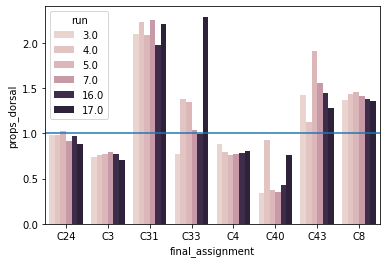

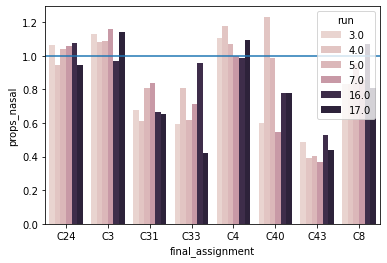

In [11]:
sns.barplot(fscores[fscores['final_assignment'].isin(['C3','C4','C8','C24','C33','C43','C40','C31'])],hue='run',x='final_assignment',y='props_dorsal')
plt.axhline(1.0)
plt.show()
sns.barplot(fscores[fscores['final_assignment'].isin(['C3','C4','C8','C24','C33','C43','C40','C31'])],hue='run',x='final_assignment',y='props_nasal')
plt.axhline(1.0)
plt.show()


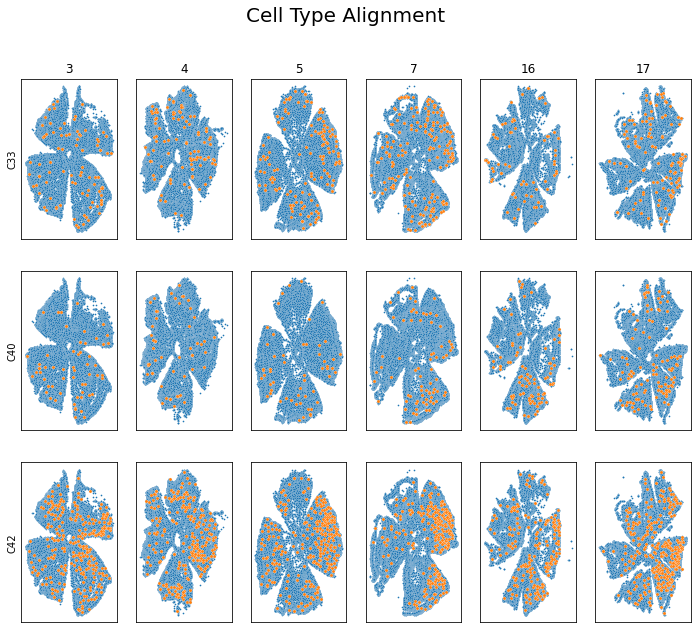

In [12]:
# Cell Type Plots to show proper alignment
cell_types = ['C33','C40','C42'] # C22 also does a good job
runs = [3,4,5,7,16,17]
n_c = len(runs) # number of columns
n_r = len(cell_types) # number of rows

fig, axes = plt.subplots(n_r,n_c,figsize=(12,10))
plt.setp(axes, xticks=[], yticks=[], xlabel=None, ylabel=None)

k=0
for i in cell_types:
    axes[k//n_c,0].set_ylabel(i)
    for j in runs:
        #sns.scatterplot(j, x='aligned_center_x',y='aligned_center_y',hue='dorsal',s=20,legend=False, ax=axes[k//n_c,k%n_c])
        sns.scatterplot(adata.obs[(adata.obs['run']==j) & (adata.obs['final_assignment']!=i)], 
                        x='aligned_center_x',y='aligned_center_y',s=3,legend=False, ax=axes[k//n_c,k%n_c])
        sns.scatterplot(adata.obs[(adata.obs['run']==j) & (adata.obs['final_assignment']==i)],
                        x='aligned_center_x',y='aligned_center_y',s=10,legend=False, ax=axes[k//n_c,k%n_c])
        k+=1

l=0
for run in runs:
    axes[0,l].set_title(run)
    l+=1
fig.suptitle('Cell Type Alignment', fontsize=20);
#plt.savefig('alignment_results.png',dpi=200);

/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_2299/3634820399.py:40: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_2299/3634820399.py:40: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


46
29


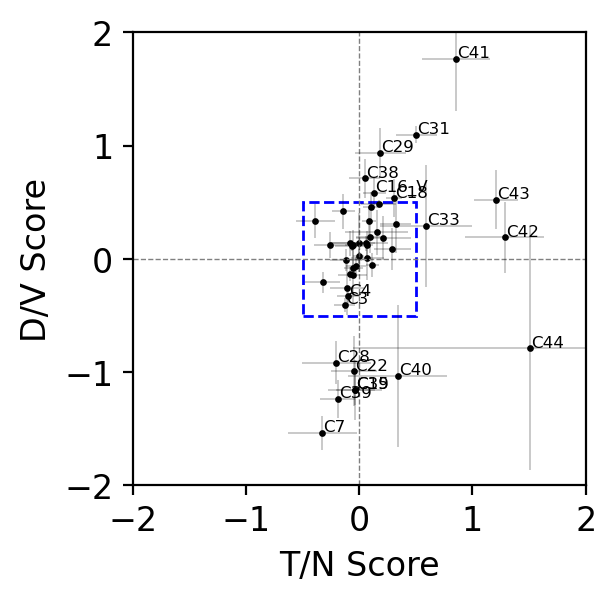

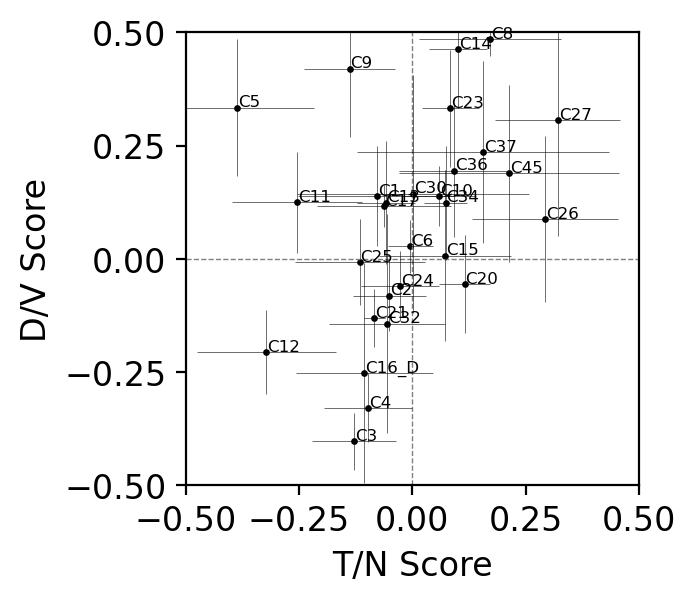

In [14]:
def plot_biases(scores,xlim=(-2,2),ylim=[-2,2],filt=False,add_box=None, figsize=(8,8),errcolor='black',zero_width=0.5,zero_color='red',ptcolor='black',plot_all=True,eps=0.01,s=1,elinewidth=0.2,DV_ann_range=None,TN_ann_range=None,ann_fontsize=4,output_f=""):
    fig,ax = plt.subplots(figsize=figsize,dpi=200)
    ax.axhline(0,color=zero_color,linewidth=zero_width,linestyle='--')
    ax.axvline(0,color=zero_color,linewidth=zero_width,linestyle='--')
    if add_box:
        ax.add_patch(add_box)
    if filt:
        print(len(scores))
        scores=scores[scores['D/V Score']['mean'].between(*ylim) & scores['T/N Score']['mean'].between(*xlim)]
        print(len(scores))
    plt.scatter(y=scores['D/V Score']['mean'],x=scores['T/N Score']['mean'],s=s,color=ptcolor)
    ax.errorbar(y=scores['D/V Score']['mean'],x=scores['T/N Score']['mean'],yerr=scores['D/V Score']['std'],xerr=scores['T/N Score']['std'],fmt='None',elinewidth=elinewidth,color=errcolor)

    for i in scores.index:
        tn_score,dv_score = scores.loc[i]['T/N Score']['mean'], scores.loc[i]['D/V Score']['mean']
        plot=False
        if DV_ann_range is not None and not (DV_ann_range[0] <= dv_score <= DV_ann_range[1]):
            assert DV_ann_range[0] <= DV_ann_range[1]
            plot=True

        elif TN_ann_range is not None and not (TN_ann_range[0] <= tn_score <= TN_ann_range[1]):
            assert TN_ann_range[0] <= TN_ann_range[1]
            plot=True
        elif plot_all:
            plot=True

        if plot:
            ax.annotate(text=i,xy=(tn_score+eps,dv_score+eps),fontsize=ann_fontsize)
        

    ax.set_ylabel('D/V Score')
    ax.set_xlabel('T/N Score')
    ax.set_xlim(xlim)
    ax.set_ylim(ylim)
    plt.yticks(ax.get_xticks())
    plt.xticks(ax.get_xticks())

    ax.set_aspect('equal', adjustable='box')
    fig.savefig(output_f)
    fig.show()

add_box = mpl.patches.Rectangle((-0.5,-0.5),width=1,height=1,edgecolor='blue',facecolor='white',linestyle='--')
with plt.rc_context(CONTEXT):
    plot_biases(gscores,s=2,elinewidth=0.15,figsize=(3,3),add_box=add_box,output_f=os.path.join(figure_dir,"Spatial_biases.pdf"),zero_color='grey',plot_all=False,DV_ann_range=[-0.3,0.5],TN_ann_range=[-0.4,0.4],ann_fontsize=6)
    plot_biases(gscores,s=2,filt=True,elinewidth=0.2,figsize=(3,3),add_box=None, xlim=(-0.5,0.5),ylim=(-0.5,0.5),ann_fontsize=6,eps=0.002,zero_color='grey',plot_all=True,output_f=os.path.join(figure_dir,"Spatial_biases_zoomed.pdf"))


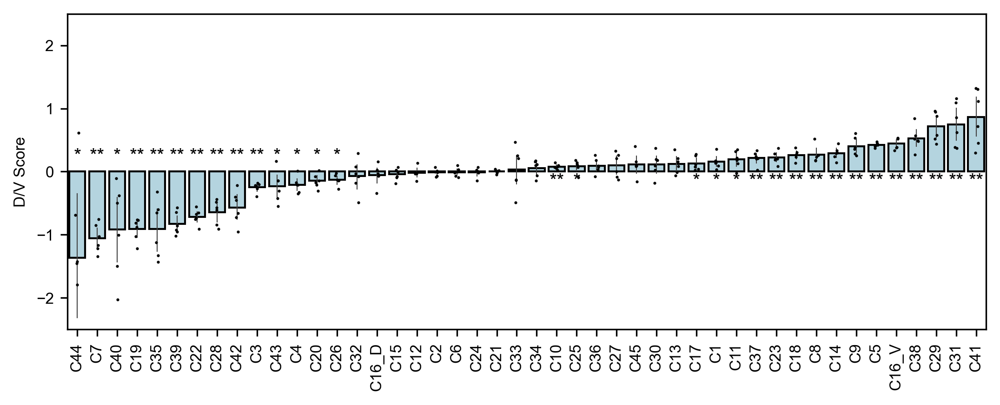

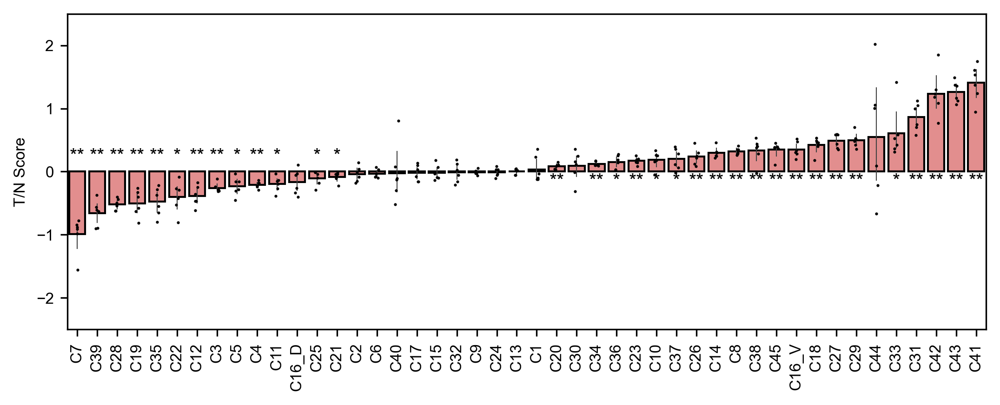

In [16]:

MOD_CONTEXT = CONTEXT.copy()
MOD_CONTEXT['figure.figsize'] = (8.5,3)
MOD_CONTEXT['font.size'] = 8
linewidth=0.5
s=3
output_f = os.path.join(figure_dir,"Dorsal_Ventral.pdf")
def quant_dist(fscores,type_col='final_assignment',score_col='D/V Score',color='lightblue',p_height=-1,s=3, p_fontsize=10,output_f=os.path.join(figure_dir,"Dorsal_Ventral.pdf")):
    with plt.rc_context(MOD_CONTEXT):
        gscores = fscores.groupby(type_col).agg({score_col:{'mean','std'}})
        order = gscores[score_col]['mean'].sort_values().index
        statistics = []
        mean_scores = []
        denote_markings=True
        
        ax=sns.barplot(data=fscores,x=type_col,y=score_col,color=color,edgecolor='black',order = order ,err_kws={'linewidth':linewidth})
        for rt in order:
            vals = fscores[fscores[type_col]==rt][score_col].values
            alternative='less'
            mean_score = np.mean(vals)
            if mean_score > 0:
                alternative='greater'
            mean_scores.append(mean_score)
            
            result= scipy.stats.ttest_1samp(vals,popmean=0,alternative=alternative)
            statistics.append(result.pvalue)

        if not isinstance(p_height, list):
            if isinstance(p_height,int):
                p_height=[p_height]*len(order)
            elif isinstance(p_height,str) and p_height=='auto':
                p_height = [1.1 if mean_score < 0 else 0.7 for mean_score in mean_scores]
        markers= []
        for p,stat,h in zip(ax.patches,statistics,p_height):
            if not denote_markings:
                mark='p = {:.1e}'.format(stat)
            else:
                if stat <0.005:
                    mark = '**'
                elif stat <0.05:
                    mark='*'
                else:
                    mark=''
            markers.append(mark)
                
            ax.annotate(mark,xy=(p.get_x()+p.get_width()/2,h-1),ha='center',va='bottom',fontsize=p_fontsize,color='black')
        sns.stripplot(data=fscores,x=type_col,y=score_col,color='black',ax=ax,edgecolor='black',order=gscores[score_col]['mean'].sort_values().index,s=s)
        plt.xticks(rotation=90)
        plt.ylim(-2.5,2.5)
        plt.xlabel('')
        plt.savefig(output_f,bbox_inches='tight')
        plt.show()
    return order,markers


order1,markers1 = quant_dist(fscores,type_col='final_assignment',score_col='D/V Score',color='lightblue',s=1.5,p_height='auto', output_f=os.path.join(figure_dir,"Dorsal_Ventral.pdf"))
order2, markers2 = quant_dist(fscores,type_col='final_assignment',score_col='T/N Score',color='lightcoral',s=1.5,p_height='auto', output_f=os.path.join(figure_dir,"Nasal_Temporal.pdf"))

In [252]:
for order,markers in zip([order1, order2], [markers1, markers2]):
    for i,(t,mark) in enumerate(zip(order,markers)):
        if mark == "**":
            markers[i] = True
        else:
            markers[i] = False

gscores['D/V Score','stat_sig'] = pd.Series(markers1, index=order1)
gscores['T/N Score','stat_sig'] = pd.Series(markers2, index=order2)
len(gscores[~(gscores['D/V Score','stat_sig'] | gscores['T/N Score','stat_sig']) | ((np.abs(gscores['D/V Score']['mean']) <0.2) & (np.abs(gscores['T/N Score']['mean']) <0.2)) ])

20

In [220]:
#Rui chen RGC count
adata_r1,adata_r2=sc.read_h5ad(os.path.join("data","ruichen","VA45_integrated.h5ad")),sc.read_h5ad(os.path.join("data","ruichen","VZA105a_integrated_368genes.h5ad"))
adata_r1.obs.groupby(['sampleid','majorclass']).size()[:,'RGC'].sum()
adata_r2.obs.groupby(['sampleid','majorclass']).size()[:,'RGC'].sum()

In [6]:
def plot_genes(adata,RGC_types,marker_genes,thresholds, output_f,signs=None,type_col='final_assignment'):
    fig,ax=plt.subplots(nrows=2,ncols=len(marker_genes),figsize=(len(marker_genes)*8,8*2))
    if signs is None:
        signs= [[1]*len(i) for i in thresholds]

    for i,(rt,markers,threshold,sign) in enumerate(zip(RGC_types,marker_genes,thresholds,signs)):
        print(markers,sign)
        print((adata[:,markers].X*np.array(sign)))
        express = np.sum((adata[:,markers].X*np.array(sign)) > np.array(threshold)*np.array(sign),axis=1) >= len(markers)
        sns.scatterplot(adata.obs[express],x='aligned_center_x',y='aligned_center_y',s=20,ax=ax[1,i],color='white',legend=None)
        sns.scatterplot(adata.obs[~express],x='aligned_center_x',y='aligned_center_y',s=0.5,ax=ax[1,i],color='grey',legend=None)
        ax[1,i].set_axis_off()
        title,smap="", {1:'+',-1:'-'}
        for j,(marker,pre) in enumerate(zip(markers,sign)):
            print(smap[-1])
            title += marker + f"{smap[pre]}"
            print(title)
            if j!= len(markers)-1:
                title+=','
        #title = '+,'.join(markers) +'+'
        ax[1,i].set_title(title,color='white',fontsize=40)
        ax[1,i].set_facecolor('black')

        filt=adata.obs[type_col]==rt
        df,df_n=adata.obs[filt],adata.obs[~filt]
        sns.scatterplot(data=df_n,x='aligned_center_x',y='aligned_center_y',color='grey',ax=ax[0,i],s=0.5)
        sns.scatterplot(data=df,x='aligned_center_x',y='aligned_center_y',color='white',ax=ax[0,i],s=20)
        ax[0,i].set_axis_off()

        ax[0,i].set_title(rt,color='white',fontsize=40)
        ax[0,i].set_facecolor('black')
    
    fig.savefig(output_f,facecolor='black',bbox_inches='tight',dpi=300)
    fig.show()

In [76]:
def plot_genes_alt(adata,RGC_types,marker_genes,thresholds, output_f,signs=None,figsize=None,type_col='final_assignment',title_size=40,in_pt_s=20,out_pt_s=0.5,in_color_t='red',in_color_g='blue',out_color='black'):
    if figsize is None:
        figsize = (len(marker_genes)*8,8*2)
    fig,ax=plt.subplots(nrows=2,ncols=len(marker_genes),figsize=figsize)
    if signs is None:
        signs= [[1]*len(i) for i in thresholds]

    for i,(rt,markers,threshold,sign) in enumerate(zip(RGC_types,marker_genes,thresholds,signs)):
        print(markers,sign)
        print((adata[:,markers].X*np.array(sign)))
        express = np.sum((adata[:,markers].X*np.array(sign)) > np.array(threshold)*np.array(sign),axis=1) >= len(markers)
        sns.scatterplot(adata.obs[express],x='aligned_center_x',y='aligned_center_y',s=in_pt_s,ax=ax[1,i],color=in_color_g,legend=None)
        sns.scatterplot(adata.obs[~express],x='aligned_center_x',y='aligned_center_y',s=out_pt_s,ax=ax[1,i],color=out_color,legend=None)
        ax[1,i].set_axis_off()
        title,smap="", {1:'+',-1:'-'}
        for j,(marker,pre) in enumerate(zip(markers,sign)):
            print(smap[-1])
            title += marker + f"{smap[pre]}"
            print(title)
            if j!= len(markers)-1:
                title+=','
        #title = '+,'.join(markers) +'+'
        ax[1,i].set_title(title,color='black',fontsize=title_size)
        #ax[1,i].set_facecolor('black')

        filt=adata.obs[type_col]==rt
        df,df_n=adata.obs[filt],adata.obs[~filt]
        sns.scatterplot(data=df,x='aligned_center_x',y='aligned_center_y',color=in_color_t,ax=ax[0,i],s=in_pt_s)
        sns.scatterplot(data=df_n,x='aligned_center_x',y='aligned_center_y',color=out_color,ax=ax[0,i],s=out_pt_s)
        ax[0,i].set_axis_off()

        ax[0,i].set_title(rt,color='black',fontsize=title_size)
        ax[0,i].set_aspect('equal', adjustable='box')
        ax[1,i].set_aspect('equal', adjustable='box')

    
    fig.savefig(output_f,bbox_inches='tight',dpi=300,rasterized=True)
    fig.show()

/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_3426/2457173240.py:16: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "rasterized" which is no longer supported as of 3.3 and will become an error in 3.6
  fig.savefig(output_f,bbox_inches='tight',dpi=300,rasterized=True)
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_3426/2457173240.py:17: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


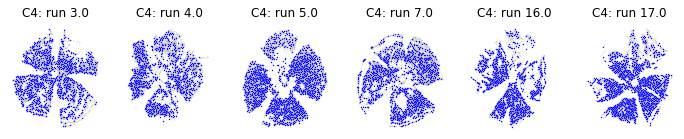

In [84]:
def plot_type_run(adata,run_col,type_col,t,title_size=40,in_pt_s=2,out_pt_s=0.05,in_color_g='blue',out_color='grey',output_f=""):
    ncols = adata.obs[run_col].unique().size
    fig,ax = plt.subplots(ncols=ncols,figsize=(ncols*2,2))

    for i,run in enumerate(adata.obs[run_col].unique()):
        df= adata.obs.sample(frac=1)
        filt1= (df[run_col]==run) & (df[type_col]== t)
        filt2 =(df[run_col]==run) & (df[type_col] != t)
        sns.scatterplot(df[filt2],x='aligned_center_x',y='aligned_center_y',s=out_pt_s,ax=ax[i],color=out_color,legend=None)
        sns.scatterplot(df[filt1],x='aligned_center_x',y='aligned_center_y',s=in_pt_s,ax=ax[i],color=in_color_g,legend=None)
        
        ax[i].set_title('{}: run {}'.format(t,run))
        ax[i].set_axis_off()
    if output_f == "":
        output_f = os.path.join(figure_dir,"{}.png".format(t))
    fig.savefig(output_f,bbox_inches='tight',dpi=300,rasterized=True)
    fig.show()

plot_type_run(adata,type_col='final_assignment',run_col='run',t='C4')

['Tbx20', 'Tagln2'] [1, 1]
[[-0.24016397 -0.31165734]
 [-0.24016397 -0.31165734]
 [-0.24016397 -0.31165734]
 ...
 [ 2.88521528 -0.31165734]
 [-0.24016397 -0.31165734]
 [-0.24016397 -0.31165734]]
-
Tbx20+
-
Tbx20+,Tagln2+
['Prkcq', 'Opn4'] [1, -1]
[[ 0.49947774  0.33718804]
 [-0.15936613  0.33718804]
 [ 0.6024732  -0.80168509]
 ...
 [-1.12045419  0.33718804]
 [ 0.3322309   0.33718804]
 [-1.12045419  0.33718804]]
-
Prkcq+
-
Prkcq+,Opn4-
['Neurod2', 'Eomes'] [1, 1]
[[-0.37412843 -0.51267362]
 [-0.37412843  0.42031956]
 [ 2.45997381  0.02672216]
 ...
 [-0.37412843 -0.51267362]
 [-0.37412843 -0.51267362]
 [-0.37412843 -0.51267362]]
-
Neurod2+
-
Neurod2+,Eomes+
['Cartpt', 'Prdm8'] [1, 1]
[[-0.65231043 -0.17914782]
 [ 0.71192491 -0.63613886]
 [ 0.4749231  -0.63613886]
 ...
 [-0.65231043 -0.63613886]
 [-0.65231043 -0.63613886]
 [-0.65231043 -0.63613886]]
-
Cartpt+
-
Cartpt+,Prdm8+
['Neurod2', 'S100b'] [1, 1]
[[-0.37412843  0.05230058]
 [-0.37412843  1.00176775]
 [ 2.45997381 -0.00571919]
 ...


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_33291/3629342963.py:37: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "rasterized" which is no longer supported as of 3.3 and will become an error in 3.6
  fig.savefig(output_f,bbox_inches='tight',dpi=300,rasterized=True)
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_33291/3629342963.py:38: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


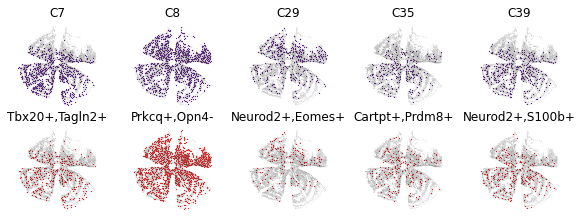

In [106]:
adata_f =adata[(adata.obs['class']=='RGC') & (adata.obs['final_assignment']!='Unassigned') & (adata.obs['run']==3)]

types_and_markers = {
    'C7':['Tbx20','Tagln2'],
    'C8':['Prkcq','Opn4'],#neg opn4
    'C29':['Neurod2','Eomes'],
    'C35':['Cartpt','Prdm8'],
    'C39':['Neurod2','S100b']
}
RGC_types,marker_genes = zip(*types_and_markers.items())
thresholds= [[0.5,0.5],[1,0.5],[2.5,1],[2,0.3],[1.25,1.25]]
signs=[[1,1],[1,-1],[1,1],[1,1],[1,1]]
#plot_genes(adata_f,RGC_types,marker_genes,output_f=os.path.join(figure_dir,"new_types.png"),thresholds=thresholds,signs=signs)
with plt.rc_context({"font.sans-serif":'Arial'}):
    plot_genes_alt(adata_f,RGC_types,marker_genes,figsize=(10,3.5),output_f=os.path.join(figure_dir,"new_types.png"),thresholds=thresholds,signs=signs,title_size=12,in_pt_s=1.5,out_pt_s=0.03,in_color_t='indigo',in_color_g='red')
#nice_scatter(adata=adata_f,col='final_assignment',RGC_types=RGC_types,facecolor='black',colors=[cmap_dorsal(gradient[0])]*6,output_f=os.path.join(figure_dir,f"biases.png"))
#nice_scatter(adata=adata_f[adata_f.obs['run']==3],col='final_assignment',RGC_types=['C43','C12'],facecolor='black',colors=[cmap_nasal(gradient[0]),cmap_nasal(gradient[0])],output_f=os.path.join(figure_dir,f"new_NT.png"))

In [ ]:
adata_f =adata[(adata.obs['class']=='RGC') & (adata.obs['final_assignment']!='Unassigned') & (adata.obs['run']==3)]

types_and_markers = {
    'C4':['Pde1a'],
    'C3':['Foxp2','Irx4'],
    'C28':['Foxp2', 'Cdk15'],
    'C31':['Spp1','Tbx20'],
    'C43':['Spp1', 'Calb1'],
    #'C29':['Prlr','Stxbp6'],
}
RGC_types,marker_genes = zip(*types_and_markers.items())
thresholds= [[2],[1.5,1.5],[1.5,1.5],[2,1.25],[3,1.5]]
with plt.rc_context({"font.sans-serif":'Arial'}):
    plot_genes_alt(adata_f,RGC_types,marker_genes,figsize=(10,3.5),output_f=os.path.join(figure_dir,"known_type_biases.png"),thresholds=thresholds,signs=signs,title_size=12,in_pt_s=1,out_pt_s=0.01,in_color_t='indigo',in_color_g='red')
#nice_scatter(adata=adata_f,col='final_assignment',RGC_types=RGC_types,facecolor='black',colors=[cmap_dorsal(gradient[0])]*6,output_f=os.path.join(figure_dir,f"biases.png"))
#nice_scatter(adata=adata_f[adata_f.obs['run']==3],col='final_assignment',RGC_types=['C43','C12'],facecolor='black',colors=[cmap_nasal(gradient[0]),cmap_nasal(gradient[0])],output_f=os.path.join(figure_dir,f"new_NT.png"))

['Pde1a'] [1, 1]
[[ 1.63693082  1.63693082]
 [-0.33851206 -0.33851206]
 [-0.33851206 -0.33851206]
 ...
 [-0.33851206 -0.33851206]
 [-0.33851206 -0.33851206]
 [-0.33851206 -0.33851206]]
-
Pde1a+
['Foxp2', 'Irx4'] [1, -1]
[[ 2.56382918  0.71994072]
 [-0.40335703  0.71994072]
 [-0.40335703 -1.30281532]
 ...
 [-0.40335703 -0.73391408]
 [-0.40335703  0.71994072]
 [ 0.32084745  0.32667544]]
-
Foxp2+
-
Foxp2+,Irx4-
['Foxp2', 'Cdk15'] [1, 1]
[[ 2.56382918 -0.34944555]
 [-0.40335703  0.98292124]
 [-0.40335703 -0.34944555]
 ...
 [-0.40335703  0.58724052]
 [-0.40335703 -0.34944555]
 [ 0.32084745 -0.34944555]]
-
Foxp2+
-
Foxp2+,Cdk15+
['Spp1', 'Tbx20'] [1, 1]
[[-0.40649638 -0.24016397]
 [ 0.2288637  -0.24016397]
 [-0.40649638 -0.24016397]
 ...
 [ 0.04017712 -0.24016397]
 [-0.40649638 -0.24016397]
 [-0.40649638 -0.24016397]]
-
Spp1+
-
Spp1+,Tbx20+
['Spp1', 'Calb1'] [1, 1]
[[-0.40649638  0.28577933]
 [ 0.2288637   0.69098085]
 [-0.40649638  0.10752215]
 ...
 [ 0.04017712 -0.27970171]
 [-0.40649638  

/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_2723/3629342963.py:37: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "rasterized" which is no longer supported as of 3.3 and will become an error in 3.6
  fig.savefig(output_f,bbox_inches='tight',dpi=300,rasterized=True)
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_2723/3629342963.py:38: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


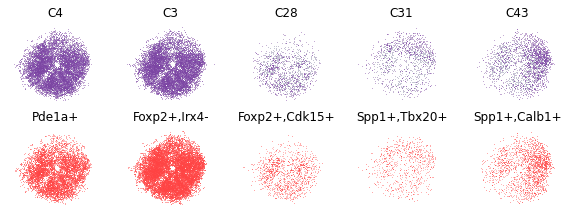

In [99]:
adata_g =adata[(adata.obs['class']=='RGC') & (adata.obs['final_assignment']!='Unassigned')]

types_and_markers = {
    'C4':['Pde1a'],
    'C3':['Foxp2','Irx4'],
    'C28':['Foxp2', 'Cdk15'],
    'C31':['Spp1','Tbx20'],
    'C43':['Spp1', 'Calb1'],
    #'C29':['Prlr','Stxbp6'],
}
RGC_types,marker_genes = zip(*types_and_markers.items())
thresholds= [[2],[1.5,1.5],[1.5,1.5],[2,1.25],[3,1.5]]
signs=[[1,1],[1,-1],[1,1],[1,1],[1,1]]
with plt.rc_context({"font.sans-serif":'Arial'}):
    sc.pp.subsample(adata_g,fraction=1)
    plot_genes_alt(adata_g,RGC_types,marker_genes,figsize=(10,3.5),output_f=os.path.join(figure_dir,"known_type_biases_ALT.png"),thresholds=thresholds,signs=signs,title_size=12,in_pt_s=0.5,out_pt_s=0.003,in_color_t='indigo',in_color_g='red')
#nice_scatter(adata=adata_f,col='final_assignment',RGC_types=RGC_types,facecolor='black',colors=[cmap_dorsal(gradient[0])]*6,output_f=os.path.join(figure_dir,f"biases.png"))
#nice_scatter(adata=adata_f[adata_f.obs['run']==3],col='final_assignment',RGC_types=['C43','C12'],facecolor='black',colors=[cmap_nasal(gradient[0]),cmap_nasal(gradient[0])],output_f=os.path.join(figure_dir,f"new_NT.png"))

['Tbx20', 'Tagln2'] [1, 1]
[[-0.24016397 -0.31165734]
 [-0.24016397 -0.31165734]
 [-0.24016397  0.15990877]
 ...
 [-0.24016397 -0.31165734]
 [-0.24016397 -0.31165734]
 [-0.24016397 -0.31165734]]
-
Tbx20+
-
Tbx20+,Tagln2+
['Prkcq', 'Opn4'] [1, -1]
[[-0.22935326  0.33718804]
 [-0.56867903 -0.79376668]
 [-0.12919259  0.33718804]
 ...
 [-0.42976943  0.33718804]
 [-1.12045419  0.33718804]
 [-0.07213251  0.33718804]]
-
Prkcq+
-
Prkcq+,Opn4-
['Neurod2', 'Eomes'] [1, 1]
[[-0.37412843 -0.51267362]
 [ 3.25529337 -0.51267362]
 [ 3.79464006 -0.51267362]
 ...
 [ 0.76200265 -0.51267362]
 [ 5.0831008   0.57457858]
 [-0.37412843 -0.08243882]]
-
Neurod2+
-
Neurod2+,Eomes+
['Cartpt', 'Prdm8'] [1, 1]
[[-0.65231043  0.72117925]
 [-0.15814853  2.54507709]
 [ 2.70385289 -0.63613886]
 ...
 [-0.30490267 -0.63613886]
 [-0.65231043  1.57667923]
 [ 0.48874283 -0.05420774]]
-
Cartpt+
-
Cartpt+,Prdm8+
['Neurod2', 'S100b'] [1, 1]
[[-0.37412843 -0.58423251]
 [ 3.25529337 -0.00974148]
 [ 3.79464006 -0.58423251]
 ...


/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_2723/3629342963.py:37: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "rasterized" which is no longer supported as of 3.3 and will become an error in 3.6
  fig.savefig(output_f,bbox_inches='tight',dpi=300,rasterized=True)
/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_2723/3629342963.py:38: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


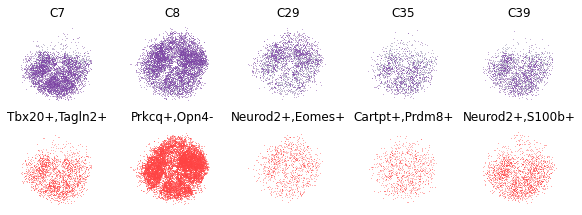

In [100]:


adata_g =adata[(adata.obs['class']=='RGC') & (adata.obs['final_assignment']!='Unassigned')]

types_and_markers = {
    'C7':['Tbx20','Tagln2'],
    'C8':['Prkcq','Opn4'],#neg opn4
    'C29':['Neurod2','Eomes'],
    'C35':['Cartpt','Prdm8'],
    'C39':['Neurod2','S100b']
}
RGC_types,marker_genes = zip(*types_and_markers.items())
thresholds= [[0.5,0.5],[1,0.5],[2.5,1],[2,0.3],[1.25,1.25]]
signs=[[1,1],[1,-1],[1,1],[1,1],[1,1]]
with plt.rc_context({"font.sans-serif":'Arial'}):
    sc.pp.subsample(adata_g,fraction=1)
    plot_genes_alt(adata_g,RGC_types,marker_genes,figsize=(10,3.5),output_f=os.path.join(figure_dir,"new_type_biases_ALT.png"),thresholds=thresholds,signs=signs,title_size=12,in_pt_s=0.5,out_pt_s=0.003,in_color_t='indigo',in_color_g='red')
#nice_scatter(adata=adata_f,col='final_assignment',RGC_types=RGC_types,facecolor='black',colors=[cmap_dorsal(gradient[0])]*6,output_f=os.path.join(figure_dir,f"biases.png"))
#nice_scatter(adata=adata_f[adata_f.obs['run']==3],col='final_assignment',RGC_types=['C43','C12'],facecolor='black',colors=[cmap_nasal(gradient[0]),cmap_nasal(gradient[0])],output_f=os.path.join(figure_dir,f"new_NT.png"))

In [ ]:
with plt.rc_context(CONTEXT):
    for type in ['C4','C3','C28','C31','C43']:
        adata_f = adata[adata.obs['final_assignment'] == type]
        adata_g = adata[adata.obs['final_assignment'] != type]
        ax = sns.scatterplot(adata_f.obs,x='aligned_center_x',y='aligned_center_y',s=1.5,color='blue',legend=None)
        sns.scatterplot(adata_g.obs,x='aligned_center_x',y='aligned_center_y',s=0.05,color='grey',legend=None,ax=ax)
        plt.show()

In [36]:
def nice_scatter(adata,col,RGC_types,output_f,figsize=None, colors=None,facecolor='white'):
    if isinstance(RGC_types,str):
        RGC_types = [RGC_types]
    if figsize is None:
        figsize=(len(RGC_types)*8,8)
    fig,ax=plt.subplots(ncols=len(RGC_types),figsize=(len(RGC_types)*8,8))
    if len(RGC_types)==1:
        ax=[ax]
    plt.subplots_adjust(wspace=0, hspace=0)
        
    for i,rt in enumerate(RGC_types):
        cmap='Pastel1'
        filt=adata.obs[col]==rt
        df=adata.obs[filt]
        df_n=adata.obs[~filt]
        cmap=plt.get_cmap('Set1')
        sns.scatterplot(data=df_n,x='aligned_center_x',y='aligned_center_y',color='grey',ax=ax[i],s=0.5)
        if colors is None:
            c=cmap(i)
        else:
            c=colors[i]
        sns.scatterplot(data=df,x='aligned_center_x',y='aligned_center_y',color=c,ax=ax[i],s=20)
        ax[i].set_axis_off()
        ax[i].set_title(rt,color='white',fontsize=32)
        ax[i].set_facecolor(facecolor)
    plt.savefig(output_f,facecolor=facecolor,bbox_inches='tight',dpi=300)
    plt.show()

/opt/anaconda3/envs/RGC/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/opt/anaconda3/envs/RGC/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/opt/anaconda3/envs/RGC/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/opt/anaconda3/envs/RGC/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/opt/anaconda3/envs/RGC/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/opt/

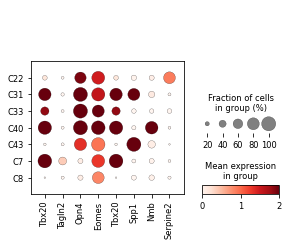

In [104]:
sc.pl.dotplot(adata[adata.obs['final_assignment'].isin(['C7','C8','C33','C40','C31','C43','C22'])],var_names=['Tbx20','Tagln2','Opn4','Eomes','Tbx20','Spp1','Nmb','Serpine2'],groupby='final_assignment',use_raw=False,vmin=0,vmax=2)

In [75]:
adata_f =adata[(adata.obs['class']=='RGC') & (adata.obs['final_assignment']!='Unassigned') & (adata.obs['run']==3)]

types_and_markers = {
    'C6':['Zic1'],
    'C24':['Tafa4'],
    'C43':['Spp1', 'Calb1'],
    'C12':['Mmp17'],
    'C7':['Tbx20','Tagln2'],
    'C29':['Prlr','Stxbp6'],
}
RGC_types,marker_genes = zip(*types_and_markers.items())
thresholds= [[2],[2.5],[3,1.5],[1],[0.5,0.5],[3.5,0.2]]
plot_genes(adata_f,RGC_types,marker_genes,output_f=os.path.join(figure_dir,"marker_genes.png"),thresholds=thresholds)
#nice_scatter(adata=adata_f,col='final_assignment',RGC_types=RGC_types,facecolor='black',colors=[cmap_dorsal(gradient[0])]*6,output_f=os.path.join(figure_dir,f"biases.png"))
#nice_scatter(adata=adata_f[adata_f.obs['run']==3],col='final_assignment',RGC_types=['C43','C12'],facecolor='black',colors=[cmap_nasal(gradient[0]),cmap_nasal(gradient[0])],output_f=os.path.join(figure_dir,f"new_NT.png"))

NameError: name 'plot_genes' is not defined

In [154]:
def gen_candidate_markers(adata,groupby,types,diff=True):
    try:
        del adata.uns['log1p']
    except:
        pass
    adata.layers['log'] = sc.pp.log1p(adata.layers['raw'])
    sc.tl.rank_genes_groups(adata,groupby=groupby,method='wilcoxon',layer='log',pts=True)
    type_marker_map = dict()
    for n_type in types:
        df = adata.uns['rank_genes_groups']['pts']
        if diff:
            pts_in =df[n_type]
            other_columns = list(set(df.columns) - {n_type})
            pts_out = np.max(df[other_columns].values,axis=1)
            pts_diff = pts_in-pts_out
            var_names=pts_diff.sort_values(ascending=False).index[0:10]
        else:
            var_names = var_names=adata.uns['rank_genes_groups']['names'][n_type]
        with plt.rc_context({"font.sans-serif":"Arial"}):
            sc.pl.dotplot(adata,var_names=var_names,groupby=groupby,show=False,vmin=0,vmax=1)
            #plt.savefig(os.path.join(output_dir,"C7_DE_pts_in_v_pts_rest.png"))
        type_marker_map[n_type] = list(var_names)
    return type_marker_map

/opt/anaconda3/envs/RGC/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/opt/anaconda3/envs/RGC/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/opt/anaconda3/envs/RGC/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:399: PerformanceWarning: DataFrame is highly 

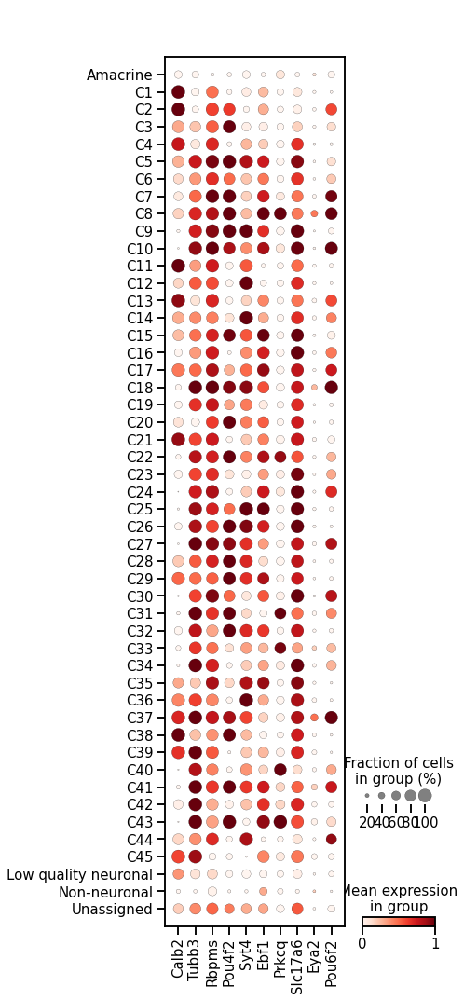

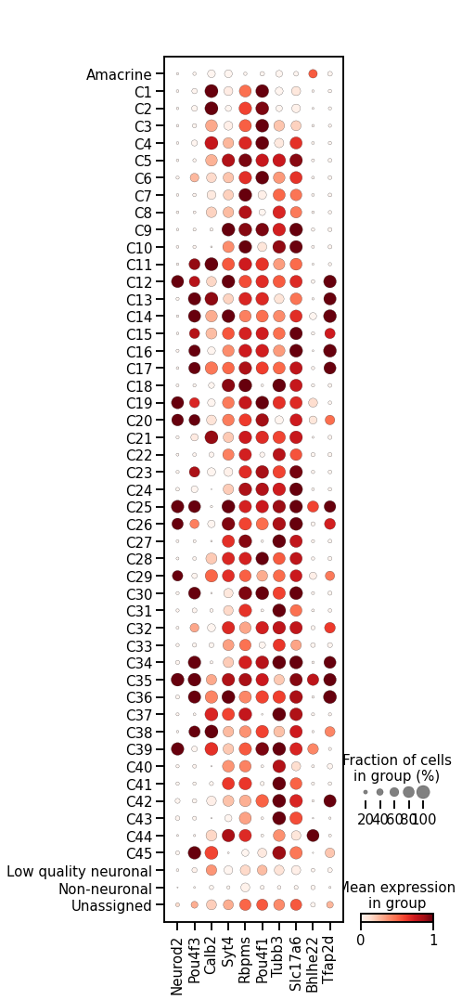

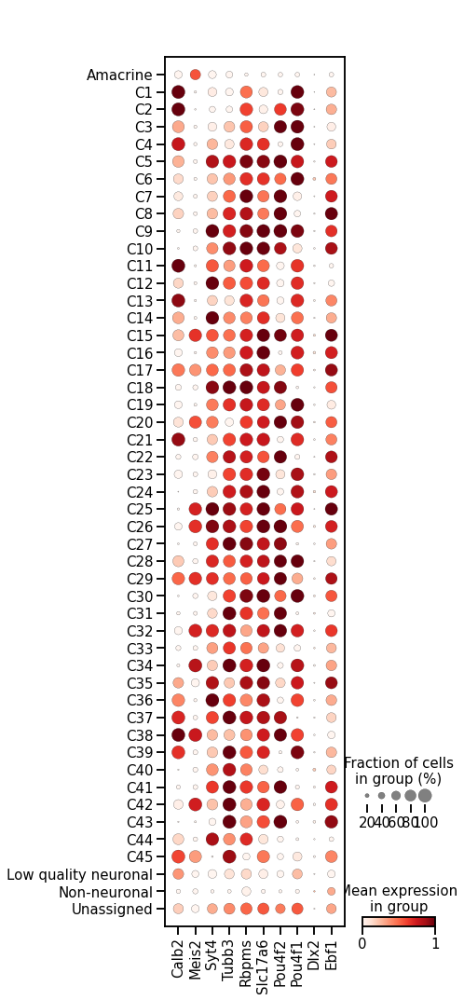

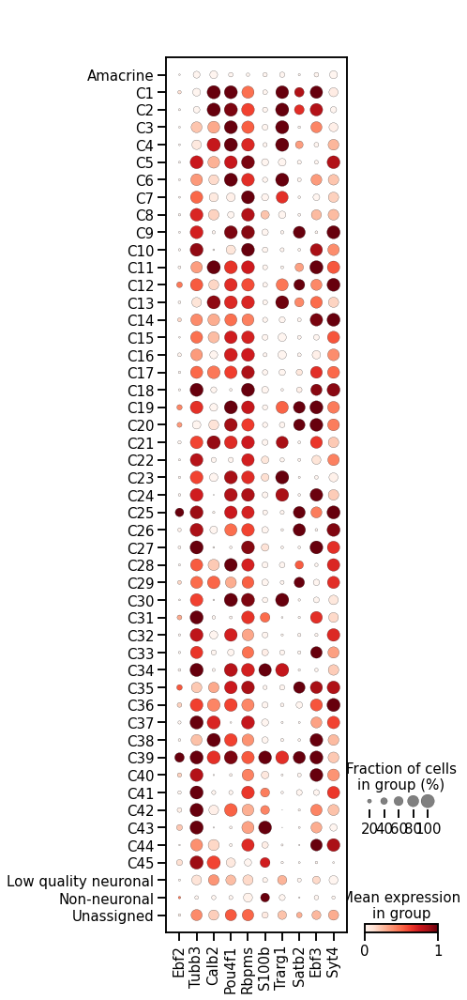

In [158]:
type_marker_map = gen_candidate_markers(adata, groupby='final_assignment',types=['C8','C35','C29','C39'])

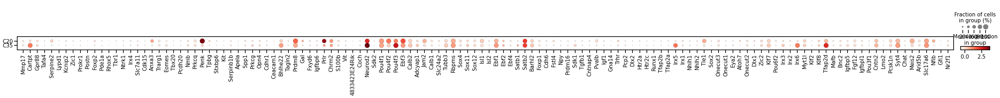

In [176]:
sc.pl.dotplot(adata[adata.obs['final_assignment'].isin(['C35','C20'])],groupby='final_assignment',var_names=adata.var.index)

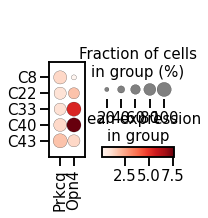

In [161]:
sc.pl.dotplot(adata[adata.obs['final_assignment'].isin(['C8','C22','C33','C40','C43'])],groupby='final_assignment',var_names=['Prkcq','Opn4'])

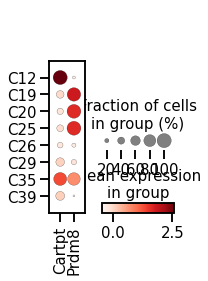

In [181]:
sc.pl.dotplot(adata[adata.obs['final_assignment'].isin(['C12','C19','C20','C25','C26','C29','C35','C39'])],groupby='final_assignment',var_names=['Cartpt','Prdm8'])

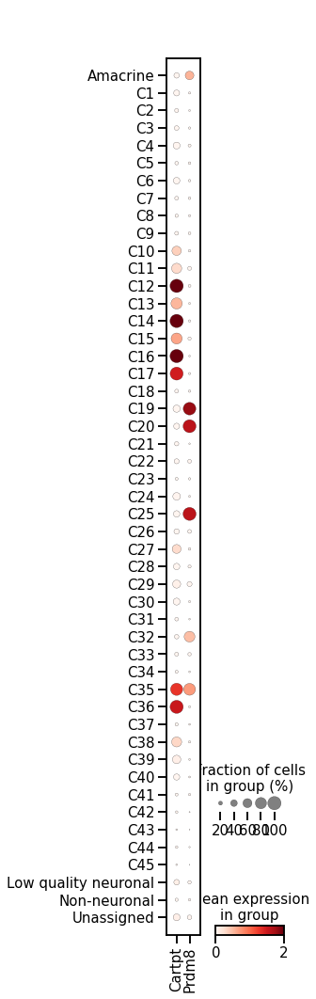

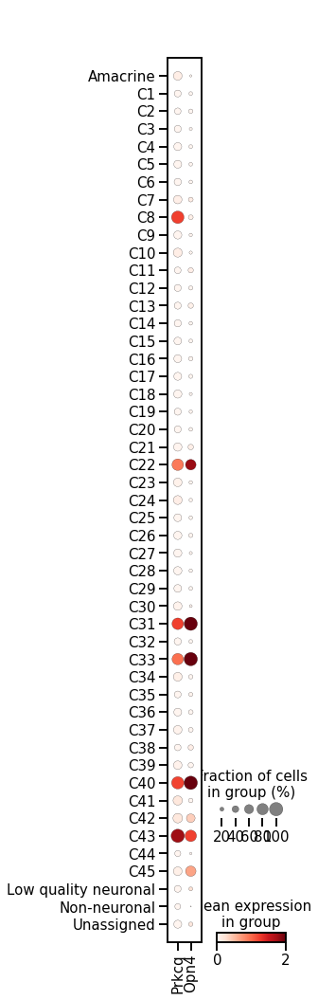

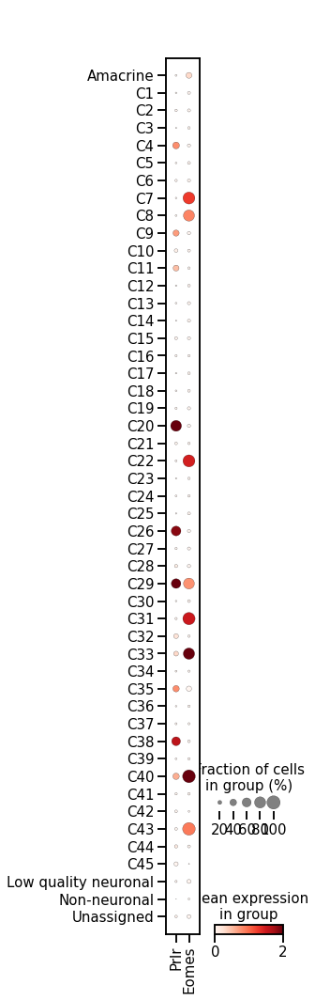

In [206]:
sc.pl.dotplot(adata,groupby='final_assignment',var_names=['Cartpt','Prdm8'],vmin=0,vmax=2)
sc.pl.dotplot(adata,groupby='final_assignment',var_names=['Prkcq','Opn4'],vmin=0,vmax=2)
sc.pl.dotplot(adata,groupby='final_assignment',var_names=['Prlr','Eomes'],vmin=0,vmax=2)

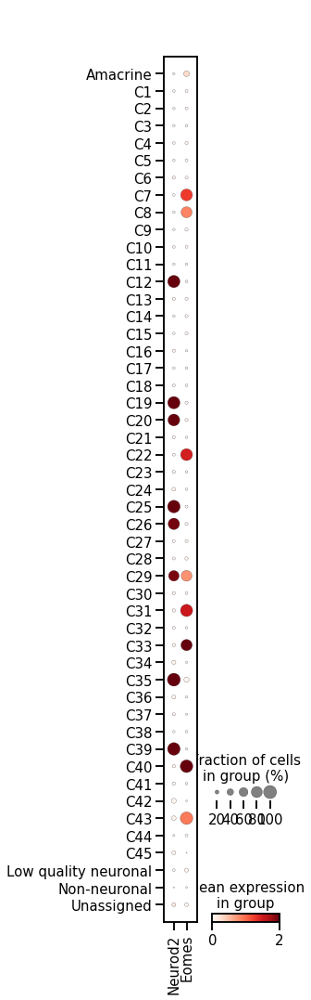

In [229]:
sc.pl.dotplot(adata,groupby='final_assignment',var_names=['Neurod2','Eomes'],vmin=0,vmax=2)

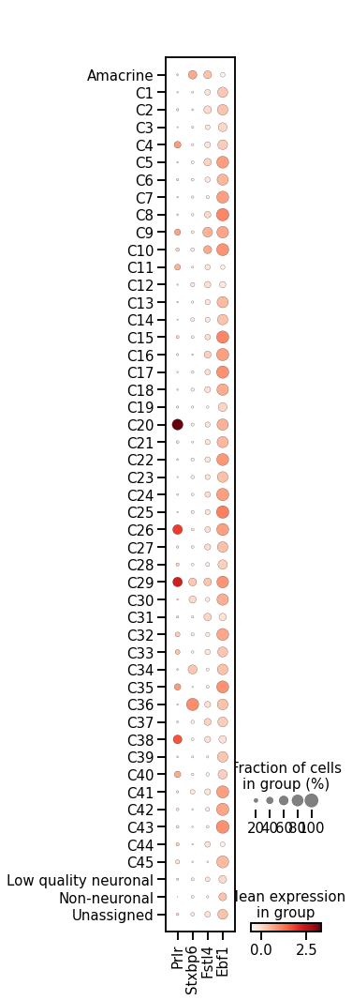

In [198]:
sc.pl.dotplot(adata[adata.obs['final_assignment'].isin(adata.obs['final_assignment'].unique())],groupby='final_assignment',var_names=['Prlr','Stxbp6','Fstl4','Ebf1'])

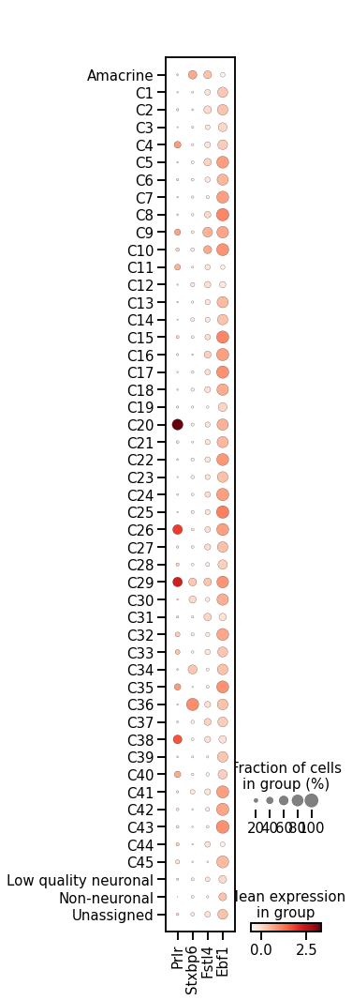

In [199]:
sc.pl.dotplot(adata[adata.obs['final_assignment'].isin(adata.obs['final_assignment'].unique())],groupby='final_assignment',var_names=['Prlr','Stxbp6','Fstl4','Ebf1'])

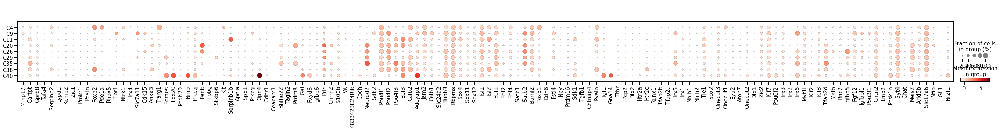

In [200]:
sc.pl.dotplot(adata[adata.obs['final_assignment'].isin(['C4','C9','C11','C20','C26','C29','C35','C38','C40'])],groupby='final_assignment',var_names=adata.var.index)

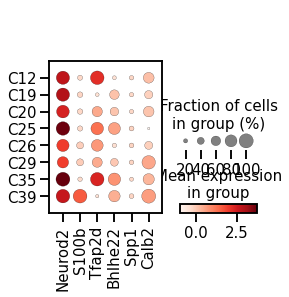

In [170]:
sc.pl.dotplot(adata[adata.obs['final_assignment'].isin(['C12','C19','C20','C25','C26','C29','C35','C39'])],groupby='final_assignment',var_names=['Neurod2','S100b','Tfap2d','Bhlhe22','Spp1','Calb2'])

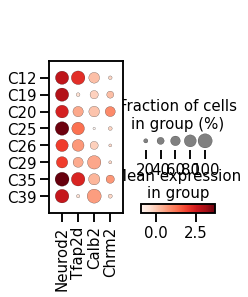

In [175]:
sc.pl.dotplot(adata[adata.obs['final_assignment'].isin(['C12','C19','C20','C25','C26','C29','C35','C39'])],groupby='final_assignment',var_names=['Neurod2','Tfap2d','Calb2','Chrm2'])

In [121]:
def plot_genes(adata,RGC_types,marker_genes,thresholds, output_f,type_col='final_assignment'):
    fig,ax=plt.subplots(nrows=2,ncols=len(marker_genes),figsize=(len(marker_genes)*8,8*2))
    for i,(rt,markers,threshold) in enumerate(zip(RGC_types,marker_genes,thresholds)):
        express = np.sum(adata[:,markers].X > np.array(threshold),axis=1) >= len(markers)
        print(express)
        sns.scatterplot(adata.obs[express],x='aligned_center_x',y='aligned_center_y',s=20,ax=ax[1,i],color='white',legend=None)
        sns.scatterplot(adata.obs[~express],x='aligned_center_x',y='aligned_center_y',s=0.5,ax=ax[1,i],color='grey',legend=None)
        ax[1,i].set_axis_off()
        title = '+,'.join(markers) +'+'
        ax[1,i].set_title(title,color='white',fontsize=40)
        ax[1,i].set_facecolor('black')

        filt=adata.obs[type_col]==rt
        df,df_n=adata.obs[filt],adata.obs[~filt]
        sns.scatterplot(data=df_n,x='aligned_center_x',y='aligned_center_y',color='grey',ax=ax[0,i],s=0.5)
        sns.scatterplot(data=df,x='aligned_center_x',y='aligned_center_y',color='white',ax=ax[0,i],s=20)
        ax[0,i].set_axis_off()

        ax[0,i].set_title(rt,color='white',fontsize=40)
        ax[0,i].set_facecolor('black')
    
    fig.savefig(output_f,facecolor='black',bbox_inches='tight',dpi=300)
    fig.show()





/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_1623/3749948933.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_r.obs['Fstl4_expression'] = np.array(adata_r[:,['Fstl4']].X).flatten()


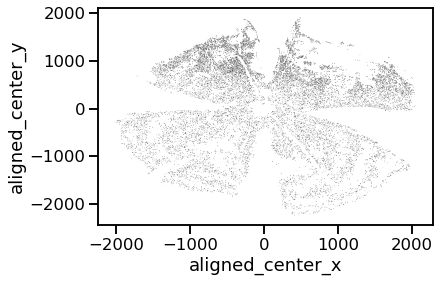

/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_1623/3749948933.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_r.obs['Fstl4_expression'] = np.array(adata_r[:,['Fstl4']].X).flatten()


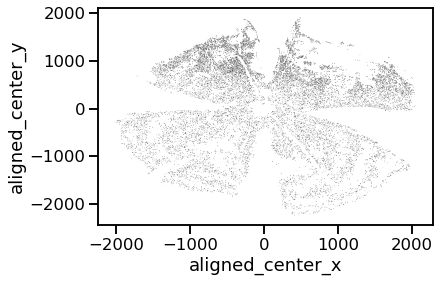

/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_1623/3749948933.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_r.obs['Fstl4_expression'] = np.array(adata_r[:,['Fstl4']].X).flatten()


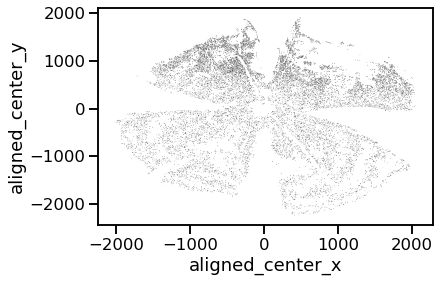

/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_1623/3749948933.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_r.obs['Fstl4_expression'] = np.array(adata_r[:,['Fstl4']].X).flatten()


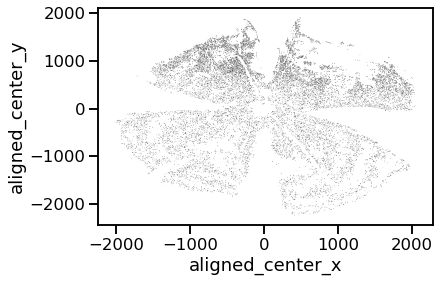

/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_1623/3749948933.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_r.obs['Fstl4_expression'] = np.array(adata_r[:,['Fstl4']].X).flatten()


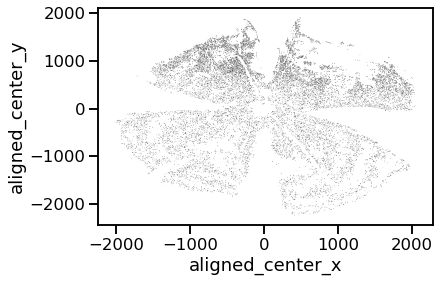

/var/folders/b3/jkbfjl310vdb0w4vhhz87pdr0000gn/T/ipykernel_1623/3749948933.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_r.obs['Fstl4_expression'] = np.array(adata_r[:,['Fstl4']].X).flatten()


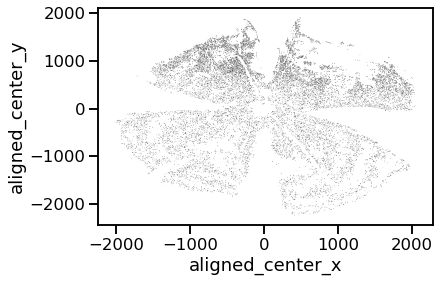

In [122]:
for run in adata.obs['run'].unique():
    adata_r = adata[adata.obs['run']==3]
    adata_r.obs['Fstl4_expression'] = np.array(adata_r[:,['Fstl4']].X).flatten()
    sns.scatterplot(adata_r.obs,x='aligned_center_x',y='aligned_center_y',hue='Fstl4_expression',s=0.3,palette='binary',hue_norm=(0,1),legend=None)
    plt.savefig(os.path.join(figure_dir,f"Fstl4_expression_{run}.png"))
    plt.show()

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


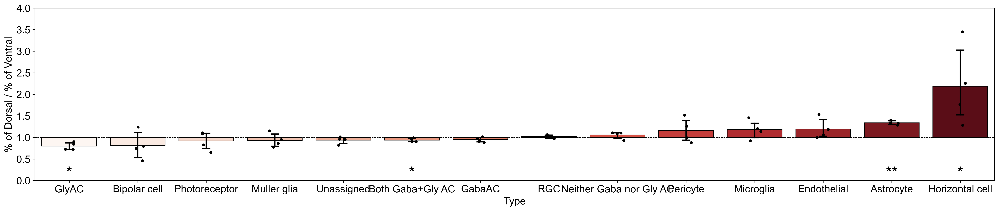

(              retina_class  % of Dorsal / % of Ventral
 0              Endothelial                    0.062147
 0                Microglia                    0.139751
 0                      RGC                    0.065515
 0                   GabaAC                   -0.116285
 0                Astrocyte                    0.405010
 0  Neither Gaba nor Gly AC                    0.107434
 0               Unassigned                   -0.041465
 0         Both Gaba+Gly AC                   -0.097415
 0                    GlyAC                   -0.154276
 0          Horizontal cell                    1.255849
 0             Bipolar cell                   -0.205279
 0              Muller glia                   -0.226055
 0                 Pericyte                    0.259241
 0            Photoreceptor                   -0.172165
 0              Endothelial                    0.188637
 0                Microglia                    0.455690
 0                      RGC                    0

In [29]:
key='retina_class'
adata_f =adata
cmap_dorsal = plt.get_cmap('Reds')
cmap_nasal = plt.get_cmap('Blues')
gradient=np.linspace(0,1,len(adata_f.obs[key].unique()))
#nice_scatter(adata=adata_f[adata_f.obs['run']==3],col='final_assignment',RGC_types=['C7','C8','C22','C31','C33','C40','C43'],facecolor='black',output_f=os.path.join(figure_dir,f"r3_ip_RGCs.png"))
err_kws={'errcolor':'black','errwidth':2,'capsize':0.1}
quant_dist_v2(
    arr=[adata_f[adata_f.obs['run']==run] for run in adata_f.obs['run'].unique()],col='D/V',
    types=adata_f.obs[key].unique(),denote_markings=True,sort=True,type_col=key,
    size=4.5,figsize=(27,5),palette=[cmap_dorsal(g) for g in gradient],color=None,p_height=0,show_test=True,output_f=os.path.join(figure_dir,"Dorsal_Ventral.pdf"),err_kws=err_kws,
    xlabel='Type'
    )

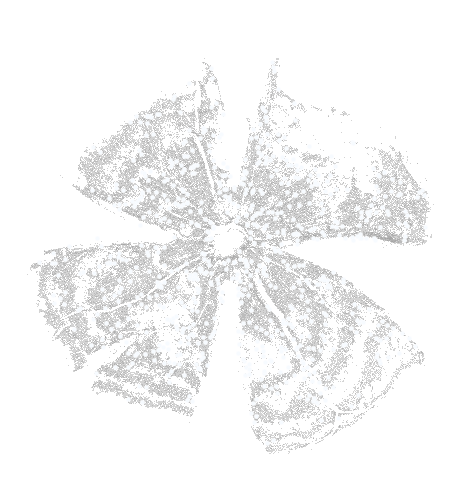

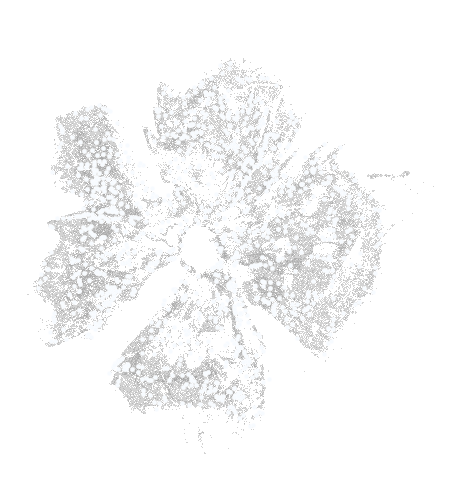

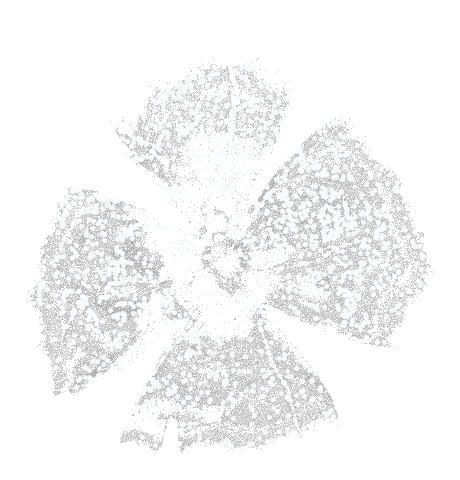

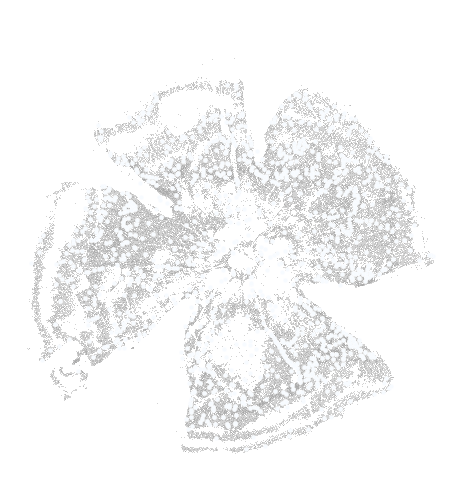

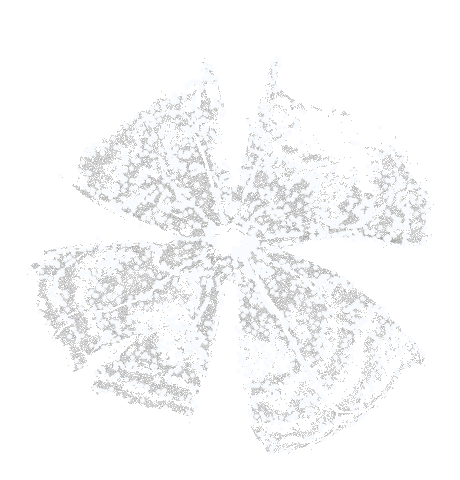

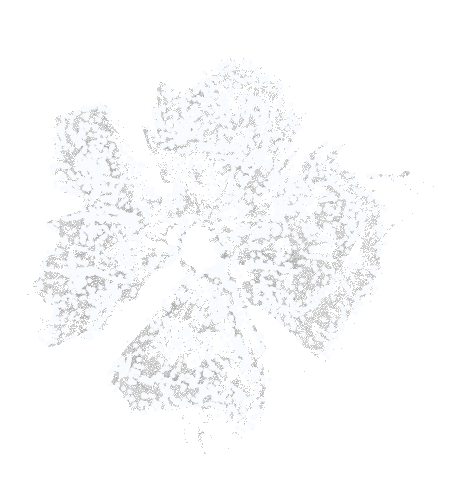

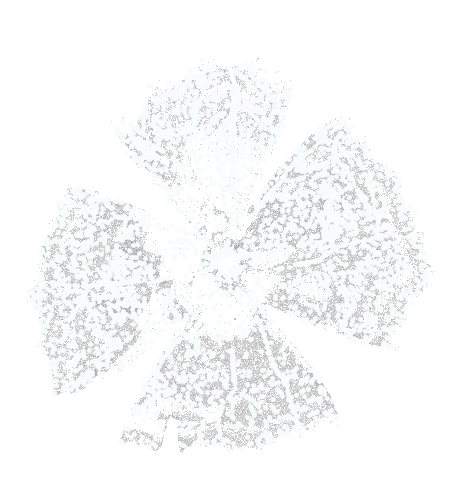

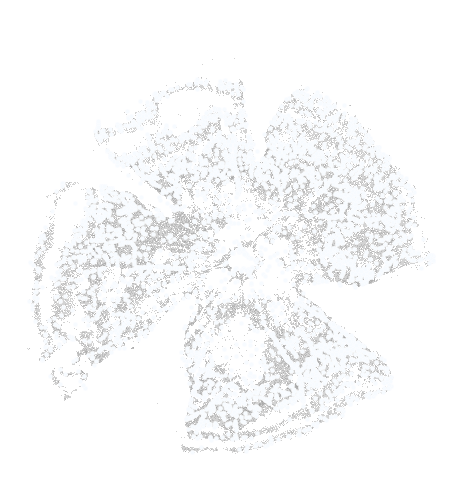

In [50]:
for i in [3,4,5,7]:
    nice_scatter(adata=adata_f[adata_f.obs['run']==i],col='retina_class',RGC_types=['Endothelial'],facecolor='black',colors=[cmap_nasal(gradient[0])],output_f=os.path.join(figure_dir,f"Endothelial_{i}.png"))

for i in [3,4,5,7]:
    nice_scatter(adata=adata_f[adata_f.obs['run']==i],col='final_assignment',RGC_types=['Non-neuronal'],facecolor='black',colors=[cmap_nasal(gradient[0])],output_f=os.path.join(figure_dir,f"CLUMPED_NON-NEURONAL_{i}.png"))


[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


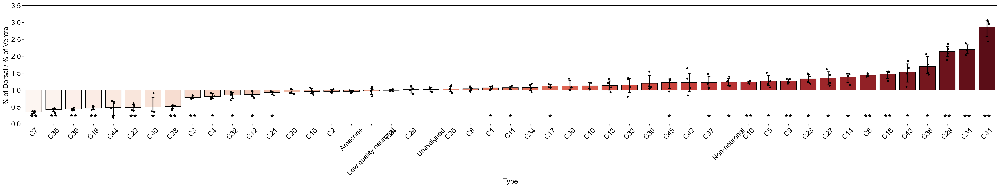

(        final_assignment  % of Dorsal / % of Ventral
 0           Non-neuronal                    0.135468
 0   Low quality neuronal                    0.085679
 0                    C32                   -0.091747
 0               Amacrine                   -0.082928
 0                    C29                    1.368198
 ..                   ...                         ...
 0                    C37                    0.205722
 0                    C31                    1.386432
 0                    C36                    0.339015
 0                    C33                    0.099641
 0                    C40                   -0.630926
 
 [196 rows x 2 columns],
 <AxesSubplot:xlabel='Type', ylabel='% of Dorsal / % of Ventral'>)

In [43]:
key='final_assignment'
adata_f =adata
cmap_dorsal = plt.get_cmap('Reds')
cmap_nasal = plt.get_cmap('Blues')
gradient=np.linspace(0,1,len(adata_f.obs[key].unique()))
#nice_scatter(adata=adata_f[adata_f.obs['run']==3],col='final_assignment',RGC_types=['C7','C8','C22','C31','C33','C40','C43'],facecolor='black',output_f=os.path.join(figure_dir,f"r3_ip_RGCs.png"))
err_kws={'errcolor':'black','errwidth':2,'capsize':0.1}
quant_dist_v2(
    arr=[adata_f[adata_f.obs['run']==run] for run in adata_f.obs['run'].unique()],col='D/V',
    types=adata_f.obs[key].unique(),denote_markings=True,sort=True,type_col=key,
    size=4.5,figsize=(40,5),palette=[cmap_dorsal(g) for g in gradient],color=None,p_height=0,show_test=True,output_f=os.path.join(figure_dir,"biases.png"),err_kws=err_kws,
    xlabel='Type'
    )

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


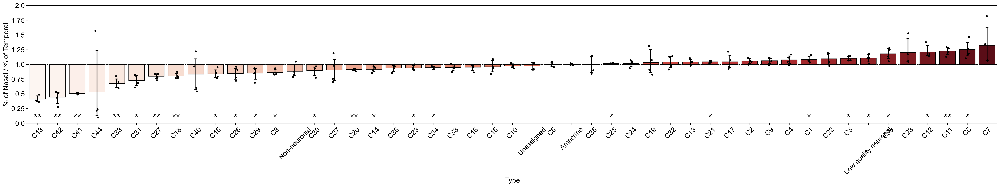

(        final_assignment  % of Nasal / % of Temporal
 0           Non-neuronal                   -0.211010
 0   Low quality neuronal                    0.106643
 0                    C32                    0.129915
 0               Amacrine                   -0.011825
 0                    C29                   -0.066164
 ..                   ...                         ...
 0                    C37                   -0.298391
 0                    C31                   -0.177373
 0                    C36                   -0.146834
 0                    C33                   -0.299243
 0                    C40                   -0.459416
 
 [196 rows x 2 columns],
 <AxesSubplot:xlabel='Type', ylabel='% of Nasal / % of Temporal'>)

In [46]:
key='final_assignment'
adata_f =adata
cmap_dorsal = plt.get_cmap('Reds')
cmap_nasal = plt.get_cmap('Blues')
gradient=np.linspace(0,1,len(adata_f.obs[key].unique()))
#nice_scatter(adata=adata_f[adata_f.obs['run']==3],col='final_assignment',RGC_types=['C7','C8','C22','C31','C33','C40','C43'],facecolor='black',output_f=os.path.join(figure_dir,f"r3_ip_RGCs.png"))
err_kws={'errcolor':'black','errwidth':2,'capsize':0.1}
quant_dist_v2(
    arr=[adata_f[adata_f.obs['run']==run] for run in adata_f.obs['run'].unique()],col='N/T',
    types=adata_f.obs[key].unique(),denote_markings=True,sort=True,type_col=key,
    size=4.5,figsize=(40,5),palette=[cmap_dorsal(g) for g in gradient],color=None,p_height=0,show_test=True,output_f=os.path.join(figure_dir,"biases_NT.png"),err_kws=err_kws,
    xlabel='Type'
    )

In [ ]:
key='final_assignment'
adata_f =adata
cmap_dorsal = plt.get_cmap('Reds')
cmap_nasal = plt.get_cmap('Blues')
gradient=np.linspace(0,1,len(adata_f.obs[key].unique()))
#nice_scatter(adata=adata_f[adata_f.obs['run']==3],col='final_assignment',RGC_types=['C7','C8','C22','C31','C33','C40','C43'],facecolor='black',output_f=os.path.join(figure_dir,f"r3_ip_RGCs.png"))
err_kws={'errcolor':'black','errwidth':2,'capsize':0.1}
quant_dist_v2(
    arr=[adata_f[adata_f.obs['run']==run] for run in adata_f.obs['run'].unique()],col='D/V',
    types=adata_f.obs[key].unique(),denote_markings=True,sort=True,type_col=key,
    size=4.5,figsize=(40,5),palette=[cmap_dorsal(g) for g in gradient],color=None,p_height=0,show_test=True,output_f=os.path.join(figure_dir,"biases.png"),err_kws=err_kws,
    xlabel='Type'
    )